# **Stepik - Introduction to competitive ML** [https://stepik.org/lesson/681964/step/1?unit=680747]
- [github of course](https://github.com/a-milenkin/Competitive_Data_Science)
- [Samsung NLP](https://stepik.org/course/54098/syllabus)
- [Samsung CV](https://stepik.org/course/50352/syllabus)

In [1]:
# change directory to 'main' [1 level up]
import os 
main_folder = 'C:\\Anaconda\\envs\\_Kaggle_competitions'
os.chdir(main_folder)
#os.chdir(os.path.dirname(os.getcwd()))

# display options for pandas
import pandas as pd
from IPython.display import display
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', '{:.3f}'.format)


# tqdm
#     TQDM --- for i in tqdm(range(100)):
#         for 2 loops: for i in tqdm_notebook(range(100), desc='1st_loop'): -----> for i in tqdm_notebook(range(100), desc='2nd_loop', leave=False):
# progress_apply --- car_info['model'].progress_apply(len)
# pandarallel --- pandarallel.initialize(progress_bar=True, nb_workers=8)  [8 cpus]

## Seed fixing

In [ ]:
DEFAULT_RANDOM_SEED = 2021

def set_all_seeds(seed=DEFAULT_RANDOM_SEED):
    
    # python's seeds
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    #np.random.seed(seed)
    
    # torch's seeds
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    
    # tensorflow's seed
    #tf.random.set_seed(seed)
    
set_all_seeds(seed=DEFAULT_RANDOM_SEED)

# ➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖

___
# <font color='pink'> 🐼 2.2 **Pandas** --- (transforming dataframes)</font>
- **[COMPLETE CHEAT TABLE FOR PANDAS](https://dfedorov.spb.ru/pandas/cheatsheet/Pandas_DataFrame_Notes.pdf)**
- **[30 USEFUL PANDAS FUNCTIONS](https://regenerativetoday.com/30-very-useful-pandas-functions-for-everyday-data-analysis-tasks/)**
- rows & columns --- add, delete, rename, select, transform, join, NAs, sorting
- dfs --- join, select, transform (apply, pivot), 

- # <font color='orange'> **EDITING** --- (select, join, remove, create new with applying functions) </font>
    - <font color='orange'> **SELECT / JOIN --- with COLUMNS** </font>
        - **CONCAT / JOIN**
            - concat([series_1, series_2]) -------> with duplicates of rows
        - **SELECT** (using conditions, names) 
            - df.loc[(condition_1) - (condition_2)] ------   (or .iloc) & ('()' are important !!!)
            - query('age > visits')  (for variables outside use @: query('age > @variable_1')   (output is every row with 'age > visits')
            - filter(items=['row_1'], axis=0) (axis==1 ---> column) ---> will output every row with name 'row_1'
            - filter(like=['row'], axis=0) ---> will output every row that starts with 'row'
            - via **MASKING** (select particular elements) - isin()
                - elements = [] ---> mask = df[column].isin(elements) ---> df[mask]  (will give only rows that have these elements)
        - **ADDING / REMOVING** new rows
            - df.loc[len(df) + 1] = dict(...) / list(...)
    - <font color='orange'> **MERGE >> CONCAT --- by index - DATAFRAMES** </font> 
        - **CONCAT**
            - pd.**concat([df_1, df_2], axis=0/1)**
                - axis=0 ---> join by rows (rows must be the same)
                - axis=1 ---> join by rows (rows can be NOT THE SAME) [fill with NaNs]
                - df.append(df2) - BAD
        - **MERGE**
            - df_1.**merge(df_2, on='col_id', how='left')**
                - on - column for merging (mutual)
                    - other columns will be duplicated
                - how
                    - left join (elements - df_1 + df_1 & df_2)
                    - right join (elements - df_2 + df_1 & df_2)
                    - inner join (elements - df_1 & df_2)
                    - outer join (elements - df_1 || df_2)
    - <font color='orange'> **DROP (REMOVE) --- DUPLICATES / COLUMNS / ROWS** (by condition) </font>
        - df.drop(columns_list, axis=1)
        - df.drop_duplicates(subset=['car_id'])  (or to all dataset df.drop_duplicates())
        - **EXAMPLE:** ---- df.drop(df[df.car_rating < critical_car_rating].index, inplace=True)
    - <font color='orange'> **GROUP BY --- by value - FOR COLUMNS** </font>
        1) **one function call** ----> df.groupby("car_id", as_index=False)[cols].mean()
            - usually used to apply functions like: mean(), count(), etc.
            - for example we have 1 car but 10 users ---> want to calculate average ride for the car
            - then we have to use GROUPBY by car id (cols - columns we want in final df)
            - then we can apply ANY function we want 
        2) **BEST CHOICE - several functions call with NO multiindex** ----> df.groupby("car_id", as_index=False).agg(rating_mean=("rating", "mean"),
                                                           ride_duration_sum=("ride_duration", sum),
                                                           ride_cost_max=("ride_cost", "max"),
                                                           my_func_result=("speed_max", my_func),)
            - new_column_name=(old_column_name, method/function)
            - methods are with "" - "min", "max"
            - pd.Series is usually the output or transformation (meaning pd.Series.function might require)
            - function just their name
        3) **BAD CHOICE - several functions call, BUT with multi-index** ----> df.groupby("car_id", as_index=False)[cols].agg(["count", "mean"])
            - by .agg (aggregation) we can use multiple functions
            - **from MULTI-INDEX to INDEX** --- ["_".join(c) for c in rides_info_gr.columns]
    - <font color='orange'> **PIVOT & PIVOT_TABLE --- FOR DATAFRAMES** </font> 
        - pivot() can **transform dataset how you want**
            - car_train_pivot = car_train.pivot(index='car_id',
                                      columns=['car_type'],
                                      values = ['car_rating']).fillna(0)]
                - new index --- 'car_id'
                - new columns --- 'car_type'
                - values are --- 'car_rating'
        - pivot_table() is for **applying function - like groupby + agg**
            - car_train_pivot = car_train.pivot_table(index = 'year_to_start',
                                            columns = ['car_type'],
                                            values = ['riders'],
                                            aggfunc = ['mean', 'sum', 'max']).fillna(0)
                - below **is for COLUMNS PROPER NAMES** (multiindex)
                - car_train_pivot.columns = [f'{i[2]}_{i[1]}_{i[0]}' for i in car_train_pivot.columns]
                - car_train_pivot.reset_index(inplace=True)
            - **also can use to group columns**
                - pivot_table2 = car_train.pivot_table(index = 'car_id',
                                         #columns = [],
                                         values = ['riders'],
                                         aggfunc = ['mean', 'sum']).fillna(0)
                - below **is for COLUMNS PROPER NAMES** (multiindex)
                - pivot_table2.columns = [f'{i[1]}_{i[0]}' for i in pivot_table2.columns]
            - **Can: calculate functions, create new columns - with grouping by something (index) for each TYPE (column) calculate something (values | agg_funct(values))**
            
            
            
- # <font color='orange'> **ADDITIONAL** --- (info, rename, sort, fillna, index, apply) </font>
    - <font color='orange'> **INFORMATION ON DATASET**</font>
        - info() --- | column | count | non-null-count | dtype |
        - describe() --- statistics (mean, std, etc.)
        - value_counts() --- unique value counting
    - <font color='orange'> **RENAME COLUMNS** </font>
        - df.rename(columns={"column_name_1": "new_column_name_1"})
    - <font color='orange'> **SORTING - COLUMNS [with df index order change]** </font>
        - df.sort_values(by=['car_rating', 'year_to_work'], ascending=[0,1], axis=0)    (works with several columns)
        - sort_index(axis=1, ascending=False)
    - <font color='orange'> **MISSING VALUES - IN DATAFRAME** </font>
        - df.isnull()  ---> **output what's NA**
        - df.fillna(const)  --->  **replace NA with const**
        - df.isna().sum()   --->  **output all NAsdrivers**
        - df.dropna(subset=[], axis=, how=, inplace=) ----> **drop NAs**
            - subset (looks at particular columns)
            - axis (0 - deletes rows, 1 - deletes columns)
            - how ('any' if 1 NA, 'all' delete if all NA)
            - inplace (edit copy or original)
            - example: df.dropna(subset=['age'], how='any',inplace=True)
    - <font color='orange'> **INDEXING - DATAFRAME** </font>
        - df.reset_index(drop=True/False)
        - df.reindex(new_index_column, axis=0, fill_value=const)
    - <font color='orange'> **APPLY-TRANSFORM - apply functions TO COLUMNS** (apply function to dataframe - to EACH ELEMENT) </font>
        - **APPLY** --- use it but if 'groupby' -- use transform (apply won't fill all rows)
            - df[column_a] = df.apply(lambda x: x.destroy_degree + 1 if x.name == index else x.destroy_degree, axis=1)
                - applying WITH knowledge of 'row'
            - df[column_a] = df[column_a].apply(lambda x: ...)
                - applying only knowing of this column (no additional info)
            - **EXAMPLE:** ---- df.apply(lambda x: 'avg_more' if (x.distance/x.ride_duration > x.speed_avg) else 'avg_less', axis=1)
        - **TRANSFORM**
            - rides.groupby('car_id', as_index=False)['rating'].**transform('mean' \ my_function)**
                - to **add new columns** to current dataframe (.apply() it too LONG TIME)
                - also saves positioning
    - <font color='orange'> **FUNCTIONS** FOR pd.Series (columns) </font>
        - unique(), nunique()
        - value_counts(), count()
        - sum(), median(), min(), max(), mean(), var(), std()
        
- # <font color='orange'> **ELSE** --- (progress bars, parallel, pandas settings)</font>
    - <font color='orange'> **PROGRESS BAR - PARALLELIZATION** (tqdm, progress_apply, pandarallel) </font> 
        - **TQDM** --- for i in tqdm(range(100)):
            - for 2 loops: for i in tqdm_notebook(range(100), desc='1st_loop'): -----> for i in tqdm_notebook(range(100), desc='2nd_loop', leave=False):
        - **progress_apply** --- car_info['model'].progress_apply(len)
        - **pandarallel** --- pandarallel.initialize(progress_bar=True, nb_workers=8)  [8 cpus]
    - <font color='orange'> **PANDAS df table output SETTINGS** </font> 
        - from IPython.display import display **[for tables display]**
        - pd.set_option('display.max_columns', None) **[output all columns]**
        - pd.set_option('display.float_format', '{:.3f}'.format) **[.xxx float]**
    - <font color='orange'> **SPEED-UP CUSTOM FUNCTION CALCULATION (metrics)** </font>
        - **numba**
            - from numba import njit
                - @njit
                - def custom_func(): ...

___
# <font color='pink'> 🐼 3.1 **Pandas** --- transforming DATASET for Feature Engineering (all info in 2.2 Pandas) </font>
- apply()
- groupby + agg
- merge / concat for df's
- groupby + transform ----> adding new column to existing df (apply() too long)
    - saves positioning !!!
    - FOR NEWBIES: add new columns (not using apply since its too long) ---> groupby + agg [new column] + groupby (new column)
- pivot() || pivot_table()
- tqdm || progress_apply || pandarallel
- pandas SETTINGS (for output)

## Pivot_table() practice
- merge 3 tables and 1 row ---- USING ONLY PIVOT_TABLE
- 1 table ---- for USER count AMOUNT of EACH TYPE CARS that he drove
- 2 table ---- 'max | min | mean' for DISTANCE and RIDE_COST for each USER
- 3 table ---- total UNIQUE cars USER drove
- row ---- add 'crazy_driver' using SPEED_MAX (if > 100 -> 1, else 0)

In [210]:
import pandas as pd
from IPython.display import display

pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', '{:.3f}'.format)


car_train = pd.read_csv('data\\car_train.csv')
rides_info = pd.read_csv('data\\rides_info.csv')

df = car_train.merge(rides_info, on='car_id', how='left')
df.dropna(axis=0, how='any', inplace=True)
df.sample(3)

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,user_id,ride_id,ride_date,rating,ride_duration,ride_cost,speed_avg,speed_max,stop_times,distance,refueling,user_ride_quality,deviation_normal
304162,b-1350184G,Nissan Qashqai,standart,petrol,5.960,2015,79090,2019,59.250,engine_ignition,r14432120w,E1S,2020-01-06,3.320,30,293,30,124.000,1,829.706,0,0.239,-0.000
126781,j-2223695S,Mini Cooper,business,petrol,4.760,2015,79315,2019,35.260,engine_fuel,w14910240d,K1S,2020-02-27,5.310,36,462,31,63.000,0,934.321,0,-5.134,-4.250
251064,H17549143D,Hyundai Solaris,economy,petrol,5.060,2015,92005,2018,38.950,break_bug,b19201259b,i1G,2020-03-23,5.420,22938,252313,47,56.000,1,1098703.484,0,-10.606,-29.876


In [211]:
table_1 = df.pivot_table(index = 'user_id',
                    columns = ['car_type'],
                    values = ['car_id'],
                    aggfunc = ['count']
                   ).fillna(0)

table_1.columns = [f'{i[2]}_{i[0]}' for i in table_1.columns]
table_1.reset_index(inplace=True)
table_1.sample(3)

,user_id,business_count,economy_count,premium_count,standart_count
5408,S17815758k,1.000,10.000,3.000,1.000
11113,m10608857w,2.000,8.000,2.000,3.000
12751,r26976226v,2.000,12.000,0.000,8.000


In [212]:
table_2 = df.pivot_table(index = 'user_id',
                    #columns = ['car_type'],
                    values = ['distance', 'ride_cost'],
                    aggfunc = ['min', 'max', 'mean']
                   ).fillna(0)

table_2.columns = [f'{i[1]}_{i[0]}' for i in table_2.columns]
table_2.reset_index(inplace=True)
table_2.sample(3)

,user_id,distance_min,ride_cost_min,distance_max,ride_cost_max,distance_mean,ride_cost_mean
7888,a32181133m,74.133,33,1482778.334,417595,135323.243,37454.633
5606,T11620418M,226.987,39,1143591.083,435537,42610.093,15776.467
4364,O81812325w,71.167,30,1018550.333,166385,18287.513,3766.213


In [213]:
table_3 = df.pivot_table(index = 'user_id',
                    #columns = ['car_type'],
                    values = ['car_id'],
                    aggfunc = ['nunique']
                   ).fillna(0)

table_3.columns = [f'{i[1]}_{i[0]}' for i in table_3.columns]
table_3.reset_index(inplace=True)
table_3.sample(3)

,user_id,car_id_nunique
7674,Z83898251m,17
6343,V20734187Q,13
6896,X16227994c,33


In [220]:
my_func = lambda x: 1 if (x > 100) else 0

row = df.pivot_table(index = 'user_id',
                    #columns = [],
                    values = ['speed_max'],
                    aggfunc = lambda x: int(x.apply(my_func).any()),
                    ).fillna(0)
row.sample(3)

,speed_max
user_id,
Y81974067A,1
I16977062X,1
f13715864i,1


In [222]:
result = table_1.merge(table_2, on='user_id', how='left')
result = result.merge(table_3, on='user_id', how='left')
result = result.merge(row, on='user_id', how='left')
#result.drop(['car_id', 'model', 'car_type', 'car_rating'],axis=1, inplace=True)
result.rename(columns={"speed_max": "crazy_driver"}, inplace=True)
result.head(3)

,user_id,business_count,economy_count,premium_count,standart_count,distance_min,ride_cost_min,distance_max,ride_cost_max,distance_mean,ride_cost_mean,car_id_nunique,crazy_driver
0,A10036845F,1.000,19.000,0.000,6.000,102.041,44,1800982.127,224180,70536.743,9034.269,26,1
1,A10070382r,2.000,8.000,1.000,7.000,74.690,17,2511784.182,559084,241069.555,48309.611,17,1
2,A10189856o,0.000,19.000,0.000,9.000,113.844,93,2129677.589,506227,210927.326,51681.857,28,1


___
# <font color='pink'>🏅🦆🔥 3.5 **Kaggle Grandmaster** </font>
- Kramarenko Vladislav - got job offers through Kaggle, worked in Huawei, currently working on start-up about web-dress-room
- **ensemble of models working** if various **different models tried**
    - trying 2 boost model might not work very well
    - boost + trees might work
- don't forget about - **preprocessing + postprocessing**
    - edit 'raw' data
    - after results tune model using data and creating new columns
- for classification problems (multi classes)
    - it's good to **create own thresholds for classes** (not 0.5)
- **validation is important**
    - make good validation --- otherwise training will overfit to the direction of 'public' data
- **16gb virtual ram** to faster train(re-train) models (available on kaggle/colab)

# ➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖

___
# <font color='pink'>👨‍💻 2.1 **Basic ML routine** (**Car Competition BASELINE code**)</font>
- data load, split, preprocessing
    - split before processing
    - use proper validation
    - preprocessing ~ feature selection
- EDA 
    - useful to find gold features
- training model
    - fix your seeds
    - early stopping (to prevent slight overfit)

## 1) Setting seeds + Import libraries
- fixing seed
    - check for 'seed' in functions
    - careful with COMMAND SEQUENCE (set() differently deletes dummies ---> different results every time)

In [3]:
import os 
import random
import numpy as np 
import pandas as pd
from tqdm import tqdm
import time

from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score #, mean_squared_error

import torch
#import tensorflow as tf 

## 2) Loading data + short EDA
- car train
- rides info
- drivers info
- fix info

In [367]:
#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/car_train.csv'
train = pd.read_csv('data\\car_train.csv')   # car_train - информация про машины с таргетом
test = pd.read_csv('data\\car_test.csv')

#url = 'https://drive.google.com/uc?id=1eqFIZCJTkXY-PsTeS-uz_DousIH3XQu-'  
rides_info = pd.read_csv('data\\rides_info.csv') # rides_info - информация про поездки

#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/driver_info.csv' 
driver_info = pd.read_csv('data\\driver_info.csv')  # driver_info - информация про водителей

#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/fix_info.csv'
fix_info = pd.read_csv('data\\fix_info.csv')  # fix_info - информация про ремонт машин

**CAR TRAIN**
- car_id - идентификатор машины
- model / car_type / fuel_type - марка, класс и тип топлива машины
- car_rating / riders - общий рейтинг  и общее число поездок к концу 2021-го кода.
- year_to_start / year_to_work - года выпуска машины и начала работы в автопарке 
- target_reg - количество дней до поломки.
- target_class - класс поломки (всего 9 видов)

**RIDES_INFO**
- user_id / car_id / ride_id - идентификаторы водителя, машины, поездки соответственно
- ride_date / rating - дата поездки и рейтинг, поставленный водителем 
- ride_duration / distance / ride_cost -  длительность (время),  пройденное расстояние, стоимость поездки 
- speed_avg / speed_max - средняя и максимальная скорости поездки соответственно
- stop_times / refueling - количество остановок (паузы) и флаг - была ли дозаправка.
- user_ride_quality - оценка манеры вождения в машины водителя, определенная скоринговой ML системой сервиса.
- deviation_normal - общий показатель датчиков о состоянии машины, относительно эталонных показателей (нормы). 

**DRIVERS_INFO**
- user_id / age /sex - идентификатор, возраст и пол водителя соответственно
- user_rating - общий рейтинг пользователя за все поездки к концу 2021-го года
- user_rides - общее количество поездок к концу 2021-го кода 
- user_time_accident - число инцидентов (это могли быть аварии/штрафы/эвакуация машины)  
- first_ride_date - дата первой поездки 

**FIX_INFO**
- worker_id / car_id - идентификатор работника и машины соответсвенно 
- work_type / work_duration - тип и длительность (в часах) проводимой работы
- destroy_degree - степень износа/поврежденности машины в случае поломки
- fix_date - время начала ремонта (время снятия машины с линии)

In [47]:
train.head()

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class
0,y13744087j,Kia Rio X-line,economy,petrol,3.78,2015,76163,2021,108.53,another_bug
1,O41613818T,VW Polo VI,economy,petrol,3.90,2015,78218,2021,35.20,electro_bug
2,d-2109686j,Renault Sandero,standart,petrol,6.30,2012,23340,2017,38.62,gear_stick
3,u29695600e,Mercedes-Benz GLC,business,petrol,4.04,2011,1263,2020,30.34,engine_fuel
4,N-8915870N,Renault Sandero,standart,petrol,4.70,2012,26428,2017,30.45,engine_fuel


In [48]:
rides_info.head()

,user_id,car_id,ride_id,ride_date,rating,ride_duration,ride_cost,speed_avg,speed_max,stop_times,distance,refueling,user_ride_quality,deviation_normal
0,o52317055h,A-1049127W,b1v,2020-01-01,4.95,21,268,36,113.548538,0,514.246920,0,1.115260,2.909
1,H41298704y,A-1049127W,T1U,2020-01-01,6.91,8,59,36,93.000000,1,197.520662,0,1.650465,4.133
2,v88009926E,A-1049127W,g1p,2020-01-02,6.01,20,315,61,81.959675,0,1276.328206,0,2.599112,2.461
3,t14229455i,A-1049127W,S1c,2020-01-02,0.26,19,205,32,128.000000,0,535.680831,0,3.216255,0.909
4,W17067612E,A-1049127W,X1b,2020-01-03,1.21,56,554,38,90.000000,1,1729.143367,0,2.716550,-1.822


In [49]:
#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/driver_info.csv' 
driver_info = pd.read_csv('data\\driver_info.csv')  # driver_info - информация про водителей
driver_info.head()

,age,user_rating,user_rides,user_time_accident,user_id,sex,first_ride_date
0,27,9.0,865,19.0,l17437965W,1,2019-4-2
1,46,7.9,2116,11.0,Z12362316j,0,2021-11-19
2,59,7.8,947,4.0,g11098715c,0,2021-1-15
3,37,7.0,18,4.0,U12618125q,0,2019-11-20
4,39,8.2,428,7.0,A14375829B,0,2019-7-23


In [50]:
#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/fix_info.csv'
fix_info = pd.read_csv('data\\fix_info.csv')  # fix_info - информация про ремонт машин
fix_info.head()

,car_id,worker_id,fix_date,work_type,destroy_degree,work_duration
0,P17494612l,RJ,2020-6-20 2:14,reparking,8.0,49
1,N-1530212S,LM,2020-2-9 20:25,repair,10.0,48
2,B-1154399t,ND,2019-8-24 7:1,reparking,1.0,27
3,y13744087j,PG,2019-8-10 9:29,reparking,1.0,28
4,F12725233R,YC,2020-11-12 5:22,refuel_check,8.0,47


shape =  (2337, 10)


,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class
1733,e16211606h,Smart ForTwo,economy,petrol,4.02,2017,119491,2017,76.65,another_bug
275,Y-1266722f,Renault Kaptur,standart,petrol,5.56,2015,83397,2016,32.86,electro_bug
1464,q-1487182h,VW Tiguan,economy,petrol,6.34,2015,82698,2018,32.09,wheel_shake
1142,Q22604154e,Kia Rio X-line,economy,petrol,3.98,2014,59406,2022,24.01,wheel_shake
1309,o-4164928U,VW Polo,economy,petrol,5.24,2012,21138,2019,32.50,wheel_shake


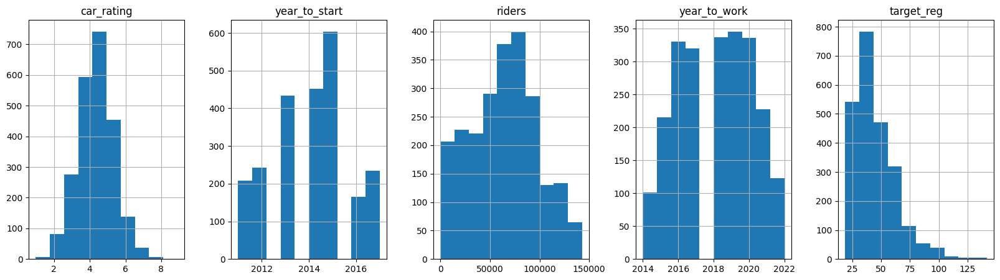

In [54]:
print('shape = ', train.shape)
train.hist(figsize=(20,5), layout = (-1, 5))
train.sample(5)

In [55]:
train.describe()

,car_rating,year_to_start,riders,year_to_work,target_reg
count,2337.000000,2337.000000,2337.000000,2337.000000,2337.000000
mean,4.354292,2014.040650,63711.443731,2018.069748,44.946735
std,0.996954,1.685852,33755.012096,2.159484,17.579568
min,0.980000,2011.000000,23.000000,2014.000000,18.920000
25%,3.740000,2013.000000,41053.000000,2016.000000,31.670000
50%,4.360000,2014.000000,64415.000000,2018.000000,40.170000
75%,5.000000,2015.000000,86515.000000,2020.000000,54.790000
max,8.900000,2017.000000,142862.000000,2022.000000,141.630000


## 1'st - submission.csv
- 0.087 accuracy
- only 'train' features

In [56]:
features2drop = ['car_id'] # то что надо выбросить 
targets = ['target_class', 'target_reg'] # таргеты
cat_features = ['car_type', 'fuel_type', 'model'] # категориальные признаки

filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]

print('cat_features :', len(cat_features), cat_features)
print('num_features :', len(num_features), num_features)
print('targets', targets)

cat_features : 3 ['car_type', 'fuel_type', 'model']
num_features : 4 ['car_rating', 'year_to_start', 'riders', 'year_to_work']
targets ['target_class', 'target_reg']


In [65]:
X = train[filtered_features].drop(targets, axis=1, errors='ignore')
y = train['target_class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = CatBoostClassifier(cat_features=cat_features)


clf.fit(X_train, y_train, 
          eval_set=(X_test, y_test),
          verbose=150, plot=False)

# инференс модели
y_pred = clf.predict(X_test)
print(f'\n Accuracy: {accuracy_score(y_test, y_pred)}')

Learning rate set to 0.109335
0:	learn: 2.1911361	test: 2.1951349	best: 2.1951349 (0)	total: 190ms	remaining: 3m 9s
150:	learn: 1.6539682	test: 2.2440578	best: 2.1908935 (6)	total: 8.48s	remaining: 47.7s
300:	learn: 1.2455381	test: 2.3306861	best: 2.1908935 (6)	total: 16.5s	remaining: 38.2s
450:	learn: 0.9685364	test: 2.4038621	best: 2.1908935 (6)	total: 24.7s	remaining: 30.1s
600:	learn: 0.7432300	test: 2.4962387	best: 2.1908935 (6)	total: 34s	remaining: 22.6s
750:	learn: 0.5835086	test: 2.5783601	best: 2.1908935 (6)	total: 43.7s	remaining: 14.5s
900:	learn: 0.4589187	test: 2.6654857	best: 2.1908935 (6)	total: 52.6s	remaining: 5.78s
999:	learn: 0.3990111	test: 2.7166606	best: 2.1908935 (6)	total: 58.8s	remaining: 0us

bestTest = 2.19089351
bestIteration = 6

Shrink model to first 7 iterations.

 Accuracy: 0.0876068376068376


In [74]:
test['target_class'] = clf.predict(test[filtered_features])
test[['car_id', 'target_class']].to_csv('subs/simple_baseline_v1.csv', index=False)
print('CSV file saved!')

CSV file saved!


## 2'nd - submission.csv
- adding 'rider' info
    - mutual index 'car_id' (for each car)
    - next info for each car
        - car mean rating
        - car total distance traveled
        - car minimal rating
        - car max speed reached
        - car's median user_ride_quality (mid number of set)
        - ??? (why count) deviation normal count
        - car number of unique user's 

In [198]:
f = lambda x: x.nunique()
rides_df_gr = rides_info.groupby('car_id', as_index=False).agg(mean_rating = ('rating', 'mean'),
                                                   distance_sum = ('distance', 'sum'),
                                                   rating_min = ('rating', 'min'),
                                                   speed_max = ('speed_max', 'max'),
                                                   user_ride_quality_median = ('user_ride_quality', 'median'), 
                                                   deviation_normal_count = ('deviation_normal', 'count'),
                                                   user_uniq = ('user_id', f))

rides_df_gr.head(2)

,car_id,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
0,A-1049127W,4.255,11257529.314,0.100,179.730,-0.288,174,172
1,A-1079539w,4.088,19127650.497,0.100,184.506,2.509,174,173


In [199]:
def add_featues(df):
    
    if 'mean_rating' not in df.columns:
        return df.merge(rides_df_gr, on = 'car_id', how = 'left')
    
    return df
    
    
train = add_featues(train)
test = add_featues(test)

In [85]:
train.to_csv('tmp_data/quickstart_train.csv', index=False)
test.to_csv('tmp_data/quickstart_test.csv', index=False)

**Updating 'features' type again**


In [204]:
features2drop = ['car_id'] # то что надо выбросить 
targets = ['target_class', 'target_reg'] # таргеты
cat_features = ['car_type', 'fuel_type', 'model'] # категориальные признаки

filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]


print('num_features :', len(num_features), num_features)
print('cat_features :', len(cat_features), cat_features)
print('targets', targets)

num_features : 11 ['car_rating', 'year_to_start', 'riders', 'year_to_work', 'mean_rating', 'distance_sum', 'rating_min', 'speed_max', 'user_ride_quality_median', 'deviation_normal_count', 'user_uniq']
cat_features : 3 ['car_type', 'fuel_type', 'model']
targets ['target_class']


In [205]:
X = train[filtered_features].drop(targets, axis=1, errors='ignore')
y = train['target_class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = CatBoostClassifier(cat_features=cat_features)


clf.fit(X_train, y_train, 
          eval_set=(X_test, y_test),
          verbose=150, plot=False)

# инференс модели
y_pred = clf.predict(X_test)
print(f'\n Accuracy: {accuracy_score(y_test, y_pred)}')

Learning rate set to 0.109335
0:	learn: 1.8475119	test: 1.8655808	best: 1.8655808 (0)	total: 52.4ms	remaining: 52.3s
150:	learn: 0.3231582	test: 0.5486651	best: 0.5486651 (150)	total: 8.1s	remaining: 45.6s
300:	learn: 0.2075673	test: 0.5523806	best: 0.5468018 (249)	total: 17.1s	remaining: 39.6s
450:	learn: 0.1390542	test: 0.5691520	best: 0.5468018 (249)	total: 25.9s	remaining: 31.5s
600:	learn: 0.0978476	test: 0.5819010	best: 0.5468018 (249)	total: 34.9s	remaining: 23.1s
750:	learn: 0.0743809	test: 0.5955979	best: 0.5468018 (249)	total: 43.4s	remaining: 14.4s
900:	learn: 0.0583324	test: 0.6093163	best: 0.5468018 (249)	total: 51.9s	remaining: 5.71s
999:	learn: 0.0504530	test: 0.6189690	best: 0.5468018 (249)	total: 57.3s	remaining: 0us

bestTest = 0.5468017582
bestIteration = 249

Shrink model to first 250 iterations.

 Accuracy: 0.7863247863247863


In [88]:
fi = clf.get_feature_importance(prettified=True)
fi

,Feature Id,Importances
0,speed_max,36.034645
1,mean_rating,30.903684
2,rating_min,13.938537
3,model,4.206258
4,car_type,3.881288
5,user_uniq,3.035950
6,user_ride_quality_median,2.097702
7,distance_sum,1.614279
8,riders,1.347984
9,car_rating,1.149331


In [109]:
test['target_class'] = clf.predict(test[filtered_features])
test[['car_id', 'target_class']].to_csv('subs/simple_baseline_v2.csv', index=False)
print('CSV file saved!')

CSV file saved!


___
# <font color='pink'> 📊 2.3 **Visuals** --- (seaborn & pandas) </font>
- correlation heatmap || hist || 2d dependence || box plots

➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖
## **What for --- explaining - hist, correlation, heatmaps, box plot**

__

<font color='orange'> **Why we need visualization?** </font>
- **generating (choosing) and analyzing features** - easy to find GOOD features
- to understand how **data structured + how model works** - features should properly describe target (not every model can handle different data - like non-normal data)
- **for information for other people** (in production)

__

<font color='orange'> All about **HISTOGRAMS** </font>

__

<font color='orange'> All about **CORRELATION and HEATMAPS** </font>

- A correlation coefficient of 1 indicates a perfect positive correlation, while a correlation coefficient of -1 indicates a perfect negative correlation. A correlation coefficient of 0 indicates no correlation between the features.
- You have a **'target' feature** - we want features that correlate with it (strongly positive OR strongly negative) + some weak correlation (additional information)
- We **DON'T WANT** features that CORRELATE with EACH OTHER - it's **multicollinearity** 
    - usually **it's bad for regression models** - unstable regression coefficients | high standard errors | difficulties with interpreting individual effects of each predictor variables
    - there are some '+' though: 
        - can increase the precision or accuracy of the regression coefficients (they can reinforce each other's effect on the response variable)
        - can help identify redundant or unnecessary predictor variables in the model (they are likely measuring the same underlying concept or construct)
        - can help detect interaction effects between predictor variables (it can be easier to detect interaction effects and include them in the regression model)
        
__
        
<font color='orange'> All about **BOX PLOTS** </font>
- Details
    - median (line in square)
    - quartile - % of 'amount' are in this range
    - Q1 & Q3 - 25% (lower quartile) and 75% (upper quartile) - IQR (Interquartile Range) [50% of scores]
    - "Minimum" = Q1 - 1.5 * IQR
    - "Maximum" = Q3 + 1.5 * IQR
    - outliers - the ones that below/above "Min/Max"
- **What it shows** (information)
    - distribution - 'non-normal' data ---> need models robust to non-normal data
    - skewed data (positive/negative) [median position in box] ---> need models robust to skewness ---> SVM, gradient boosting
    - outliers ---> need robust models (or can be removed)
    - data scattering & disperse of data ---> large Box = disperse data | the longer whiskers (Min/Max) - the wider distribution
    - Box plot comparison
        - if median line of 1st group lies OUTSIDE THE BOX of 2nd group ---> there is a difference between groups
        - then models with categorical handling is better (trees, logistic regression)

➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖
## **Pandas visual practice**
1) **Hist** (x - feature, Y - amount of data with that value)
2) **Box plot**
3) **Heatmap**

➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖

In [5]:
import numpy as np
import pandas as pd

#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/car_train.csv'
train = pd.read_csv('data\\car_train.csv')   # car_train - информация про машины с таргетом
test = pd.read_csv('data\\car_test.csv')

#url = 'https://drive.google.com/uc?id=1eqFIZCJTkXY-PsTeS-uz_DousIH3XQu-'  
rides_info = pd.read_csv('data\\rides_info.csv') # rides_info - информация про поездки

#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/driver_info.csv' 
driver_info = pd.read_csv('data\\driver_info.csv')  # driver_info - информация про водителей

#url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/fix_info.csv'
fix_info = pd.read_csv('data\\fix_info.csv')  # fix_info - информация про ремонт машин

In [6]:
cars = train.copy()
rides_info = rides_info.merge(cars, on="car_id", how="right")
rides_info = rides_info.merge(driver_info, on="user_id", how="left")

### Hist

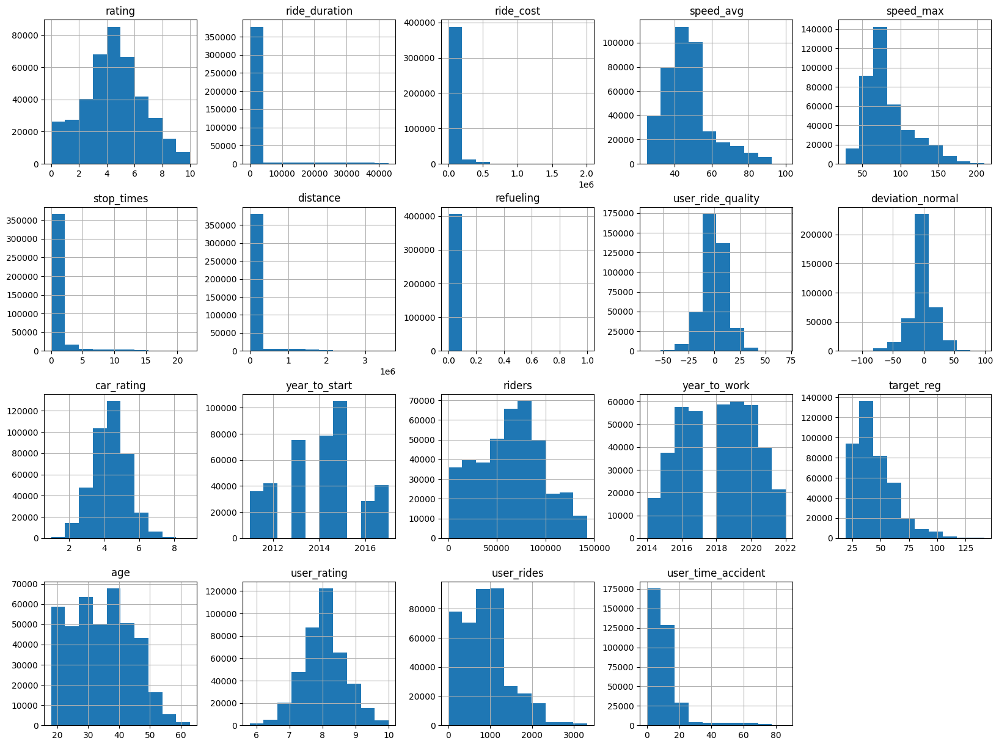

In [417]:
# ; убирает лишний вывод

rides_info.drop("sex", axis=1).hist(figsize=(20,15), layout=(-1,5));

### Boxplot

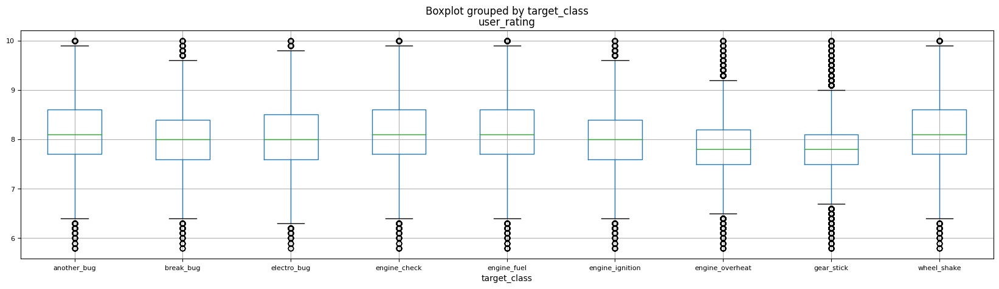

In [419]:
rides_info.boxplot(
    column=["user_rating"], by="target_class", fontsize=8, figsize=(20,5)
);

### Heatmap (Correlation)

In [423]:
corr = rides_info.corr().round(2)

#corr
corr.style.background_gradient(cmap="RdYlGn")

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_3944\2929599966.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = rides_info.corr().round(2)


,rating,ride_duration,ride_cost,speed_avg,speed_max,stop_times,distance,refueling,user_ride_quality,deviation_normal,car_rating,year_to_start,riders,year_to_work,target_reg,age,user_rating,user_rides,user_time_accident,sex
rating,1.000000,0.000000,0.000000,-0.090000,-0.230000,-0.060000,-0.000000,0.000000,-0.000000,-0.040000,0.000000,0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,-0.000000,0.000000,-0.000000
ride_duration,0.000000,1.000000,0.920000,-0.000000,0.000000,0.010000,0.960000,0.000000,0.000000,-0.000000,0.000000,0.000000,0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,-0.000000,0.000000
ride_cost,0.000000,0.920000,1.000000,-0.000000,-0.000000,0.010000,0.880000,0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.010000,0.000000,-0.000000,-0.000000
speed_avg,-0.090000,-0.000000,-0.000000,1.000000,0.500000,-0.130000,0.060000,0.000000,-0.010000,0.040000,-0.000000,-0.000000,-0.000000,0.000000,-0.020000,0.000000,-0.000000,-0.000000,-0.020000,-0.000000
speed_max,-0.230000,0.000000,-0.000000,0.500000,1.000000,0.050000,0.030000,-0.000000,-0.010000,0.090000,0.000000,-0.010000,-0.010000,-0.000000,0.150000,-0.000000,0.010000,-0.000000,0.000000,0.000000
stop_times,-0.060000,0.010000,0.010000,-0.130000,0.050000,1.000000,-0.010000,-0.000000,0.020000,0.000000,0.020000,0.010000,0.010000,0.000000,0.190000,-0.000000,0.030000,-0.000000,0.100000,0.010000
distance,-0.000000,0.960000,0.880000,0.060000,0.030000,-0.010000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010000,-0.000000,-0.000000,-0.000000,-0.000000,0.000000
refueling,0.000000,0.000000,0.000000,0.000000,-0.000000,-0.000000,0.000000,1.000000,0.000000,-0.000000,-0.000000,0.000000,0.000000,-0.000000,0.000000,0.000000,-0.000000,-0.000000,-0.000000,-0.000000
user_ride_quality,-0.000000,0.000000,0.000000,-0.010000,-0.010000,0.020000,0.000000,0.000000,1.000000,-0.010000,0.020000,-0.020000,-0.020000,0.020000,0.030000,-0.000000,-0.000000,0.000000,0.010000,0.000000
deviation_normal,-0.040000,-0.000000,0.000000,0.040000,0.090000,0.000000,0.000000,-0.000000,-0.010000,1.000000,0.020000,0.010000,0.010000,-0.000000,0.100000,0.000000,0.030000,0.000000,0.050000,-0.000000


In [426]:
# distribution of target between categorical variables

pd.crosstab(
    rides_info["target_class"],
    rides_info["model"],
    # margins = True,
    normalize = True,
).style.background_gradient(cmap="RdYlGn")

model,Audi A3,Audi A4,Audi Q3,BMW 320i,Fiat 500,Hyundai Solaris,Kia Rio,Kia Rio X,Kia Rio X-line,Kia Sportage,MINI CooperSE,Mercedes-Benz E200,Mercedes-Benz GLC,Mini Cooper,Nissan Qashqai,Renault Kaptur,Renault Sandero,Skoda Rapid,Smart Coupe,Smart ForFour,Smart ForTwo,Tesla Model 3,VW Polo,VW Polo VI,VW Tiguan,Volkswagen ID.4
target_class,,,,,,,,,,,,,,,,,,,,,,,,,,
another_bug,0.000856,0.001284,0.001284,0.000856,0.000000,0.010697,0.006846,0.008130,0.007702,0.009414,0.002567,0.000428,0.001284,0.000428,0.006846,0.006846,0.009414,0.006846,0.004707,0.008986,0.002995,0.000856,0.003851,0.008986,0.006846,0.000428
break_bug,0.001284,0.001712,0.000000,0.000428,0.001284,0.005563,0.005991,0.005563,0.005135,0.008986,0.001712,0.001284,0.000856,0.000428,0.004279,0.008558,0.008130,0.010270,0.006846,0.007702,0.006846,0.000428,0.008558,0.005563,0.007702,0.000428
electro_bug,0.001284,0.000428,0.002567,0.000428,0.000428,0.005563,0.005135,0.005991,0.007274,0.005563,0.000000,0.001284,0.002139,0.000856,0.007274,0.005991,0.005135,0.007274,0.005563,0.005563,0.008130,0.000856,0.006418,0.007702,0.005991,0.001712
engine_check,0.000856,0.001284,0.000428,0.002139,0.001284,0.007274,0.004707,0.006846,0.005563,0.007702,0.001284,0.002567,0.000000,0.001712,0.005991,0.009414,0.005135,0.008558,0.005135,0.006846,0.006418,0.000856,0.009842,0.007702,0.005991,0.000000
engine_fuel,0.000856,0.000856,0.001712,0.000428,0.000000,0.009414,0.004707,0.004707,0.007702,0.008130,0.000000,0.000856,0.000856,0.002139,0.008130,0.009414,0.009414,0.005563,0.005135,0.007702,0.005991,0.001284,0.007702,0.002995,0.005563,0.000856
engine_ignition,0.000856,0.000856,0.000428,0.001284,0.000428,0.007274,0.005135,0.008558,0.005991,0.006418,0.000856,0.000000,0.000000,0.001284,0.012837,0.004707,0.009842,0.006846,0.007274,0.008558,0.005991,0.000856,0.005135,0.006418,0.006846,0.000428
engine_overheat,0.000428,0.001284,0.001712,0.000428,0.002139,0.008558,0.004707,0.006418,0.006846,0.008130,0.001712,0.002139,0.001284,0.002139,0.009842,0.010270,0.010270,0.004279,0.004707,0.007274,0.006846,0.000000,0.006846,0.007274,0.006846,0.001284
gear_stick,0.000856,0.000856,0.000856,0.000856,0.002139,0.007702,0.005563,0.006418,0.007274,0.008558,0.000856,0.001284,0.000856,0.000428,0.007274,0.010697,0.007702,0.007274,0.006418,0.008986,0.007702,0.000856,0.006418,0.008558,0.004707,0.000428
wheel_shake,0.000000,0.000000,0.000000,0.000000,0.000000,0.006846,0.004707,0.008558,0.006418,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.005991,0.004707,0.005991,0.004707,0.000000,0.005563,0.009842,0.007274,0.000000


➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖
## **Seaborn visual practice**
- functions
    - replot()
        - line + scatter (X-Y-class dependencies)
    - displot()
        - distribution + 2d maps dependencies
    - catplot()
        - box plot + count + scatter --- categorical features
    - heatmap()
        - correlation between features
    - pd.crosstab + heatmap()
        - correlation between features AND PARTICULAR ELEMENTS
    - pairplot()
        - pair dependencies between features 
    - lmplot
        - pair dependencies + line (linear)
    - jointplot()
        - scatter diagram + distribution
    
➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖➖

In [9]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme()  # can set themes

### 1) sns.replot()
__

- basically  [sns.catterplot() + sns.lineplot()] - **via 'kind' parameter** ('line' - 'scatter')
- parameters
    - data | x | y --- dataframe | X axis | Y axis
    - hue | style | size --- color points according to that categorical variable
    - kind --- 'line' or 'scatter'
    - alpha, aspect --- zoom & size
    - legend --- color info on the right
    - g.set_xticklabels(rotation=45, horizontalalignment="right", step=2) --- setting labels in X-axis ()
        - rotate 45 degrees
        - right shift
        - with 2 step 

__

📕 **Info from graphics that CAN BE USED AS FEATURES** - a feature should help predict 'label of class' !!!
1) --  'engine_fuel' and 'engine_ignition' - can be characterized by extreme direction change [**can be used as feature** - some parameter that would correlate with this turning point]
2) --  starting points in 'ride_date / user_ride_quality' can be a feature
3) --  angles of from tilt to curve maybe???
4) --  feature = ride_cost / ride_duration
    - since 'ride_cost' can be description of problem WITH different 'ride_duration'
        - for simple problem no matter the duration - cost is low
        - for big problem - cost is high
5) -- certain type of problems (targets) are only for low rating rides

__

‼️ **Keep in mind**:
- it's good to use as 'X-axis' - time, categorical, numerical 'feature'
- it's good to color in 'target_class' color

**Info:** (sns.replot - rides_info - ride_date X deviation_normal - target_class) - LINE
- deviation_normal is different according to 'target_class'
- the 'middle point' where direction changes can be used as 'feature'

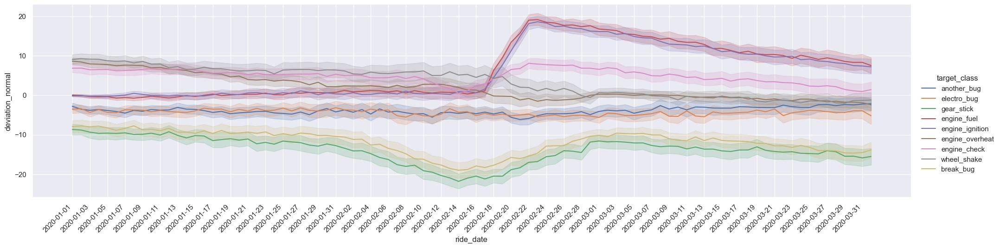

In [428]:
g = sns.relplot(
data=rides_info,
x="ride_date",
y="deviation_normal",
hue="target_class", # color 
kind="line", # or 'scatter'
aspect=4,
)
g.set_xticklabels(rotation=45, horizontalalignment="right", step=2);

**Info:** (sns.replot - rides_info - ride_date X user_ride_quality - target_class) - LINE
- starting point on different heights depending of 'target_class'

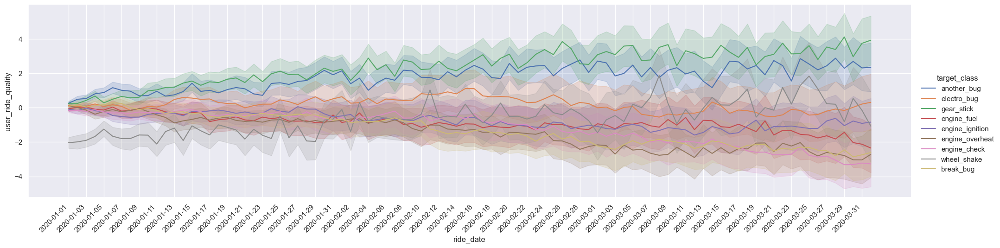

In [429]:
g = sns.relplot(
data=rides_info,
x="ride_date",
y="user_ride_quality",
kind="line",
hue="target_class",
aspect=4,
)
g.set_xticklabels(rotation=45, horizontalalignment="right", step=2);

In [ ]:
# Same but using matplotlib

# import matplotlib.pyplot as plt
# import matplotlib.ticker as ticker
#
# plt.figure(figsize=(20, 5))
# g = sns.lineplot(
# data=rides_info,
# x="ride_date",
# y="deviation_normal",
# hue="target_class",
# )
# g.set_xticklabels(g.get_xticklabels(), rotation=45, hor

**Info:** (sns.replot - rides_info - ride_date X deviation_normal - target_class) - LINE - for 10 cars only

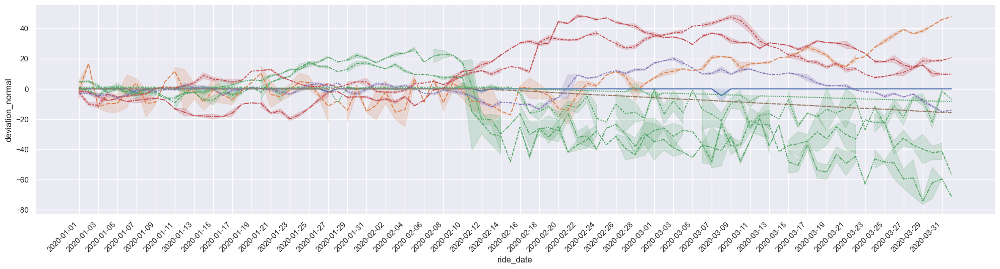

In [431]:
# Only 10 cars
tmp = rides_info[rides_info["car_id"].isin(rides_info.car_id.unique()[:10])]

g = sns.relplot(
data=tmp,

x="ride_date",
y="deviation_normal",

hue="target_class",
style="car_id",

legend=False,
kind="line",
aspect=4,
)
g.set_xticklabels(rotation=45, horizontalalignment="right", step=2)

**Info:** (sns.replot - rides_info - ride_duration X ride_cost - target_class) - SCATTER
- for different cars (target class) angle is different
- **feature = ride_cost / ride_duration might be a good feature**
- good idea to play with row and col to create this graphic with CUTS into DIFFERENT categorical features

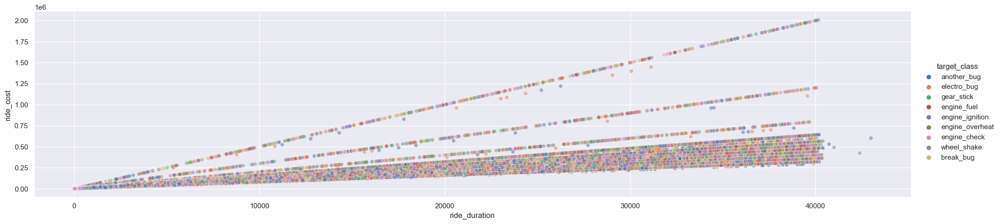

In [432]:
g = sns.relplot(
data=rides_info,
x="ride_duration",
y="ride_cost",
hue="target_class",

kind="scatter",
aspect=4,
alpha=0.5,
);

**Info:** (sns.replot - rides_info - target_class X user_time_accident - car_type) - SCATTER
- use not only 'time' line as X, but also categorical variables !!!

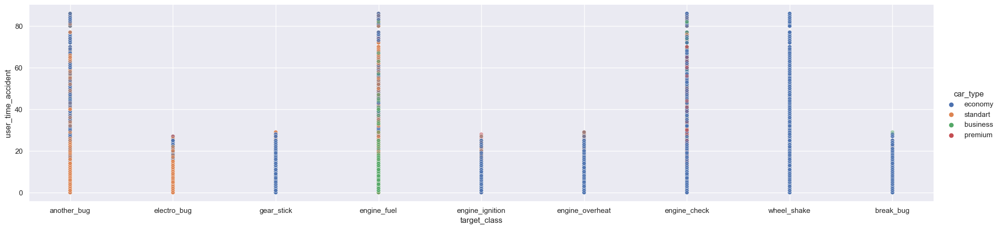

In [433]:
g = sns.relplot(
data=rides_info,
x="target_class",

y="user_time_accident",

hue="car_type",
kind="scatter",
aspect=4,
alpha=0.5,
);

**Info:** (sns.replot - rides_info - rating X user_time_accident - target_class) - SCATTER
- some classes of car breaking (target_class) are for rides with 'low rating'

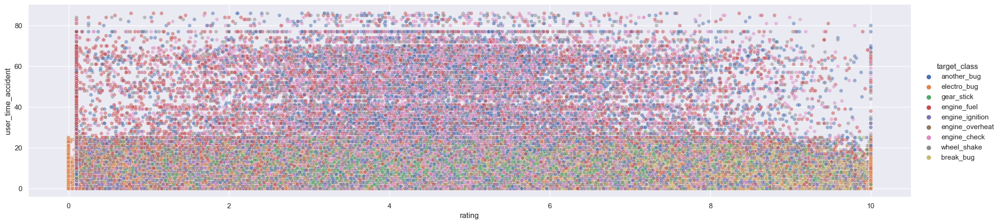

In [435]:
sns.relplot(
data=rides_info,
x="rating",
y="user_time_accident",
hue="target_class",
kind="scatter",
aspect=4,
alpha=0.5,
);

### 2) sns.displot()
- basically (sns.histplot() + kdeplot() + ecdfplot()) - **via 'kind' parameter**
- figsize ~ height + aspect

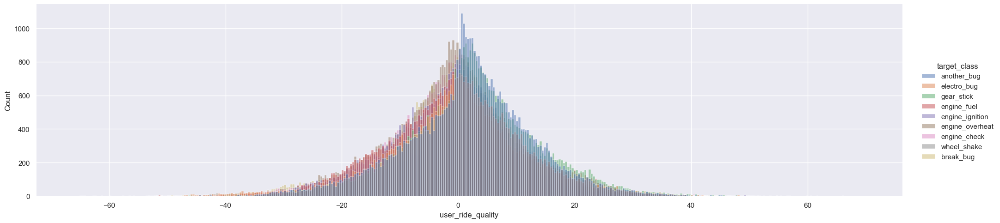

In [438]:
tmp = rides_info[rides_info["car_id"].isin(rides_info.sample(100).car_id.unique()[:20])]
g = sns.displot(
data=rides_info,

x="user_ride_quality",
# y="user_time_accident",

hue="target_class",
legend=True,
aspect=4,
kind="hist", # kde
alpha=0.5,
);

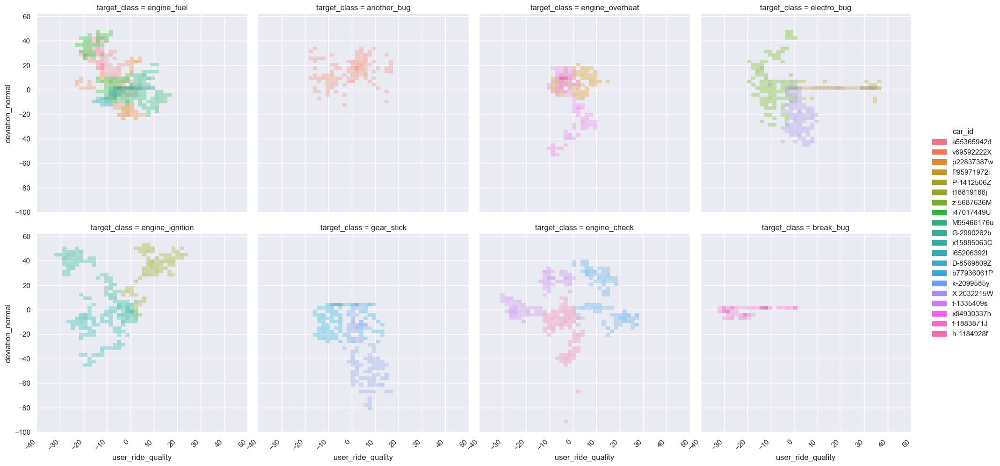

In [440]:
tmp = rides_info[rides_info["car_id"].isin(rides_info.sample(100, random_state=10).car_id.unique()[:20])]


g = sns.displot(
data=tmp,

x="user_ride_quality",
y="deviation_normal",

aspect=1,
# kind="kde",
alpha=0.5,

hue="car_id",
col="target_class",   # grapic for EACH 'target_class'

col_wrap=4,   # number of lines on graphic

).set_xticklabels(rotation=45, horizontalalignment="right");

### 3) sns.catplot() - (categorical features)
- basically (boxplot + violinplot + boxenplot + stripplot + swaprmplot + pointplot + barplot + countplot) - **via 'kind' parameter**

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  self._figure.tight_layout(*args, **kwargs)


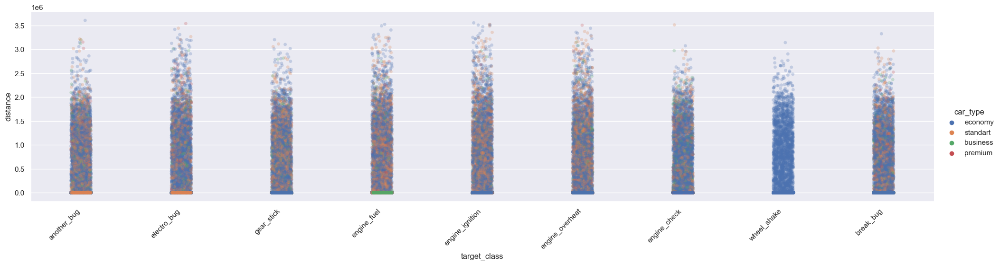

In [441]:
sns.catplot(
data=rides_info,
x="target_class",
y="distance",

aspect=4,
hue="car_type",
alpha=0.25,

).set_xticklabels(rotation=45, horizontalalignment="right");

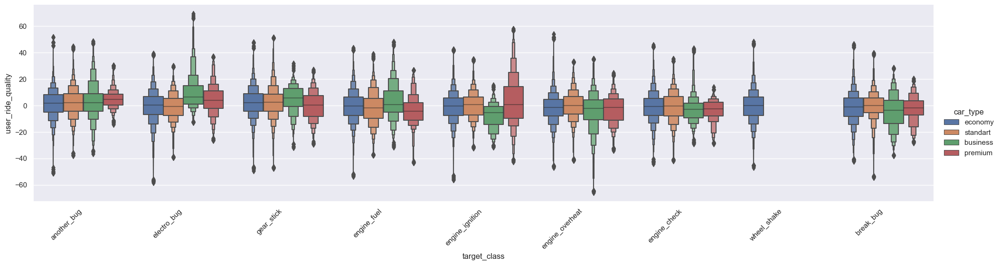

In [442]:
sns.catplot(
data=rides_info,
x="target_class",
y="user_ride_quality",
hue="car_type",
aspect=4,
kind="boxen",
).set_xticklabels(rotation=45, horizontalalignment="right");

### 4) sns.heatmap()
- triangle 'heat_map' just helps to see only useful information (since it's mirrored)

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_3944\1195486106.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data=rides_info.corr().round(2),


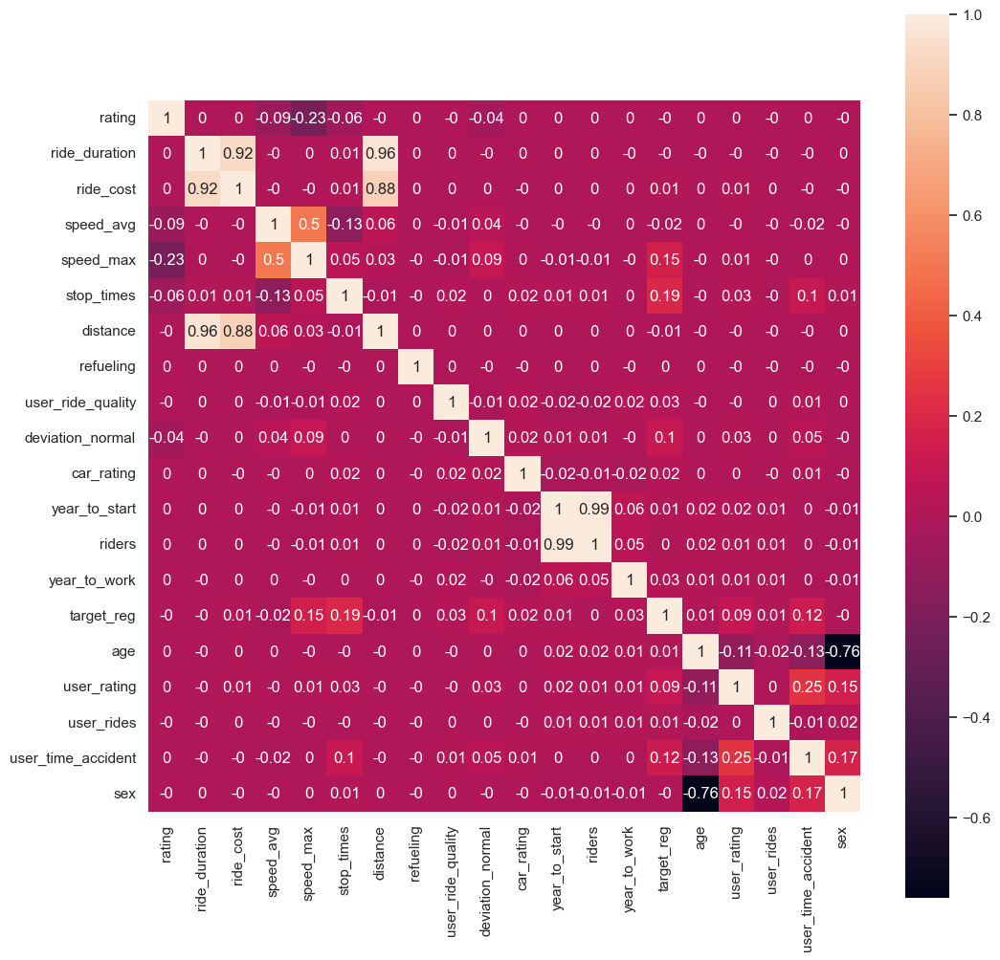

In [444]:
plt.rcParams["figure.figsize"] = (12, 12)

sns.heatmap(
data=rides_info.corr().round(2),
square=True,
annot=True,
);

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_3944\3531076508.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  rides_info.corr().round(2),


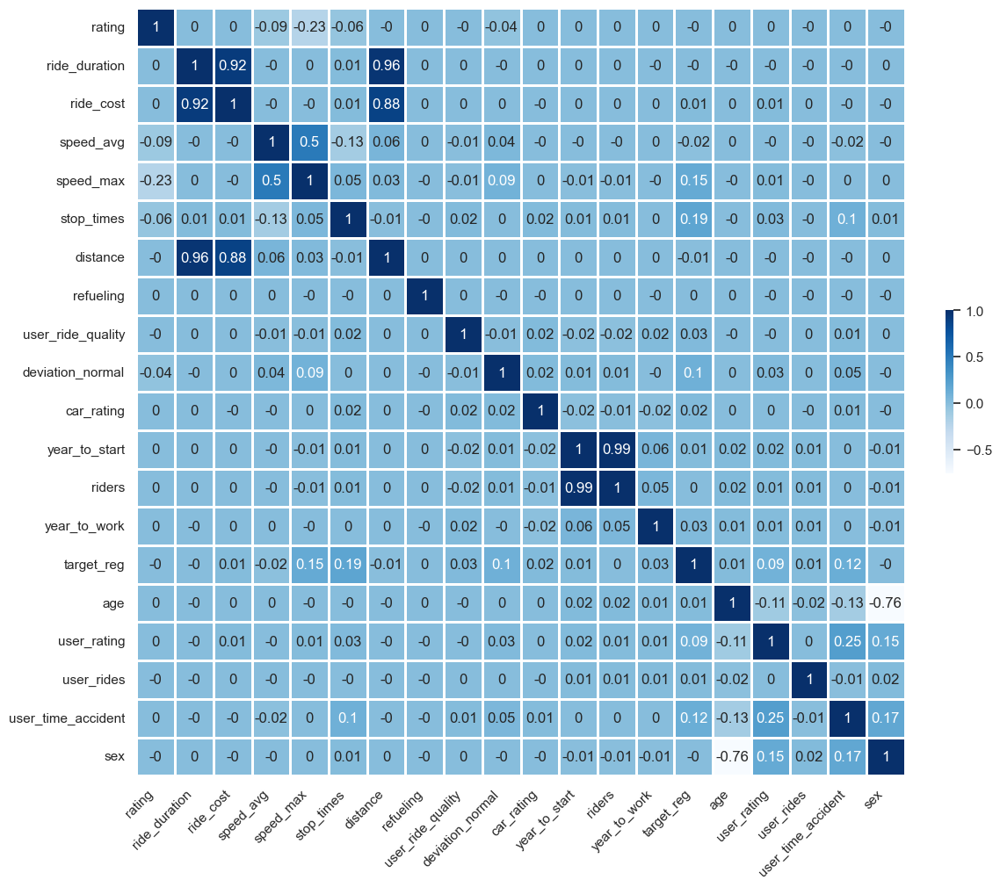

In [445]:
heatmap = sns.heatmap(
rides_info.corr().round(2),
annot=True,
square=True,

cmap="Blues", # использовать синию цветовую карту
cbar_kws={"fraction": 0.01}, # боковой колор-бар (shrink colour bar)
linewidth=2, # пространство между клетками
)
heatmap.set_xticklabels(
heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
);

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_3944\2846983893.py:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mask = np.triu(np.ones_like(rides_info.corr(), dtype=bool))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_3944\2846983893.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  rides_info.corr().round(2),


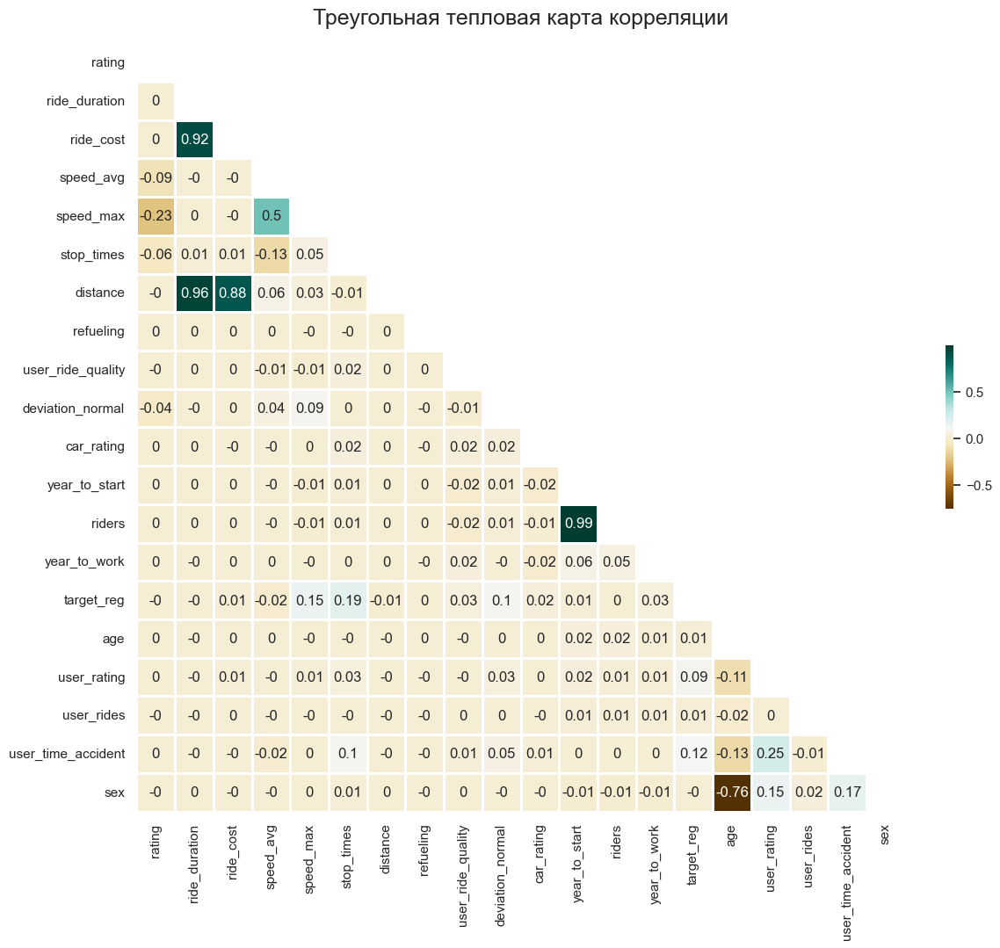

In [447]:
sns.set_style("whitegrid")
# Воспользуемся функциями np.triu, чтобы изолировать верхний треугольник (np.tril нижний
# функция np.ones_like() изменит все изолированные значения на 1.
mask = np.triu(np.ones_like(rides_info.corr(), dtype=bool))
heatmap = sns.heatmap(
rides_info.corr().round(2),
annot=True,
square=True,
cmap="BrBG",
cbar_kws={"fraction": 0.01},
linewidth=1,

mask=mask,
)
heatmap.set_title(
"Треугольная тепловая карта корреляции", fontdict={"fontsize": 18}, pad=16
);

### -) pd.crosstab + sns.heatmap

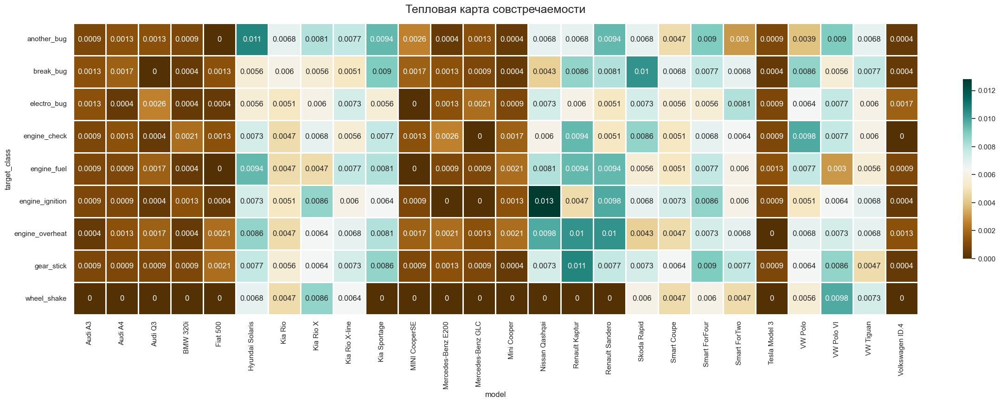

In [11]:
plt.rcParams["figure.figsize"] = (25, 25)

crst = pd.crosstab(
rides_info["target_class"],
rides_info["model"],
normalize=True,
).round(4)
heatmap = sns.heatmap(
crst,
annot=True,
square=True,
cmap="BrBG",
cbar_kws={"fraction": 0.01},
linewidth=1,
)

heatmap.set_title("Тепловая карта совстречаемости", fontdict={"fontsize": 18}, pad=16);

### -) pair dependencies between features & sns.pairplot()

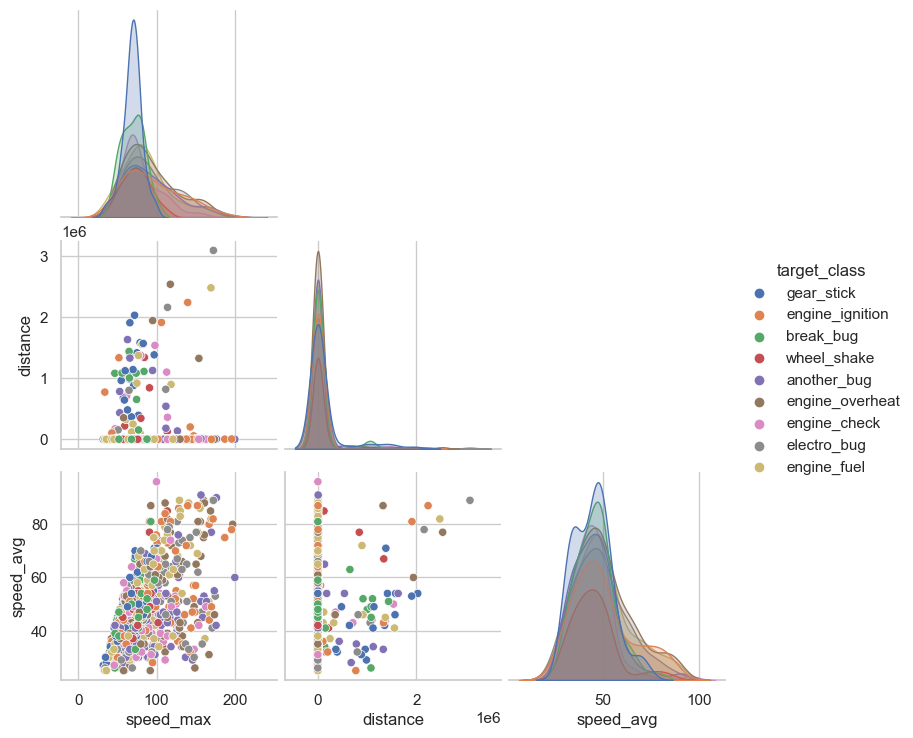

In [450]:
sns.pairplot(
rides_info.sample(1000),
vars=["speed_max", "distance", "speed_avg"],
corner=True,
hue="target_class",
);

### -) sns.lmplot = sns.pairplot + STRAIGHT LINE

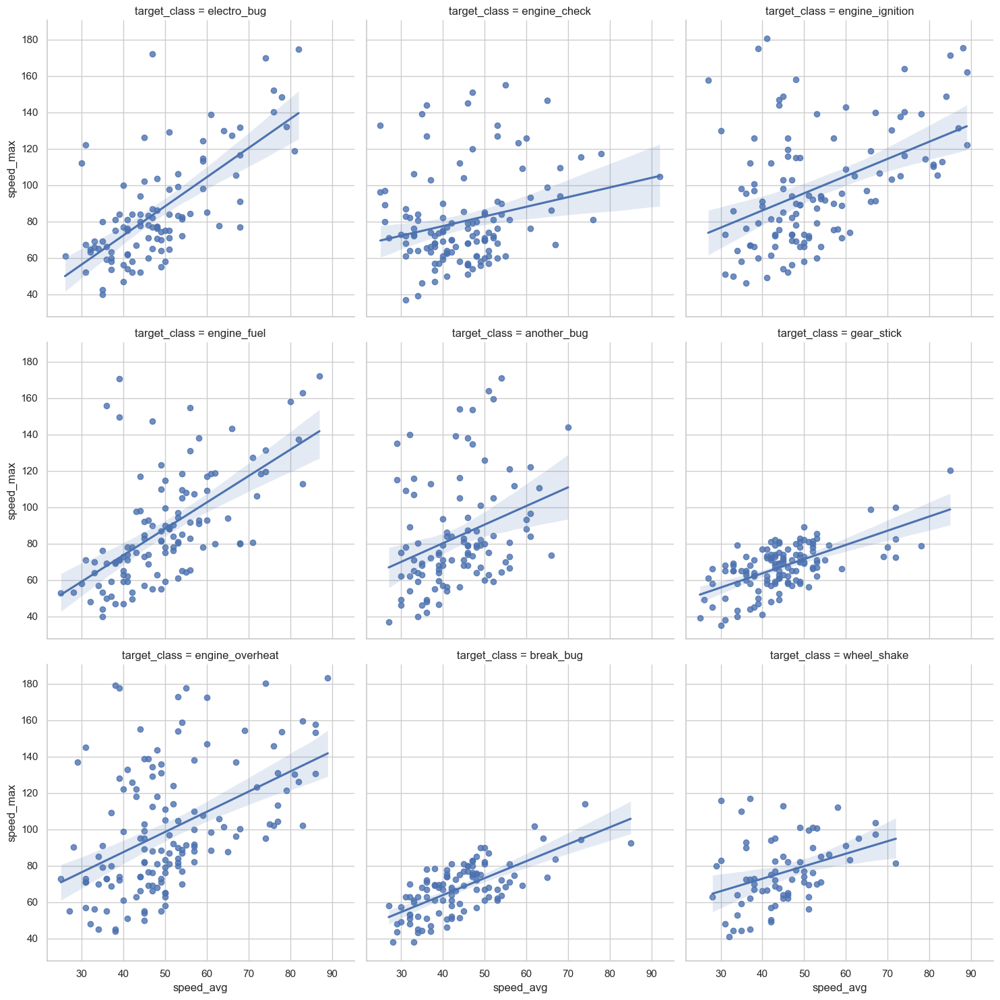

In [451]:
sns.lmplot(
data=rides_info.sample(1000),
x="speed_avg",
y="speed_max",

col="target_class",

col_wrap=3,
);

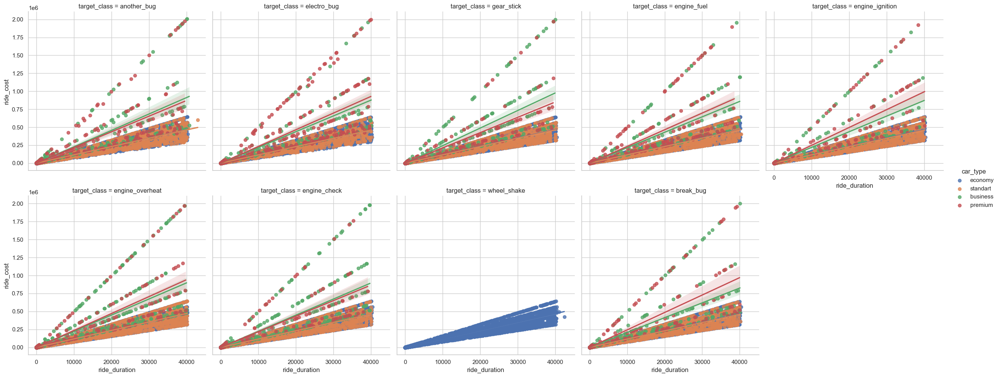

In [452]:
sns.lmplot(
data=rides_info,
x="ride_duration",
y="ride_cost",
col="target_class",

hue="car_type",

col_wrap=5,
);

### -) sns.jointplot()

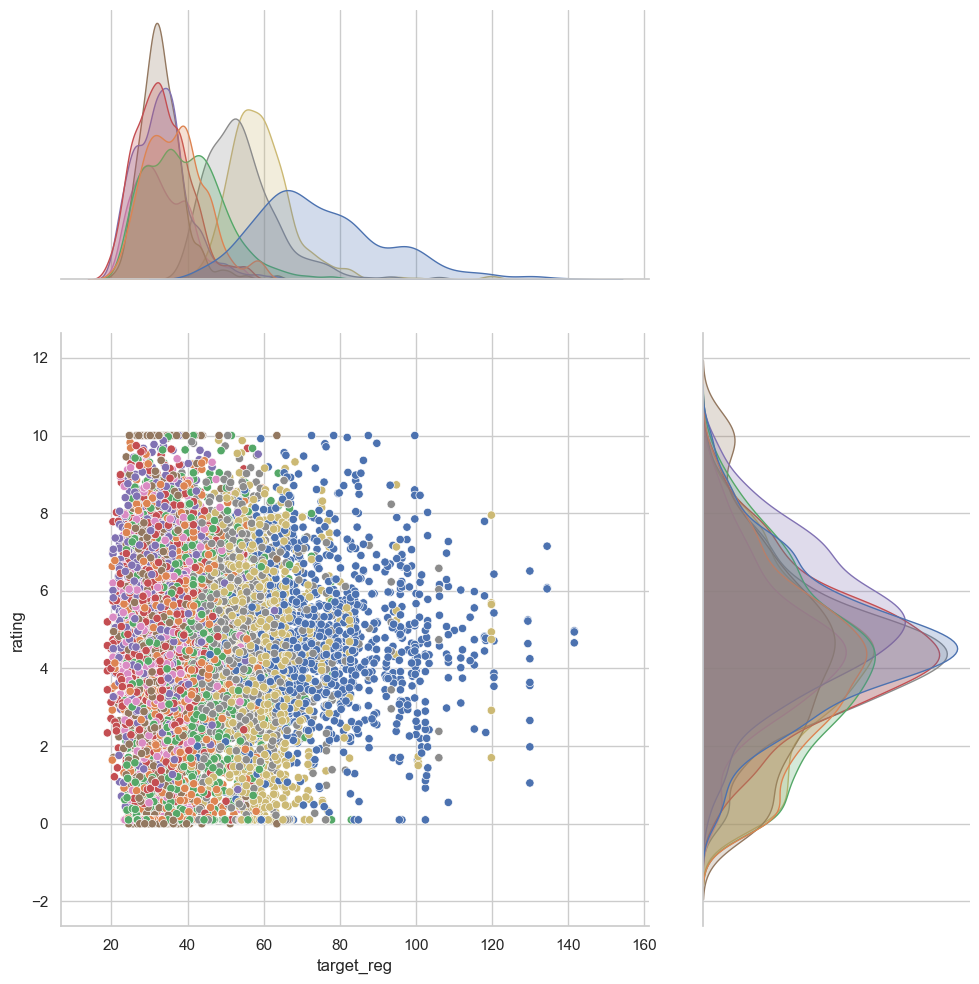

In [453]:
sns.jointplot(
data=rides_info.sample(10_000),
x="target_reg",
y="rating",
hue="target_class",
height=10,
legend=False,
ratio=2,
kind="scatter",
);

___
# <font color='pink'> ♻️ 2.4 **Validation** --- (model validations techniques): </font>
- helps understand what 'hypothesis' work and change things
- good validation correlates with leaderboard score
- helps to find statistically significant improvement from tested hypotheses

__

<font color='orange'> **Validations techniques:** </font>
- KFold -------------> take train, split groups (N), finding and take average
- StratifiedKFold ----> same as KFold - but for unbalanced classes
- GroupKFold -------> for groups that shouldn't appear together in train/test
- RepeatedKFold -----> KFold but repeated (different seeds)
- Shuffle Split --------> shuffles samples ---> then KFold
- Time Series Split ----> if 'time component' in data
- Leave One Out (LOO) ---------> deletes ONLY 1 sample from every dataset for every folder (creates various SETS for training)
    - Leave One Group Out ----> same but deletes 1 sample GROUP
    - Leave P Out --------------> deletes P samples - generates (values in SETS can repeat)
- StratifiedGroupKFold
- RepeatedStratifiedKFold 
- RepeatedStratifiedGroupKFold = StratifiedGroupKFold with different seeds
- <font color='orange'> **Some parameters & hints** </font>: example -------> for fold, (train_index, test_index) in enumerate(kf.split(X=train, y=target))
    - fold coming from 'enumerate'
    - drop 'target' before using !!!
    - train_index - indexes for 'train' fold ||| test_index - for 'test' single fold

__

<font color='orange'> **When to use:** </font>
- **BIG** data, fast learning** ----------> **KFold**
- **LOW** data, fast learning** ----------> **LeaveOneOut**
- **TOO BIG** data, long learning -------> **train_test_split**
- **TIME** component ------------------> **TimeSeriesSplit**
- **balance CLASSES** in folds ---------> **Stratified**
- **CLASSES dont intersect** in train/test ---> **Group**

__

<font color='orange'> **Things to remember when doing validation training/testing:** </font>
- 'fix seeds'
- 'model saving' of all folds (for predicting right after)
- 'avg' + 'variance' ---> if 'variance' is high (depending on problem) - then might be 'dataleak' or 'overfitting'
- 'early stopping' usage ---> good practice to stop model BEFORE early stopping to check if model really not overfitting & local validation correlates to leaderboard
- 'custom metric' calculation
- 'setting of correlation of validation to leaderboard'
    - leaderboard probably has some fixed seeds in it ---> you can save your scores and achieve good correlation (strong, corr=1)
    - then it's gonna be easy to understand if model will perform better ---> better locally (corr=1) - better in submitting

__

<font color='orange'> **Some general advices:** </font>
- different validation diversify (vary) model
- validation speeds-up 'hypothesis testing' (test ---> instant result)
- KFold validation gives non-biased estimation of metric
- if problems in 'data' or 'problem definition' ---> it's gonna be easy to spot
- not all validation techniques can be adjusted to any size of data


## **Working with code (example)**

### **Data**
- loading data + merging different tables (adding some useful features)
- output ---> train, test
- features

In [21]:
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm

In [24]:
train = pd.read_csv("data/car_train.csv")
test = pd.read_csv("data/car_test.csv")
# train.hist(figsize=(25, 5), layout=(-1, 5))
train.sample(3)

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class
1555,z-3757964J,Smart ForTwo,economy,petrol,4.86,2013,44050,2018,33.06,gear_stick
2012,a-2277951A,Kia Sportage,standart,petrol,4.60,2013,42786,2021,31.29,engine_fuel
6,Q-9368117S,Nissan Qashqai,standart,petrol,5.32,2012,24611,2014,54.79,engine_overheat


In [25]:
path = "data/rides_info.csv"
rides = pd.read_csv(path)  # Данные по поездкам
# rides.hist(figsize=(15, 5), layout=(-1, 3))
rides.sample(3)

,user_id,car_id,ride_id,ride_date,rating,ride_duration,ride_cost,speed_avg,speed_max,stop_times,distance,refueling,user_ride_quality,deviation_normal
115405,Z41759675V,I-2247201A,X1V,2020-01-24,3.91,17,506,55,115.636264,2,798.336386,0,12.797440,14.419
333533,t10249021w,X58767632q,M1T,2020-03-19,2.62,24,259,48,91.276958,1,1138.084820,0,-25.433934,2.706
570450,g15131981S,o-3502321X,j1i,2020-02-11,2.28,52,670,49,66.000000,3,1329.299942,0,12.625255,-2.017


In [26]:
f = lambda x: x.nunique()
rides_df_gr = rides.groupby("car_id", as_index=False).agg(
    mean_rating=("rating", "mean"),
    distance_sum=("distance", "sum"),
    rating_min=("rating", "min"),
    speed_max=("speed_max", "max"),
    user_ride_quality_median=("user_ride_quality", "median"),
    deviation_normal_count=("deviation_normal", "count"),
    user_uniq=("user_id", f),
)


rides_df_gr.head(2)

,car_id,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
0,A-1049127W,4.255172,1.125753e+07,0.1,179.729652,-0.288229,174,172
1,A-1079539w,4.088046,1.912765e+07,0.1,184.505566,2.508746,174,173


In [27]:
def add_featues(df):

    if "mean_rating" not in df.columns:
        return df.merge(rides_df_gr, on="car_id", how="left")

    return df


train = add_featues(train)
test = add_featues(test)

In [28]:
cat_features = ["car_type", "fuel_type", "model"]
train = pd.get_dummies(train, columns=cat_features)
test = pd.get_dummies(test, columns=cat_features)

train.head(4)

,car_id,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,...,model_Renault Sandero,model_Skoda Rapid,model_Smart Coupe,model_Smart ForFour,model_Smart ForTwo,model_Tesla Model 3,model_VW Polo,model_VW Polo VI,model_VW Tiguan,model_Volkswagen ID.4
0,y13744087j,3.78,2015,76163,2021,108.53,another_bug,4.737759,1.214131e+07,0.1,...,0,0,0,0,0,0,0,0,0,0
1,O41613818T,3.90,2015,78218,2021,35.20,electro_bug,4.480517,1.803909e+07,0.0,...,0,0,0,0,0,0,0,1,0,0
2,d-2109686j,6.30,2012,23340,2017,38.62,gear_stick,4.768391,1.588366e+07,0.1,...,1,0,0,0,0,0,0,0,0,0
3,u29695600e,4.04,2011,1263,2020,30.34,engine_fuel,3.880920,1.651883e+07,0.1,...,0,0,0,0,0,0,0,0,0,0


In [29]:
features2drop = ["car_id", "target_reg"]  # То, что можно выбросить
targets = ["target_class", "target_reg"]  # Таргеты
cat_features = ["car_type", "fuel_type", "model"]

filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]


print("cat_features :", len(cat_features), cat_features)
print("num_features :", len(num_features), num_features)
print("targets", targets)

cat_features : 3 ['car_type', 'fuel_type', 'model']
num_features : 43 ['car_rating', 'year_to_start', 'riders', 'year_to_work', 'mean_rating', 'distance_sum', 'rating_min', 'speed_max', 'user_ride_quality_median', 'deviation_normal_count', 'user_uniq', 'car_type_business', 'car_type_economy', 'car_type_premium', 'car_type_standart', 'fuel_type_electro', 'fuel_type_petrol', 'model_Audi A3', 'model_Audi A4', 'model_Audi Q3', 'model_BMW 320i', 'model_Fiat 500', 'model_Hyundai Solaris', 'model_Kia Rio', 'model_Kia Rio X', 'model_Kia Rio X-line', 'model_Kia Sportage', 'model_MINI CooperSE', 'model_Mercedes-Benz E200', 'model_Mercedes-Benz GLC', 'model_Mini Cooper', 'model_Nissan Qashqai', 'model_Renault Kaptur', 'model_Renault Sandero', 'model_Skoda Rapid', 'model_Smart Coupe', 'model_Smart ForFour', 'model_Smart ForTwo', 'model_Tesla Model 3', 'model_VW Polo', 'model_VW Polo VI', 'model_VW Tiguan', 'model_Volkswagen ID.4 ']
targets ['target_class', 'target_reg']


### **Random Forest + K-fold**

In [30]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import KFold

In [31]:
X = train[filtered_features].drop(targets, axis=1, errors="ignore")
y = train[["target_class"]]

n_splits = 5
clfs = []
scores = []

# параметры валидации, обучение будет идти на n_splits (фолдах)
kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for num, (train_index, test_index) in enumerate(kf.split(X)):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    clf = RandomForestClassifier(
        n_estimators=2_000,
        min_samples_leaf=4,
        n_jobs=-1,
        max_features=0.60,
        # class_weight = 'balanced',
        random_state=7575,
        max_depth=6,
    )

    clfs.append(clf)  # Сохраняем модель для дальнейшего использования

    clf.fit(X_train, y_train["target_class"])

    y_pred = clf.predict(X_test)
    score = np.mean(np.array(y_pred == y_test["target_class"]))
    scores.append(score)
    print(f"fold: {num} acc: {score}")

assert len(clfs) == n_splits  # Проверка, что все ок

# Считаем среднее и дисперсию по всем фолдам
print("mean accuracy score --", np.mean(scores, dtype="float16"), np.std(scores).round(4))

fold: 0 acc: 0.8098290598290598
fold: 1 acc: 0.7841880341880342
fold: 2 acc: 0.8222698072805139
fold: 3 acc: 0.7751605995717344
fold: 4 acc: 0.7944325481798715
mean accuracy score -- 0.7974 0.017


### **Random Forest + Stratified Kfold**

- mean acc score -- 0.723 0.0179 --> LB 0.770
- mean acc score -- 0.645 0.0351 --> LB 0.560
- mean acc score -- 0.532 0.0232 --> LB 0.410
- mean acc score -- 0.412 0.0513 --> LB 0.250
- mean acc score -- 0.278 0.0287 --> LB 0.100

In [32]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold

In [33]:
clfs = []
scores = []
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=7575)

for train_index, test_index in kf.split(X=X, y=y["target_class"]):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # print(X_train.shape, y_train.shape)
    clf = RandomForestClassifier(
        n_estimators=2_000,
        min_samples_leaf=4,
        n_jobs=-1,
        max_features=0.60,
        random_state=7575,
        max_depth=6,
    )
    clfs.append(clf)

    clf.fit(X_train, y_train["target_class"])

    y_pred = clf.predict(X_test)
    score = np.mean(np.array(y_pred == y_test["target_class"]))
    scores.append(score)
    print(f"fold: acc: {score}")

assert len(clfs) == n_splits
print(
    "mean accuracy score --", np.mean(scores, dtype="float16"), np.std(scores).round(4)
)

fold: acc: 0.7927350427350427
fold: acc: 0.8311965811965812
fold: acc: 0.8072805139186295
fold: acc: 0.7987152034261242
fold: acc: 0.7815845824411135
mean accuracy score -- 0.8022 0.0167


### **Prediction for test (inference)**

In [41]:
path = "subs\\simple_baseline_v2.csv"
sub = pd.read_csv(path)

# массив для записи финального прогноза size*n_class
y_pred = np.zeros((sub.shape[0], train[targets].nunique()[0]))

# Используем все модели из списка clfs для инференса
for n, clf in enumerate(clfs):
    y_pred += clf.predict_proba(test[filtered_features])

f = lambda x: clf.classes_[x]
sub["target_class"] = list(map(f, y_pred.argmax(axis=1)))

sub[["car_id", "target_class"]].to_csv("subs/rforest_kfold.csv", index=False)
sub[["car_id", "target_class"]].head()

,car_id,target_class
0,P17494612l,engine_overheat
1,N-1530212S,electro_bug
2,B-1154399t,break_bug
3,F12725233R,gear_stick
4,l-1139189J,electro_bug


### **Feature Importance = Diving into model - what it uses**

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme()

Всего признаков 43 Усреднее по 5-ти моделям: 
На график нанесено топ-43 признаков


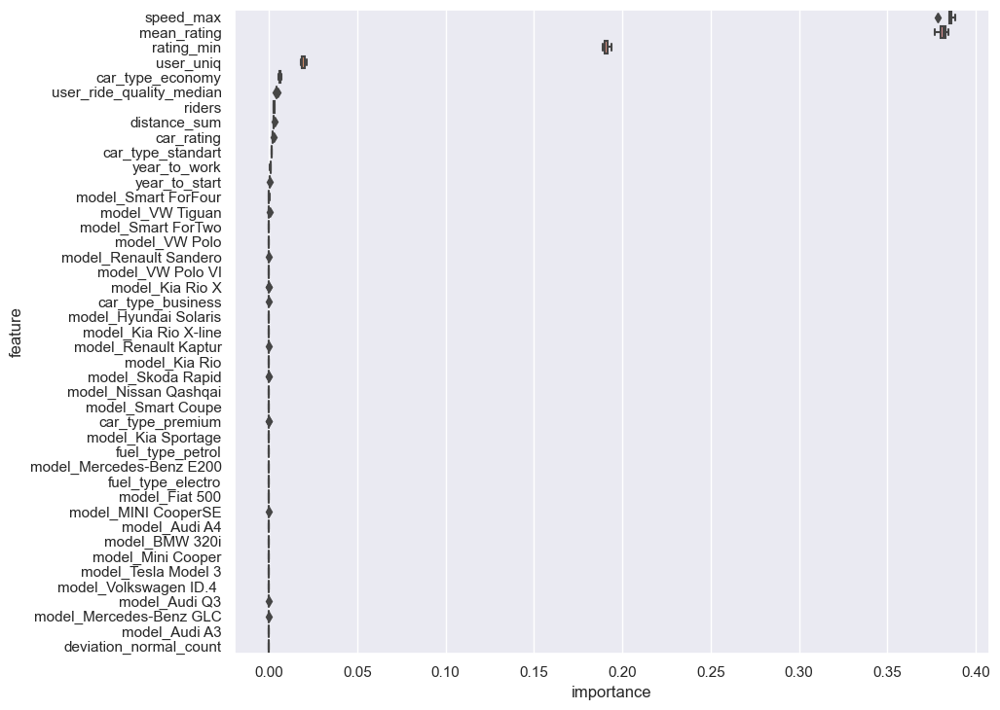

In [37]:
def plot_importance(df, best_model, height, top_n=50):

    top_n = min(top_n, df.shape[1])

    # Извлекаем значения из модели
    fi = pd.DataFrame(index=df.columns, columns=[])
    for i, m in enumerate(best_model):
        fi[f"m_{i}"] = m.feature_importances_

    fi = fi.stack().reset_index().iloc[:, [0, 2]]
    fi.columns = ["feature", "importance"]

    # Определяем порядок признаков и отбираем только n признаков для отрисовки
    cols_ord = (
        fi.groupby("feature")["importance"]
        .mean()
        .sort_values(ascending=False)
        .index.tolist()[:top_n]
    )

    fi = fi[fi["feature"].isin(cols_ord)]  # Выравниваем порядок по убыванию важности
    print( "Всего признаков {} Усреднее по {}-ти моделям: ".format(len(cols_ord), len(best_model)))

    # Отрисовываем боксплоты фичей
    plt.figure(figsize=(10, len(cols_ord) * height))
    b = sns.boxplot(data=fi, y="feature", x="importance", orient="h", order=cols_ord)

    print("На график нанесено топ-{} признаков".format(top_n))
    return (
        fi.groupby(by=["feature"], as_index=False)["importance"]
        .mean()
        .sort_values(by="importance", ascending=False)
    )


df_feats_imp = plot_importance(
    train[filtered_features].drop(targets, axis=1, errors="ignore"),
    clfs,
    0.20,
    top_n=100,
)

## **Task 1.** - **split Y 'target' (numerical)** into **10 Folds** with **mean.target.std < 300**

- **target IS FLOAT** ---> need split by some groups (otherwise ---> 1 sample = 1 class)
- **convert FLOAT to CATEGORY** ---> you assign FLOATS to intervals (bins) 
- **use StratifiedKFold** to balance classes in FOLD's (meaning balance values in Folds ---> to keep std avg low)

In [194]:
import pandas as pd
from sklearn.model_selection import StratifiedKFold

df = pd.read_csv('data\\stratified_valid.csv')

n_bins = 27
df['target_reg_group'] = pd.cut(df['target_reg'], bins=n_bins, labels=False)

n_splits = 10

kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=7575)

for fold, (train_index, test_index) in enumerate(kf.split(X=df, y=df['target_reg_group'])):
    df.loc[test_index, 'num_fold'] =  fold

df['num_fold'] = df['num_fold'].astype(int)
df.drop('target_reg_group', inplace=True, axis=1)
df.sample(3)

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\model_selection\_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=10.
  warnings.warn(


,car_id,target_reg,num_fold
303,f11377802P,14398.94,0
37,L60286103R,5140.35,4
1546,E13226619z,3204.34,5


203.40853889368984


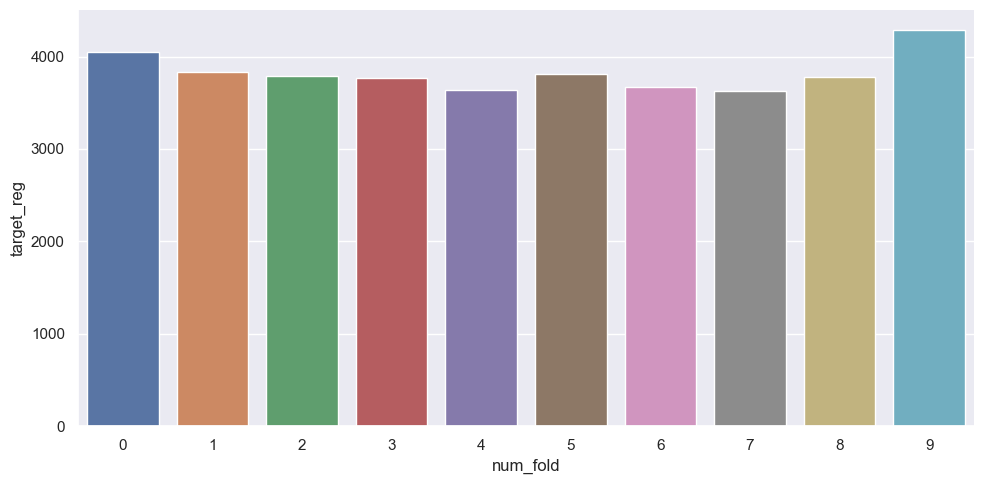

In [195]:
import seaborn as sns

print(df.groupby('num_fold', as_index=False)['target_reg'].agg('mean')['target_reg'].std())

tmp_fig = df.groupby('num_fold', as_index=False)['target_reg'].agg('mean')
sns.catplot(data = tmp_fig, x = 'num_fold', y = 'target_reg', aspect=2, kind="bar");

In [ ]:
df.to_csv('subs\\trash.csv', index=False)

## **Task 2.**
- 12 binary features ---> split into '5' folders with std (9.5)
- **target is several binary features** ---> same as before **convert target to classes**
- **form single 'str' as indicator of class** (156 total out of 10000 samples)
- **use StratifiedKFold** to balance classes in FOLD's

In [281]:
import pandas as pd
from iterstrat.ml_stratifiers import StratifiedKFold
from sklearn.model_selection import StratifiedKFold

df = pd.read_csv("data\\multi_label.csv")

columns_it = list(df.columns)
columns_it.remove('ID')
for col in columns_it:
    df[col] = df[col].astype(str)
df['sum_categorical'] = df.apply(lambda x: ''.join(list(x)[1:-1]) , axis=1)
df['kfold'] = 'NaN'

df.sample(3)

,ID,Computer Science,Physics,Mathematics,Statistics,Quantitative Biology,Quantitative Finance,Chemistry,Astrology,Spaceology,Life Science,Earth Science,Data Science,sum_categorical,kfold
2618,7086,0,1,0,0,0,0,0,0,0,1,0,0,01000000010,NaN
5072,7466,0,1,0,0,0,0,0,0,0,1,0,0,01000000010,NaN
6883,370,0,1,0,0,0,0,0,0,0,1,0,0,01000000010,NaN


In [282]:
num_folds = 5

mskf = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=7575)

for fold, (train_index, test_index) in enumerate(mskf.split(X=df, y=df['sum_categorical'])):
    df.loc[test_index, 'kfold'] =  fold

df['kfold'] = df['kfold'].astype(int)
df.drop('sum_categorical', inplace=True, axis=1)
df.sample(3)

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\model_selection\_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


,ID,Computer Science,Physics,Mathematics,Statistics,Quantitative Biology,Quantitative Finance,Chemistry,Astrology,Spaceology,Life Science,Earth Science,Data Science,kfold
4846,7979,0,1,0,0,0,0,0,0,0,1,0,0,2
3155,6682,0,1,0,0,0,0,0,0,0,1,0,1,2
1390,7064,1,0,0,1,0,0,0,0,0,0,0,1,2


In [283]:
for col in columns_it:
    df[col] = df[col].astype(int)

targets = ['Computer Science', 'Physics', 'Mathematics', 'Statistics',
           'Quantitative Biology', 'Quantitative Finance', 'Chemistry',
           'Astrology', 'Spaceology', 'Life Science', 'Earth Science', 'Data Science']
tmp = df.groupby(['kfold'], as_index=False).sum()  
tmp_melt = tmp.melt(id_vars = 'kfold', value_vars = targets, value_name = 'count', var_name = 'class')
print(tmp_melt.groupby(['class'], as_index=False).std()['count'].mean())

3.149175611865269


In [277]:
df.to_csv('subs\\trash_2.csv', index=False)

___
# <font color='pink'>🔎 3.2 **Feature Engineering** </font>
- **HELPS DRASTICALLY IMPROVE MODEL PERFORMANCE**
- **all features TYPES and HOW TO HANDLE them**
- 4 tasks --- Killer-feature || Gold-feature || Visual-feature working
    - **Task --- improve CAR DF perfomance** --- used:
        - **basic features** --- (mean/sum/mode) --- from merging several tables
        - **validation** --- StratifiedKFold
        - **CatBoost** --- default parameters
        - **What can be used (to get > 0.95 score)**
            - finding gold_feature --- (to 100% classify labels)
            - visuals on data --- (for new features)
                - 0 level intersection amount for user rating ???
            - category feature encoding
            - feature selection
            - hyperparameters
            - more algorithms tested --- (classic ones as well maybe)

__

**How to do:**
1) make a baseline (on raw data)
    - as model not basic - RandomForest / GradientBoosting
2) now adding features 
    - better ---> further
    - bad ---> back
- do CHECKs as often as possible
- extract MAXIMUM info --- (almost always good, but everyone can do it)
- more uncorrelated features ---> the better
- gold features are better than tuning --- (unreliable but always good + need time and experience to do)
- visuals can help
- some features can be BAD

__

**Features:** --- always remember check score after adding something --- [total amount of features <= initial amount of features]
1) <font color='orange'>unique id</font>  --- **DROP** (due to overfit)
2) <font color='orange'>duplicated id</font>  --- **USE**
    - avg value for '___' for this id --- frequency of this id
3) <font color='orange'>numerical feature</font>  (int / float)
    - NaN --- can be used as feature --- fill with 'median / mean / mode' OR using other features
    - combining --- [ + - * \ and any math function ] 
        - example: figures '-' and '|', they're the same length but rotated ---> adding 'area' feature will help
        - example: 'click', 'watch' - are 2 bad features ---> (click / watch) is new strong feature
4) <font color='orange'>categorical feature</font>  (non order / ordered {means - Big/Median/Small ---> 3/2/1})
    - NaN --- can be used as feature --- fill with 'mode' OR using other features
    - **problem: rare values** 
        - if classic models (not boostings) ---> develop a new group / or several new groups (depending on frequency)
    - **problem: values aren't in train BUT in TEST**
        - add some features aggregates ---> group by categorical feature ---> calculate 'mean / median / my_func' using some 'numerical_feature'
            - CALCULATE only functions that AREN'T depended on SIZE of test (to not overfit on test)
        - then 'categorical' feature can be thrown away (using only new added)
5) <font color='orange'>datetime</font>  --- (2021-10-04 19:32)
    - **ensure proper validation** (to prevent leaks)
    - new features --- year / month / day / day of week / hour / minute / day-off / holiday
6) <font color='orange'>time series</font> 
    - **ensure proper validation** (to prevent leaks)
    - statistics (for finding patterns --- max, min, median, number peaks, variance)
        - if nothing ---> differentiate this time series and calculate for it
    - Automated Feature Generation
        - **TSfresh \ TSfel**
    - TIME STEPS only (instead of time series)
        - look at Lifestream library (features)
    - **know the nature of your time series**
        - if signals ---> frequencies (using 'reverse Fourier transformation')
    - **remember** --- total features using time series should be "<" elements of time series
7) <font color='orange'>sequence</font> 
    - statistics (nunique, longest length, using distribution)
        - distribution example: --- cbdd ---> amount feature (c-1, b-1, d-2) ---> repeated feature (dd) ---> unique feature (cbd)
    - **BoW, TD-IDF**
    - train reccurent NN / use Bert
    - **note: you can craft this kind of feature yourself** 
        - example: you have a car ---> it has sequence of 'types of work fixes done for this car'
8) <font color='orange'>text</font> 
    - use 'pre-trained' models (HuggingFace)  [like - Bert features]
    - **Bert** features 
    - Avg / Min / Max - Polling
    - Replexia (how this text is known to pre-trained model)
    - hand-made features
        - text length
        - numbers like 'phone number'
        - number of languages in text
        - not always delete trash ('as', numbers of telephone, etc.)
9) <font color='orange'>geo data</font> --- geo_x, geo_y
    - **GeoPandas**
        - distance between centroids
        - if not only dots but POLYGONS ---> mutual borders of this polygons
        - top 3 targets around dot or centroid (be careful ---> you are using target)
    - Data Parsing
        - **Meteostat** info --- (avg temperature | number of sun days | number of dry days)
        - **GeoPy** --- (country, region, city | infrastructure)
10) <font color='orange'>graphs </font> --- source_id, target_id
    - construct build graph (defining nodes and edges)
        - for example using K-NN algorithm
            - it will give new hand-made features - avg weight of edges, closest neighbors, etc.
        - or use --- **Networkx**
            - feature examples --- PageRan, degree_centrality, ...
    - auto feature generation (**Graph2Vec** or **Node2Vec**)
    - train NN on graph (**StellarGraphs**)
    - can make not simple graph ---> but weighted grap
11) <font color='orange'>y</font> --- **DROP** (target)

## ✅ Task - ☠️ killer feature  <font color='orange'>(NOT CAR df - radius)</font>
- find 'killer feature' using data

Describe info:
- feature_3 (0-99) with duplicates [100 / 1258 unique]
- feature_1 (-2.5 - 2.5) with duplicates [491 / 1258 unique]
- feature_2 (-2.0 - 2.0) with duplicates [485 / 1258 unique]
- label ('A', 'B') [50%/50% - 1258 total]

**Using pairplot 'feature_1 / feature_2' --- it is a circle** (look like ellipse though) 
- feature_1 = dot_y, feature_2 = dot_x  ---> **feature_3 not needed**
- first need to **find radius for circle for each label** [x**2 + y**2 = radius]
- apply this function to create 'new feature'

In [16]:
import pandas as pd

df = pd.read_csv("data\\make_it_easy.csv")

import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme()  # can set themes

### Hist (on labels A,B)

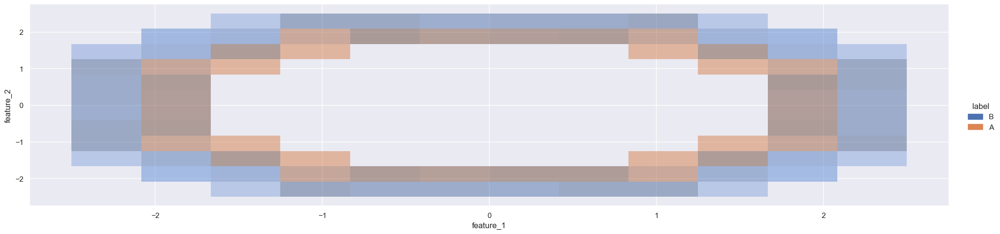

In [56]:
g = sns.displot(
data=df,

x="feature_1",
y="feature_2",

hue="label",
legend=True,
aspect=4,
kind="hist", # kde
alpha=0.5,
);

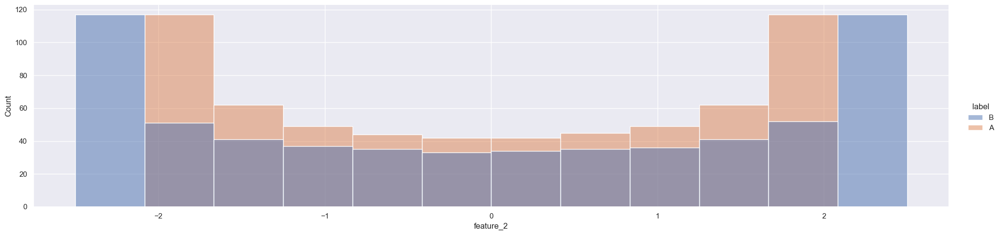

In [26]:
g = sns.displot(
data=df,

x="feature_2",
# y="user_time_accident",

hue="label",
legend=True,
aspect=4,
kind="hist", # kde
alpha=0.5,
);

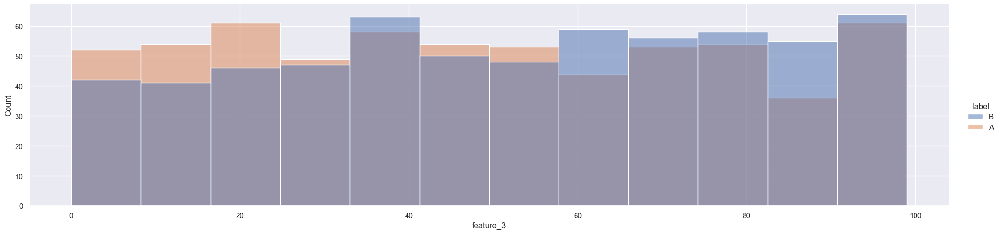

In [25]:
g = sns.displot(
data=df,

x="feature_3",
# y="user_time_accident",

hue="label",
legend=True,
aspect=4,
kind="hist", # kde
alpha=0.5,
);

### PairPlot

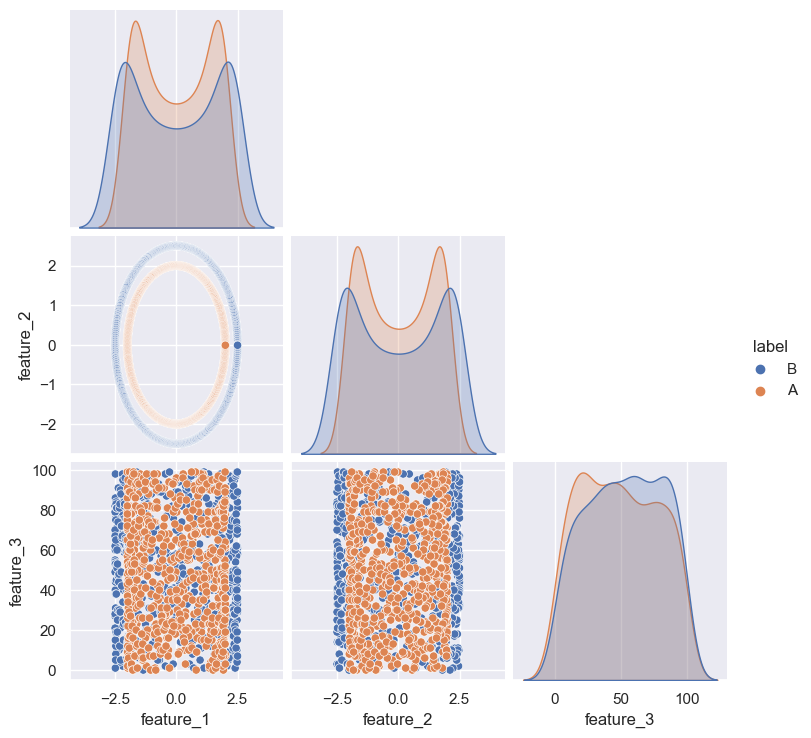

In [57]:
sns.pairplot(
df,
vars=["feature_1", "feature_2", "feature_3"],
corner=True,
hue="label",
);

## ✅ Task - 🥇 gold feature <font color='orange'>(CAR df - drops)</font>
- create new dataset with by groupby 'car_id' with 2 new features
    - gold_feature_1 - max drop between previous and next dates (-inf at the beginning)
        - car can be used several times a day - be careful!!! [calculate average for each day ---> drop 'date' column (only need 'car', 'gold_feature_1', 'gold_feature_2')]
        - if no drop (<5) ---> use '0'
    - gold_feature_2 - position of drop (how many days car worked after MAX drop)

In [315]:
df = pd.read_csv("data\\make_gold_features.csv")
df

,car_id,ride_date,deviation_normal,target_class
0,b12101843B,2020-01-01,-2.846,engine_ignition
1,b12101843B,2020-01-02,-2.431,engine_ignition
2,b12101843B,2020-01-03,-5.992,engine_ignition
3,b12101843B,2020-01-04,-3.427,engine_ignition
4,b12101843B,2020-01-05,-6.351,engine_ignition
...,...,...,...,...
6895,C14604474J,2020-03-28,24.981,engine_ignition
6896,C14604474J,2020-03-29,30.294,engine_ignition
6897,C14604474J,2020-03-30,26.085,engine_ignition
6898,C14604474J,2020-03-31,22.812,engine_ignition


In [316]:
df.groupby('car_id')['deviation_normal'].diff()

0         NaN
1       0.415
2      -3.561
3       2.565
4      -2.924
        ...  
6895    0.442
6896    5.313
6897   -4.209
6898   -3.273
6899    3.707
Name: deviation_normal, Length: 6900, dtype: float64

In [71]:
import pandas as pd
import math

df = pd.read_csv("data\\make_gold_features.csv")

# CALCULATING gold_feature_1 (but for every row)
df['gold_feature_1'] = df.groupby('car_id')['deviation_normal'].diff()

# CALCULATING gold_feature_2 (amount of days after MAX drop that machine worked)
df['gold_feature_2'] = -math.inf
count = 0
for i in range(len(df)):
    if i == 0:
        max_drop  = df[df.car_id==df.loc[i, 'car_id']]['gold_feature_1'].max()
        df.loc[i, 'gold_feature_2'] = count
    else:       
        if (df.loc[i, 'car_id'] != df.loc[i-1, 'car_id']):
            count = 0
            max_drop  = df[df.car_id==df.loc[i, 'car_id']]['gold_feature_1'].max()
            df.loc[i, 'gold_feature_2'] = count
        else:
            count += 1
            if ((df.loc[i, 'gold_feature_1'] == max_drop) and (df.loc[i-1, 'gold_feature_1'] != max_drop)):
                count = -math.inf
                max_drop = df.loc[i, 'gold_feature_1']
            df.loc[i, 'gold_feature_2'] = count
            
df['gold_feature_2']= df.groupby('car_id')['gold_feature_2'].transform('max')
df['gold_feature_2'] = df['gold_feature_2'].astype(int)

result = df.groupby("car_id", as_index=False).agg(gold_feature_1=("gold_feature_1", "max"), gold_feature_2=("gold_feature_2", "max"))
result.loc[result['gold_feature_1'] < 5, 'gold_feature_1'] = 0

result

,car_id,gold_feature_1,gold_feature_2
0,B-8479157Q,7.773,57
1,C14604474J,20.931,49
2,D46039134C,18.446,47
3,E-1571710h,26.922,52
4,F51416137Z,43.798,48
...,...,...,...
70,w-7960339R,33.390,52
71,w21325307E,0.000,11
72,x-8934991u,9.702,15
73,x30389932l,20.404,49


## ✅ Task - Find 🥇 gold features in Classification Problem ask <font color='orange'>(NOT CAR df)</font>
- **dataset has next rows - signal_id --- p_1 - p_128 --- label**
    - p - points
- first need to 'melt' dataset
    - meaning create 2 columns: 'p_number', 'value'
- after that the task is to find a FEATURE to 100% classify label
- in order to do --- **read [article about signals problem classification](https://alexanderdyakonov.wordpress.com/2018/06/28/%D0%BF%D1%80%D0%BE%D1%81%D1%82%D1%8B%D0%B5-%D0%BC%D0%B5%D1%82%D0%BE%D0%B4%D1%8B-%D0%B0%D0%BD%D0%B0%D0%BB%D0%B8%D0%B7%D0%B0-%D0%B4%D0%B0%D0%BD%D0%BD%D1%8B%D1%85/comment-page-1/)**
    - you can split them by finding 'derivative' (simple diff()) of signals (between p1-p2, etc.)
    - by applying .mean() or .std() or .var() --- it is possible to find something sometimes
- **the solution is to take --- diff().var()**
    - then find values that would help to 100% classify labels (min - mean/2 ; max + mean/2)
    - create function that you can apply later
- the rest is just label 'test.csv' and submit it

In [3]:
import pandas as pd

train = pd.read_csv("data\\fen_train.csv")
test = pd.read_csv("data\\fen_test.csv")

train.sample(3)

,signal_id,p1,p2,p3,p4,p5,p6,p7,p8,p9,...,p120,p121,p122,p123,p124,p125,p126,p127,p128,label
641,1202,-0.036848,0.050838,0.214833,0.271171,0.263377,0.202027,0.137567,0.130772,0.070652,...,0.021744,-0.137645,-0.074495,0.252934,0.589465,0.601771,0.265773,-0.078530,-0.328637,0
231,437,-0.014156,-0.053435,-0.032759,-0.059075,-0.053897,-0.028218,-0.011112,0.028886,0.037229,...,-0.083405,-0.035309,-0.016075,-0.048636,-0.042554,-0.043928,-0.025376,0.018363,0.031179,0
369,678,0.173592,0.024029,-0.253723,-0.483679,-0.539837,-0.526668,-0.495242,-0.384608,-0.292608,...,-0.174672,-0.155806,-0.150758,-0.004873,0.105834,0.189399,0.295889,0.348650,0.421706,0


In [277]:
df_melt.head(10)

,signal_id,orders,value,label,var_diff,sum_diff,gold_feature
0,3,p1,-0.177789,0,0.010646,58,0
1,4,p1,0.010337,0,0.020320,80,0
2,5,p1,-0.221846,0,0.010246,62,0
3,6,p1,0.411835,0,0.013071,72,0
4,7,p1,0.221770,0,0.008025,60,0
5,11,p1,-0.205615,0,0.006624,60,0
6,12,p1,0.121865,0,0.007773,58,0
7,13,p1,0.019150,1,0.010838,77,1
8,14,p1,-0.221930,0,0.002723,44,0
9,16,p1,0.092046,0,0.016836,76,0


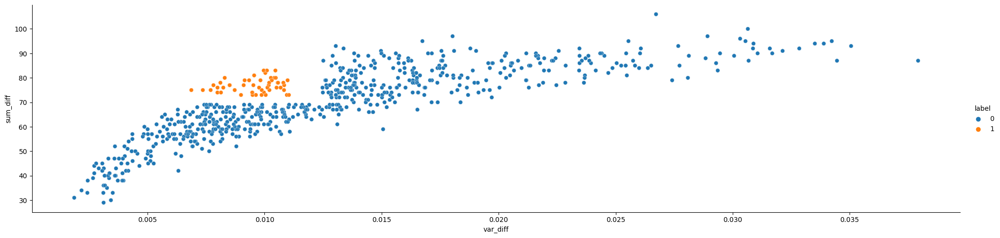

In [266]:
noise_threshold = 0.050

df_melt = train.melt(
    id_vars="signal_id",
    value_vars=[f"p{i}" for i in range(1, 128 + 1)],
    var_name="orders",
    value_name="value",
).merge(train[["signal_id", "label"]], on="signal_id", how="left")

#df_melt['mean_abs_diff'] = df_melt.groupby('signal_id')['value'].diff().abs().groupby(df_melt['signal_id']).transform('mean')
df_melt['var_diff'] = df_melt.groupby('signal_id')['value'].diff().groupby(df_melt['signal_id']).transform('var')
df_melt['sum_diff'] = df_melt.groupby('signal_id')['value'].diff().abs().between(0, noise_threshold).groupby(df_melt['signal_id']).transform(lambda x: (x == 0).sum())

g = sns.relplot(
data=df_melt,
x="var_diff",
y="sum_diff",
hue="label",

kind="scatter",
aspect=4,
alpha=0.5,
);

In [268]:
df_melt[df_melt.label == 1].sum_diff.describe()

count    6528.000000
mean       76.823529
std         2.798715
min        73.000000
25%        75.000000
50%        77.000000
75%        79.000000
max        83.000000
Name: sum_diff, dtype: float64

In [269]:
df_melt[df_melt.label == 1].var_diff.describe()

count    6528.000000
mean        0.009565
std         0.001050
min         0.006870
25%         0.008722
50%         0.009871
75%         0.010413
max         0.011038
Name: var_diff, dtype: float64

In [274]:
# new function ---> if sum_diff is between 70 and 86 (using std)  AND  if std_abs_diff is between 0.045 AND 0.079 ---> label = 1 (otherwise = 0)

interval_sum_diff = [73 - 1, 83 + 1]
interval_var_diff = [0.006870 - 0.001 / 2, 0.011038 + 0.001 / 2]

def labeling_function(df):
    if ((df['sum_diff'] >= interval_sum_diff[0] and df['sum_diff'] <= interval_sum_diff[1]) and (df['var_diff'] >= interval_var_diff[0] and df['var_diff'] <= interval_var_diff[1])):
        return 1
    else:
        return 0

df_melt['gold_feature'] = df_melt.apply(lambda x: labeling_function(x), axis=1)

In [275]:
# Labeling 'test'

noise_threshold = 0.0501

df_melt_test = test.melt(
    id_vars="signal_id",
    value_vars=[f"p{i}" for i in range(1, 128 + 1)],
    var_name="orders",
    value_name="value",
).merge(test[["signal_id"]], on="signal_id", how="left")

#df_melt_test['mean_abs_diff'] = df_melt_test.groupby('signal_id')['value'].diff().abs().groupby(df_melt_test['signal_id']).transform('mean')
df_melt_test['var_diff'] = df_melt_test.groupby('signal_id')['value'].diff().groupby(df_melt_test['signal_id']).transform('var')
df_melt_test['sum_diff'] = df_melt_test.groupby('signal_id')['value'].diff().abs().between(0, noise_threshold).groupby(df_melt_test['signal_id']).transform(lambda x: (x == 0).sum())

df_melt_test['label'] = df_melt_test.apply(lambda x: labeling_function(x), axis=1)

result = df_melt_test.groupby('signal_id').apply(lambda x: x[['signal_id', 'label']].iloc[0]).reset_index(drop=True)
result

,signal_id,label
0,0,0
1,1,0
2,8,1
3,9,0
4,10,0
...,...,...
427,1216,0
428,1217,0
429,1223,0
430,1224,0


In [276]:
result.to_csv("subs\\gold_feature_task.csv", index=False)

### Some other visuals

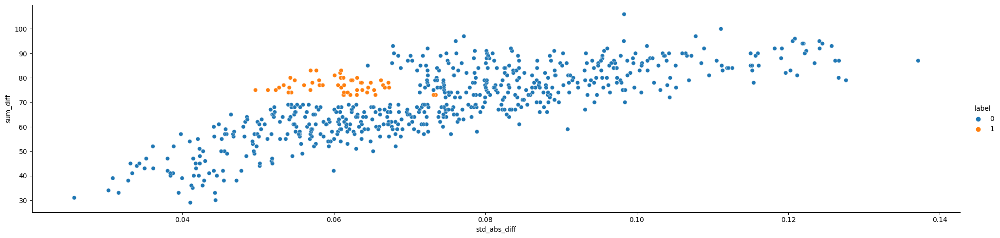

In [137]:
g = sns.relplot(
data=df_melt,
x="mean_abs_diff",
y="std_abs_diff",
hue="label",

kind="scatter",
aspect=4,
alpha=0.5,
);

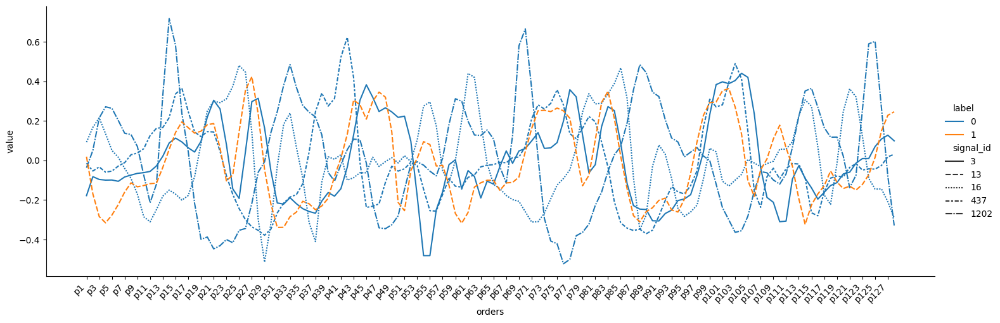

In [18]:
import seaborn as sns

df_melt = train.melt(
    id_vars="signal_id",
    value_vars=[f"p{i}" for i in range(1, 128 + 1)],
    var_name="orders",
    value_name="value",
).merge(train[["signal_id", "label"]], on="signal_id", how="left")

tmp = df_melt[df_melt.signal_id.isin(train['signal_id'].sample(15))]

sns.relplot(
    data=tmp,
    x="orders",
    y="value",
    hue="label",
    style="signal_id",
    kind="line",
    aspect=3,
).set_xticklabels(rotation=45, horizontalalignment="right", step=2);

## ✅ [0.95 accuracy] Task - Better solution for MAIN CLASSIFICATION PROBLEM (at least 0.8 score) <font color='orange'>(CAR df)</font>
- use 🥇 gold feature (drops)
- number of intersections with ZERO-LEVEL
- remember about early stopping (when training)
- remember to use visuals (to get features)
    - heatmaps for correlation between target and feature
    - plots for understanding patterns or unique things about target

### 1) Libraries + Seed + Setting Pandas Options

In [2]:
import os 
import random
import numpy as np 
import pandas as pd
from tqdm import tqdm
import time
import seaborn as sns

from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score #, mean_squared_error

import torch
#import tensorflow as tf 

In [13]:
DEFAULT_RANDOM_SEED = 2021

def set_all_seeds(seed=DEFAULT_RANDOM_SEED):
    
    # python's seeds
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    #np.random.seed(seed)
    
    # torch's seeds
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    
    # tensorflow's seed
    #tf.random.set_seed(seed)
    
set_all_seeds(seed=DEFAULT_RANDOM_SEED)

In [57]:
from IPython.display import display
pd.set_option('display.max_columns', None) 
pd.set_option('display.float_format', '{:.3f}'.format) 

### 2) Load Data

In [51]:
train = pd.read_csv('data\\car_train.csv') 
test = pd.read_csv('data\\car_test.csv')
rides_info = pd.read_csv('data\\rides_info.csv') 
driver_info = pd.read_csv('data\\driver_info.csv') 
fix_info = pd.read_csv('data\\fix_info.csv') 

train.drop('target_reg', axis=1, inplace=True)

In [262]:
train.head()

# to basic 'car_train' added info from rides_info (of car) --- mean_rating, distance_sum, rating_min, speed_max, user_ride_quality_median, deviation_normal_count, user_uniq

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_class
0,y13744087j,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,another_bug
1,O41613818T,VW Polo VI,economy,petrol,3.900,2015,78218,2021,electro_bug
2,d-2109686j,Renault Sandero,standart,petrol,6.300,2012,23340,2017,gear_stick
3,u29695600e,Mercedes-Benz GLC,business,petrol,4.040,2011,1263,2020,engine_fuel
4,N-8915870N,Renault Sandero,standart,petrol,4.700,2012,26428,2017,engine_fuel


**CAR TRAIN** [main file]

-    car_id - идентификатор машины
-    model / car_type / fuel_type - марка, класс и тип топлива машины
-    car_rating / riders - общий рейтинг и общее число поездок к концу 2021-го кода.
-    year_to_start / year_to_work - года выпуска машины и начала работы в автопарке
-    target_reg - количество дней до поломки.
-    target_class - класс поломки (всего 9 видов)

**RIDES_INFO**

-    user_id / car_id / ride_id - идентификаторы водителя, машины, поездки соответственно
-    ride_date / rating - дата поездки и рейтинг, поставленный водителем
-    ride_duration / distance / ride_cost - длительность (время), пройденное расстояние, стоимость поездки
-    speed_avg / speed_max - средняя и максимальная скорости поездки соответственно
-    stop_times / refueling - количество остановок (паузы) и флаг - была ли дозаправка.
-    user_ride_quality - оценка манеры вождения в машины водителя, определенная скоринговой ML системой сервиса.
-    deviation_normal - общий показатель датчиков о состоянии машины, относительно эталонных показателей (нормы).

**DRIVERS_INFO**

-    user_id / age /sex - идентификатор, возраст и пол водителя соответственно
-    user_rating - общий рейтинг пользователя за все поездки к концу 2021-го года
-    user_rides - общее количество поездок к концу 2021-го кода
-    user_time_accident - число инцидентов (это могли быть аварии/штрафы/эвакуация машины)
-    first_ride_date - дата первой поездки

**FIX_INFO**

-    worker_id / car_id - идентификатор работника и машины соответсвенно
-    work_type / work_duration - тип и длительность (в часах) проводимой работы
-    destroy_degree - степень износа/поврежденности машины в случае поломки
-    fix_date - время начала ремонта (время снятия машины с линии)



___
1) rides_info -> car_train
   - **[key - car_id]**
   - features
       - car mean rating
       - car total distance traveled
       - car minimal rating
       - car max speed reached
       - car's median user_ride_quality (mid number of set)
       - deviation normal drop (like the gold_feature)
       - car number of unique user's
2) drivers_info -> rides_info
    - **[key - user_id]**
    - features
        - user mean rating
        - user mean age
        - mode (sex)
        - average amount of user rides
3) fix_info -> car_info
    - **[key - car_id]**
    - features
        - popular work type
        - average work duration
        - average/mode 'destroy_degree'
        - latest fix_date ???
        - most popular worker_id (who fixes it)
        - count of how much fixes were applied to car (frequency in this dataset of the car)
___

1) fuel type ---> for 'electro' NO 'wheel_shake' ---> new feature (insead of fuel_type)
2) car_type ---> 'wheel_shake' ONLY for 'economy' 
3) wheel_shake can be possible ONLY if 'economy' and 'petrol'    [still can't fully split class]
    - dropping 'fuel_type' (useless for now) ---> but leave 'car_type'    [might has something else in it] -->

### 1-3 tries (no visual - just simple enumeration)
- 1st try
    - score - 0.95
    - merged all tables together (cutting features)
    - Final features choice:
        - car mean rating
        - car minimal rating
        - car max speed
        - car total distance traveled
        - car mean user_ride_quality
        - car minimal user_ride_quality
        - car mean deviation normal
        - car average user rating
        - car mode user time accidents
- 2nd try
    - score - 0.95
    - added diviation_drop (diff()) + diviation_drop_position  to features (from 1st)
- 3rd try
    - score - 0.95
    - using StratifiedKFold (5 folds)

#### Data processing

In [378]:
# CODE FOR diviation (diff) drop + position (from previous task - LOADED FROM FILE from file)

# import math
# from tqdm import tqdm
# from pandarallel import pandarallel
# pandarallel.initialize(progress_bar=True, nb_workers=8)

# rides_info_f = rides_info.copy()
# rides_info_f['new_deviation_normal'] = rides_info_f[['user_id', 'car_id', 'ride_date', 'deviation_normal']].groupby(['car_id', 'ride_date'], as_index=False).transform('mean')
# rides_info_f['new_deviation_normal_drop'] = rides_info_f.groupby('car_id')['new_deviation_normal'].diff()

# # CALCULATING gold_feature_2 (amount of days after MAX drop that machine worked)
# rides_info_f['new_deviation_normal_drop_position'] = -math.inf
# count = 0
# for i in tqdm(range(len(rides_info_f))):
#     if i == 0:
#         max_drop  = rides_info_f[rides_info_f.car_id==rides_info_f.loc[i, 'car_id']]['new_deviation_normal_drop'].max()
#         rides_info_f.loc[i, 'new_deviation_normal_drop_position'] = count
#     else:       
#         if (rides_info_f.loc[i, 'car_id'] != rides_info_f.loc[i-1, 'car_id']):
#             count = 0
#             max_drop  = rides_info_f[rides_info_f.car_id==rides_info_f.loc[i, 'car_id']]['new_deviation_normal_drop'].max()
#             rides_info_f.loc[i, 'new_deviation_normal_drop_position'] = count
#         else:
#             count += 1
#             if ((rides_info_f.loc[i, 'new_deviation_normal_drop'] == max_drop) and (rides_info_f.loc[i-1, 'new_deviation_normal_drop'] != max_drop)):
#                 count = -math.inf
#                 max_drop = rides_info_f.loc[i, 'new_deviation_normal_drop']
#             rides_info_f.loc[i, 'new_deviation_normal_drop_position'] = count
            
# rides_info_f['new_deviation_normal_drop_position']= rides_info_f.groupby('car_id')['new_deviation_normal_drop_position'].transform('max')
# rides_info_f['new_deviation_normal_drop_position'] = rides_info_f['new_deviation_normal_drop_position'].astype(int)

# rides_info_f = rides_info_f.groupby("car_id", as_index=False).agg(new_deviation_normal_drop=("new_deviation_normal_drop", "max"), new_deviation_normal_drop_position=("new_deviation_normal_drop_position", "max"))
# rides_info_f.loc[rides_info_f['new_deviation_normal_drop'] < 5, 'new_deviation_normal_drop'] = 0


#rides_info_f.to_csv("tmp_data\\rides_info_with_diff_deviation", index=False)

In [52]:
rides_info_f = pd.read_csv("tmp_data\\rides_info_with_diff_deviation")
rides_info = rides_info.merge(rides_info_f, on='car_id', how='left')

rides_driver_info = rides_info.merge(driver_info, on='user_id', how='left')

rides_driver_info = rides_driver_info.groupby('car_id', as_index=False).agg(
                                                    car_mean_rating=("rating", "mean"), 
                                                    car_min_rating=("rating", "min"), 
                                                    car_max_speedmax=("speed_max", "max"),
                                                    car_sum_distance=("distance", sum),
                                                    car_mean_userridequality=("user_ride_quality", "mean"), 
                                                    car_min_userridequality=("user_ride_quality", "min"), 
                                                    car_mean_deviationnormal=("deviation_normal", "mean"), 
                                                    car_mean_userrating=("user_rating", "mean"),
                                                    car_mode_usertimeaccident=("user_time_accident", lambda x: np.mean(x.mode())),
    
                                                    car_deviationnormaldrop=("new_deviation_normal_drop", "max"),
                                                    car_deviationnormaldropposition=("new_deviation_normal_drop_position", "max"),
                                                )
rides_driver_info

,car_id,car_mean_rating,car_min_rating,car_max_speedmax,car_sum_distance,car_mean_userridequality,car_min_userridequality,car_mean_deviationnormal,car_mean_userrating,car_mode_usertimeaccident,car_deviationnormaldrop,car_deviationnormaldropposition
0,A-1049127W,4.255172,0.10,179.729652,1.125753e+07,0.226325,-10.746798,-6.136672,7.817816,7.0,18.8600,98
1,A-1079539w,4.088046,0.10,184.505566,1.912765e+07,1.426051,-17.076706,47.443270,7.773563,8.0,7.1095,126
2,A-1162143G,4.662299,0.10,180.000000,2.995194e+06,0.515958,-14.634792,10.556425,8.149425,4.0,22.1325,99
3,A-1228282M,4.225172,0.10,182.446070,1.793685e+07,-12.992128,-29.510094,9.810747,8.045402,11.0,46.4645,90
4,A-1339912r,4.690115,0.10,152.000000,1.202552e+07,-9.806267,-19.721486,22.965937,8.195402,8.0,9.5565,74
...,...,...,...,...,...,...,...,...,...,...,...,...
4245,z73688663a,4.808448,0.10,165.000000,1.113943e+07,-1.365814,-11.292026,-13.846075,8.156322,5.0,39.8705,94
4246,z73740510r,4.699655,0.28,117.397405,7.215961e+06,12.857021,-11.915118,7.026477,8.096552,6.0,7.1360,28
4247,z86911952C,4.430977,0.00,173.428116,2.135104e+07,-5.168772,-16.987103,-25.382126,8.014368,10.0,20.9705,81
4248,z91353693Z,5.326092,0.10,106.089167,1.614384e+07,8.156670,-1.828818,-8.031167,8.024138,8.0,24.8950,111


In [53]:
fix_info_grp = fix_info.groupby('car_id', as_index=False).agg(
                                                    car_total_workduration=("work_duration", sum), 
                                                    car_mean_destroydegree=("destroy_degree", "mean"),
                                                    car_mode_worktype=("work_type", lambda x: x.mode()[0]),
                                                )
fix_info_grp

,car_id,car_total_workduration,car_mean_destroydegree,car_mode_worktype
0,A-1049127W,962,2.714286,reparking
1,A-1079539w,931,4.329412,repair
2,A-1162143G,946,3.705882,repair
3,A-1228282M,838,2.908824,repair
4,A-1339912r,973,3.044118,repair
...,...,...,...,...
4245,z73688663a,911,2.705714,reparking
4246,z73740510r,891,3.714286,repair
4247,z86911952C,943,3.417143,reparking
4248,z91353693Z,978,4.497059,repair


In [54]:
def add_featues(df):
    
    if 'car_mean_rating' not in df.columns:
        return df.merge(rides_driver_info, on = 'car_id', how = 'left')
    
    if 'car_total_workduration' not in df.columns:
        return df.merge(fix_info_grp, on = 'car_id', how = 'left')
    
    return df
    
for i in range(10):
    train = add_featues(train)
    test = add_featues(test)

In [17]:
train

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_class,car_mean_rating,...,car_mean_userridequality,car_min_userridequality,car_mean_deviationnormal,car_mean_userrating,car_mode_usertimeaccident,car_deviationnormaldrop,car_deviationnormaldropposition,car_total_workduration,car_mean_destroydegree,car_mode_worktype
0,y13744087j,Kia Rio X-line,economy,petrol,3.78,2015,76163,2021,another_bug,4.737759,...,-0.901190,-10.501738,-0.120391,8.229885,10.0,0.0000,128,933,3.048571,reparking
1,O41613818T,VW Polo VI,economy,petrol,3.90,2015,78218,2021,electro_bug,4.480517,...,14.018105,0.437053,6.050011,7.988506,4.0,20.5500,66,873,2.917143,reparking
2,d-2109686j,Renault Sandero,standart,petrol,6.30,2012,23340,2017,gear_stick,4.768391,...,0.722771,-12.535368,-2.223954,7.843103,9.0,10.0000,52,915,3.740000,repair
3,u29695600e,Mercedes-Benz GLC,business,petrol,4.04,2011,1263,2020,engine_fuel,3.880920,...,-4.290370,-10.723544,14.771948,8.524138,12.0,19.5840,90,1007,4.085714,repair
4,N-8915870N,Renault Sandero,standart,petrol,4.70,2012,26428,2017,engine_fuel,4.181149,...,-13.465342,-25.742137,12.455678,8.112069,3.0,14.1385,94,981,3.880000,repair
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2332,j21246192N,Smart ForFour,economy,petrol,4.38,2017,121239,2018,wheel_shake,4.608908,...,-5.722741,-21.867121,2.914989,8.124138,5.0,5.7375,2,814,3.900000,repair
2333,h-1554287F,Audi A4,premium,petrol,4.30,2016,107793,2020,engine_check,4.683793,...,-8.048019,-17.949058,-18.805856,8.150575,3.0,37.5955,95,873,1.935294,reparking
2334,A15262612g,Kia Rio,economy,petrol,3.88,2015,80234,2019,gear_stick,4.655345,...,-0.251597,-12.441852,-7.651776,7.783908,9.0,21.1230,167,797,2.782353,reparking
2335,W-2514493U,Renault Sandero,standart,petrol,4.50,2014,60048,2020,another_bug,4.638333,...,0.424606,-12.514535,0.468718,8.084483,9.0,21.4570,154,857,3.441176,reparking


In [55]:
features2drop = ['car_id', 'fuel_type'] # то что надо выбросить 
targets = ['target_class'] # таргеты
cat_features = ['model', 'car_type', 'year_to_start', 'year_to_work', 'car_mode_worktype'] # категориальные признаки

filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]

print('cat_features :', len(cat_features), cat_features)
print('num_features :', len(num_features), num_features)
print('targets', targets)

cat_features : 5 ['model', 'car_type', 'year_to_start', 'year_to_work', 'car_mode_worktype']
num_features : 15 ['car_rating', 'riders', 'car_mean_rating', 'car_min_rating', 'car_max_speedmax', 'car_sum_distance', 'car_mean_userridequality', 'car_min_userridequality', 'car_mean_deviationnormal', 'car_mean_userrating', 'car_mode_usertimeaccident', 'car_deviationnormaldrop', 'car_deviationnormaldropposition', 'car_total_workduration', 'car_mean_destroydegree']
targets ['target_class']


#### Training + testing
- remember about **early training stop** !!!
- remember about **fixing seed** !!

In [19]:
X = train[filtered_features].drop(targets, axis=1, errors='ignore')
y = train['target_class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = CatBoostClassifier(cat_features=cat_features)

clf.fit(X_train, y_train, 
          eval_set=(X_test, y_test),
          verbose=150, plot=False)

# инференс модели
y_pred = clf.predict(X_test)
print(f'\n Accuracy: {accuracy_score(y_test, y_pred)}')

Learning rate set to 0.109335
0:	learn: 1.7178068	test: 1.7275788	best: 1.7275788 (0)	total: 213ms	remaining: 3m 32s
150:	learn: 0.0969945	test: 0.1837014	best: 0.1837014 (150)	total: 17.4s	remaining: 1m 37s
300:	learn: 0.0569442	test: 0.1640289	best: 0.1639344 (298)	total: 33.6s	remaining: 1m 18s
450:	learn: 0.0358857	test: 0.1509535	best: 0.1509535 (450)	total: 49.4s	remaining: 1m
600:	learn: 0.0247617	test: 0.1445644	best: 0.1445644 (600)	total: 1m 5s	remaining: 43.2s
750:	learn: 0.0186854	test: 0.1407318	best: 0.1407318 (750)	total: 1m 20s	remaining: 26.6s
900:	learn: 0.0144629	test: 0.1370555	best: 0.1369892 (898)	total: 1m 37s	remaining: 10.7s
999:	learn: 0.0126225	test: 0.1356834	best: 0.1356834 (999)	total: 1m 50s	remaining: 0us

bestTest = 0.1356834186
bestIteration = 999


 Accuracy: 0.9508547008547008


In [375]:
fi = clf.get_feature_importance(prettified=True)
fi

,Feature Id,Importances
0,car_mean_rating,21.303
1,car_max_speedmax,20.956
2,car_mean_userrating,18.358
3,car_min_rating,10.290
4,car_mean_destroydegree,7.969
5,car_deviationnormaldrop,2.664
6,car_deviationnormaldropposition,2.402
7,car_type,2.300
8,model,2.246
9,car_mode_worktype,1.980


#### 3rd try - StratifiedKFold (data from 1st and 2nd tries)

In [40]:
from sklearn.model_selection import StratifiedKFold

clfs = []
X = train[filtered_features].drop(targets, axis=1, errors='ignore')
y = train['target_class']

n_folds = 5
skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

clf = CatBoostClassifier(cat_features=cat_features)

# Loop over the folds
fold_scores = []
for fold, (train_idx, val_idx) in enumerate(skf.split(X, y)):
    print(f"Fold {fold+1}")

    X_train, y_train = X.iloc[train_idx], y.iloc[train_idx]
    X_val, y_val = X.iloc[val_idx], y.iloc[val_idx]

    clf.fit(X_train, y_train, 
          eval_set=(X_val, y_val),
          verbose=150, plot=False)
    
    clfs.append(clf)
    
    y_pred = clf.predict(X_val)
    
    score = accuracy_score(y_val, y_pred)
    print(f'\n Accuracy: {score}')
    
    fold_scores.append(score)

# Compute the mean cross-validation score
mean_score = sum(fold_scores) / n_folds
print(f"Mean cross-validation accuracy: {mean_score:.4f}")

Fold 1
Learning rate set to 0.109335
0:	learn: 1.7187286	test: 1.7161777	best: 1.7161777 (0)	total: 95.1ms	remaining: 1m 35s
150:	learn: 0.1054195	test: 0.1655064	best: 0.1655064 (150)	total: 16.8s	remaining: 1m 34s
300:	learn: 0.0609169	test: 0.1384586	best: 0.1384586 (300)	total: 35.6s	remaining: 1m 22s
450:	learn: 0.0392963	test: 0.1287516	best: 0.1287516 (450)	total: 53.5s	remaining: 1m 5s
600:	learn: 0.0267471	test: 0.1214525	best: 0.1214446 (597)	total: 1m 11s	remaining: 47.7s
750:	learn: 0.0200493	test: 0.1177111	best: 0.1172764 (733)	total: 1m 29s	remaining: 29.6s
900:	learn: 0.0159478	test: 0.1143059	best: 0.1140777 (895)	total: 1m 47s	remaining: 11.8s
999:	learn: 0.0136035	test: 0.1132210	best: 0.1131073 (986)	total: 1m 59s	remaining: 0us

bestTest = 0.1131073379
bestIteration = 986

Shrink model to first 987 iterations.

 Accuracy: 0.9700854700854701
Fold 2
Learning rate set to 0.109335
0:	learn: 1.7192214	test: 1.7169313	best: 1.7169313 (0)	total: 104ms	remaining: 1m 43s
15

In [48]:
best_model_idx = 4
clf = clfs[best_model_idx]

#### Feature Selection using CatBoost
- forced to use one hot encoding (for RFECV feature selection method)
- takes too much time (loop inside loop --- number_features * number_features)


In [ ]:
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFECV
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

targets=['car_id', 'target_class']
cat_features = ['model', 'car_type', 'year_to_start', 'year_to_work', 'car_mode_worktype', 'fuel_type']
train[cat_features] = train[cat_features].astype('category')

X = train.drop(targets, axis=1, errors='ignore')
y = train['target_class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

ct = ColumnTransformer([('encoder', OneHotEncoder(), cat_features)], remainder='passthrough')
X_train = ct.fit_transform(X_train)
X_test = ct.transform(X_test)

# Create a CatBoost classifier
clf = CatBoostClassifier(random_seed=42, verbose=150)

# Set up RFECV for feature selection
rfecv = RFECV(estimator=clf, step=1, cv=5, scoring='accuracy', verbose=True)

# Fit RFECV to the training data
rfecv.fit(X_train, y_train)

# Print selected features
print("Selected features:", X_train.columns[rfecv.support_])

# Train the CatBoost model using selected features
clf.fit(X_train.iloc[:, rfecv.support_], y_train, eval_set=(X_test.iloc[:, rfecv.support_], y_test), verbose=150, plot=False)

# Evaluate the model
print("Accuracy:", clf.score(X_test.iloc[:, rfecv.support_], y_test))

### 4) Submit

In [49]:
y_final = clf.predict(test[filtered_features])

test['target_class'] = y_final
result = test[['car_id', 'target_class']]
result

,car_id,target_class
0,P17494612l,engine_overheat
1,N-1530212S,electro_bug
2,B-1154399t,break_bug
3,F12725233R,gear_stick
4,l-1139189J,electro_bug
...,...,...
1908,x13640960Q,engine_check
1909,Z-2276652N,engine_overheat
1910,F-2165841B,gear_stick
1911,x-1331529J,engine_check


In [50]:
result.to_csv("subs\\class_car_3.csv", index=False)

___
# <font color='pink'> 🤏🤖 3.3 **Feature Selection** </font>
- **MOST OF THE TIME BASIS OF FEATURES IS FINE** --- but could improve performance
- **methods** --- filter || embedded || wrapper || hybrids
    - **reguliraztion** for regression (Lasso || Ridge || ElasticNet)

## Fast run code (all-in-1)

In [90]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

df_name = 'fs_task3_310f'
target_name = 'target'

# cat_cols = []
drop_cols = [target_name]

df = pd.read_csv(f'data/{df_name}.csv')

X = df.drop(drop_cols, axis=1, errors = 'ignore')
y = df[target_name].fillna(0)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


model = CatBoostClassifier(random_state=42,
                           #cat_features=cat_cols,
                           thread_count=-1)

model.fit(X_train, y_train, 
          eval_set=(X_test, y_test),
          verbose=100, plot=False, 
          early_stopping_rounds=100
         )

df.head(20)

Learning rate set to 0.108558
0:	learn: 2.0198175	test: 2.0318977	best: 2.0318977 (0)	total: 465ms	remaining: 7m 44s
100:	learn: 0.4154215	test: 0.7246960	best: 0.7246960 (100)	total: 44.2s	remaining: 6m 33s
200:	learn: 0.2405118	test: 0.6677376	best: 0.6675330 (198)	total: 1m 28s	remaining: 5m 49s
300:	learn: 0.1625120	test: 0.6577912	best: 0.6573145 (298)	total: 2m 11s	remaining: 5m 4s
400:	learn: 0.1163343	test: 0.6607869	best: 0.6549097 (357)	total: 2m 54s	remaining: 4m 21s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.6549097015
bestIteration = 357

Shrink model to first 358 iterations.


,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,feature_33,feature_34,feature_35,feature_36,feature_37,feature_38,feature_39,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,feature_50,feature_51,feature_52,feature_53,feature_54,feature_55,feature_56,feature_57,feature_58,feature_59,feature_60,feature_61,feature_62,feature_63,feature_64,feature_65,feature_66,feature_67,feature_68,feature_69,feature_70,feature_71,feature_72,feature_73,feature_74,feature_75,feature_76,feature_77,feature_78,feature_79,feature_80,feature_81,feature_82,feature_83,feature_84,feature_85,feature_86,feature_87,feature_88,feature_89,feature_90,feature_91,feature_92,feature_93,feature_94,feature_95,feature_96,feature_97,feature_98,feature_99,feature_100,feature_101,feature_102,feature_103,feature_104,feature_105,feature_106,feature_107,feature_108,feature_109,feature_110,feature_111,feature_112,feature_113,feature_114,feature_115,feature_116,feature_117,feature_118,feature_119,feature_120,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,feature_130,feature_131,feature_132,feature_133,feature_134,feature_135,feature_136,feature_137,feature_138,feature_139,feature_140,feature_141,feature_142,feature_143,feature_144,feature_145,feature_146,feature_147,feature_148,feature_149,feature_150,feature_151,feature_152,feature_153,feature_154,feature_155,feature_156,feature_157,feature_158,feature_159,feature_160,feature_161,feature_162,feature_163,feature_164,feature_165,feature_166,feature_167,feature_168,feature_169,feature_170,feature_171,feature_172,feature_173,feature_174,feature_175,feature_176,feature_177,feature_178,feature_179,feature_180,feature_181,feature_182,feature_183,feature_184,feature_185,feature_186,feature_187,feature_188,feature_189,feature_190,feature_191,feature_192,feature_193,feature_194,feature_195,feature_196,feature_197,feature_198,feature_199,feature_200,feature_201,feature_202,feature_203,feature_204,feature_205,feature_206,feature_207,feature_208,feature_209,feature_210,feature_211,feature_212,feature_213,feature_214,feature_215,feature_216,feature_217,feature_218,feature_219,feature_220,feature_221,feature_222,feature_223,feature_224,feature_225,feature_226,feature_227,feature_228,feature_229,feature_230,feature_231,feature_232,feature_233,feature_234,feature_235,feature_236,feature_237,feature_238,feature_239,feature_240,feature_241,feature_242,feature_243,feature_244,feature_245,feature_246,feature_247,feature_248,feature_249,feature_250,feature_251,feature_252,feature_253,feature_254,feature_255,feature_256,feature_257,feature_258,feature_259,feature_260,feature_261,feature_262,feature_263,feature_264,feature_265,feature_266,feature_267,feature_268,feature_269,feature_270,feature_271,feature_272,feature_273,feature_274,feature_275,feature_276,feature_277,feature_278,feature_279,feature_280,feature_281,feature_282,feature_283,feature_284,feature_285,feature_286,feature_287,feature_288,feature_289,feature_290,feature_291,feature_292,feature_293,feature_294,feature_295,feature_296,feature_297,feature_298,feature_299,feature_300,feature_301,feature_302,feature_303,feature_304,feature_305,feature_306,feature_307,feature_308,feature_309,target
0,-0.917,-0.313,-0.690,0.771,0.086,44800,1.380,42902,-0.400,0.510,-1.580,-0.349,0.010,0.984,-0.330,3.020,0.307,-1.437,0.710,-0.580,0.390,-2.590,20078,23083,-0.430,0.560,-0.860,2.602,0.796,1.350,26468,43674,-1.640,1654,-0.325,16983,-0.500,0.902,26991,-1.500,0.540,39135,9925,1.295,-0.156,34501,1.810,-0.270,1.420,32112,44296,-0.040,0.610,-1.340,28553,39698,39432,-1.406,41565,0.100,-

In [ ]:
import phik
from phik.report import plot_correlation_matrix
from phik import report

significance_overview = df.significance_matrix().fillna(0).round(1).sort_values(target_name)

plot_correlation_matrix(significance_overview.values, 
                        x_labels=significance_overview.columns, 
                        y_labels=significance_overview.index, 
                        vmin=0, vmax=1, color_map="Greens",
                        title="Significance of the coefficients", 
                        usetex=False, fontsize_factor=0.8, figsize=(11, 6))
plt.tight_layout()

In [ ]:
from catboost import CatBoostClassifier #, CatBoostRegressor

feature_importance = model.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(12, 6))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X.columns)[sorted_idx])
plt.title('Feature Importance');

In [ ]:
from sklearn.inspection import permutation_importance

perm_importance = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=1066)
sorted_idx = perm_importance.importances_mean.argsort()
fig = plt.figure(figsize=(12, 6))
plt.barh(range(len(sorted_idx)), perm_importance.importances_mean[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X.columns)[sorted_idx])
plt.title('Permutation Importance');

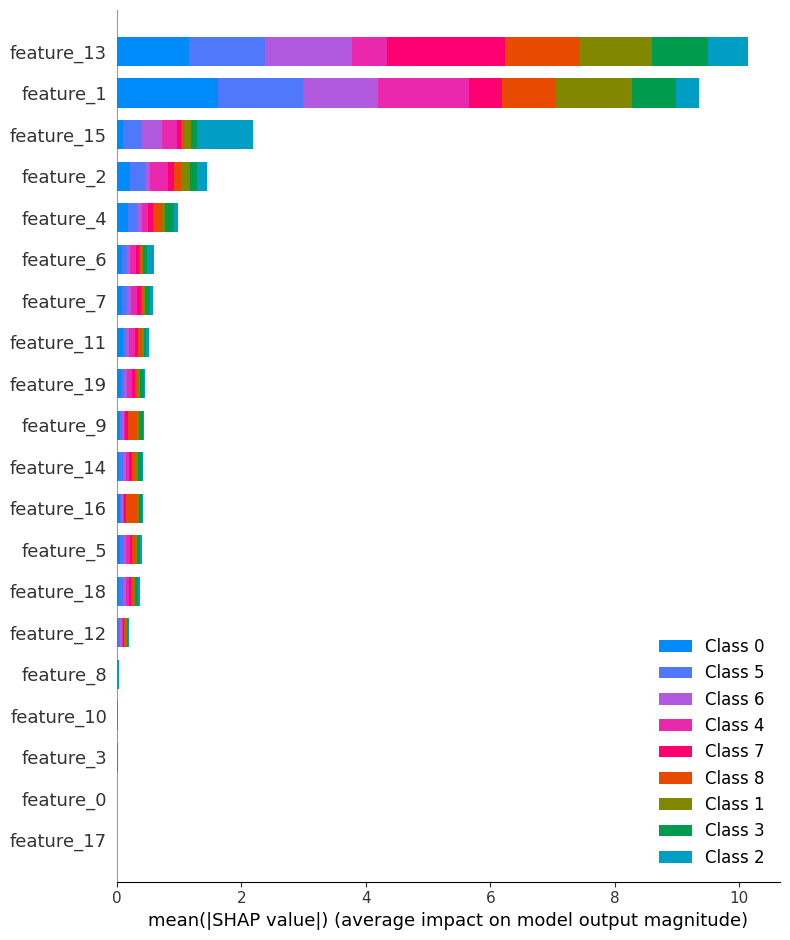

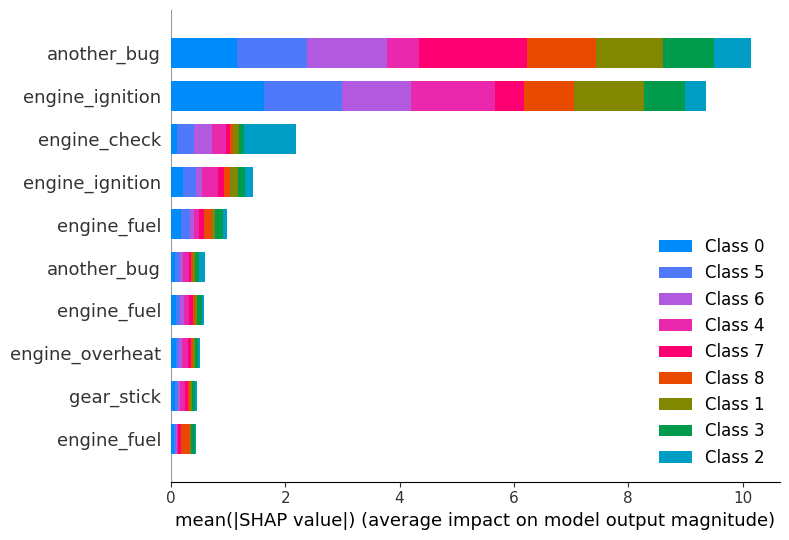

In [85]:
from catboost import Pool
import shap

explainer = shap.TreeExplainer(model)

val_dataset = Pool(data=X_test, label=y_test) #, cat_features=cat_cols)
shap_values = explainer.shap_values(val_dataset)
shap.summary_plot(shap_values, X_test, max_display = 25)

#fig, ax = plt.subplots(figsize=(10, 6))
shap.summary_plot(shap_values, y, show=False, max_display=10)
plt.tight_layout()

In [98]:
from boruta import BorutaPy
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

#X_train_one_hot = pd.get_dummies(X_train[cat_cols])
#X_train = pd.concat((X_train.drop(columns=cat_cols), X_train_one_hot), axis=1).fillna(0)
#X_train.head()

###initialize Boruta
forest = RandomForestClassifier(
   n_jobs = -1, 
   max_depth = 3
)
boruta = BorutaPy(
   estimator = forest, 
   n_estimators = 'auto',
   max_iter = 25, # number of trials to perform
    verbose=1
)
### fit Boruta (it accepts np.array, not pd.DataFrame)
boruta.fit(np.array(X_train), np.array(y_train))
### print results
green_area = X_train.columns[boruta.support_].to_list()
blue_area = X_train.columns[boruta.support_weak_].to_list()
red_area = X_train.columns[~(boruta.support_ | boruta.support_weak_)].to_list()
print('features in the green area:', green_area)
print('features in the blue area:', blue_area)
print('features in the red area:', red_area)

Iteration: 1 / 25
Iteration: 2 / 25
Iteration: 3 / 25
Iteration: 4 / 25
Iteration: 5 / 25
Iteration: 6 / 25
Iteration: 7 / 25
Iteration: 8 / 25
Iteration: 9 / 25
Iteration: 10 / 25
Iteration: 11 / 25
Iteration: 12 / 25
Iteration: 13 / 25
Iteration: 14 / 25
Iteration: 15 / 25
Iteration: 16 / 25
Iteration: 17 / 25
Iteration: 18 / 25
Iteration: 19 / 25
Iteration: 20 / 25
Iteration: 21 / 25
Iteration: 22 / 25
Iteration: 23 / 25
Iteration: 24 / 25


BorutaPy finished running.

Iteration: 	25 / 25
Confirmed: 	5
Tentative: 	3
Rejected: 	301
features in the green area: ['feature_59', 'feature_141', 'feature_203', 'feature_234', 'feature_309']
features in the blue area: ['feature_127', 'feature_205', 'feature_297']
features in the red area: ['feature_0', 'feature_1', 'feature_2', 'feature_3', 'feature_4', 'feature_5', 'feature_6', 'feature_7', 'feature_8', 'feature_9', 'feature_10', 'feature_11', 'feature_12', 'feature_13', 'feature_14', 'feature_15', 'feature_16', 'feature_17', 'feature_18', '

## Details behind the methods 

<font color='orange'>**Types of feature selection methods:**</font>
- <font color='orange'>filter </font>
    - based on statistical methods
    - look at every feature independently
    - range features using **correlation between feature and target**
        - weaknesses --- non-linear correlation ||| categorical features (only works with numerical) ||| chained features with each other
    - faster than any other methods (good for work when number_of_features >= number_of_samples)
    - **MAIN WEAKNESS --- features used independently of each other (isolated)**
        - there are modification based on **mutual information** technique OR mRmR (minimal redundancy with high relevance)
    - examples
        - sklearn.feature_selection --- SelectKBest, chi2
- <font color='orange'>embedded</font>
    - built-in methods (during training) --- meaning 'feature_selection' inside 'training process'
    - speed (worse filter, better wrapper)
    - better catch dependencies --- than filter
    - **weakness --- requires to train model once using all features**
    - examples
        - Lasso/Ridge regressions, DecisionTree, RandomForest
        - some in Boostings and NNs
- <font color='orange'>wrapper</font>
    - wraps model training in consecutive **backward feature selection** (or forward feature selection)
    - **high computationally dependent**
    - better catch dependencies
    - weakness --- if large features amount & small dataframe ---> possibility of overfitting
    - examples
        - sklearn.feature_selection --- RFE (recursive feature elimination)
        - BorutaPy --- Boruta (for RandomForest)
- <font color='orange'>hybrids</font>
    - CatBoost allows to use all 3 types 
        - by default --- filter
        - adding regularization parameters (embedded)
        - built-in 'feature_selection()' allows 'wrapper' backward fs

## Code Examples to learn --- filter || embedded || wrapper || hybrid
- IMPORTANT things to assume:
    - speed <---> features amount
    - dependencies <---> pair || non-linear || linear
    - features handling <---> categorical features
    - feature importance interpretation <---> know why it's important (to have more stable model with good result on TESTING)
    - what's inside feature importance method <---> know method weaknesses (in order to better understand possible flaws)
- Some notes:
    - **random features** CAN BE USED for filtering features --- but test on validation (might not give performance boost)
    - **overfit** gives WRONG FEATURE IMPORTANCE --- filtering will only worse overfitting
- Examples:
    - Linear Correlation --- only for numerical
    - Phik --- linear correlation for categorical features with LOGs
    - Feature Importance --- top in not always good
    - Permutation Importance --- shuffling
    - SHAP values --- bad can be among good
    - CatBoost --- might be slow
    - Boruta --- very slow, but good results
    - BoostARoota --- faster but same quality as Boruta

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from sklearn.model_selection import train_test_split


df = pd.read_csv('tmp_data/quickstart_train.csv')

cols2drop = ['car_id', 'deviation_normal_count']
df.drop(cols2drop, axis=1, inplace=True, errors = 'ignore')

drop_cols = ['car_id', 'target_class', 'target_reg']
cat_cols = ['car_type', 'fuel_type', 'model']

X = df.drop(drop_cols, axis=1, errors = 'ignore')
y = df['target_class'].fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

df.head(3)

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,user_uniq
0,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,108.530,another_bug,4.738,12141310.405,0.100,180.856,0.023,170
1,VW Polo VI,economy,petrol,3.900,2015,78218,2021,35.200,electro_bug,4.481,18039092.838,0.000,187.863,12.306,174
2,Renault Sandero,standart,petrol,6.300,2012,23340,2017,38.620,gear_stick,4.768,15883659.428,0.100,102.383,2.513,173


### Linear correlation
- ✅ Fast - Understandable
- ❌ Non-linear dependencies
- ❌ Pair dependencies
- ❌ Categorical features (need different criteria)

<AxesSubplot:>

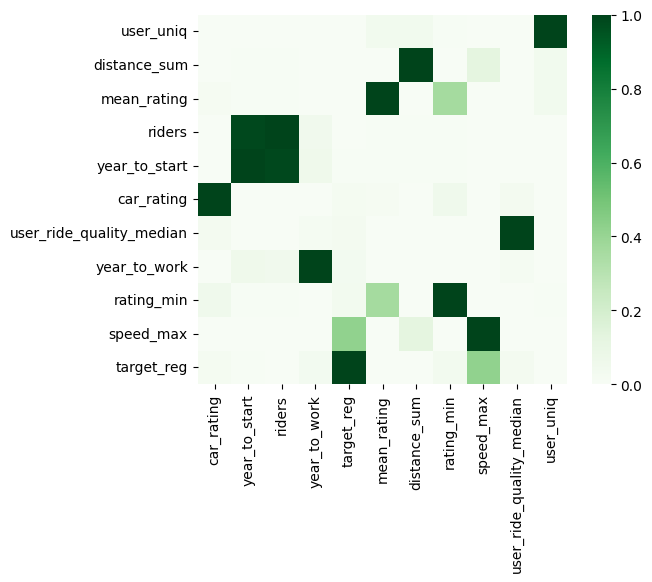

In [41]:
corrs = df.dropna().corr().round(3).sort_values('target_reg')
sns.heatmap(corrs,
            cmap = 'Greens',
            square=True,
            vmin = 0)

### Phik - correlation on steroids --- [tutorial on correlation](https://towardsdatascience.com/phik-k-get-familiar-with-the-latest-correlation-coefficient-9ba0032b37e7?gi=19180d073381)

- ✅ Non-linear dependencies
- ❌ Pair dependencies
- ✅ Categorical features
- ❌ Feature amount <-> Computational speed


**Logarifmic probability:** (for graphic below)
- example --- log(probability) > 6.63
    - probability that result is RANDOM < 1 %
    - 99% sure that result MEANS something
    - in terms of 'p-value' it's --- p < 0.01
- example --- log (probability) >= 3.84
    - probability that result is RANDOM < 5 %
    - 95% sure that result MEANS something
    - in terms of 'p-value' it's --- p < 0.05

In [43]:
import phik
from phik.report import plot_correlation_matrix
from phik import report

interval columns not set, guessing: ['car_rating', 'year_to_start', 'riders', 'year_to_work', 'target_reg', 'mean_rating', 'distance_sum', 'rating_min', 'speed_max', 'user_ride_quality_median', 'user_uniq']


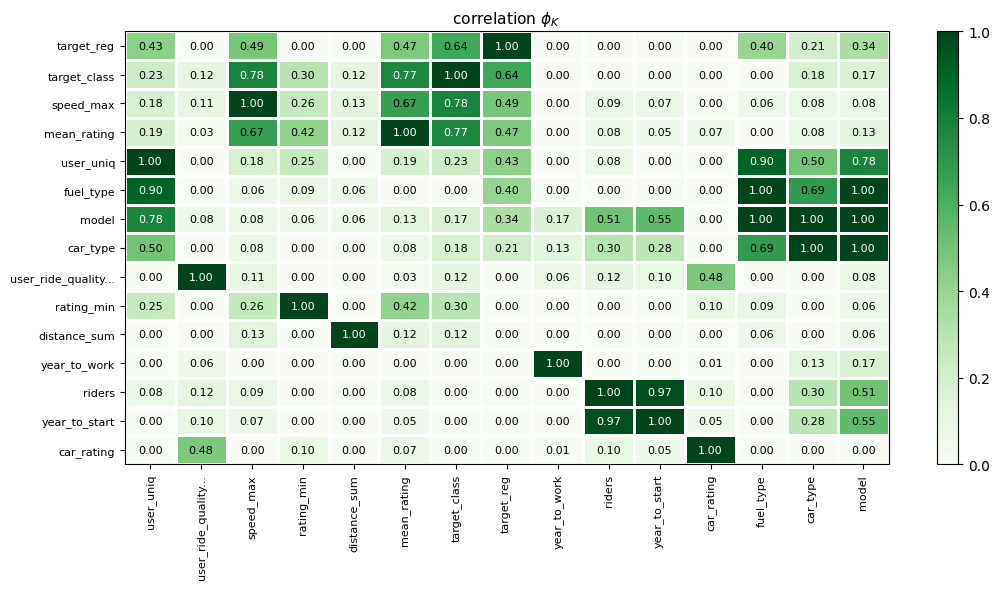

In [44]:
phik_overview = df.phik_matrix().round(2).sort_values('target_reg')

plot_correlation_matrix(phik_overview.values, 
                        x_labels=phik_overview.columns, 
                        y_labels=phik_overview.index, 
                        vmin=0, vmax=1, color_map="Greens", 
                        title=r"correlation $\phi_K$", 
                        fontsize_factor=0.8, figsize=(11, 6))
plt.tight_layout()

interval columns not set, guessing: ['car_rating', 'year_to_start', 'riders', 'year_to_work', 'target_reg', 'mean_rating', 'distance_sum', 'rating_min', 'speed_max', 'user_ride_quality_median', 'user_uniq']


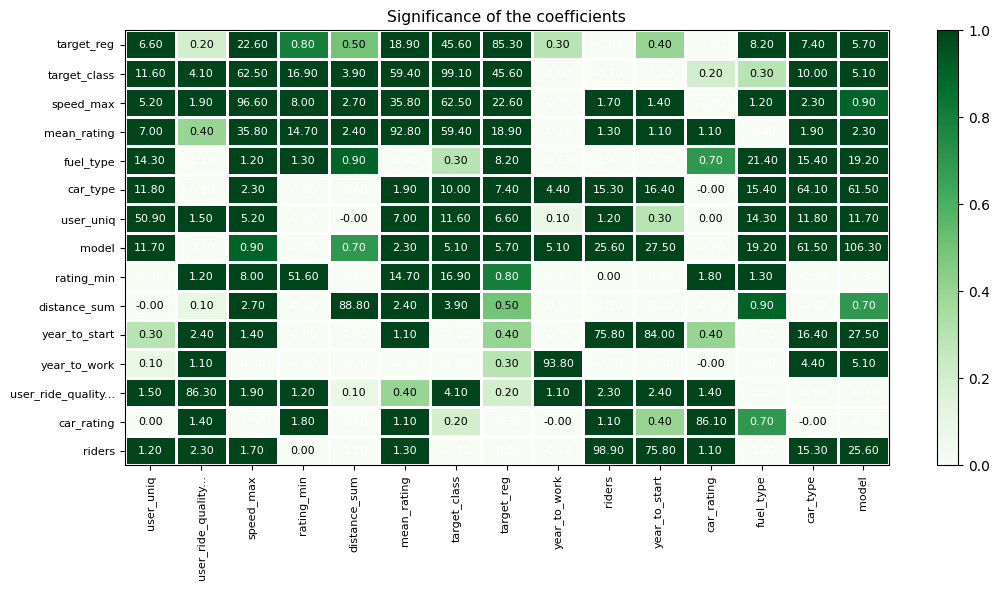

In [45]:
significance_overview = df.significance_matrix().fillna(0).round(1).sort_values('target_reg')

plot_correlation_matrix(significance_overview.values, 
                        x_labels=significance_overview.columns, 
                        y_labels=significance_overview.index, 
                        vmin=0, vmax=1, color_map="Greens",
                        title="Significance of the coefficients", 
                        usetex=False, fontsize_factor=0.8, figsize=(11, 6))
plt.tight_layout()

### Feature Importance
- ❌ **top features NOT ALWAYS is subset for best accuracy**
    - correlation of 'set' of features is lost
    - example: 
        - boosting model ---> feature importance once ---> with HIGH-correlated features **THEY ARE SPLITTING IMPORTANCE AMONG THEMSELVES**
        - result --- low feature importance, if we drop them - only trash remains in TOP

In [48]:
from catboost import CatBoostRegressor, Pool, CatBoostClassifier
from sklearn.model_selection import train_test_split

drop_cols = ['car_id', 'target_class', 'target_reg']
cat_cols = ['car_type', 'fuel_type', 'model']

X = df.drop(drop_cols, axis=1, errors = 'ignore')
y = df['target_class'].fillna(0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = CatBoostClassifier(random_state=42,
                           cat_features=cat_cols,
                           thread_count=-1)
model.fit(X_train, y_train, 
          eval_set=(X_test, y_test),
          verbose=100, plot=False, 
          early_stopping_rounds=100)

Learning rate set to 0.109335
0:	learn: 1.8108068	test: 1.8310378	best: 1.8310378 (0)	total: 191ms	remaining: 3m 10s
100:	learn: 0.3945509	test: 0.5466711	best: 0.5458085 (99)	total: 5.48s	remaining: 48.8s
200:	learn: 0.2784953	test: 0.5316054	best: 0.5308390 (187)	total: 11.2s	remaining: 44.4s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.5308390349
bestIteration = 187

Shrink model to first 188 iterations.


In [49]:
# посмотрим на важность признаков катбуста
fi = model.get_feature_importance(prettified=True)
fi

,Feature Id,Importances
0,speed_max,34.437
1,mean_rating,34.404
2,rating_min,13.493
3,model,4.193
4,user_uniq,3.192
5,car_type,3.047
6,user_ride_quality_median,1.836
7,riders,1.590
8,distance_sum,1.334
9,year_to_work,1.176


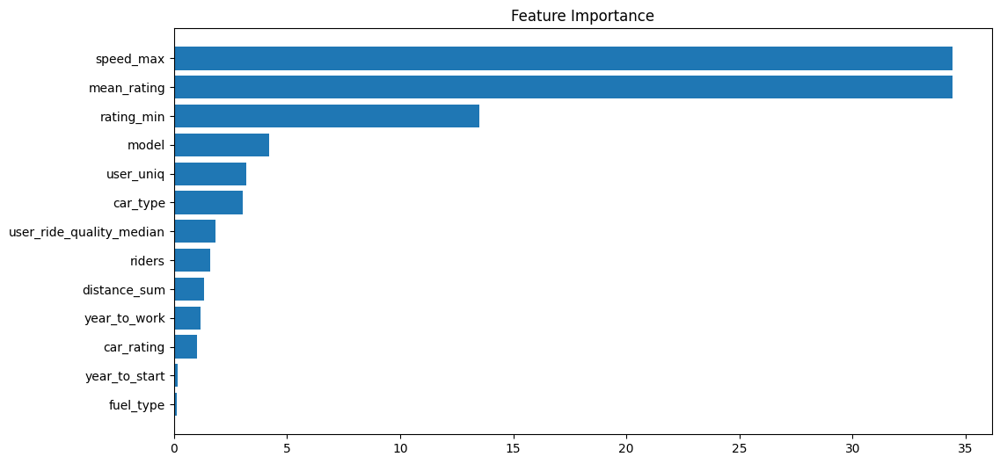

In [50]:
feature_importance = model.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(12, 6))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X.columns)[sorted_idx])
plt.title('Feature Importance');

### Permutation importance
- ✅ shuffle values in chosen column 
    - **feature important ---> shuffling DROPPED model metric AND increased errors**
- ❌ weakness --- importance feature interpretation - (different kind)
    - example
        - feature A affects DRASTICALLY --- but in some of samples
        - feature B affects LITTLE --- but in all samples
    - Both features are important but differently --- **you won't see the difference of this importance in classic feature importance methods**
- ❌ weakness --- importance can strongly depend on distribution of data --- it can differ from TRAINING to TESTING (inference)
    - this adds more ambiguity to definition of FEATURE IMPORTANCE

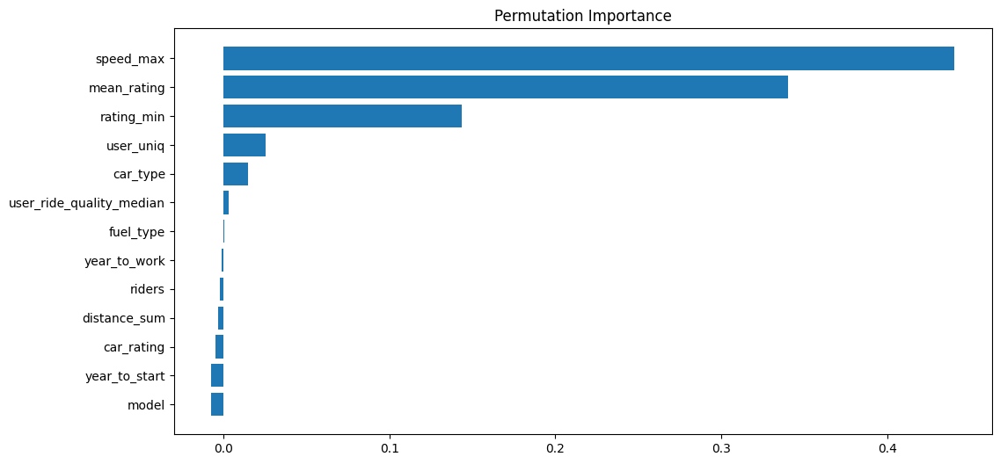

In [69]:
from sklearn.inspection import permutation_importance

perm_importance = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=1066)
sorted_idx = perm_importance.importances_mean.argsort()
fig = plt.figure(figsize=(12, 6))
plt.barh(range(len(sorted_idx)), perm_importance.importances_mean[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X.columns)[sorted_idx])
plt.title('Permutation Importance');

### SHAP values --- (game-theory)
- depend on data distribution --- meaning it is characteristic of **model + data distribution**
    - can get non-0 values for features that model DOESNT use at all

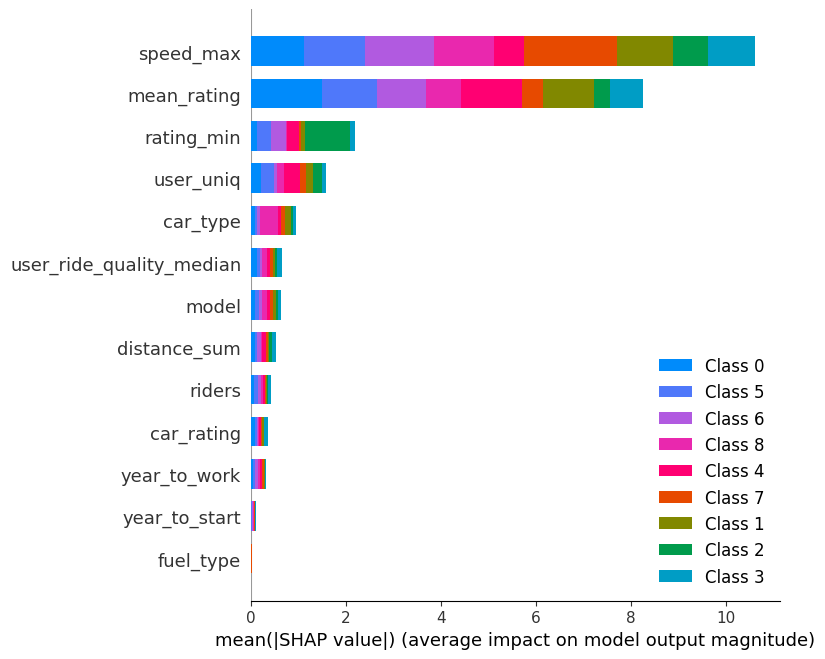

In [70]:
# Посмотрим на SHAP values
explainer = shap.TreeExplainer(model)

val_dataset = Pool(data=X_test, label=y_test, cat_features=cat_cols)
shap_values = explainer.shap_values(val_dataset)
shap.summary_plot(shap_values, X_test, max_display = 25)

### CatBoost feature selection --- (recursive methods)
- 'select_features' method
    - RecursiveByShapValues --- by DEFAULT, most accurate, most computational COSTLY
    - RecursiveByPredictionValuesChange --- most fast, pretty accurate
    - RecursiveByLossFunctionChange --- optimal in both speed and accuracy

In [81]:
summary = model.select_features(X_train, y_train, 
                      eval_set=(X_test, y_test),
                      features_for_select='0-12',
                      num_features_to_select=8,
                      steps=1,
                      train_final_model=False,
                      logging_level='Silent')

In [74]:
# Посмотрим на список отобранных фичей (не отранжирован по важности)
print(summary['selected_features_names'])
# И на лучшее значение лосса
print(f"Best loss: {summary['loss_graph']['loss_values'][-1]}")

['car_type', 'fuel_type', 'car_rating', 'year_to_start', 'riders', 'year_to_work', 'mean_rating', 'distance_sum']
Best loss: 0.5480299270917871


In [75]:
# В summary сохраняется полный отчет работы алгоритма
summary

{'selected_features': [1, 2, 3, 4, 5, 6, 7, 8],
 'eliminated_features_names': ['model'],
 'loss_graph': {'main_indices': [0],
  'removed_features_count': [0, 1],
  'loss_values': [0.5525768457347724, 0.5480299270917871]},
 'eliminated_features': [0],
 'selected_features_names': ['car_type',
  'fuel_type',
  'car_rating',
  'year_to_start',
  'riders',
  'year_to_work',
  'mean_rating',
  'distance_sum']}

### Boruta
- requires OneHotEncoding (categorical ---> numerical)
- shows good results (using RandomForest)
- weaknesses
    - really small speed (for big data)
    - bad with NNs, Boostings

How works:
- Creates copy of all initial features
- Shuffle values for new features --- these duplicates called 'shadow features'
- N times runs training of RandomForest 
    - smoothes random noise for estimating importance
- By using calculated threshold --- cut features
- 3 areas created --- red | blue | green
    - all features from 'red' are deleted
    - all from 'blue' and 'green' saved --- where green are most important

In [57]:
from boruta import BorutaPy
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

X_train_one_hot = pd.get_dummies(X_train[cat_cols])
X_train = pd.concat((X_train.drop(columns=cat_cols), X_train_one_hot), axis=1).fillna(0)
X_train.head()

###initialize Boruta
forest = RandomForestClassifier(
   n_jobs = -1, 
   max_depth = 3
)
boruta = BorutaPy(
   estimator = forest, 
   n_estimators = 'auto',
   max_iter = 8, # number of trials to perform
    verbose=1
)
### fit Boruta (it accepts np.array, not pd.DataFrame)
boruta.fit(np.array(X_train), np.array(y_train))
### print results
green_area = X_train.columns[boruta.support_].to_list()
blue_area = X_train.columns[boruta.support_weak_].to_list()
red_area = X_train.columns[~(boruta.support_ | boruta.support_weak_)].to_list()
print('features in the green area:', green_area)
print('features in the blue area:', blue_area)
print('features in the red area:', red_area)

Iteration: 1 / 8
Iteration: 2 / 8
Iteration: 3 / 8
Iteration: 4 / 8
Iteration: 5 / 8
Iteration: 6 / 8
Iteration: 7 / 8


BorutaPy finished running.

Iteration: 	8 / 8
Confirmed: 	0
Tentative: 	6
Rejected: 	0
features in the green area: []
features in the blue area: ['mean_rating', 'distance_sum', 'rating_min', 'speed_max', 'user_ride_quality_median', 'user_uniq']
features in the red area: ['car_rating', 'year_to_start', 'riders', 'year_to_work', 'car_type_business', 'car_type_economy', 'car_type_premium', 'car_type_standart', 'fuel_type_electro', 'fuel_type_petrol', 'model_Audi A3', 'model_Audi A4', 'model_Audi Q3', 'model_BMW 320i', 'model_Fiat 500', 'model_Hyundai Solaris', 'model_Kia Rio', 'model_Kia Rio X', 'model_Kia Rio X-line', 'model_Kia Sportage', 'model_MINI CooperSE', 'model_Mercedes-Benz E200', 'model_Mercedes-Benz GLC', 'model_Mini Cooper', 'model_Nissan Qashqai', 'model_Renault Kaptur', 'model_Renault Sandero', 'model_Skoda Rapid', 'model_Smart Coupe', 'model_Smart ForFou

### BoostARoota
- requires OneHotEncoding (categorical ---> numerical)
- same as Boruta --- but instead of RandomForest **uses XGBoost**
- **results are same as Boruta, but WAY FASTER**
    - uses different approach for feature deletion

In [59]:
from boostaroota import BoostARoota
from sklearn.preprocessing import LabelEncoder
import warnings
warnings.filterwarnings("ignore")

le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)

br = BoostARoota(metric='logloss', silent=True)

#Fit the model for the subset of variables
br.fit(X_train, y_train_enc)

[15:41:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[15:41:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[15:41:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[15:41:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[15:41:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[15:41:55] WARNING: 

In [60]:
# Можно взглянуть на значения важности признаков
pd.DataFrame(br.keep_vars_)

,feature
0,car_rating
1,year_to_start
2,riders
3,year_to_work
4,mean_rating
5,distance_sum
6,rating_min
7,speed_max
8,user_ride_quality_median
9,user_uniq


## About regularization (Lasso, Ridge, ElasticNet)
- Good for Linear Regressions --- Bad on modern algorithms
- What do we need reguliraztion?
    - for regulating model complexity (**simplifying model**)
    - **deal with overfitting and increase robust**
    - used when independent features correlate with each other (**features multicollinearity**)
        - also works for total features multicollinearity
    - most models use built-in Reguliraztion (CatBoost, LightGBM, RF, SVM)
- What regularization to choose:
    - Lasso (L1) --- when predictive ability of data is among small amount of features (0'ing other features)
    - Ridge (L2) --- when predictive ability of data is split across features (lowering all coefficients values)
    - ElasticNet (combo L1 + L2)
    - **It's hard to say at first --- better practice with different Lambda values**

__

**Main sources of model errors:**
- **variance** --- connected with sensitivity of model to small changes (in training data)
- **bias** --- connected with wrong model assumptions about the connection between features and target

The task is to get **most effective robust model = minimal "variance" and "bias"**

__

**Simple regression model**:
- y = a + b * x
- Task is to find coefficients that minimizes metric
- Overfitting is the problem

**Ridge and Lasso** regression models --- models with penalties (penalty coefficients called **regularization**) 
- they add adjustments to coefficients
- **Lasso (L1)** --- apply penalty to the **'L1 coefficients norm'**
    - L1 norm - is the sum of |coeff|
    - throws away useless coefficients (setting values to 0's)
- **Ridge (L2)** --- apply penalty to the **'L2 coefficients norm'**
    - L2 norm - is the sum of sqrt(coeff^2)
    - doesnt allow coefficients to be of extreme values --- (common for overfitting)
- Lambda (regularization coefficient)
    - the value (quantity) of penalty
    - lambda = 0 ---> simple linear regression model

__

### Code for --- linear, lasso, ridge, elasticNet
- using rides_info
- OneHotEncoding --- using 'get_dummies'
- StandardScaler --- **normalization is important for linear model ---> without normalization - regularization won't work**

#### Data load, Encoding, Scaling, Splitting

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.metrics import mean_squared_error

import warnings
warnings.filterwarnings("ignore")

In [30]:
rides_info = pd.read_csv('tmp_data/quickstart_train.csv')

drop_cols = ['car_id', 'target_reg', 'target_class']
cat_cols = ['car_type', 'fuel_type', 'model']

# categorical ---> oneHotEncoding
rides_info = pd.get_dummies(rides_info, columns=cat_cols)

rides_info.head()

,car_id,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq,car_type_business,car_type_economy,car_type_premium,car_type_standart,fuel_type_electro,fuel_type_petrol,model_Audi A3,model_Audi A4,model_Audi Q3,model_BMW 320i,model_Fiat 500,model_Hyundai Solaris,model_Kia Rio,model_Kia Rio X,model_Kia Rio X-line,model_Kia Sportage,model_MINI CooperSE,model_Mercedes-Benz E200,model_Mercedes-Benz GLC,model_Mini Cooper,model_Nissan Qashqai,model_Renault Kaptur,model_Renault Sandero,model_Skoda Rapid,model_Smart Coupe,model_Smart ForFour,model_Smart ForTwo,model_Tesla Model 3,model_VW Polo,model_VW Polo VI,model_VW Tiguan,model_Volkswagen ID.4
0,y13744087j,3.780,2015,76163,2021,108.530,another_bug,4.738,12141310.405,0.100,180.856,0.023,174,170,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,O41613818T,3.900,2015,78218,2021,35.200,electro_bug,4.481,18039092.838,0.000,187.863,12.306,174,174,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,d-2109686j,6.300,2012,23340,2017,38.620,gear_stick,4.768,15883659.428,0.100,102.383,2.513,174,173,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,u29695600e,4.040,2011,1263,2020,30.340,engine_fuel,3.881,16518828.765,0.100,172.793,-5.029,174,170,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
4,N-8915870N,4.700,2012,26428,2017,30.450,engine_fuel,4.181,13983174.664,0.100,203.462,-14.260,174,171,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [6]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
target_scaler = StandardScaler()
df = scaler.fit_transform(rides_info.drop(drop_cols, axis=1))
target = target_scaler.fit_transform(rides_info['target_reg'].values.reshape(-1, 1))

# -----------------------------------------------

X = rides_info.drop(drop_cols, axis=1)
y = rides_info['target_reg']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#### Linear Regression

In [10]:
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)
y_pred = linear_reg.predict(X_test)

# посчитаем RMSE, чтобы избавиться от ошибки в квадрате (что это за ошибка дни в квадрате)
rmse_linear = mean_squared_error(y_pred, y_test) ** 0.5

print(rmse_linear)

14.692182293249806


In [11]:
# Посмотрим на вектор весов
print(linear_reg.coef_)

[ 3.34755128e-01 -9.01260986e-02  4.04867086e-06  1.79883490e-01
  1.23910083e+01 -3.54648177e-07  1.07505289e+01  3.21350544e-01
  1.05601152e-01  2.30926389e-14 -1.21076465e+00  3.17674176e+00
 -1.90475633e+00 -1.12020970e-01 -1.15996446e+00  4.62049466e-01
 -4.62049466e-01  4.04524240e+00  8.47907859e+00  9.56580246e-01
 -8.01330832e-01 -2.90086765e+00 -1.18500947e+00  1.74716629e+00
 -2.12332938e-01 -9.86235752e-01 -2.17118155e-01  1.40549717e+01
 -4.80588031e+00 -4.16339595e+00  1.79324483e+00  7.41744194e-01
 -2.04405605e+00  3.59465548e-01 -2.62304947e-01  1.24717311e+00
  1.96351656e-01 -1.50102062e+00 -2.55235582e+00 -1.47603689e+00
 -5.73168105e-01  1.10066132e+00 -1.10405664e+01]


In [12]:
# Посмотрим на свободный член бэта0
print(linear_reg.intercept_)

-32.53977599122607


#### Lasso Regression
- 0'ing coefficients --- giving **budjet** to important ones (setting their coefficients high)
- drops with RMSE metric

In [13]:
lambda_values = [0.00001, 0.0001, 0.001, 0.005, 0.01, 0.05,  0.1, 0.2, 0.3, 0.4, 0.5]

for lambda_val in lambda_values:
    lasso_reg = Lasso(lambda_val)
    lasso_reg.fit(X_train, y_train)
    y_pred = lasso_reg.predict(X_test)
    #y_pred = target_scaler.inverse_transform(np.array(y_pred).reshape(-1, 1))
    #y_true = target_scaler.inverse_transform(np.array(y_test).reshape(-1, 1))
    rmse_lasso = mean_squared_error(y_pred, y_test) ** 0.5
    #mse_lasso = mean_squared_error(y_pred, y_test)
    print(("Lasso MSE with Lambda={} is {}").format(lambda_val, rmse_lasso))

Lasso MSE with Lambda=1e-05 is 14.692201803478005
Lasso MSE with Lambda=0.0001 is 14.692554091614253
Lasso MSE with Lambda=0.001 is 14.696048735862165
Lasso MSE with Lambda=0.005 is 14.707808112770875
Lasso MSE with Lambda=0.01 is 14.715429502568293
Lasso MSE with Lambda=0.05 is 14.760229017890639
Lasso MSE with Lambda=0.1 is 14.804929626394813
Lasso MSE with Lambda=0.2 is 14.948974407571898
Lasso MSE with Lambda=0.3 is 15.055570939826492
Lasso MSE with Lambda=0.4 is 15.10086772550061
Lasso MSE with Lambda=0.5 is 15.131687360204882


In [14]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2337 entries, 0 to 2336
Data columns (total 43 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   car_rating                2337 non-null   float64
 1   year_to_start             2337 non-null   int64  
 2   riders                    2337 non-null   int64  
 3   year_to_work              2337 non-null   int64  
 4   mean_rating               2337 non-null   float64
 5   distance_sum              2337 non-null   float64
 6   rating_min                2337 non-null   float64
 7   speed_max                 2337 non-null   float64
 8   user_ride_quality_median  2337 non-null   float64
 9   deviation_normal_count    2337 non-null   int64  
 10  user_uniq                 2337 non-null   int64  
 11  car_type_business         2337 non-null   uint8  
 12  car_type_economy          2337 non-null   uint8  
 13  car_type_premium          2337 non-null   uint8  
 14  car_type

In [15]:
# Посмотрим на вектор весов при самом большом значении лямбда
print(lasso_reg.coef_)

[ 0.00000000e+00 -0.00000000e+00  1.23845820e-06  1.50452027e-01
  9.57116769e+00 -4.03158665e-07  0.00000000e+00  2.87994601e-01
  9.03433799e-02  0.00000000e+00 -1.09699515e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00]


In [16]:
# Посмотрим на вектор весов при самом низком значении лямбда
lasso_reg = Lasso(lambda_values[0])
lasso_reg.fit(X_train, y_train)

print(lasso_reg.coef_)

[ 3.34772444e-01 -8.99674662e-02  4.04199606e-06  1.79880117e-01
  1.23909913e+01 -3.54652732e-07  1.07500509e+01  3.21350412e-01
  1.05598828e-01  0.00000000e+00 -1.21057258e+00  5.58383251e+00
 -9.84885932e-01  2.25631138e+00 -1.27015923e-01  2.84967572e+00
 -8.98566347e-13  3.01910864e+00  7.45320065e+00 -6.70748074e-02
 -1.86280107e+00 -3.96328611e+00 -7.61106671e-01  2.17064258e+00
  2.11246102e-01 -5.62325227e-01  9.34105604e-02  1.10650043e+01
 -5.86815202e+00 -5.22470747e+00  7.28609557e-01  1.05224492e+00
 -1.73325168e+00  6.69973878e-01  1.61216262e-01  1.67060693e+00
  6.19877110e-01 -1.07722676e+00 -5.49523324e+00 -1.05215873e+00
 -1.49378565e-01  1.52426519e+00 -1.39847406e+01]


#### Ridge Regression
- lambda in Ridge != lambda in Lasso
- 0'ed only 1 coefficient (while Lasso 0'ed 8 of them)
- lowered coefficient values for MOST of coefficients
- metric not really changes --- due to specific of data

In [17]:

lambda_values = [0.00001, 0.01, 0.05, 0.1, 0.5, 1, 1.5, 3, 5, 6, 7, 8, 9, 10]

for lambda_val in lambda_values:
    ridge_reg = Ridge(lambda_val)
    ridge_reg.fit(X_train, y_train)
    y_pred = ridge_reg.predict(X_test)
    rmse_ridge = mean_squared_error(y_pred, y_test) ** 0.5
    print(("Lasso MSE with Lambda={} is {}").format(lambda_val, rmse_ridge))

Lasso MSE with Lambda=1e-05 is 14.692182393628464
Lasso MSE with Lambda=0.01 is 14.69228264760514
Lasso MSE with Lambda=0.05 is 14.692683484217639
Lasso MSE with Lambda=0.1 is 14.693183180792278
Lasso MSE with Lambda=0.5 is 14.697119782080058
Lasso MSE with Lambda=1 is 14.701864173544573
Lasso MSE with Lambda=1.5 is 14.706390912595738
Lasso MSE with Lambda=3 is 14.718639413053285
Lasso MSE with Lambda=5 is 14.732207366799633
Lasso MSE with Lambda=6 is 14.738027423151843
Lasso MSE with Lambda=7 is 14.74332636763287
Lasso MSE with Lambda=8 is 14.748180639016196
Lasso MSE with Lambda=9 is 14.752655051668977
Lasso MSE with Lambda=10 is 14.756804168880112


In [18]:
# Вектор весов при высокой лямбда
print(ridge_reg.coef_)

[ 3.77728605e-01 -1.03647535e-01  5.57326716e-06  1.83540999e-01
  1.21122556e+01 -3.66902456e-07  8.86940569e+00  3.17493119e-01
  1.01923007e-01  0.00000000e+00 -9.96059850e-01  2.60104684e+00
 -2.10327602e+00  8.14910209e-01 -1.31268103e+00  2.09265631e+00
 -2.09265631e+00  1.64158661e+00  4.55549952e+00 -8.16056139e-02
 -3.24136514e-02 -1.59299595e+00 -1.06162572e+00  1.52289362e+00
 -1.75605762e-01 -9.06922676e-01 -1.88375222e-01  7.39322661e+00
 -2.75443594e+00 -1.71180085e+00  1.29946663e+00  5.56950817e-01
 -1.95324893e+00  2.71992306e-01 -2.58556700e-01  1.01855247e+00
  1.66543556e-01 -1.48322422e+00 -3.96392699e-01 -1.36233265e+00
 -6.25188575e-01  1.06219063e+00 -4.90417761e+00]


In [20]:
# Вектор весов при низкой лямбда
ridge_reg = Lasso(lambda_values[0])
ridge_reg.fit(X_train, y_train)

print(ridge_reg.coef_)

[ 3.34772444e-01 -8.99674662e-02  4.04199606e-06  1.79880117e-01
  1.23909913e+01 -3.54652732e-07  1.07500509e+01  3.21350412e-01
  1.05598828e-01  0.00000000e+00 -1.21057258e+00  5.58383251e+00
 -9.84885932e-01  2.25631138e+00 -1.27015923e-01  2.84967572e+00
 -8.98566347e-13  3.01910864e+00  7.45320065e+00 -6.70748074e-02
 -1.86280107e+00 -3.96328611e+00 -7.61106671e-01  2.17064258e+00
  2.11246102e-01 -5.62325227e-01  9.34105604e-02  1.10650043e+01
 -5.86815202e+00 -5.22470747e+00  7.28609557e-01  1.05224492e+00
 -1.73325168e+00  6.69973878e-01  1.61216262e-01  1.67060693e+00
  6.19877110e-01 -1.07722676e+00 -5.49523324e+00 -1.05215873e+00
 -1.49378565e-01  1.52426519e+00 -1.39847406e+01]


#### ElasticNet (combo of L1 + L2)
- **useful when multiple features correlates with each other**
    - Lasso will likely pick 1 --- ElasticNet will pick both features
- **trade-off between Lasso and Ridge** (inherit Ridge's stability with Lasso 0'ing)

In [21]:
l1_ratios = [0.00001, 0.001, 0.01, 0.05, 0.1, 0.5, 0.7, 0.9, 1]

for l1_ratio in l1_ratios:
    elasticnet_reg = ElasticNet(l1_ratio=l1_ratio)
    elasticnet_reg.fit(X_train, y_train)
    y_pred = elasticnet_reg.predict(X_test)
    rmse_elastic = mean_squared_error(y_pred, y_test) ** 0.5
    print(("ElasticNet MSE with l1_ratio={} is {}").format(l1_ratio, rmse_elastic))

ElasticNet MSE with l1_ratio=1e-05 is 15.61698403377266
ElasticNet MSE with l1_ratio=0.001 is 15.617020728872923
ElasticNet MSE with l1_ratio=0.01 is 15.617489680396005
ElasticNet MSE with l1_ratio=0.05 is 15.62036358216596
ElasticNet MSE with l1_ratio=0.1 is 15.624056689600009
ElasticNet MSE with l1_ratio=0.5 is 15.624706653535485
ElasticNet MSE with l1_ratio=0.7 is 15.589313952307132
ElasticNet MSE with l1_ratio=0.9 is 15.495627856790028
ElasticNet MSE with l1_ratio=1 is 15.349906725891085


In [22]:
# При высоком значении l1_ratio
print(elasticnet_reg.coef_)

[ 0.00000000e+00  0.00000000e+00  7.52779257e-07  5.43629091e-02
  5.27330816e+00 -4.32854754e-07  0.00000000e+00  2.56897100e-01
  7.96724125e-02  0.00000000e+00 -1.03586573e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00  0.00000000e+00
 -0.00000000e+00 -0.00000000e+00  0.00000000e+00 -0.00000000e+00
 -0.00000000e+00  0.00000000e+00 -0.00000000e+00]


In [23]:
# При низком значении l1_ratio
elasticnet_reg = ElasticNet(l1_ratio=l1_ratios[0])
elasticnet_reg.fit(X_train, y_train)
print(elasticnet_reg.coef_)

[ 2.41178413e-01  7.39241068e-03 -6.80601584e-07  2.20143461e-01
  1.44768446e+00 -4.59306250e-07  4.05901351e-01  2.30829952e-01
  8.23093870e-02  0.00000000e+00 -9.97262061e-01  2.77250363e-01
 -3.04357781e-01  1.36397277e-01 -1.09289859e-01  2.00719255e-01
 -2.00719255e-01  3.69023248e-02  8.83928216e-02  9.63494755e-03
  2.89665671e-02  7.48766273e-03 -6.56624731e-02  5.95689697e-02
 -2.87507434e-02 -8.80628728e-02  1.87421305e-04  1.99272073e-01
 -7.37550516e-03  3.73177219e-03  4.51377937e-02 -1.47370686e-02
 -1.18363558e-01  2.36133467e-02  8.53493574e-03  1.95511061e-02
  4.19118302e-03 -1.28561462e-01  2.36657808e-02 -9.02151867e-02
 -4.57245684e-02  5.07733305e-02 -2.22185980e-02]


## **Task - spot generated features**
- first used Feature Importance to get top features (top 3-5 secured 100% not generated)
- then used 'phik' correlation matrix to grasp at features
- usually generated features correlated with every other feature
    - feature 11 is obvious candidate for generated feature (+ it has no correlation with target) --- also high self-correlation
    - other feature is feature 6 (same self-correlation, not correlated to target as well)

___
# <font color='pink'>📊📳 3.4 **Visual adjust / understand - where model fails** </font>
- **NOT EVERYONE DOES IT - USUALLY NOT HELPING** - but if data is interpreted ---> it can help to generate new ideas (via deeper understanding)
- only for **classification**
    - feature importance (classic + permutation)
        - classic and permutation plot 
        - Kfold CV case
    - SHAP value
        - shap - feature - class --- impact on model plot (linear bins, only positive SHAP)
        - shap - feature value --- impact on model plot (scatter plot, positive and negative SHAP) 
    - confusion matrix
    - metrics (precision, recall, f1-score)

## 1. Classification model
- metrics
- confusion matrix
- partial plots (feature dependence on forecast)
- feature / permutation importance
    - 1 fold / KFold
- SHAP value
- Tree's (for tree models only using graphviz)

### 1.1 Loading data + training model

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq,random_feature_1,random_feature_2,random_feature_3
2005,i-1314717a,VW Polo,economy,petrol,5.620,2015,86871,2020,46.090,engine_check,4.359,11429431.796,0.100,153.798,6.094,174,170,0.922,-0.026,88
932,R89114665D,Kia Rio X-line,economy,petrol,3.200,2013,45176,2021,30.800,engine_fuel,3.944,14804670.465,0.100,186.497,7.238,174,173,0.432,-0.216,6
1448,M-1786506l,Kia Sportage,standart,petrol,5.240,2014,57237,2017,28.630,break_bug,5.622,17065627.082,0.590,118.068,-0.162,174,173,0.299,-0.921,48


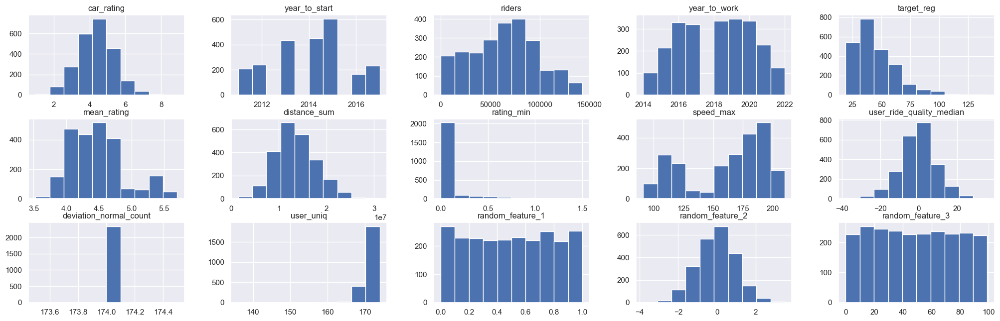

In [56]:
import pandas as pd
import numpy as np

import seaborn as sns; sns.set_theme()
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

path = "tmp_data/quickstart_train.csv"
train = pd.read_csv(path)

# Добавим пару рандомных признаков для последующего анализа
train['random_feature_1'] = np.random.random(size = train.shape[0])
train['random_feature_2'] = np.random.normal(size = train.shape[0])
train['random_feature_3'] = np.random.randint(100, size = train.shape[0])

drop_cols = ['user_id', 'car_id', 'ride_id', 'ride_date']
cat_cols = ['car_type', 'fuel_type', 'model']

y = train['target_class']
X = train.drop(drop_cols + ['target_reg', 'target_class'], axis=1, errors = 'ignore')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

train.hist(figsize=(25, 7.5), layout=(-1, 5))
train.sample(3)

In [57]:
from catboost import CatBoostClassifier, CatBoostRegressor, Pool

clf = CatBoostClassifier(random_seed=9,
                        thread_count=-1,
                        use_best_model=True,
                        cat_features=cat_cols,
                        colsample_bylevel =  0.1,
                        subsample = 0.95,
                        bootstrap_type='Bernoulli')

clf.fit(X_train, y_train,
        eval_set=(X_test, y_test),
        verbose=250,
        plot=False,
        early_stopping_rounds=100)

print(clf.get_best_score())

Learning rate set to 0.109335
0:	learn: 2.0415376	test: 2.0431216	best: 2.0431216 (0)	total: 9.15ms	remaining: 9.14s
250:	learn: 0.3436567	test: 0.5449005	best: 0.5449005 (250)	total: 2.11s	remaining: 6.3s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.5281824582
bestIteration = 376

Shrink model to first 377 iterations.
{'learn': {'MultiClass': 0.23635254695993896}, 'validation': {'MultiClass': 0.528182458239167}}


### 1.2 Metrics - Classification report (sklearn)

In [58]:
from sklearn.metrics import classification_report

y_pred = clf.predict(X_test)
print(classification_report(y_true = y_test,
                            y_pred = y_pred,
                            target_names=clf.classes_))

                 precision    recall  f1-score   support

    another_bug       0.89      0.81      0.85        58
      break_bug       1.00      1.00      1.00        56
    electro_bug       1.00      1.00      1.00        51
   engine_check       0.72      0.84      0.77        49
    engine_fuel       0.72      0.62      0.67        58
engine_ignition       0.55      0.45      0.50        58
engine_overheat       0.44      0.65      0.52        48
     gear_stick       0.92      0.90      0.91        51
    wheel_shake       0.79      0.67      0.72        39

       accuracy                           0.77       468
      macro avg       0.78      0.77      0.77       468
   weighted avg       0.78      0.77      0.77       468



In [59]:
rep = pd.DataFrame(classification_report(y_true = y_test,
                            y_pred = y_pred,
                            target_names=clf.classes_,
                            output_dict=True)).T
rep['support'] = rep.support.apply(int)
rep.style.background_gradient(cmap='viridis', subset=pd.IndexSlice['another_bug':'wheel_shake', :'f1-score'])

,precision,recall,f1-score,support
another_bug,0.886792,0.810345,0.846847,58
break_bug,1.000000,1.000000,1.000000,56
electro_bug,1.000000,1.000000,1.000000,51
engine_check,0.719298,0.836735,0.773585,49
engine_fuel,0.720000,0.620690,0.666667,58
engine_ignition,0.553191,0.448276,0.495238,58
engine_overheat,0.436620,0.645833,0.521008,48
gear_stick,0.920000,0.901961,0.910891,51
wheel_shake,0.787879,0.666667,0.722222,39
accuracy,0.769231,0.769231,0.769231,0


### 1.3 Confusion Matrix

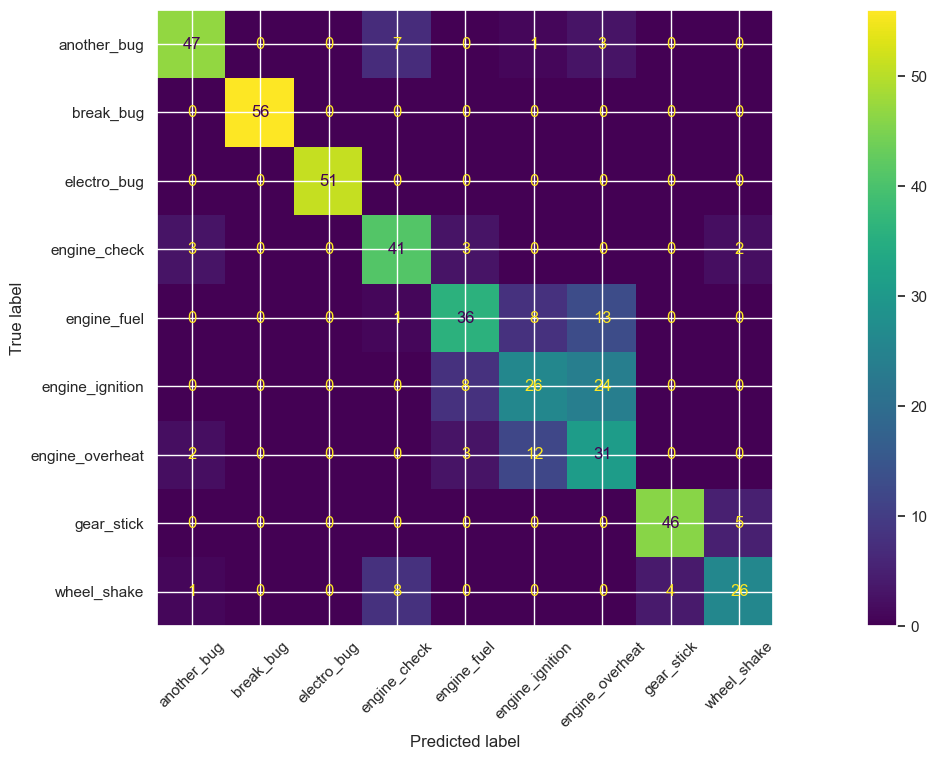

In [60]:
# import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, xticks_rotation = 45)
# Есть модель не под рукой
# ConfusionMatrixDisplay.from_predictions(y_test, y_pred, xticks_rotation = 45)
# plt.show()

<AxesSubplot:>

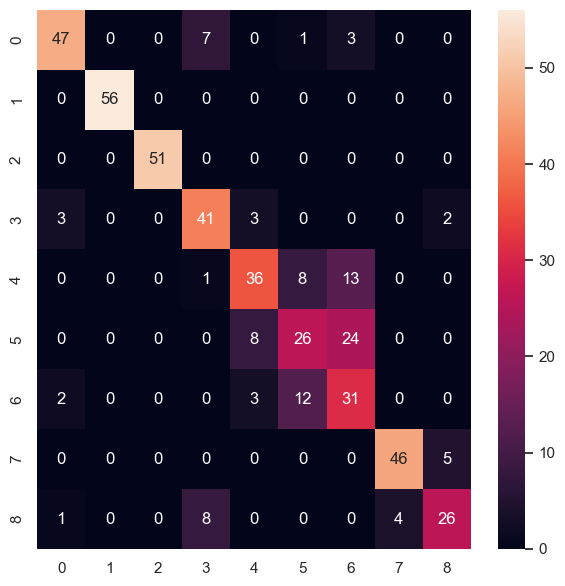

In [61]:
plt.rcParams['figure.figsize']=(7, 7)
cf = confusion_matrix(y_test, y_pred)
sns.heatmap(cf, annot=True)

### 1.4 Partial plots (feature dependence on forecast)

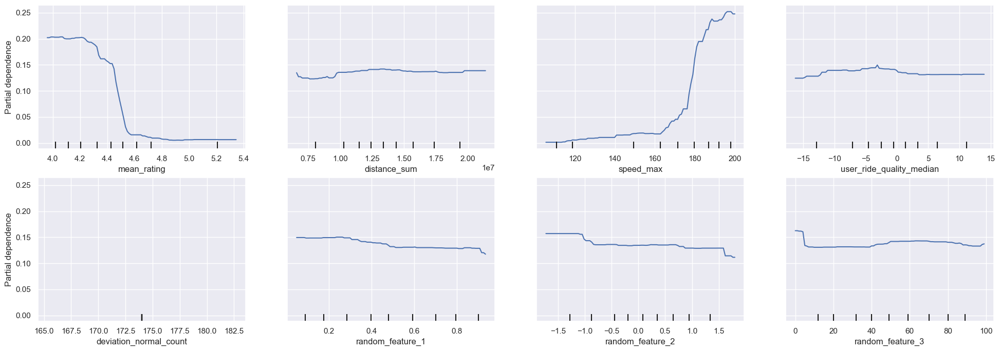

In [62]:
from sklearn.inspection import PartialDependenceDisplay

plt.rcParams['figure.figsize']=(24, 8)
features = X.drop(cat_cols, axis=1).columns

features = ['mean_rating', 'distance_sum', 'speed_max', 'user_ride_quality_median',
            'deviation_normal_count', 'random_feature_1', 'random_feature_2', 'random_feature_3']

PartialDependenceDisplay.from_estimator(clf, X_test,
                                        features = features,
                                        target='engine_overheat',
                                        n_cols=4,
                                        n_jobs=-1,
                                        random_state=42,)

### 1.5 Feature importance

In [63]:
fi = clf.get_feature_importance(prettified=True)
fi[:20] # .style.background_gradient(cmap='viridis', subset=pd.IndexSlice[0:10, 'Importances'])

,Feature Id,Importances
0,speed_max,35.759
1,mean_rating,29.550
2,rating_min,12.158
3,user_uniq,4.309
4,car_type,2.719
5,model,2.199
6,user_ride_quality_median,1.794
7,random_feature_3,1.652
8,distance_sum,1.555
9,car_rating,1.528


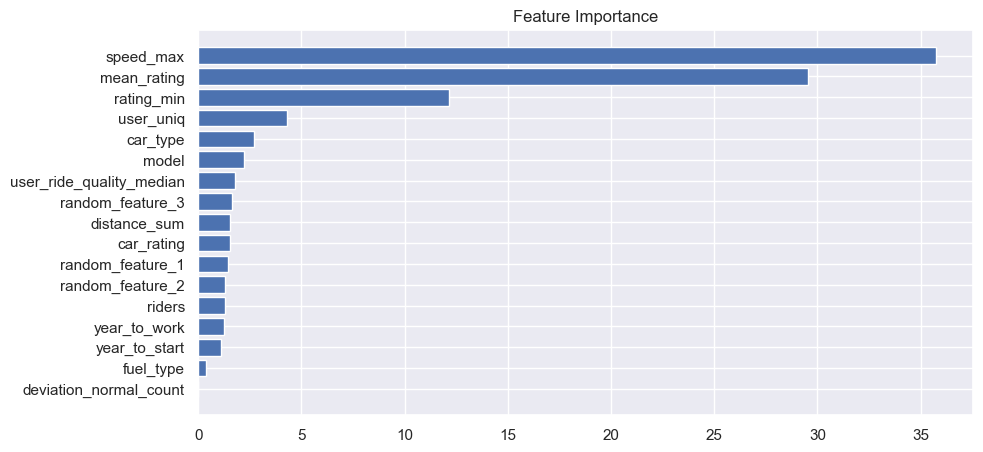

In [64]:
feature_importance = clf.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(10, 5))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_test.columns)[sorted_idx])
plt.title('Feature Importance');

### 1.6 Feature Importance + KFold

In [65]:
from sklearn.model_selection import KFold

n_splits = 5
targets = ['target_class']
clfs = []
scores = []
kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for train_index, test_index in kf.split(X):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index] 
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    train_dataset = Pool(data=X_train, label=y_train, cat_features=cat_cols)
    eval_dataset = Pool(data=X_test, label=y_test, cat_features=cat_cols)

    clf = CatBoostClassifier(random_seed=9,
                        thread_count=-1,
                        use_best_model=True,
                        cat_features=cat_cols,
                        colsample_bylevel =  0.1,
                        subsample = 0.95,
                        bootstrap_type='Bernoulli',)

    clfs.append(clf)

    clf.fit(train_dataset, eval_set=eval_dataset,
            verbose = False, use_best_model = True, plot = False)

    scores.append(np.mean([v for k, v in clf.best_score_['validation'].items()], dtype = 'float16'))
    
print('mean recall score --------->', np.mean(scores, dtype = 'float16'), np.std(scores, dtype = 'float16'))

mean recall score ---------> 0.4973 0.0273


In [66]:
def plot_importance(df, best_model, height, top_n=50):
    
    fi = pd.DataFrame(index = df.columns, columns = [])
    for i, m in enumerate(best_model):
        fi[f'm_{i}'] = m.get_feature_importance()

    fi = fi.stack().reset_index().iloc[:,[0, 2]]#.to_frame()
    fi.columns = ['feature','importance']

    cols_ord = list(fi.groupby('feature')['importance'].mean().sort_values(ascending=False).index)
    print('Всего признаков {} Усреднее по {}-ти моделям: '.format(len(cols_ord), len(best_model)) )
    cols_ord = cols_ord[:top_n]
    
    fi = fi[fi['feature'].isin(cols_ord)]
    
    plt.figure(figsize=(10, len(cols_ord)*height))
    b = sns.boxplot(data=fi, y='feature', x='importance', orient='h', order=cols_ord)
    
    print('На график нанесено топ-{} признаков'.format(top_n))
    return fi.groupby(by =['feature'], as_index=False)['importance'].mean().sort_values(by='importance', ascending=False)

Всего признаков 17 Усреднее по 5-ти моделям: 
На график нанесено топ-14 признаков


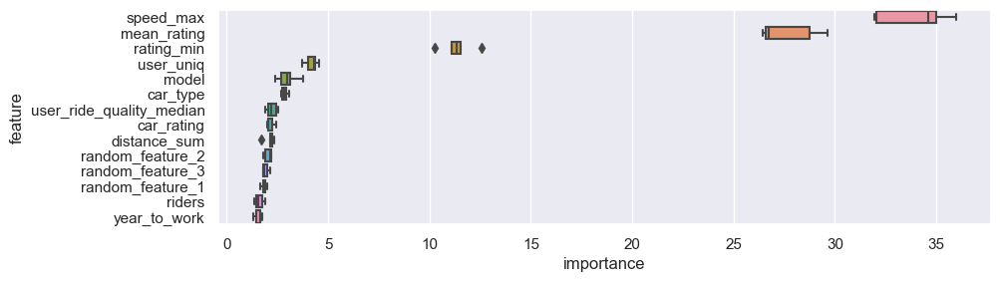

In [67]:
df_feats_imp = plot_importance(X, clfs, height = 0.20, top_n = 14)

### 1.7 Permutation Importance

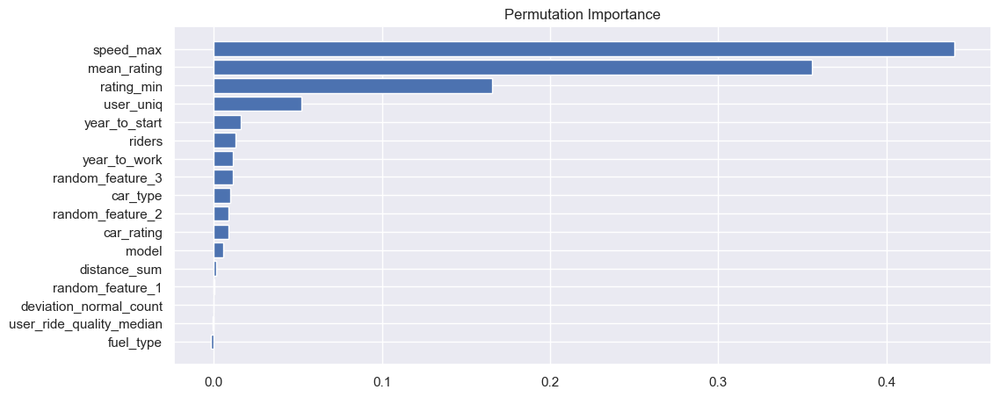

In [68]:
from sklearn.inspection import permutation_importance

perm_importance = permutation_importance(clf, X_test, y_test, n_repeats=10, random_state=1066)
sorted_idx = perm_importance.importances_mean.argsort()
fig = plt.figure(figsize=(12, 5))
plt.barh(range(len(sorted_idx)), perm_importance.importances_mean[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_test.columns)[sorted_idx])
plt.title('Permutation Importance');

### 1.8 SHAP value
- linear bins - model 
- scatter - model impact
    - bigger SHAP ---> more impact on model (negative ~ 0)
    - thicker line ---> more samples
    - more red ---> more feature value in it
- dependence 1 feature - model impact
- force plot
- waterfall plot

In [69]:
import shap

# TO DEFINE SHAP
shap.initjs()

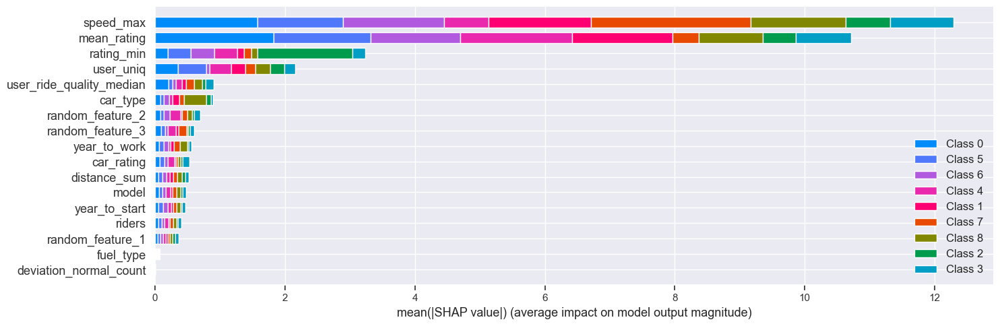

In [70]:
explainer = shap.TreeExplainer(clf)

val_dataset = Pool(data=X_test, label=y_test, cat_features=cat_cols)
shap_values = explainer.shap_values(val_dataset)
shap.summary_plot(shap_values, X_test, max_display = 25, plot_size = (15, 5))

Class 0


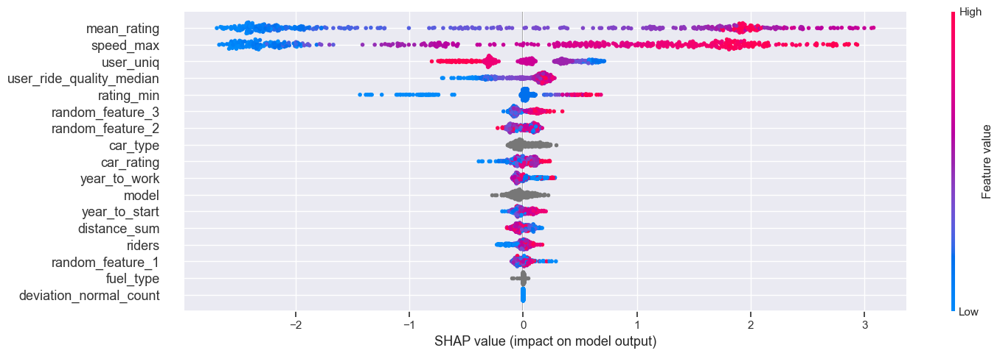

Class 1


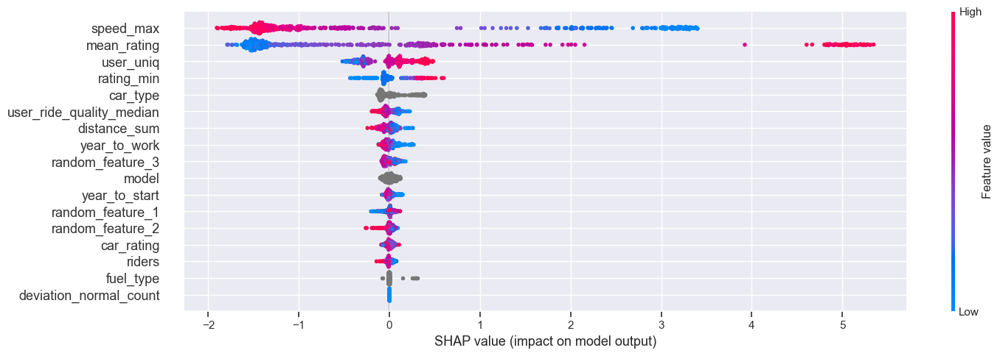

In [71]:
for i in range(len(np.unique(y.values))):
    print(f'Class {i}')
    shap.summary_plot(shap_values[i], X_test, color_bar=True, plot_size = (15, 5))
    if i == 1:
        break
# shap.summary_plot(shap_values[1], X_test, color_bar=False)

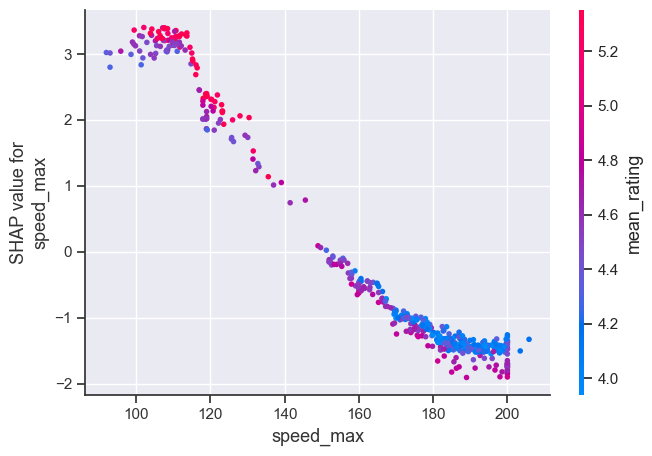

In [72]:
shap.dependence_plot("speed_max", shap_values[1], X_test)

### 1.9 Tree models ONLY

In [ ]:
# !pip install graphviz
# !pip install apt

In [ ]:
clf.plot_tree(
    tree_idx=4,
    pool=val_dataset
)

## 2. Regression model
- helping properly describe data
    - normal distribution of errors
    - using statistics
    - using other condition (via graphics)
- outliers analysis

### Loading data + training model

In [41]:
import pandas as pd
import numpy as np

import seaborn as sns; sns.set_theme()
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

path = "tmp_data/quickstart_train.csv"
train = pd.read_csv(path)

path = "tmp_data/quickstart_train.csv"
train = pd.read_csv(path)

# Добавим пару рандомных признаков для последующего анализа
train['random_feature_1'] = np.random.random(size = train.shape[0])
train['random_feature_2'] = np.random.normal(size = train.shape[0])
train['random_feature_3'] = np.random.randint(100, size = train.shape[0])

drop_cols = ['user_id', 'car_id', 'ride_id', 'ride_date']
cat_cols = ['car_type', 'fuel_type', 'model']

y = train['target_reg']
X = train.drop(drop_cols + ['target_reg', 'target_class'], axis=1, errors = 'ignore')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [42]:
regr = CatBoostRegressor(random_seed=9,
                        thread_count=-1,
                        use_best_model=True,
                        cat_features=cat_cols,
                         )

regr.fit( X_train, y_train, 
        eval_set=(X_test, y_test),
        verbose=50, plot=False, early_stopping_rounds=200)

print(regr.get_best_score())

Learning rate set to 0.056174
0:	learn: 16.9230492	test: 17.7891490	best: 17.7891490 (0)	total: 21.5ms	remaining: 21.5s
50:	learn: 11.1383945	test: 12.5675112	best: 12.5675112 (50)	total: 1.1s	remaining: 20.5s
100:	learn: 10.3504579	test: 12.3188660	best: 12.3188660 (100)	total: 2.26s	remaining: 20.1s
150:	learn: 9.7187930	test: 12.3026757	best: 12.2960261 (131)	total: 3.26s	remaining: 18.3s
200:	learn: 9.0932641	test: 12.3588990	best: 12.2960261 (131)	total: 4.26s	remaining: 16.9s
250:	learn: 8.5530108	test: 12.4139966	best: 12.2960261 (131)	total: 5.31s	remaining: 15.8s
300:	learn: 8.0495582	test: 12.4479721	best: 12.2960261 (131)	total: 6.39s	remaining: 14.9s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 12.29602608
bestIteration = 131

Shrink model to first 132 iterations.
{'learn': {'RMSE': 7.792739387969821}, 'validation': {'RMSE': 12.296026084751732}}


### Visual analysis
- using statistics to properly define

- separation by mean/variance of classes (of X-axis, Y-axis)

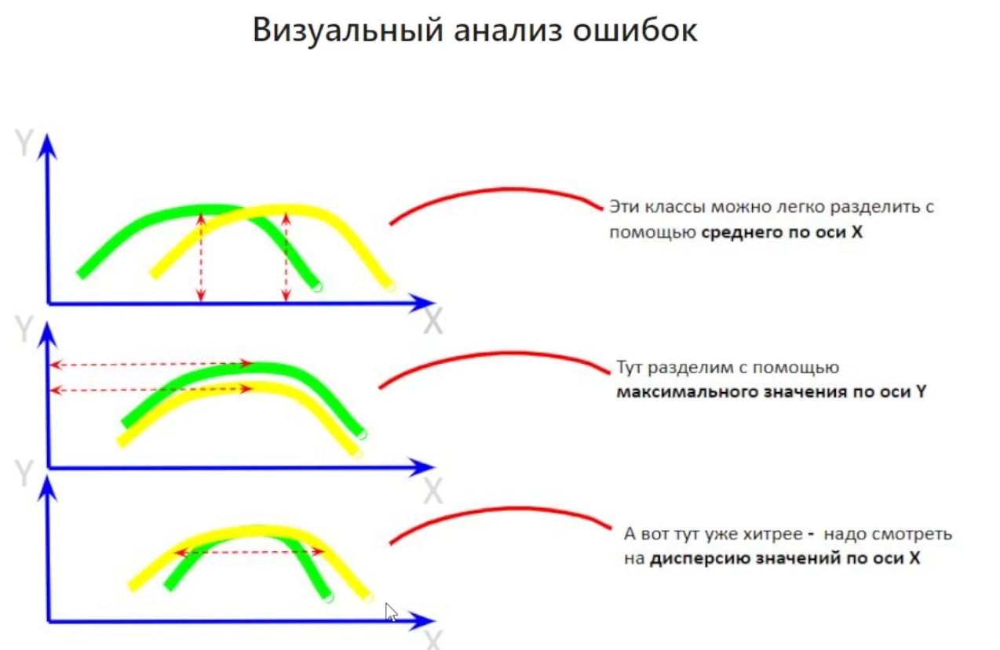

### Remainder (tails) analysis
- outliers --- mean of tails should be consistent
- tails distribution --- if not NORMAL DISTRIBUTION - some info is missing (features aren't perfectly describe data)
- interval of errors --- using scatter we can identify where error is more

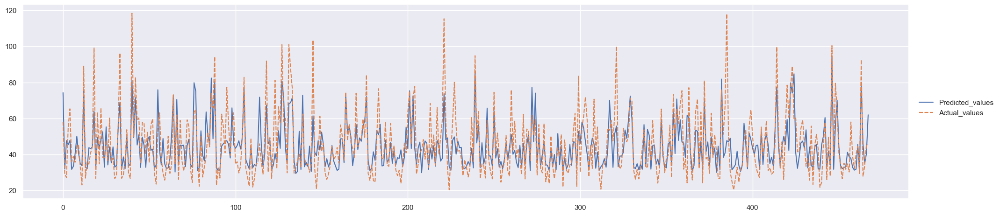

In [43]:
cbr_prediction = regr.predict(X_test)

df_pred = pd.DataFrame(cbr_prediction, columns = ["Predicted_values"])
df_pred["Actual_values"] =  y_test.values

g = sns.relplot(data = df_pred, aspect = 4, kind = 'line')
# g.set(yscale="log")#.set(xscale="log")

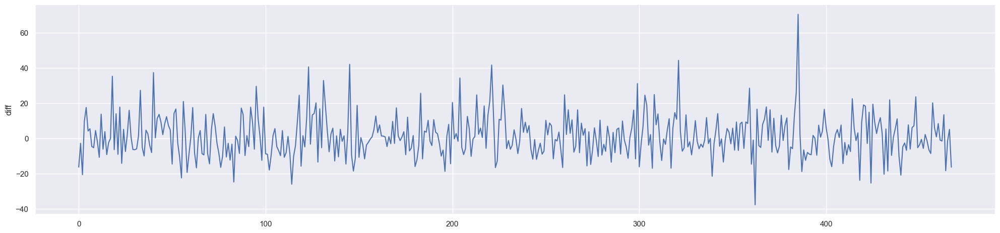

In [44]:
df_pred['diff'] = df_pred["Actual_values"] - df_pred["Predicted_values"]
sns.relplot(data = df_pred['diff'], aspect = 4, kind = 'line')
# sns.displot(data = df_pred['diff'], aspect = 2, bins=60)

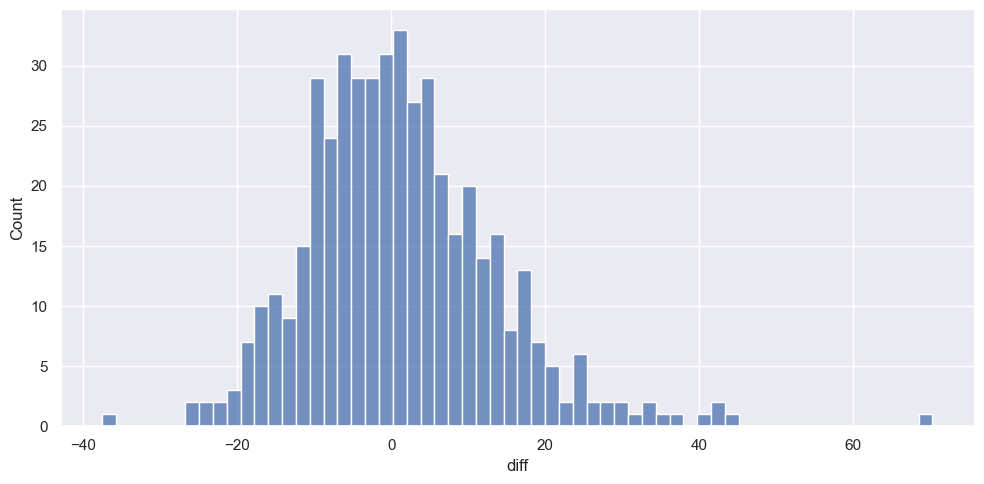

In [73]:
df_pred['diff'] = df_pred["Actual_values"] - df_pred["Predicted_values"]
sns.displot(data = df_pred['diff'], aspect = 2, bins=60)

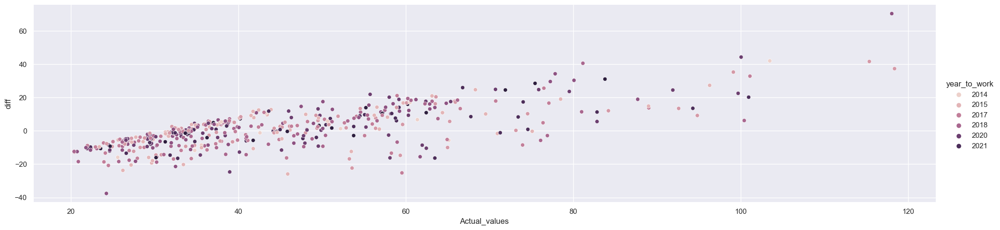

In [45]:
df_pred['year_to_work'] = X_test["year_to_work"].values

g = sns.relplot(data = df_pred,
                x = 'Actual_values',
                y = 'diff',
                hue = 'year_to_work',
                kind = 'scatter',
                aspect = 4,)

# # g.set(yscale="log")#.set(xscale="log")

### Predicted vs. Actual
- with color & size separation --- helps better understand particular values

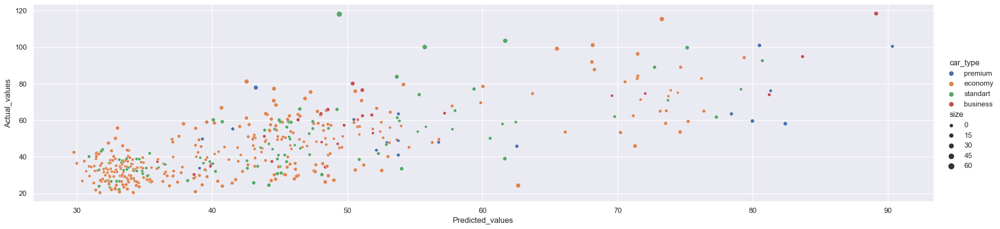

In [39]:
df_pred['car_type'] = X_test['car_type'].values
df_pred['model'] = X_test['model'].values
df_pred['size'] = abs(df_pred["diff"] // 1)

g = sns.relplot(data = df_pred,
                x = 'Predicted_values',
                y = 'Actual_values',
                hue='car_type',
                size = 'size',
                aspect = 4,
                kind = 'scatter')

# g.set(yscale="log")#.set(xscale="log")

### 'True - Pred' vs 'True + Pred' --- plot
- outliers search

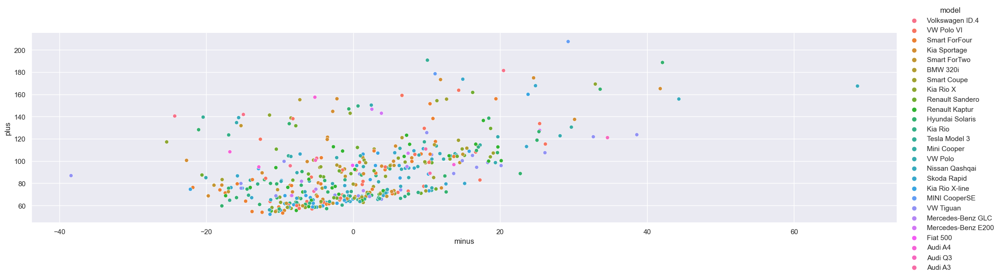

In [40]:
df_pred['plus'] = df_pred["Actual_values"] + df_pred["Predicted_values"]
df_pred['minus'] = df_pred["Actual_values"] - df_pred["Predicted_values"]

g = sns.relplot(data = df_pred,
                x = 'minus',
                y = 'plus',
                hue='model',
                aspect = 4,
                kind = 'scatter')

# g.set(yscale="log")#.set(xscale="log")

___
# <font color='pink'>😺🚀 4.1 **CatBoost** </font>
- [official documentation on CatBoost](https://catboost.ai/en/docs/references/training-parameters/)
- [article on 'categorical features parameters in CatBost' - EN (23 min)](https://towardsdatascience.com/categorical-features-parameters-in-catboost-4ebd1326bee5)
- [habr article on 'Trees, CatBoost, XGBoost' - RU (42 min)](https://habr.com/ru/companies/ods/articles/645887/)

1) full explanation --- +/- || how to use || advices || all parameters explained
2) examples of code --- default || KFold || inference and save/load || object importance (sample selection) || hyperparameter optimization 

- CatBoost - gradient boosting over decision trees (with categorical features support) -- from Yandex (2017)
- builds **SYMMETRICAL** trees
- **works for problems** --- Regression | Binary Classification | Multi Classification | Ranking

## <font color='pink'>Explaining everything (+ parameters)</font>
- advantages and weaknesses
- how to work with CatBoost + advices
- useful info on CatBoost usage from tasks
- all CatBoosts parameters explained

__ - __ - __

**Advantages:**
- **supports features without preprocessing** --- (do it himself) - categorical & text features, embeddings, time features
- **supports GPU** usage --- (requires to set 'border_count = 254')
- in-built **Feature Selection** --- (Recursive FS as well)
- in-built **Object Selection** --- (sample selection - to delete noisy ones if possible [big data])
    - not for all loss-functions --- Logloss | CrossEntropy | RMSE | MAE | Quantile | Expectile | LogLinQuantile | MAPE | Poisson
- in-built **hyperparameter optimization**
- in-built **Cross-Validation**

**Weaknesses:**
- requires manually drop NaN's
- not all 'metrics' and 'loss functions' are available for GPU 

__ - __ - __

**How to work:**
1) Load data + quick EDA
2) Mark 'categorical_features' (DO NOT ENCODE MANUALLY ---> catBoost will do it in auto)
3) Drop data to CatBoost
4) Look at baseline
5) After looking at submission ---> continue (validation -- feature engineering -- model parameters tuning -- etc.)

**Advices:**
1) fix seed (and order of features)
2) use Pool --- to do quantization (speeds up training)
3) have 'eval_set' in order to use 'early_stopping_rounds' --- to better generalize model
4) iterations have to be with addition --- to make 'early_stopping_rounds' happen
5) use regularization parameters --- l2_leaf_reg, colsample_bylevel, subsample, etc.
6) learning_rate --- adjust using metric
7) if no metric ---> ' score = mean(metrics) - std(metrics) '   (for folds as well)
8) don't forget to track progress

__ - __ - __

From tasks

1) <font color='orange'>To increase generalizing ability of CatBoost you need to:</font>
    - decrease
        - subsample
        - max_leaves
        - max_bin
        - colsample_bylevel
    - increase
        - min_data_in_leaf
        - l2_leaf_reg

2) <font color='orange'>Object Importance works for next problems:</font>
    - binary classification
    - regression

3) <font color='orange'>To swap from CPU to GPU you need to</font>
- set --- 'task_type' to GPU
- set --- 'border_count' = 254
    - it's default for CPU (for GPU by default is 126)
    
4) <font color='orange'>Quantization of 'gold_features'</font> --- (with saving useful insights on data during splitting)
    - set --- 'per_float_feature_quantization' = ???
    - maximum value = ???
    
__ - __ - __

CatBoost Classifier parameters:
- <font color='orange'>**basic**</font>
    - **iterations** --- maximum number of tress in model (default - 1000)
        - analogies: num_boost_round, n_estimators, num_trees
    - **learning_rate** --- speed of training (default - 0.03)
        - analogy: eta
    - **max_depth** (depth) --- depth of tree (default - 6, maximum - 16)
    - **cat_features** --- list of names of categorical features
- <font color='orange'>**training (.fit)**</font>
    - **loss_function** (objective) --- need to minimize (for regression MSE, for classification LogLoss, etc.)
    - **eval_metric** --- validation metric for spotting model overfit and early stopping
    - **custom_metric** --- tracking metrics
        - **et_best_score** --- to get best metrics during training
    - **early_stopping_rounds** --- number of iterations to stop training - if metric didn't get better for this amount of steps **compared to OPTIMAL**
    - **use_best_model** --- if 'True', then after training output will be model with best metric on iterations
- <font color='orange'>**to generalize model (regularization, training speed-up)**</font>
    - **l2_leaf_reg** (reg_lambda) --- coefficient of regularization loss-function L2 (default - 0.3)
    - **min_data_in_leaf** (min_child_samples) --- minimum number of training samples in list
    - **max_leaves** (num_leaves) --- maximum number of leaves in tree
    - **subsample** --- part of original sample, chosen for training of each tree
    - **colsample_bylevel** --- part of features, used for sampling on each split
    - **max_bin** --- maximum number of bins on which features are divided
- <font color='orange'>**useful**</font>
    - **random_seed** (random_state)
    - **task_type** --- CPU / GPU
    - **thread_count** --- -1 / N
    - **verbose** --- with info or no
- <font color='orange'>**to balance classes (classification)**</font>
    - **class_weights** --- weights of classes in classification models to prevent disbalance (for example - weights class_positives = size_negatives / size_positives)
    - **classes_count** --- amount of classes for multi classification problems
    - **auto_class_weights** --- gets rid of disbalances itself (values - Balanced, SqrtBalanced)
    - **scale_pos_weight** --- defines weight for positive class
        - amount parameters (scale_pos_weight | auto_class_weights | class_weights ) --- ONLY 1 CAN BE USED
- <font color='orange'>**additional**</font>
    - **boosting_type** --- type of boosting (sampling) used for training
        - value 'Plain' - worse quality, better speed
        - value Ordered - better quality, less fast (computationally harder) but ONLY FOR SMALL DATASETS
    - **bootstrap_type** --- method of sampling of object weights
        - when tree is building - building is happening using ONLY PART of original samples (several objects)
        - it can be Bayess, Bernuli, Puasson, multi-dimensional random variable
    - **subsample** --- probability with which each object would be chosen for tree building 
        - bootstrap_type and subsample - ARE CHAINED
    - **one_hot_max_size** --- converting categorical value by creating new column for each value (with 1 or 0)
    - **RSM** --- like 'subsample', but for features (not objects (samples))
    - **leaf_estimation_iterations** --- number of iteration for counting values in leaves
    - **max_ctr_complexity** --- maximum length of enumeration of features (from this samples)
        - tree branches are **split using not only features, but their combinations as well - MAIN FEATURE OF CATBOOST**
- <font color='orange'>**even more**</font>
    - **nan_mode** --- method to replace nans in numerical features (values - Forbidden (cause error), Min, Max)
    - **grow_policy** --- how 'greedy policy' algorithm would be applied (values - SymmetricTree, Depthwise, Lossguide)
        - SymmetricTree - tree builds 'level by level' until reaches needed depth - on each step leaves from previous tree divided with same parameter
        - Depthwise - tree builds 'step by step' until reaches needed depth - leaves divided using condition that leads to the best loss decrease
        - Lossguide - tree builds 'by leaves' until reaches certain amount of leaves - on each step non-terminal leaf divided with best loss decrease (LightGBM)
        - Note: min_data_in_leaf | min_child_samples -- used only with Lossguide | Depthwise politics of growth
        - Note: max_leaves | num_leaves -- used only with Lossguide policy (defines number of leaves in trees)
    - **score_function** --- type of estimation used for choice of next split for tree (during tree building)
        - default - Cosine (L2 | NewtonL2 | NewtonCosine)
    - **leaf_estimation_backtracking** --- for gradient descent
        - AnyImprovement - decrease step of descent until loss function value STRONGLY monotonically decrease
        - Armijo - decrease step of descent until Wolfe condition met
    - **text_features** --- for defining text columns in classification problems
        
__ - __ - __



## 1) <font color='pink'>Loading Data - short Eda - define categorical</font>
- data is wrapped around 'Pool' class

cat_features ['model', 'car_type', 'fuel_type']
num_features 11
targets ['target_class', 'target_reg']
train (2337, 17)


,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
548,u20900113b,VW Polo,economy,petrol,3.800,2015,74795,2016,33.410,electro_bug,4.190,17569109.716,0.000,188.642,-1.063,174,173
1880,P-1509985h,Renault Kaptur,standart,petrol,5.400,2015,80530,2022,95.950,another_bug,4.707,11678272.030,0.100,177.958,1.855,174,172
2061,e23025129X,Nissan Qashqai,standart,petrol,3.740,2011,1219,2018,34.210,break_bug,5.415,12221017.454,0.100,104.984,0.843,174,172


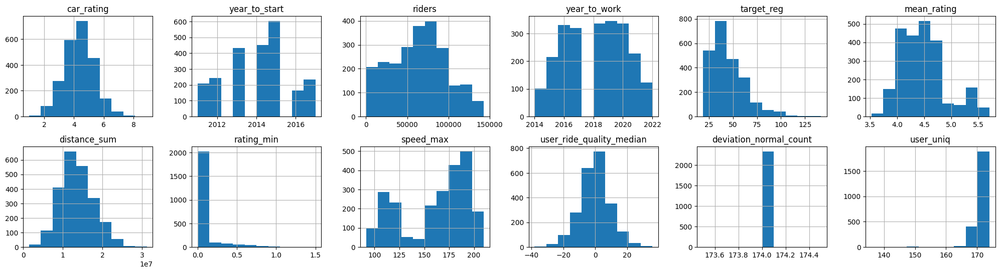

In [5]:
import numpy as np
import pandas as pd

path = "tmp_data/quickstart_train.csv"
train = pd.read_csv(path)

cat_features = ["model", "car_type", "fuel_type"]  # Выделяем категориальные признаки
targets = ["target_class", "target_reg"]
features2drop = ["car_id"]  # эти фичи будут удалены

# Отбираем итоговый набор признаков для использования моделью
filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]

print("cat_features", cat_features)
print("num_features", len(num_features))
print("targets", targets)

for c in cat_features:  # Избавлеямся от NaN'ов
    train[c] = train[c].astype(str)

print("train", train.shape)
train.hist(figsize=(25, 6), layout=(-1, 6))
train.sample(3)

## 2.1) <font color='pink'>Default CatBoost training</font>

In [7]:
from catboost import CatBoostClassifier, CatBoostRegressor, Pool

# Какие параметры есть в Catboost? посмотрим через shift + Tab
CatBoostClassifier()

In [8]:
from sklearn.model_selection import train_test_split

X = train[filtered_features].drop(targets, axis=1, errors="ignore")
y = train["target_class"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


clf = CatBoostClassifier(thread_count=-1,
                         random_seed=42,
                         cat_features=cat_features)

clf.fit(
    X_train,
    y_train,
    eval_set=(X_test, y_test),
    verbose=200,
    use_best_model=True,
    plot=False,
    early_stopping_rounds=100,
)

Learning rate set to 0.109335
0:	learn: 1.8108068	test: 1.8310378	best: 1.8310378 (0)	total: 194ms	remaining: 3m 14s
200:	learn: 0.2789378	test: 0.5441162	best: 0.5374049 (156)	total: 12.2s	remaining: 48.7s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.5374048663
bestIteration = 156

Shrink model to first 157 iterations.


In [9]:
clf.get_feature_importance(prettified=True)

,Feature Id,Importances
0,speed_max,35.499
1,mean_rating,34.897
2,rating_min,13.734
3,model,3.724
4,user_uniq,3.200
5,car_type,2.694
6,user_ride_quality_median,1.519
7,car_rating,1.249
8,distance_sum,1.213
9,riders,1.095


## 2.2) <font color='pink'>CatBoost training for KFold CV</font>
- final score --- 'mean' - 'std.scores'

In [10]:
from sklearn.model_selection import KFold

n_splits = 3  # Число фолдов. Оптимально 3, 5 или 10
clfs = [] # Тут будем сохранять модели
scores = [] # Тут будем хранить скоры валидационных фолдов

# параметры валидации, обучение будет идти на n_splits фолдах
X = train[filtered_features].drop(targets, axis=1, errors="ignore")
y = train["target_class"]

kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for train_index, test_index in kf.split(X):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Специальный класс для ускорения обучения 
    train_dataset = Pool(data=X_train, label=y_train, cat_features=cat_features)
    eval_dataset = Pool(data=X_test, label=y_test, cat_features=cat_features)

    clf = CatBoostClassifier(
        depth=4,
        iterations=3500,
        learning_rate=0.06,
        loss_function="MultiClass",  # MultiLogloss
        # eval_metric = 'Precision',  F1:macro / AUC:hints=skip_train~false
        custom_metric=["Recall"],  # 'AUC / Accuracy,
        
        # Главная фишка катбуста - работа с категориальными признаками
        cat_features=cat_features,
        # ignored_features = ignored_features,
        
        # Регуляризация и ускорение
        colsample_bylevel=0.098,
        subsample=0.95,
        l2_leaf_reg=9,
        min_data_in_leaf=243,
        max_bin=187,
        random_strength=1,
        
        # Параметры скорения
        task_type="CPU",    
        thread_count=-1,
        bootstrap_type="Bernoulli", 
        
        # Важное!
        random_seed=7575,
        auto_class_weights="SqrtBalanced",
        early_stopping_rounds=50)

    clfs.append(clf)

    clf.fit(
        train_dataset,
        eval_set=eval_dataset,
        verbose=500,
        use_best_model=True,
        plot=False)

    scores.append(np.mean([v for k, v in clf.best_score_["validation"].items() if "Recall" in k], dtype="float16"))
    # scores.append(clf.best_score_['validation']['MultiClass'])
    # clf.save_model("../tmp_data/cool_catboost_model_{}_deep".format(n))

assert len(clfs) == n_splits
print("mean Recall score --------->", np.mean(scores, dtype="float16") - np.std(scores, dtype="float16"))

0:	learn: 2.1956073	test: 2.1958090	best: 2.1958090 (0)	total: 3.98ms	remaining: 13.9s
500:	learn: 0.4702692	test: 0.5569354	best: 0.5569354 (500)	total: 2.73s	remaining: 16.3s
Stopped by overfitting detector  (50 iterations wait)

bestTest = 0.5096496804
bestIteration = 916

Shrink model to first 917 iterations.
0:	learn: 2.1951404	test: 2.1964014	best: 2.1964014 (0)	total: 2.64ms	remaining: 9.25s
500:	learn: 0.4909194	test: 0.5563577	best: 0.5562080 (497)	total: 3.04s	remaining: 18.2s
1000:	learn: 0.3967000	test: 0.5050570	best: 0.5050184 (997)	total: 6s	remaining: 15s
Stopped by overfitting detector  (50 iterations wait)

bestTest = 0.4961039188
bestIteration = 1241

Shrink model to first 1242 iterations.
0:	learn: 2.1956876	test: 2.1960187	best: 2.1960187 (0)	total: 2.49ms	remaining: 8.71s
500:	learn: 0.4706323	test: 0.5434797	best: 0.5434797 (500)	total: 2.47s	remaining: 14.8s
1000:	learn: 0.3921691	test: 0.5102073	best: 0.5102073 (1000)	total: 5.16s	remaining: 12.9s
Stopped by ov

In [11]:
clf.best_score_['validation']

{'Recall:use_weights=false;class=0': 0.9354838709677419,
 'MultiClass': 0.510199430621124,
 'Recall:use_weights=false;class=1': 1.0,
 'Recall:use_weights=true;class=5': 0.5102040816326531,
 'Recall:use_weights=true;class=2': 1.0,
 'Recall:use_weights=true;class=7': 1.0,
 'Recall:use_weights=false;class=2': 1.0,
 'Recall:use_weights=false;class=3': 0.8918918918918919,
 'Recall:use_weights=true;class=8': 0.7413793103448276,
 'Recall:use_weights=true;class=1': 1.0,
 'Recall:use_weights=false;class=5': 0.5102040816326531,
 'Recall:use_weights=true;class=4': 0.7078651685393258,
 'Recall:use_weights=true;class=3': 0.8918918918918919,
 'Recall:use_weights=false;class=6': 0.7916666666666666,
 'Recall:use_weights=false;class=8': 0.7413793103448276,
 'Recall:use_weights=false;class=7': 1.0,
 'Recall:use_weights=true;class=0': 0.9354838709677419,
 'Recall:use_weights=true;class=6': 0.7916666666666666,
 'Recall:use_weights=false;class=4': 0.7078651685393258}

## 3) <font color='pink'>Analysis of model failing + **Inference FOR KFold** (submit) + Save/Load model</font>
- saving available in next formats --- .cbm | .json | .cpp | .onnx
- inference for Kfold
    - y.shape - size*n_classes
    - for each fold --- y_pred += clf.predict_proba(sub[filtered_features])  ---  predicting probability
    - choosing according to 'maximum' probability (for all models uniformly)

In [12]:
import shap

shap.initjs()

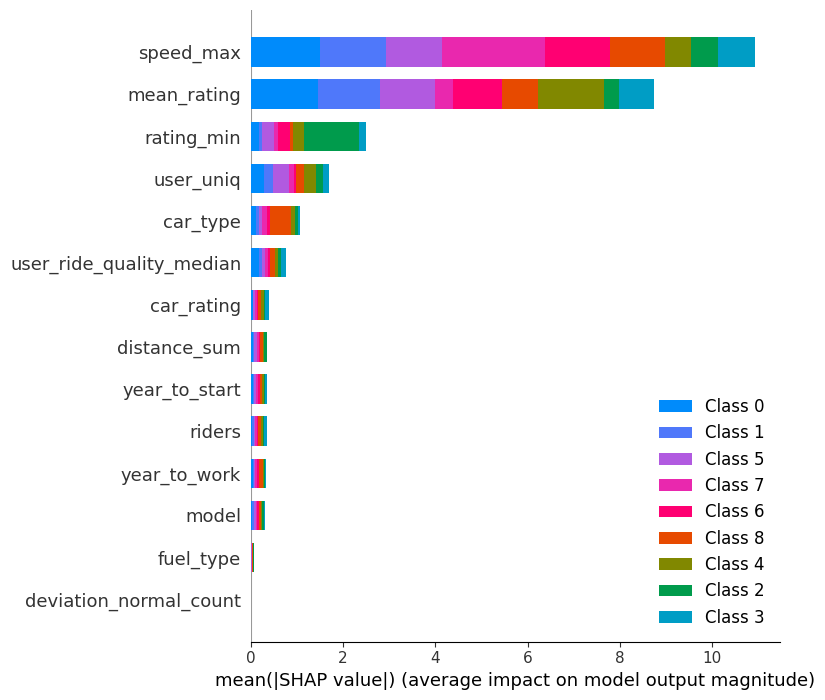

In [13]:
explainer = shap.TreeExplainer(clfs[-1])

train_dataset = Pool(data=X_train, label=y_train, cat_features=cat_features)
shap_values = explainer.shap_values(train_dataset)

shap.summary_plot(shap_values, X_train, max_display=25)

In [14]:
path = "tmp_data/quickstart_test.csv"
sub = pd.read_csv(path)

# массив для записи финального прогноза size*n_class
y_pred = np.zeros((sub.shape[0], train[targets].nunique()[0]))

# Пробегаемся по моделям каждого фолда и дергаем прогноз 
for n, clf in enumerate(clfs):
    y_pred += clf.predict_proba(sub[filtered_features])

f = lambda x: clf.classes_[x]
sub["target_class"] = list(map(f, y_pred.argmax(axis=1)))

#sub[["car_id", "target_class"]].to_csv("subs/catboost_kfold.csv", index=False)
sub[["car_id", "target_class"]].head()

,car_id,target_class
0,P17494612l,engine_overheat
1,N-1530212S,electro_bug
2,B-1154399t,break_bug
3,F12725233R,gear_stick
4,l-1139189J,electro_bug


In [ ]:
model.save_model("others/catboost_model.cbm", format="cbm")  # format по умолчанию cbm поэтому можно явно не указывать

In [ ]:
new_clf = CatBoostClassifier()
new_clf.load_model("../others/catboost_model.cbm")

In [ ]:
print(new_clf.get_params())

## 4) <font color='pink'>Object importance (selection)</font>
- deleting noisy samples, outliers, garbage that affects 'eval_metric'
- available loss-functions --- Logloss | CrossEntropy | RMSE | MAE | Quantile | Expectile | LogLinQuantile | MAPE | Poisson

In [15]:
X = train[filtered_features].drop(targets, axis=1, errors="ignore")
y = train["target_reg"]
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

train_pool = Pool(X_train, y_train, cat_features=cat_features)
test_pool = Pool(X_test, y_test, cat_features=cat_features)

# Обучим модель регрессии
model = CatBoostRegressor(
    random_seed=42, thread_count=-1, cat_features=cat_features, eval_metric="RMSE"
)

model.fit(
    train_pool,
    eval_set=test_pool,
    verbose=100,
    use_best_model=True,
    plot=False,
    early_stopping_rounds=100,
)

Learning rate set to 0.056174
0:	learn: 16.9142516	test: 17.7840394	best: 17.7840394 (0)	total: 23.8ms	remaining: 23.8s
100:	learn: 10.4032771	test: 12.3737981	best: 12.3737981 (100)	total: 2.88s	remaining: 25.7s
200:	learn: 9.4082666	test: 12.4046577	best: 12.3423577 (156)	total: 5.45s	remaining: 21.7s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 12.34235765
bestIteration = 156

Shrink model to first 157 iterations.


In [17]:
# метод возвращает отсортированные списки индексов и скоров
idxs, scores = model.get_object_importance(
    test_pool, train_pool, importance_values_sign="Positive", thread_count=-1
)
len(idxs)


# get_object_importance(pool,
#                       train_pool,
#                       top_size=-1, # число возвращаемых наиболее важных объектов из трэйн датасета (-1 без ограничений)
#                       type='Average', # тип вычисления `Average` или `PerObject` - второй тип дольше
#                       importance_values_sign='All' # `Positive`, `Negative`, `All` - зависит от оптимизируемой метрики
#                       update_method='SinglePoint', # `SinglePoint` — быстрейший, `TopKLeaves`, `AllPoints` — Самый медленный и самый точный метод.
#                       )

1052

In [18]:
# Нашлось 1070 объектов которые увеличивают нашу RMSE, посмотрим на топ-20
scores[:20]

[0.7988602389335762,
 0.4312452649632443,
 0.3747616279289476,
 0.30561469560554244,
 0.2669957944465816,
 0.2586117740392406,
 0.25550364432141714,
 0.23805415093208285,
 0.2320930593621277,
 0.2268622167879874,
 0.2231505446545682,
 0.20941049391472855,
 0.20791960023552022,
 0.20598648871708952,
 0.20278489006048583,
 0.2009197865920802,
 0.20035292805427155,
 0.199567328530307,
 0.19951652997158223,
 0.19650197493426955]

In [19]:
# Попробуем отбросить топ-100 найденных, и посмотрим как изменится точность
train_pool = Pool(
    X_train.reset_index(drop=True).drop(idxs[:100]),
    y_train.reset_index(drop=True).drop(idxs[:100]),
    cat_features=cat_features,
)

model = CatBoostRegressor(
    random_seed=42, thread_count=-1, cat_features=cat_features, eval_metric="RMSE"
)

model.fit(
    train_pool,
    eval_set=test_pool,
    verbose=100,
    use_best_model=True,
    plot=False,
    early_stopping_rounds=100,
)

Learning rate set to 0.055692
0:	learn: 16.7874082	test: 17.7682728	best: 17.7682728 (0)	total: 21.5ms	remaining: 21.5s
100:	learn: 9.6475442	test: 11.8148867	best: 11.8097022 (97)	total: 2.45s	remaining: 21.8s
200:	learn: 8.6475558	test: 11.8106639	best: 11.7564127 (122)	total: 4.98s	remaining: 19.8s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 11.75641269
bestIteration = 122

Shrink model to first 123 iterations.


## 5) <font color='pink'>Hyperparameter optimization --- (grid search / randomized search)</font>

In [20]:
from scipy import stats

model = CatBoostRegressor(
    random_seed=42,
    thread_count=-1,
    cat_features=cat_features,
    eval_metric="RMSE",
    verbose=500,
)

param_distribution = {
    "one_hot_max_size": stats.bernoulli(p=0.2, loc=2),
    "learning_rate": [0.03, 0.1, 0.3],
    "l2_leaf_reg": [2, 5, 7],
    "depth": stats.binom(n=10, p=0.2),
}
randomized_search_result = model.randomized_search(param_distribution, X_train, y_train)
model.best_score_

0:	learn: 47.0256669	test: 45.8049724	best: 45.8049724 (0)	total: 5.03ms	remaining: 5.03s
500:	learn: 11.1902016	test: 10.9321417	best: 10.9302206 (495)	total: 4.19s	remaining: 4.17s
999:	learn: 10.6722863	test: 10.7247680	best: 10.7227158 (977)	total: 8.88s	remaining: 0us

bestTest = 10.72271576
bestIteration = 977

0:	loss: 10.7227158	best: 10.7227158 (0)	total: 8.95s	remaining: 1m 20s
0:	learn: 47.0256669	test: 45.8049724	best: 45.8049724 (0)	total: 5.69ms	remaining: 5.69s
500:	learn: 11.1902016	test: 10.9321417	best: 10.9302206 (495)	total: 4.01s	remaining: 4s
999:	learn: 10.6722863	test: 10.7247680	best: 10.7227158 (977)	total: 8.02s	remaining: 0us

bestTest = 10.72271576
bestIteration = 977

1:	loss: 10.7227158	best: 10.7227158 (0)	total: 17s	remaining: 1m 8s
0:	learn: 44.1424134	test: 42.9194837	best: 42.9194837 (0)	total: 9.01ms	remaining: 9s
500:	learn: 8.9860161	test: 10.6982554	best: 10.6831364 (480)	total: 6.35s	remaining: 6.32s
999:	learn: 7.5645128	test: 10.8053853	best: 

{'learn': {'RMSE': 8.143172287745278}}

In [21]:
# Лучшие параметры модели из перебора
randomized_search_result["params"]

{'l2_leaf_reg': 5, 'depth': 3.0, 'one_hot_max_size': 3.0, 'learning_rate': 0.1}

___
# <font color='pink'>☁️ 4.2 **LightGMB**</font>
- [official documentation on LightGBM](https://lightgbm.readthedocs.io/en/latest/Parameters.html)
- [best solutions using LightGBM](https://gist.github.com/GhibliField/d544464bc81f1d0f002bea243d80c51e)
- [detailed explanation on LightGBM (RU)](https://pythonru.com/biblioteki/lightgbm)

1) LGBM (Light Gradient Boosted Machine) -- from Microsoft 2017
    - 2 main ideas - GOSS  &  EFB
        - GOSS (gradient one-sided sampling) --- exclude most samples with low gradients, use the rest for info gain ~~~ gaining accuracy with less info
        - EFB (exclusive feature bundling) --- combining sparse (mostly null) mutually exclusive features (like categorical) encoded using One-hot encoding ~~~ like auto feature-selection
2) builds **ASYMMETRICAL** trees ~ unlike CatBoost & XGBoost
3) **works for problems** --- Regression | Binary Classification | Multi Classification
4) has --- data wrapper | scheduler | callbacks | custom metrics | boosting type | regularization | dart
    - not auto handles categorical features & NA's

## <font color='pink'>Explaining everything (+ parameters)</font>
- wrapping data
    - careful with categorical
- class of training
- additions
    - regularization
    - boosting type
    - custom metrics
    - early stopping
    - scheduler
- visual
    - importance
    - histograms

__ - __ - __

- <font color='orange'>data wrapping & training</font>
    - like CatBoost (Pool) has it's own wrapper - **Dataset**
        - effective 'memory usage' (stores only discrete bins, not exact values)
        - bins can be regulated --- via 'max_bin' or 'max_bin_by_feature'
    - **can be used without 'OneHotEncoding'** --- it will handle itself (8 times faster)
        - BUT REQUIRES to transform categorical features to 'int'
    - **label also bounded** (by 'int', 'float' or 'bool' types)
    - **parameters**
        - feature_name --- list of raws of dataset names
        - reference --- (default - None) if Dataset is for validation ---> training Dataset should be marked as reference
        - group --- used for 'ranking problem'
        - weight --- weights can be set for each examples (0-1) (or later by using set_weight())
        - params --- dictionary of parameters (here can set 'max_bin' or 'max_bin_by_feature')
        - free_raw_data --- free memory from 'raw_data' after creating 'Dataset' (True/False)
            - save memory - free_raw_data=True when constructing the Dataset || set raw_data=None after Dataset has been constructed || Call gc()


        
__ - __ - __

- <font color='orange'>training</font>
    - 2 ways --- by 'train()' from class Booster || by 'LGBMModel' using 'fit()' and 'predict()'
    
- <font color='orange'>saving</font>
    - 2 ways --- save as 'model-like' file model or 'text-like' file model

__ - __ - __

- <font color='orange'>base important parameters of LGBM</font>
    - boosting_type
        - gbdt - gradient boosting with decision trees (by default)
        - dart - dropout using MART 
        - goss - gradient one-sided sampling
        - rf - RandomForest
    - objective --- to initialize objective function for problem (default = regression)
        - [16 functions total](https://lightgbm.readthedocs.io/en/latest/Parameters.html#objective)
    - matrics --- metric for estimation of training
        - can use multiple metrics (all will be calculated)
        - most used - rmse, l1, l2, binary_logloss, multi_logloss, auc, cross_entropy
        - [all available matrics](https://lightgbm.readthedocs.io/en/latest/Parameters.html#metric)

__ - __ - __

- <font color='orange'>additional parameters</font>
    - base
        - num_iterations --- (num_boost_round) number of trees in ensemble (default - 100)
        - learning_rate --- (default - 0.1)
        - num_leaves --- maximum leaves for each tree (default - 31)
    - trees regularization
        - max_depth --- maximum depth available in ensemble for trees (default - (-1) - infinite depth)
        - min_data_in_leaf --- minimum number of samples that can be stored in 1 leaf of tree (used to control overfitting, default - 20)
        - bagging_fraction --- in (0;1), control 'proportion' of random data used for training (used to prevent overfitting)
        - feature_fraction --- in (0;1), 'proportion' of features on each iteration chosen (default - 1.0)
        - extra_trees --- (bool), use extremely-randomized trees or no
    - else
        - force_col_wise --- (bool), build by force histograms during training using columns (features)
            - if too much rows in data ---> not using will increase speed
        - force_row_wise --- (bool), build by force histograms during training using rows
            - if too much rows in data ---> not using will increase speed
        - early_stopping_round --- (int), stop if metric doesn't change after this amount of iterations
        - num_class --- for 'multi-classification' problems (number of classes)
        - is_unbalance --- (bool), use this if classes are not balanced

__ - __ - __

- <font color='orange'>hyperparameters tuning</font>
    - for model accuracy 📈🎯
        - increase
            - max_bin (slows training)
            - num_leaves (can overfit)
            - num_iterations
        - decrease
            - learning_rate
        - use
            - dart
    - for model generalization 🚀🚢
        - increase
            - learning_rate
        - decrease
            - max_bin
            - num_leaves
            - num_iterations
        - use
            - bagging technique (setting parameters - bagging_fraction, bagging_freq)
            - features subsampling (setting parameters - feature_fraction)
            - regularization (setting parameters - lambda_l1, lambda_l2, min_gain_to_split, extra_trees)
            - parameter 'max_depth'
                - because LGBM builds assymetrical trees, by default it's unrestricted infinite depth (value -1)
                - to remember all data (especially on small datasets) recommended to make tree FINITE by defining next parameters
                    - num_leaves || min_data_in_leaf || min_sum_hessian_in_leaf || min_data_in_bin || min_gain_to_split
                - 'max_depth' parameter only when
                    - small datasets (prevent overfitting)
                    - big datasets (speed-up training)
            - parameter 'min_data_in_leaf'
            - parameter 'min_sum_hessian_in_leaf'
            

__ - __ - __

- <font color='orange'>early stopping</font>
    - at least 1 'valid_sets' should be defined
    - 2 ways of defining early stop:
        - define 'early_stopping_round' --- stop using number of iterations after which score on validation didn't change
        - using 'callbacks'
            - lgb.train(..., callbacks=[lgb.early_stopping(stopping_rounds=5)])
        - callback also support several metrics definition (if 1 should go down, and other should go up)
        
__ - __ - __

- <font color='orange'>else</font>
    - scheduler --- (for learning_rate scheduling during training)
        - realized via 'callback' using function 'reset_parameter()' --- (resets learning_rate after each iteration)
            - booster.fit(..., callbacks=[lgb.reset_parameter(learning_rate=np.linspace(0.1,1,10).tolist())])
    - visuals + feature importance
        - booster.feature_importance(importance_type=) --- ('gain' / 'split' (of trees))
        - lgb.plot_importance(booster, figsize=(8,6), importance_type=) --- ('gain' / 'split' (of trees));
            - built-in visual
            - parameter 'max_num_features' (amount of features to show)
        - lgb.plot_split_value_histogram(booster, feature="speed_max", figsize=(8, 6));
    - custom loss & eval functions
        - loss function (objective)
        - estimation function (feval)

## 1) <font color='pink'>Loading Data + short Eda + define categorical</font>

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
583,H-3434345i,Kia Sportage,standart,petrol,4.880,2015,78186,2017,28.830,gear_stick,4.322,9724035.965,0.100,107.121,-9.439,174,170
1444,e11547536L,Kia Rio X-line,economy,petrol,3.800,2015,93813,2021,29.120,gear_stick,4.464,16721804.906,0.100,110.901,-2.974,174,171
950,S-1099304I,Renault Sandero,standart,petrol,4.880,2014,56905,2019,51.890,engine_ignition,4.107,8331401.016,0.100,166.271,11.517,174,171


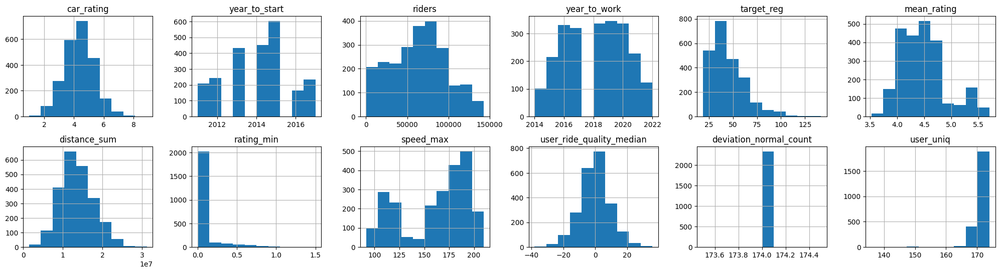

In [2]:
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score

df = pd.read_csv("tmp_data/quickstart_train.csv")

cat_cols = ["car_type", "fuel_type", "model"]
drop_cols = ["car_id", "target_reg", "target_class"]

X = df.drop(drop_cols, axis=1)
y = df["target_class"]

df.hist(figsize=(25, 6), layout=(-1, 6))
df.sample(3)

## 2) <font color='pink'>Default LightGBM training</font>
- **weakness** - transform 'categorical' to 'int'
    - 'target' as well (from text (string) to int)
- uses it's own **data wrapper** --- 'Dataset'
- **2 ways of training**
    - via 'train()' - from 'Booster' class
    - via 'LGBMModel' class - with methods like 'fit()', 'predict()'
        - LGBMModel = LGBMClassifier / LGBMRegressor / LGBMRanker 
        - support usage in sklearn pipelines

In [4]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

le = LabelEncoder()
for col in cat_cols:
    X[col] = le.fit_transform(X[col])

# таргет так же придется перевести из строкового типа в целочисленный
le_tar = LabelEncoder()
y = le_tar.fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,)

In [5]:
import lightgbm as lgb
from lightgbm import Dataset

train_data = Dataset(
    X_train,
    y_train,
    categorical_feature=cat_cols,
    free_raw_data=False,
)

# Еще валидационный датасет для настройки ранней остановки
val_data = Dataset(
    X_test,
    y_test,
    categorical_feature=cat_cols,
    free_raw_data=False,
)

### Training via 'train()' (from class Booster)
- params
- train --- params, train_set, valid_set, cat_feat, length
- booster.predict(test) --- need to use np.argmax() after

In [7]:
from lightgbm import train

params = {
    "objective": "multiclass",
    "num_class": 9,
    "verbosity": -1,
}

booster = train(
    params,
    train_set=train_data, # Принимает данные, как класс Dataset 
    valid_sets=(val_data),
    categorical_feature=cat_cols, 
    num_boost_round=10,
)

test_preds = np.argmax(booster.predict(X_test), axis=1)
print("\nTest Accuracy: %.2f" % accuracy_score(y_test, test_preds))

[1]	valid_0's multi_logloss: 1.68905
[2]	valid_0's multi_logloss: 1.43158
[3]	valid_0's multi_logloss: 1.24981
[4]	valid_0's multi_logloss: 1.12568
[5]	valid_0's multi_logloss: 1.02312
[6]	valid_0's multi_logloss: 0.940656
[7]	valid_0's multi_logloss: 0.87623
[8]	valid_0's multi_logloss: 0.822769
[9]	valid_0's multi_logloss: 0.779806
[10]	valid_0's multi_logloss: 0.740605

Test Accuracy: 0.78


C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


### Training via 'class LGBMModel'
- LGBMClassifier / LGBMRegressor / LGBMRanker 
- fit() --- train, y, eval_set
- clf.predict(test) --- with np.argmax() built-in

In [11]:
from lightgbm import LGBMClassifier

# Заметим, что метод fit() не принимает объект класса Dataset
# поэтому передадим номера категориальных столбцов в параметр cat_feature
clf = LGBMClassifier(
    objective="multiclass",
    n_estimators=10,
    num_class=9,
    seed=42,
    cat_feature=[0, 1, 2], # Нельзя передать список названий столбцов
)

clf.fit(
    X_train,
    y_train,
    eval_set=[
        (X_test, y_test),
    ],
)


[1]	valid_0's multi_logloss: 1.68905
[2]	valid_0's multi_logloss: 1.43158
[3]	valid_0's multi_logloss: 1.24981
[4]	valid_0's multi_logloss: 1.12568
[5]	valid_0's multi_logloss: 1.02312
[6]	valid_0's multi_logloss: 0.940656
[7]	valid_0's multi_logloss: 0.87623
[8]	valid_0's multi_logloss: 0.822769
[9]	valid_0's multi_logloss: 0.779806
[10]	valid_0's multi_logloss: 0.740605


LGBMClassifier(cat_feature=[0, 1, 2], n_estimators=10, num_class=9,
               objective='multiclass', seed=42)

In [12]:
# В данном случае метод predict() возвращает сразу метку класса, поэтому np.argmax() не нужен\
test_preds = clf.predict(X_test)
print("\nTest Accuracy: %.2f" % accuracy_score(y_test, test_preds))


Test Accuracy: 0.78


## 3) <font color='pink'>Save/Load model</font>
- has it's own type of files '.mod'
- model/text like model saving

- save_model(name) --- has it's own type '.mod'
- model_to_string() --- text-like model representation (to save in file afterwards)
- lightgbm.Booster() --- class that helps creating 'booster' example for loading model
    - model_file - load model from 'model-like-file'
    - model_str - load model from 'text-like-file'

In [13]:
# получаем экземпляр класса Booster
booster = clf.booster_
booster.save_model("lgb.mod")

In [14]:
# Отметим, что после загрузки модель будет экземпляром класса Booster и соответственно метод predict() опять выдает вероятности
# Поэтому используем argmax()
loaded_booster = lgb.Booster(model_file="lgb.mod")
test_preds = np.argmax(loaded_booster.predict(X_test), axis=1)
print("Test Accuracy: %.2f" % accuracy_score(y_test, test_preds))

Test Accuracy: 0.78


## 4) <font color='pink'>Else</font>
- different boosting_types
- early-stopping
- sklearn metric & custom metrics

In [15]:
# BOOSTING TYPES

# посмотрим как меняется точность в зависимости от типа бустинга
boostings = ["gbdt", "dart", "goss"]

for name in boostings:
    clf = LGBMClassifier(
        objective="multiclass",
        n_estimators=10,
        learning_rate=0.1,
        num_class=9,
        reg_alpha=0.5,
        reg_lambda=0.3,
        seed=42,
        cat_feature=[0, 1, 2],
        boosting_type=name,
    )
    clf.fit(
        X_train,
        y_train,
        eval_set=[(X_test, y_test)],
        verbose=False,
    )
    test_preds = clf.predict(X_test)
    print("{} accuracy: {:.2f}".format(name, accuracy_score(y_test, test_preds)))

gbdt accuracy: 0.79
dart accuracy: 0.79
goss accuracy: 0.79


C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "
C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "
C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument i

In [16]:
# EARLY STOPPING

# Опробуем на нашем примере
clf = lgb.LGBMClassifier(
    objective="multiclass",
    n_estimators=100,
    learning_rate=0.1,
    num_class=9,
    seed=42,
    cat_feature=[0, 1, 2],
)

clf.fit(
    X_train,
    y_train,
    eval_set=[
        (X_test, y_test),
    ],
    early_stopping_rounds=5,
    verbose=10,
)

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\sklearn.py:726: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "


[10]	valid_0's multi_logloss: 0.740605
[20]	valid_0's multi_logloss: 0.584428
[30]	valid_0's multi_logloss: 0.581584


LGBMClassifier(cat_feature=[0, 1, 2], num_class=9, objective='multiclass',
               seed=42)

In [ ]:
# SKLEARN METRICS

from sklearn.metrics import mean_squared_error

booster = lgb.LGBMModel(objective=mean_squared_error, n_estimators=10,)
booster.fit(X_train, y_train,
            eval_set=[(X_test, y_test),], eval_metric="rmse",
            callbacks=[lgb.reset_parameter(learning_rate=np.linspace(0.1, 1, 10).tolist()),
                       lgb.early_stopping(stopping_rounds=5)])

In [21]:
# CUSTOM METRICS

# Рассмотрим в качестве примера реализацию кастомной метрики оценки
from sklearn.metrics import precision_score


def precision_score_(preds: np.ndarray, data, threshold: float = 0.5, num_classes: int = 9):
    """Calculate recall_score"""
    
    label = data.get_label()
    preds = preds.reshape(num_classes, -1).T
    pred_label = np.argmax(preds, axis=1)
    rs = precision_score(pred_label, label, average="macro", zero_division=0)
    
    return "precision_score_best", rs, True  # eval_name, eval_result, is_higher_better


booster = lgb.train(
    params,
    train_set=train_data,
    valid_sets=(val_data,),
    num_boost_round=10,
    feval=[precision_score_],
)

[1]	valid_0's multi_logloss: 1.68905	valid_0's precision_score_best: 0.762309
[2]	valid_0's multi_logloss: 1.43158	valid_0's precision_score_best: 0.776515
[3]	valid_0's multi_logloss: 1.24981	valid_0's precision_score_best: 0.779801
[4]	valid_0's multi_logloss: 1.12568	valid_0's precision_score_best: 0.777885
[5]	valid_0's multi_logloss: 1.02312	valid_0's precision_score_best: 0.79044
[6]	valid_0's multi_logloss: 0.940656	valid_0's precision_score_best: 0.784693
[7]	valid_0's multi_logloss: 0.87623	valid_0's precision_score_best: 0.783361
[8]	valid_0's multi_logloss: 0.822769	valid_0's precision_score_best: 0.782962
[9]	valid_0's multi_logloss: 0.779806	valid_0's precision_score_best: 0.78514
[10]	valid_0's multi_logloss: 0.740605	valid_0's precision_score_best: 0.785187


C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\lightgbm\basic.py:2065: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')


___
# <font color='pink'> 🦾🚀 4.3 **XGBoost**</font>
- [official documentation on XGBoost](https://xgboost.readthedocs.io/en/stable/)
- [L1, L2 regularization using XGBoost](https://albertum.medium.com/l1-l2-regularization-in-xgboost-regression-7b2db08a59e0)
- [everything-you-need-to-know-about-XGBoost](https://neptune.ai/blog/xgboost-everything-you-need-to-know)
    - Ensemble algorithms – explanation
        - Important characteristics of ensemble algorithms (bagging, boosting)
        - Well-known boosting algorithms (AdaBoost, Gradient Boosting)
    - What is XGBoost architecture?
    - Example XGBoost using Neptune

1. XGBoost (eXtreme Gradient Boosting)
2. builds **SYMMETRICAL** trees
3. **works for problems** --- Regression | Binary Classification | Multi Classification
4. has --- data wrapper | scheduler | callbacks | custom metrics | boosting_type | regularization | dart | Cross Validation |
    - handles categorical features at some point
    - handles NA's

## <font color='pink'>Explaining everything (+ parameters)¶</font>
- main features
- boosting realization features
- overfitting handling
- XGBoost parameters

__ - __ - __

<font color='orange'>Main features</font>
- regularization parameters (lambda / gamma / alpha)
- by experimenting classified as fastest among other boosting methods
- in-build categorical features and NA's nandling (using one-hot encoding)
- supports Dask & Spark
- supports Sklearn.metrics
- supported by Optuna, Weights & Biases, etc.

__ - __ - __


<font color='orange'>Boosting realization features</font>
- parallelization
    - XGBoost trees building based on parallelization
    - It might be due to the interchangeable nature of the loops used to build the base for learning: the outer loop enumerates the leaves of the trees, the inner loop computes the features
    - Finding a loop inside another prevents the algorithm from being parallelized, since the outer loop cannot start its execution if the inner one has not finished its work yet. 
    - To improve runtime, the order of the loops is changed: initialization takes place when data is read, then sorting is performed using parallel streams. 
    - This replacement improves the performance of the algorithm by distributing computations across threads
- cuts tree branches
    - in GBM framework the criteria for 'stopping tree split' depends on criteria on 'negative loss at split point'
    - XGBoost uses 'max_depth' instead of 'negative loss at split point' -- and starts reverse cut
    - this "depth" approach significantly improves computational performance
- regularization (L1, L2)
- works with NA's
    - fills NA's with respect to loss values
- Cross Validation
    - has it's own cross-validation method on each iteration

__ - __ - __

<font color='orange'>How to handle overfitting (hyperparameters tuning)</font>
- 1st way (model complexity control)
    - increase: min_child_weight || gamma || lambda
    - decrease: max_depth
- 2nd way (adding randomness to model - making it more robust to noise)
    - decrease: subsample || colsample_bytree || colsample_bylevel || colsample_bynode
    - use: DART

__ - __ - __

- **training parameters**
    - objective --- loss function
        - regression -- squaredlogerror || logistic || absoluteerror
        - binary classification -- logistic || logitraw
        - multi classification -- softmax
    - eval_metric --- estimation function (depends of objective)
        - regression -- rmse, mae, mape
        - classification -- logloss, mlogloss
        - auc, etc.
    - seed
- **booster**
    - gbtree - gradient boosting over the trees
    - dart - gradient boosting over the trees WITH dropping part of data
    - gblinear - gradient boosting with regularizations L1 and L2 (works only with DMatrix)
- **booster parameters**
    - eta (a.k.a. learning_rate) --- training step
    - max_depth --- max tree depth (more depth -- more complex model -- more likely overfit)
    - num_boosting_rounds (a.k.a. n_estimators) --- number of trees(iterations) of boosting
- **dart booster parameters** (for DART)
    - rate_drop --- (float), part of previous trees that would be dropped (during each dropout)
    - one_drop --- (int), how many trees will always be dropped (during each dropout)
    - skip_drop --- (float), probability that dropout won't happen during iteration (has higher priority than previous parameters)
    - NOTE: if none parameters been defined (all default) ---> booster will work in 'gbtree' type (not 'dart')
    - NOTE: predict() with DART 
        - if object of booster related to type DART ---> predict() will perform dropout (meaning only some part of trees will be used)
        - this will lead to wrong results if data isn't training set
        - TO GET PROPER RESULTS - set 'iteration_range' to NON-ZERO value 
            - preds = bst.predict(dtset, iteration_range=(0, num_round))
    - NOTE: there's also xgboost_dart_mode (bool) -- probably other DART realization
- **regularization parameters**
    - min_child_weight --- if split step of tree will result to a leaf node with sum of sample weights < min_child_weight ---> no more splitting process (the bigger value - the more conservative the model will be)
        - default - 1
    - subsample --- part of examples from training set that would be used for building a tree, updates each iteration (0.5 for half) (default - 1)
    - colsample_bytree, colsample_bylevel, colsample_bynode --- parameters for splitting part of features on certain level of tree building (default - 1)
    - max_bin --- maximum number of bins on which a numerical feature can be divided (more bins - more optimal binarization - more training time) (default - 256)
    - lambda & alpha (a.k.a. reg_lambda, reg_alpha) --- responsible for L2, L1 regularizations -- the bigger the value - the more conservative model becomes (less tend to overfit, but miss might miss actual info)
        - default - 1 and 0
        - recommended - between 0-1000 for both
    - gamma (a.k.a. min_split_loss) --- minimum loss change for branch split -- the bigger 'gamma' - the more conservative (less tend to overfit, but miss might miss actual info) the model would be  
        - default - 0
- **additional**
    - verbosity --- (bool), 0 silent, 1 warning, 2 info, 3 debug
    - verbose_eval --- (int), print message every N iterations
    - nthread --- maximum number of CPU threads used for training
    - use_rmm --- (bool), use RAPIDS (RMM) [memory dispatcher] for GPU memory allocation -- applied only when XGBoost compiled with RMM plug-in enabled
    - three_method --- (hist / gpu_hist) -- train on CPU or GPU
    - auto --- heuristic selection of the fastest method
    - exact --- exact greedy algorithm (iterates over all candidates for splitting) [FOR SMALL DATASETS]
    - approx --- approximate greedy algorithm (using quantilization and gradients histogram) [FOR BIG DATASETS]
    - hist --- faster histogram optimized [FOR BIG DATASETS WITH BETTER PERFORMANCE]
    
__ - __ - __

## 1) <font color='pink'>Loading Data + define categorical + split</font>

In [25]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings; warnings.filterwarnings("ignore")

train = pd.read_csv('tmp_data/quickstart_train.csv')

drop_cols = ['car_id', 'target_reg', 'target_class']
cat_cols = ['car_type', 'fuel_type', 'model']

X = train.drop(drop_cols, axis=1)
y = train['target_reg']

for col in cat_cols:
    X[col] = X[col].astype('category')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

train.head(3)

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
0,y13744087j,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,108.530,another_bug,4.738,12141310.405,0.100,180.856,0.023,174,170
1,O41613818T,VW Polo VI,economy,petrol,3.900,2015,78218,2021,35.200,electro_bug,4.481,18039092.838,0.000,187.863,12.306,174,174
2,d-2109686j,Renault Sandero,standart,petrol,6.300,2012,23340,2017,38.620,gear_stick,4.768,15883659.428,0.100,102.383,2.513,174,173


## 2) <font color='pink'>Default XGBoost training</font>
- about data wrapper ('DMatrix')
    - optimizing memory & training speed
    - supports multiple data sources
    - can works with NaN's 
- 2 ways of training
    - classic 'train()'
    - via Scikit-Learn API --- fit() | predict()
- supports --- dask-API || spark-API || random classes for training
    - dask.train()
    - spark.SparkXGBRegressor
    - xgboost.XGBRFRegressor

Data parameters
- data
- label
- nthread - number of parallel threads during data loading (-1 by default)
- missing - fill na with '' (default - np.mean())
- enable_categorical - automatically defines categorical features (if they were transformed to type 'categorical' for 'pandas.DataFrames')
- features from strings (text) are needed to be encoded (transformed to 'int') --- example Lable Encoding

In [27]:
import xgboost as xgb

dtrain = xgb.DMatrix(X_train, label=y_train, nthread=-1, enable_categorical=True)
dtest = xgb.DMatrix(X_test, y_test, nthread=-1, enable_categorical=True)

### 2.1) Training via 'train()' (from 'booster' class)
- parameters, datasetse, iterations, etc.

In [28]:
params = {
    'objective': 'reg:squarederror',
    'tree_method': 'hist',
    'seed': 42,
}
booster = xgb.train(params,
                    dtrain=dtrain,
                    num_boost_round=30,
                    evals=[(dtrain, 'dtrain'), (dtest, 'dtest')],
                    early_stopping_rounds=10,
                    verbose_eval=5)

[0]	dtrain-rmse:34.38713	dtest-rmse:35.74592
[5]	dtrain-rmse:11.11560	dtest-rmse:14.18464
[10]	dtrain-rmse:8.24409	dtest-rmse:12.60223
[15]	dtrain-rmse:7.28372	dtest-rmse:12.41785
[20]	dtrain-rmse:6.37022	dtest-rmse:12.46862
[25]	dtrain-rmse:5.58457	dtest-rmse:12.55488


In [29]:
from sklearn.metrics import mean_squared_error

y_pred = booster.predict(dtest, iteration_range=(0, booster.best_iteration + 1))
mean_squared_error(y_test, y_pred) ** 0.5

12.417853005461057

### 2.2) Training via 'Scikit-Learn' API
- easy if setting KFold validation yourself

In [30]:
reg = xgb.XGBRegressor(tree_method="hist",
                       enable_categorical=True,
                       use_rmm = True)

# fit() не принимает DMatrix
reg.fit(X_train, y_train)
y_pred = reg.predict(X_test)
print(mean_squared_error(y_test, y_pred) ** 0.5)

# В отличие от LightGBM, не нужно получать объект booster перед сохранением
reg.save_model("xgb_regressor.json")
reg.load_model("xgb_regressor.json")
y_pred = reg.predict(X_test)
print(mean_squared_error(y_test, y_pred) ** 0.5)

13.0554217830429
13.0554217830429


## 3) <font color='pink'>Save/Load Model</font>
- using '.json'

In [ ]:
booster.save_model('xgb_0001.json')

In [ ]:
bst = xgb.Booster({'nthread': 4})
bst.load_model('xgb_0001.json')
y_pred = bst.predict(dtest)
mean_squared_error(y_test, y_pred) ** 0.5

## 4) <font color='pink'>Feature Importance</font>

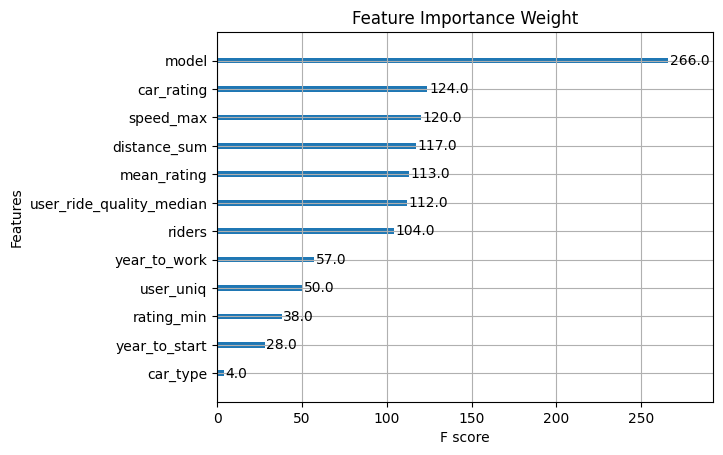

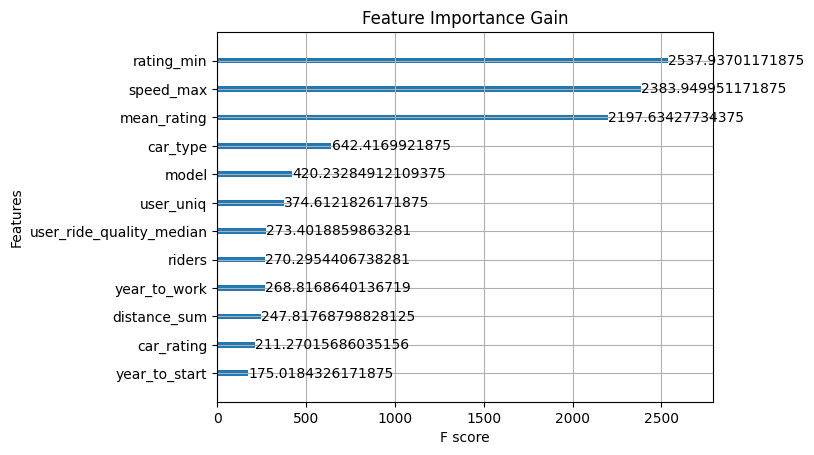

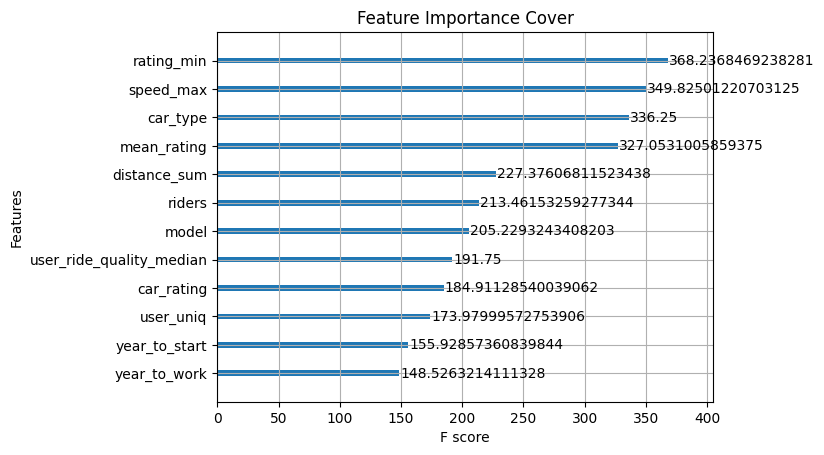

In [34]:
# ”weight” is the number of times a feature appears in a tree
# ”gain” is the average gain of splits which use the feature
# ”cover” is the average coverage of splits which use the feature where overage is defined as the number of samples affected by the split

#bst = reg

xgb.plot_importance(bst, title='Feature Importance Weight')
xgb.plot_importance(bst, importance_type='gain', title='Feature Importance Gain')
xgb.plot_importance(bst, importance_type='cover', title='Feature Importance Cover');

## 5) <font color='pink'>Scheduler + Custom Metric usage + Early stopping</font>
- [official XGBoost tutorial on early stopping](https://xgboost.readthedocs.io/en/stable/python/callbacks.html)

In [32]:
# Создадим список learning rates с помощью функции np.linspace
iters = 30
learning_rates = np.linspace(0.3, 0.005, iters).tolist() # значение lr будет плавно понижаться каждую итерацию с 0.3 до 0.005
scheduler = xgb.callback.LearningRateScheduler(learning_rates)

params = {
    'objective': 'reg:squarederror',
    'tree_method': 'hist',
    'seed': 42,
}
booster = xgb.train(params,
                    dtrain=dtrain,
                    num_boost_round=iters,
                    evals=[(dtrain, 'dtrain'), (dtest, 'dtest')],
                    callbacks=[scheduler], # <------ ✅
                    early_stopping_rounds=10,
                    verbose_eval=3)

y_pred = booster.predict(dtest, iteration_range=(0, booster.best_iteration + 1))
mean_squared_error(y_test, y_pred) ** 0.5

[0]	dtrain-rmse:34.38713	dtest-rmse:35.74592
[3]	dtrain-rmse:15.75722	dtest-rmse:18.06630
[6]	dtrain-rmse:10.71808	dtest-rmse:13.79218
[9]	dtrain-rmse:9.10225	dtest-rmse:12.83739
[12]	dtrain-rmse:8.42712	dtest-rmse:12.55768
[15]	dtrain-rmse:8.01877	dtest-rmse:12.45458
[18]	dtrain-rmse:7.62154	dtest-rmse:12.43499
[21]	dtrain-rmse:7.40307	dtest-rmse:12.39700
[24]	dtrain-rmse:7.29795	dtest-rmse:12.38756
[27]	dtrain-rmse:7.22009	dtest-rmse:12.38200
[29]	dtrain-rmse:7.20481	dtest-rmse:12.37749


12.37748955597222

In [31]:
from sklearn.metrics import mean_poisson_deviance

reg = xgb.XGBRegressor(tree_method="hist",
                       eval_metric = mean_poisson_deviance, # <------ ✅
                       enable_categorical=True,
                       n_estimators=30, n_jobs=-1
)
reg.fit(X_train, y_train, 
        eval_set=[(X_test, y_test)],
        early_stopping_rounds=10,
        verbose=3)

y_pred = reg.predict(X_test, iteration_range=(0, reg.best_iteration + 1))
mean_squared_error(y_test, y_pred) ** 0.5

[0]	validation_0-rmse:35.74592	validation_0-mean_poisson_deviance:49.82144
[3]	validation_0-rmse:17.69220	validation_0-mean_poisson_deviance:6.95339
[6]	validation_0-rmse:13.35841	validation_0-mean_poisson_deviance:3.56834
[9]	validation_0-rmse:12.61281	validation_0-mean_poisson_deviance:3.13483
[12]	validation_0-rmse:12.43601	validation_0-mean_poisson_deviance:3.02120
[15]	validation_0-rmse:12.41785	validation_0-mean_poisson_deviance:3.01677
[18]	validation_0-rmse:12.46093	validation_0-mean_poisson_deviance:3.04675
[21]	validation_0-rmse:12.51073	validation_0-mean_poisson_deviance:3.08155
[22]	validation_0-rmse:12.53115	validation_0-mean_poisson_deviance:3.08929


12.42917975280508

___
# <font color='pink'> 😨🚀 4.4 **Practice with boostings**</font>
- regression problem (get RMSE <= 12.0)
    - got with CatBoost after Object Selection (deleted top 150 - 11.9 final)
    - close with LightGBM and XGBoost (12.1 both)
    - main helping things:
        - learning rate || num iterations || regularization || sometimes tree structure (sampling 90% of samples, etc.)

- What Boosting to choose
    - start with CatBoost (fast, nice accuracy with default) ---> then look at other (XGBoost, LightGBM)

- Additional
    - in 'predict()' there is a parameter for 'number of trees used for prediction'
        - sometimes it is good to predict using lowest OR biggest number of trees relatively to best iteration (when not having 'validation set' or to prevent 'data leaks') 
        - in XGBoost it is 'iteration_range' parameter
    - it is useful to use 'iteration_range' to imitate 'early_stopping_rounds' for trained boostings in 'dart' mode (where early_stopping_rounds isn't exists)

## Practice
- train [CatBoost, XGBoost (dart), LightGBM (goss)] on 3-Folds
- choose best FOLD for each model
- calculate TEST with 'average' on models
- additions
    - less than 30 minutes
    - no new features
    - no GPU / Optuna usage
    - can use --- Feature Selection, Object Importance, hyperparameters editing, visuals, [callbacks, schedulers, custom metrics]

1. ~11.4 on valid == 12.0 test 
2. dropped some useless features --- deviation, year to work / year to start
3. **CatBoost big helps were from** [score on final --- 11.9]
    - num_iterations = 500 
        - helped A LOT (especially on test)
        - just by logic 350-500 were enough (then result didn't improve quite well ---> overfitting started)
    - learning_rate = 0.01
        - helped by 0.05-0.2
    - subsample = 0.95
        - helped by 0.05-0.2
    - l2_leaf_reg = 2
        - helped by 0.05-0.2


In [579]:
import numpy as np
import pandas as pd
import warnings; warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
import lightgbm as lgb
import catboost as ctb 

train = pd.read_csv('data/quickstart_train.csv')

cat_features = ['model', 'fuel_type', 'car_type']
features2drop = ['car_id', 'target_reg', 'target_class', 'deviation_normal_count', 'user_uniq', 'year_to_start', 'year_to_work']

X = train.drop(features2drop, axis=1)
y = train['target_reg']

for col in cat_features:
    X[col] = X[col].astype('category')

X.head(3)

,model,car_type,fuel_type,car_rating,riders,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median
0,Kia Rio X-line,economy,petrol,3.780,76163,4.738,12141310.405,0.100,180.856,0.023
1,VW Polo VI,economy,petrol,3.900,78218,4.481,18039092.838,0.000,187.863,12.306
2,Renault Sandero,standart,petrol,6.300,23340,4.768,15883659.428,0.100,102.383,2.513


### CatBoost ([parameters](https://catboost.ai/en/docs/references/training-parameters/))
- valid mean RMSE score ---------> 11.59
- valid mean RMSE score AFTER Object Importance ---------> 11.46
    - deleted 150 top 

In [392]:
metric = "RMSE"

n_splits = 3  # Число фолдов. Оптимально 3, 5 или 10
regs = [] # Тут будем сохранять модели
scores = [] # Тут будем хранить скоры валидационных фолдов

kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for train_index, test_index in kf.split(X):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Специальный класс для ускорения обучения 
    train_dataset = ctb.Pool(data=X_train, label=y_train, cat_features=cat_features)
    eval_dataset = ctb.Pool(data=X_test, label=y_test, cat_features=cat_features)

    reg = ctb.CatBoostRegressor(
        depth=5,
        iterations=500,
        learning_rate=0.01,
        loss_function=metric, 
        eval_metric =metric,
        #custom_metric=["Recall"], 
        
        # Главная фишка катбуста - работа с категориальными признаками
        cat_features=cat_features,
        # ignored_features = ignored_features,
        
        # Регуляризация и ускорение
        colsample_bylevel=0.6,
        subsample=0.95,
        l2_leaf_reg=2,
        min_data_in_leaf=100,
        #max_bin=50,
        #random_strength=1,
        
        # Параметры скорения
        task_type="CPU",    
        thread_count=-1,
        #bootstrap_type="Bernoulli", 
        
        # Важное!
        random_seed=7575,
        #auto_class_weights="SqrtBalanced",
        early_stopping_rounds=60)

    reg.fit(train_dataset, eval_set=eval_dataset, verbose=500, use_best_model=True, plot=False)

    regs.append(reg)
    
    scores.append(np.mean([v for k, v in reg.best_score_["validation"].items() if metric in k], dtype="float16"))

assert len(regs) == n_splits
print(f"mean {metric} score --------->", np.mean(scores, dtype="float16") - np.std(scores, dtype="float16"))
print("best RMSE score ---------> ", np.min(scores))
ctb_best = regs[np.argmin(scores)]

0:	learn: 17.3300854	test: 18.0434341	best: 18.0434341 (0)	total: 10.5ms	remaining: 5.24s
499:	learn: 10.9840734	test: 11.9590386	best: 11.9590386 (499)	total: 6.42s	remaining: 0us

bestTest = 11.95903863
bestIteration = 499

0:	learn: 17.5341096	test: 17.6968387	best: 17.6968387 (0)	total: 8.24ms	remaining: 4.11s
499:	learn: 11.0196278	test: 11.9459309	best: 11.9459309 (499)	total: 6.23s	remaining: 0us

bestTest = 11.94593091
bestIteration = 499

0:	learn: 17.8255642	test: 17.0275696	best: 17.0275696 (0)	total: 8.11ms	remaining: 4.05s
499:	learn: 11.1630309	test: 11.3397069	best: 11.3395645 (498)	total: 6.99s	remaining: 0us

bestTest = 11.33956448
bestIteration = 498

Shrink model to first 499 iterations.
mean RMSE score ---------> 11.46


In [603]:
idxs, scores = ctb_best.get_object_importance(
    eval_dataset, train_dataset, importance_values_sign="Positive", thread_count=-1
)
len(idxs)

856

In [609]:
metric = "RMSE"
DELETE_TOP_N = 170

n_splits = 3  # Число фолдов. Оптимально 3, 5 или 10
regs = [] # Тут будем сохранять модели
scores = [] # Тут будем хранить скоры валидационных фолдов

kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for train_index, test_index in kf.split(X):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Специальный класс для ускорения обучения 
    train_dataset = ctb.Pool(data=X_train.reset_index(drop=True).drop(idxs[:DELETE_TOP_N]), label=y_train.reset_index(drop=True).drop(idxs[:DELETE_TOP_N]), cat_features=cat_features)
    eval_dataset = ctb.Pool(data=X_test, label=y_test, cat_features=cat_features)

    reg = ctb.CatBoostRegressor(
        depth=5,
        iterations=500,
        learning_rate=0.01,
        loss_function=metric, 
        eval_metric =metric,
        #custom_metric=["Recall"], 
        
        # Главная фишка катбуста - работа с категориальными признаками
        cat_features=cat_features,
        # ignored_features = ignored_features,
        
        # Регуляризация и ускорение
        colsample_bylevel=0.6,
        subsample=0.95,
        l2_leaf_reg=2,
        min_data_in_leaf=100,
        #max_bin=50,
        #random_strength=1,
        
        # Параметры скорения
        task_type="CPU",    
        thread_count=-1,
        #bootstrap_type="Bernoulli", 
        
        # Важное!
        random_seed=7575,
        #auto_class_weights="SqrtBalanced",
        early_stopping_rounds=60)

    reg.fit(train_dataset, eval_set=eval_dataset, verbose=500, use_best_model=True, plot=False)

    regs.append(reg)
    
    scores.append(np.mean([v for k, v in reg.best_score_["validation"].items() if metric in k], dtype="float16"))

assert len(regs) == n_splits
print(f"mean {metric} score --------->", np.mean(scores, dtype="float16") - np.std(scores, dtype="float16"))
print("best RMSE score ---------> ", np.min(scores))
ctb_best = regs[np.argmin(scores)]

0:	learn: 17.2647409	test: 18.0723005	best: 18.0723005 (0)	total: 11.3ms	remaining: 5.65s
499:	learn: 11.0076348	test: 11.9597517	best: 11.9595042 (498)	total: 6.71s	remaining: 0us

bestTest = 11.95950423
bestIteration = 498

Shrink model to first 499 iterations.
0:	learn: 17.6492553	test: 17.6811120	best: 17.6811120 (0)	total: 7.33ms	remaining: 3.66s
499:	learn: 10.8228717	test: 11.8152734	best: 11.8152734 (499)	total: 6.4s	remaining: 0us

bestTest = 11.8152734
bestIteration = 499

0:	learn: 17.8393739	test: 17.0169548	best: 17.0169548 (0)	total: 7.71ms	remaining: 3.85s
499:	learn: 10.0129043	test: 11.1545338	best: 11.1545244 (488)	total: 7.04s	remaining: 0us

bestTest = 11.1545244
bestIteration = 488

Shrink model to first 489 iterations.
mean RMSE score ---------> 11.3
best RMSE score --------->  11.16


In [610]:
test = pd.read_csv('data/quickstart_test.csv')

cat_features = ['model', 'car_type', 'fuel_type']
features2drop_sub = features2drop.copy()
features2drop_sub.remove('target_reg')
        
X_sub = test.drop(features2drop_sub, axis=1)
for col in cat_features:
    X_sub[col] = X_sub[col].astype('category')
    
test['target_reg'] = ctb_best.predict(X_sub)#, ntree_end=350)  
test = test[['car_id', 'target_reg']]
result=test.to_csv("subs/ctb_try_sub.csv", index=False)

### LightGBM ([parameters](https://lightgbm.readthedocs.io/en/latest/Parameters.html))
- valid mean RMSE score ---------> 11.6
- don't forget to do encoding of categorical features AND label (if it's not numerical)

In [602]:
n_splits = 3  # Число фолдов. Оптимально 3, 5 или 10
regs = [] # Тут будем сохранять модели
scores = [] # Тут будем хранить скоры валидационных фолдов

kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for train_index, test_index in kf.split(X):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    for col in cat_features:
        le = LabelEncoder()
        X_train[col] = le.fit_transform(X_train[col])
        X_test[col] = le.transform(X_test[col])
    
    train_data = lgb.Dataset(X_train, y_train, categorical_feature=cat_features, free_raw_data=False,)
    val_data = lgb.Dataset(X_test, y_test, categorical_feature=cat_features, free_raw_data=False,)

    reg = lgb.LGBMRegressor(
        objective="root_mean_squared_error",
        
        boosting_type="goss",
        top_rate=0.3,
        #other_rate=0.2,
        
        n_estimators=500,
        learning_rate=0.02,
        
        num_leaves=35,
        #max_depth=15,
        #min_data_in_leaf=15,
        feature_fraction=0.8,
        #bagging_fraction=0.1,
        #colsample_bynode=0.90,
        
        reg_lambda=100,
        reg_alpha=30,
        
        seed=42,
        cat_feature=[0, 1, 2], # Нельзя передать список названий столбцов
        
        early_stopping_round=50,
        verbosity=-1,
    )

    reg.fit(X_train, y_train, eval_set=[(X_test, y_test),],)
    
    regs.append(reg)
    
    y_pred = reg.predict(X_test)
    scores.append(mean_squared_error(y_test, y_pred, squared=False))

assert len(regs) == n_splits
print("mean RMSE score ---------> ", np.mean(scores, dtype="float16") - np.std(scores, dtype="float16"))
print("best RMSE score ---------> ", np.min(scores))
lgb_best = regs[np.argmin(scores)]

[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[1]	valid_0's rmse: 18.0095
[2]	valid_0's rmse: 17.8962
[3]	valid_0's rmse: 17.8176
[4]	valid_0's rmse: 17.7636
[5]	valid_0's rmse: 17.6558
[6]	valid_0's rmse: 17.5493
[7]	valid_0's rmse: 17.4992
[8]	valid_0's rmse: 17.3963
[9]	valid_0's rmse: 17.2953
[10]	valid_0's rmse: 17.1975
[11]	valid_0's rmse: 17.1021
[12]	valid_0's rmse: 17.0088
[13]	valid_0's rmse: 16.9632
[14]	valid_0's rmse: 16.8726
[15]	valid_0's rmse: 16.7827
[16]	valid_0's rmse: 16.7663
[17]	valid_0's rmse: 16.6784
[18]	valid_0's rmse: 16.6149
[19]	valid_0's rmse: 16.5368
[20]	valid_0's rmse: 16.4606
[21]	valid_0's rmse: 16.3807
[22]	valid_0's rmse: 16.337
[23]	valid_0's rmse: 16.2788
[24]	valid_0's rmse: 16.2015
[25]	valid_0's rmse: 16.126
[26]	valid_0's rmse: 16.0524
[27]	valid_0's rmse: 15.9809
[28]	valid_0's rmse: 15.9157
[29]	valid_0's rmse: 15.8472
[30]	valid_0's rmse: 15.7964
[31]	valid_0's rm

In [575]:
test = pd.read_csv('data/quickstart_test.csv')

cat_features = ['model', 'car_type', 'fuel_type']
features2drop_sub = features2drop.copy()
features2drop_sub.remove('target_reg')
        
X_sub = test.drop(features2drop_sub, axis=1)
for col in cat_features:
    X_sub[col] = X_sub[col].astype('category')
    
le = LabelEncoder()
for col in cat_features:
    X_sub[col] = le.fit_transform(X_sub[col])

test['target_reg'] = lgb_best.predict(X_sub)
test = test[['car_id', 'target_reg']]
result=test.to_csv("subs/lgb_try_sub.csv", index=False)

### XGboost ([parameters](https://xgboost.readthedocs.io/en/stable/python/index.html))
- valid mean RMSE score ---------> 11.65
- don't forget to have 'valid set' (in eval set) to trigger early stopping

In [479]:
params = {
    # General 
    'objective': 'reg:squarederror',
    'eval_metric': 'rmse',
    
    # Booster
    'booster': 'dart',
    'rate_drop': 0.01,
    'one_drop': False,
    'sample_type': 'uniform',
    'normalize_type': 'forest',
    
    # Training 
    'random_state': 0,
    'seed': 42,
    'learning_rate': 3e-2,
    #'gamma': 0.5,
    
    # Tree architecture
    #'max_bin': 20,
    'subsample': 1,
    'max_depth': 5,
    #'max_delta_step': 0,
    #'min_child_weight': 1,
    #'colsample_bylevel': 1,
    #'colsample_bytree': 1,
    'sampling_method': 'uniform',
    
    # Regularization
    #'reg_alpha': 150,
    #'reg_lambda': 1,
    
    # Verbose
    #'silent': True,
}

def mae_eval(y_pred, dtrain):
    y_true = dtrain.get_label()
    return 'mae_eval', mean_absolute_error(y_true, y_pred)

iters = 500
learning_rates = np.linspace(0.3, 0.01, iters).tolist() # значение lr будет плавно понижаться каждую итерацию с 0.3 до 0.005
scheduler = xgb.callback.LearningRateScheduler(learning_rates)

#### K-Fold (3 splits)

In [481]:
from sklearn.model_selection import KFold

n_splits = 3  # Число фолдов. Оптимально 3, 5 или 10
regs = [] # Тут будем сохранять модели
scores = [] # Тут будем хранить скоры валидационных фолдов

kf = KFold(n_splits=n_splits, shuffle=True, random_state=7575)
for train_index, test_index in kf.split(X):

    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    dtrain = xgb.DMatrix(X_train, label=y_train, nthread=-1, enable_categorical=True)
    dtest = xgb.DMatrix(X_test, label=y_test, nthread=-1, enable_categorical=True)
    
    evals_set = [(dtrain, 'train'), (dtest, 'valid')]

    booster = xgb.train(params,
                        dtrain=dtrain,
                        num_boost_round=iters,
                        evals=evals_set,
                        #callbacks=[scheduler],
                        feval=mae_eval,
                        #maximize=False,
                        early_stopping_rounds=50,
                        verbose_eval=100)
    
    regs.append(booster)
    
    y_pred = booster.predict(dtest, iteration_range=(0, booster.best_iteration + 1))
    scores.append(mean_squared_error(y_test, y_pred, squared=False))

assert len(regs) == n_splits
print("mean RMSE score --------->", np.mean(scores, dtype="float16") - np.std(scores, dtype="float16"))
print("best RMSE score ---------> ", np.min(scores))
xgb_best = regs[np.argmin(scores)]

[0]	train-rmse:45.88311	train-mae_eval:42.56345	valid-rmse:47.71057	valid-mae_eval:44.27738
[100]	train-rmse:10.22770	train-mae_eval:7.59040	valid-rmse:12.37532	valid-mae_eval:8.98644
[200]	train-rmse:8.96769	train-mae_eval:6.73382	valid-rmse:11.97130	valid-mae_eval:8.81546
[209]	train-rmse:8.87955	train-mae_eval:6.66645	valid-rmse:11.97125	valid-mae_eval:8.82140
[0]	train-rmse:46.64537	train-mae_eval:43.31570	valid-rmse:46.17749	valid-mae_eval:42.74155
[100]	train-rmse:10.37124	train-mae_eval:7.66921	valid-rmse:12.11536	valid-mae_eval:8.78439
[174]	train-rmse:9.18128	train-mae_eval:6.86416	valid-rmse:11.92549	valid-mae_eval:8.77462
[0]	train-rmse:46.92333	train-mae_eval:43.49042	valid-rmse:45.57002	valid-mae_eval:42.36282
[100]	train-rmse:10.18538	train-mae_eval:7.51732	valid-rmse:11.63066	valid-mae_eval:8.86393
[174]	train-rmse:9.10925	train-mae_eval:6.82496	valid-rmse:11.49821	valid-mae_eval:8.86036
mean RMSE score ---------> 11.65
best RMSE score --------->  11.553980241060042


In [483]:
test = pd.read_csv('data/quickstart_test.csv')

cat_features = ['model', 'car_type', 'fuel_type']
features2drop_sub = features2drop.copy()
features2drop_sub.remove('target_reg')
        
X_sub = test.drop(features2drop_sub, axis=1)
for col in cat_features:
    X_sub[col] = X_sub[col].astype('category')
    
dtest_sub_xgb = xgb.DMatrix(X_sub, nthread=-1, enable_categorical=True)    

test['target_reg'] = xgb_best.predict(dtest_sub_xgb, iteration_range=(0, xgb_best.best_iteration + 1))
test = test[['car_id', 'target_reg']]
result=test.to_csv("subs/xgb_try_sub.csv", index=False)

#### Default training + Feature importance

In [199]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

dtrain = xgb.DMatrix(X_train, label=y_train, nthread=-1, enable_categorical=True)
dtest = xgb.DMatrix(X_test, label=y_test, nthread=-1, enable_categorical=True)

evals_set = [(dtrain, 'train'), (dtest, 'valid')]

booster = xgb.train(params,
                    dtrain=dtrain,
                    num_boost_round=iters,
                    evals=evals_set,
                    #callbacks=[scheduler],
                    feval=mae_eval,
                    #maximize=False,
                    early_stopping_rounds=100,
                    verbose_eval=100)

y_pred = booster.predict(dtest, iteration_range=(0, booster.best_iteration + 1))
print("RMSE -----> ", mean_squared_error(y_test, y_pred, squared=False))

[0]	train-rmse:46.29749	train-mae_eval:42.97595	valid-rmse:47.26975	valid-mae_eval:43.73497
[100]	train-rmse:10.41824	train-mae_eval:7.62379	valid-rmse:12.55292	valid-mae_eval:9.12928
[200]	train-rmse:9.19405	train-mae_eval:6.85844	valid-rmse:12.05853	valid-mae_eval:8.98885
[248]	train-rmse:8.85545	train-mae_eval:6.60401	valid-rmse:12.05067	valid-mae_eval:8.99858
RMSE ----->  12.326575050315736


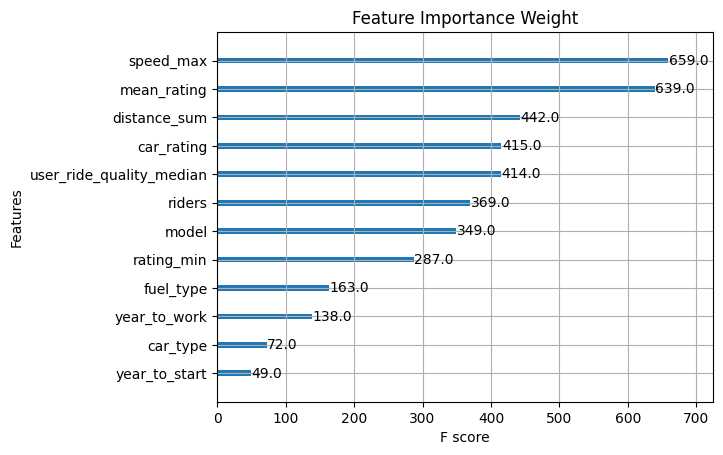

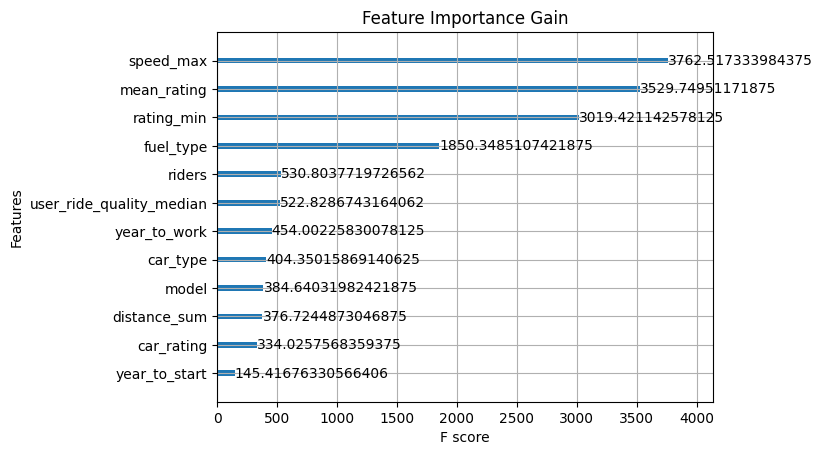

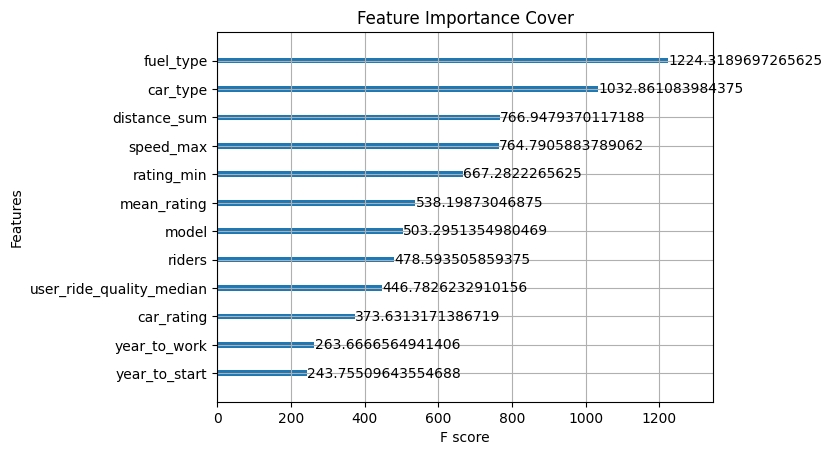

In [109]:
xgb.plot_importance(booster, title='Feature Importance Weight')
xgb.plot_importance(booster, importance_type='gain', title='Feature Importance Gain')
xgb.plot_importance(booster, importance_type='cover', title='Feature Importance Cover');

## Submission (1 best model out of each 3 algorithms)

In [311]:
test = pd.read_csv('data/quickstart_test.csv')

cat_features = ['model', 'car_type', 'fuel_type']
features2drop_sub = features2drop.copy()
features2drop_sub.remove('target_reg')
        
X_sub = test.drop(features2drop_sub, axis=1)
for col in cat_features:
    X_sub[col] = X_sub[col].astype('category')
    
#-----------
ctb_best_y_pred = ctb_best.predict(X_sub)    
#-----------
dtest_sub_xgb = xgb.DMatrix(X_sub, nthread=-1, enable_categorical=True)    
xgb_best_y_pred = xgb_best.predict(dtest_sub_xgb, iteration_range=(0, xgb_best.best_iteration + 1))
#-----------
le = LabelEncoder()
for col in cat_features:
    X_sub[col] = le.fit_transform(X_sub[col])
lgb_best_y_pred = lgb_best.predict(X_sub)

result = (ctb_best_y_pred + xgb_best_y_pred + lgb_best_y_pred) / 3
test['target_reg']=result
test = test[['car_id', 'target_reg']]
result=test.to_csv("subs/try_sub.csv", index=False)

## Basic understanding
- all about how parameters connected to trees and used
- all about algorithms (Decision Trees, Boosting, AdaBoost, XGBoost)

**Parameters**
- basic
    - iterations (number of trees)
    - max_depth (number of outcomes / splitting using features)
    - min_data_in_leaf (minimum samples in end node ---> node won't split if less than that)
    - max leaves (maximum leaves in tree after which tree stops building)
    - subsample (chose a part of examples instead of full training set that would be used for building a tree, updates each iteration (0.5 for half) (default - 1))
    - max_bin (maximum number of bins on which a numerical feature can be divided (more bins - more optimal binarization - more training time))
        - it's basically number of intervals on which the feature is split before provided to the condition (sub-sub sampling - grouping samples by characteristic is faster than 1 by 1)
        - then these 'bins' go through condition where they are given 'child node' (algorithm searches for split points (thresholds), finds the best one for 'objective' maximization)
        - the ACTUAL number of child nodes then decided according to feature nature (numerical / categorical) + hyperparameters of algorithm (max_depth, min_samples_split, max_leaves)
        - NOTE: if feature has more than 'max_bin' bins ---> it will merge neighbouring nodes 
        - NOTE: conditions are typically contain 1 feature, but can contain more than 1 (if for example feature_3 = feature_1 + feature_2)
- training
    - learning_rate 
    - loss function (to calculate errors in outcomes)
    - eval metric (to calculate final performance of model)
    - early stopping (to help better generalize model and prevent overfit)
- additional
    - regularization (simplifying model via coefficients adjustment -- good for generalization but careful with underfit)
    - custom metrics
___
[Youtube channel with super-easy explanations](https://www.youtube.com/@statquest)

**To understand boostings you need to know about Decision Trees (classification, regression)**
- idea --- split data into subsets based on input values (until criteria is met | prediction made)
- notations
    - nodes
        - root node --- the starting point 
        - decision nodes / internal nodes
            - represent subset of the data
            - store a condition on attribute (feature) -- here the decision is made
        - leaf nodes / end nodes
            - stores a result (label or value)
    - branch
        - a connection between nodes (represent the outcome of a test (condition) on a feature)

**What are boostings?**
- it's somewhat of collection of **'weak learners'** with weighted samples and models
    - strong learner is when error on test is low
    - weak learner is usually simple model that works well but with accuracy of 70-80%
    - weak learners are robust to overfitting, but usually underfit to data --- so it might take a while to train one into a 'strong learner'
- **Boosting**
    - you have number of weak learners (model / hypotheses), the output is based on majority of model votes (N models with weights ---> single output due to majority)
- **AdaBoost** (additive model)
    - based on using 'weak learners' (very short trees)
    - idea --- basically each new model will try to eliminate the errors of previous one 
    - algorithm --- you take a train set ---> create weak_learner_1 (by providing it data and training) ---> then add weights to samples (wrongly classified with higher weights, other with lower - for 2nd learner to focus more on wrong ones) ---> provide samples to weak_learner_2 with weights to samples ---> correct weights ---> provide ...
        - samples weights are based on what samples failed (for classification True/False, for regression it's loss)
            - **samples are weighted using exponent function** (big error ---> setting weight according to exponent)
        - model weights are defined based on the errors made by previous model (tree)
    - stop condition --- until failed to improve fit OR number of iterations reached
- **Gradient Boosting** (additive model)
    - idea -- same as AdaBoost BUT - **uses gradients** for everything 
        - for samples the weights are defined according to the gradient ---> the bigger weight, the bigger error, more focus on that sample
    - algorithm (regression) --- calculate average 'target' ---> then build a tree based on residuals (target_i - average) ---> for getting value we get formula: average + result_of_tree [in end node if multiple samples ---> average] ---> because it's too overfitted [low bias, but high variance] ---> we add learning_rate 'average + lr * result_of_tree' ---> if lr = 0.1 the result is 0.1 closer but still far ---> calculate residual using 'target_i - new_result' ---> continue again ---> now we get 'average + 0.1 * 1st_tree + 0.1 * 2nd_tree'
        - residuals calculated using Loss function (to see how well we performed)
        - the first step is 'average', but in general --- initialize constant value with argmin(loss function)
    - NOTE --- **easy to overfit when working with complex data** and complexity of model growths (resulting in millions or billions 'weak learners' in model)
    - stop condition --- until failed to improve fit OR number of iterations reached
- **XGBoost**
    - 1st --- instead of using 'tables of data' it transfers data to '.csc format' (compressed sparse column)
        - then data is divided into blocks (by samples) that can be run on several machines (for parallelization)
        - all columns are then being sorted by value (according to all rows with priority to columns)

___
# <font color='pink'> 🎰 5.1 **Auto-ML** (Feature Generation and Selection)</font>
- Tools:
    - Feature Tools --- (table data / SQL like data)
    - GeoPandas --- (coordinates)
    - Network X --- (graphs)
    - TSFresh --- (time frames)
- Advice:
    - **don't forget about hand-made features**
    - **apply accurately (save your time)** --- don't generate just everything you want
    - if you want to do fast --- get 10% of dataset and generate features --- then use feature selection to take most important ones

## 1. Feature Tools ([documentation](https://featuretools.alteryx.com/en/stable/index.html)) --- table/SQL data
- EntitySet
    1. **identify** the variable --- ft.EntitySet(id=...)
        - basically a wrapper-storage (stores dataframes)
    2. add **your datasets** --- es.add_dataframe(df_name, df, index, logical_types)
        - df_name is required further to generate features for particular dataframe (instead of whole entityset)
        - to define type of feature - we're using inbuilt 'woodwork.logical_types'
    3. add **relationships** --- es.add_relationship(df_1, mutual_id, df_2, mutual_id)
    4. **generate new features** --- ft.dfs(entity_set, target_dataframe_name, functions, depth)
        - **depth** --- bigger value - more information used to generate features - including combination of linked dataframes
        - you can define your own list of functions (instead of default)
        - use '**feature_matrix.info()**' to check the result
- Additional functions
    - ft.selection.remove_highly_null_features() --- removes features with lot of nulls
    - ft.selection.remove_single_value_features() --- removes constant features
    - ft.selection.remove_highly_correlated_features() --- removes highly correlated features
- **Advices**
    1. sometimes you want to start with 10-20% of dataset (to save time) ---> generate features on it ---> find important ---> apply to full dataset
        - application of generating features for particular ID's (rows)

In [6]:
# !pip install featuretools

import pandas as pd
import featuretools as ft

path = 'data/car_train.csv'
car_info = pd.read_csv(path) 

path = 'data/rides_info.csv'  
rides_info = pd.read_csv(path)

path = 'data/driver_info.csv' 
driver_info = pd.read_csv(path) 

path = 'data/fix_info.csv'
fix_info = pd.read_csv(path)

In [8]:
# guide for all types of data
ft.list_logical_types()

,name,type_string,description,physical_type,standard_tags,is_default_type,is_registered,parent_type
0,Address,address,Represents Logical Types that contain address ...,string,{},True,True,None
1,Age,age,Represents Logical Types that contain whole nu...,int64,{numeric},True,True,Integer
2,AgeFractional,age_fractional,Represents Logical Types that contain non-nega...,float64,{numeric},True,True,Double
3,AgeNullable,age_nullable,Represents Logical Types that contain whole nu...,Int64,{numeric},True,True,IntegerNullable
4,Boolean,boolean,Represents Logical Types that contain binary v...,bool,{},True,True,BooleanNullable
5,BooleanNullable,boolean_nullable,Represents Logical Types that contain binary v...,boolean,{},True,True,None
6,Categorical,categorical,Represents Logical Types that contain unordere...,category,{category},True,True,None
7,CountryCode,country_code,Represents Logical Types that use the ISO-3166...,category,{category},True,True,Categorical
8,CurrencyCode,currency_code,Represents Logical Types that use the ISO-4217...,category,{category},True,True,Categorical
9,Datetime,datetime,Represents Logical Types that contain date and...,datetime64[ns],{},True,True,None


In [9]:
from woodwork.logical_types import Categorical, Double, Datetime, Age

es = ft.EntitySet(id="car_data")

es = es.add_dataframe(
    dataframe_name="cars",
    dataframe=car_info,
    index="car_id",
    logical_types={"car_type": Categorical, 'fuel_type': Categorical, 'model': Categorical}
    )

es = es.add_dataframe(
    dataframe_name="rides",
    dataframe=rides_info.drop(['ride_id'], axis=1),
    index='index',
    time_index="ride_date",
    )

es = es.add_dataframe(
    dataframe_name="drivers",
    dataframe=driver_info,
    index="user_id",
    logical_types={"sex": Categorical, "first_ride_date": Datetime, "age": Age}
    )

es = es.add_dataframe(
    dataframe_name="fixes",
    dataframe=fix_info,
    index="index",
    logical_types={"work_type": Categorical, "worker_id":Categorical}
    )
es

C:\Users\Adm.000\AppData\Roaming\Python\Python38\site-packages\featuretools\entityset\entityset.py:1906: UserWarning: index index not found in dataframe, creating new integer column
  warnings.warn(
C:\Users\Adm.000\AppData\Roaming\Python\Python38\site-packages\woodwork\logical_types.py:385: TypeConversionWarning: Some rows in series 'first_ride_date' are incompatible with datetime format '%Y-%m-%d' and have been replaced with null values. You may be able to fix this by using an instantiated Datetime logical type with a different format string specified for this column during Woodwork initialization.
  warnings.warn(
C:\Users\Adm.000\AppData\Roaming\Python\Python38\site-packages\featuretools\entityset\entityset.py:1906: UserWarning: index index not found in dataframe, creating new integer column
  warnings.warn(


Entityset: car_data
  DataFrames:
    cars [Rows: 2337, Columns: 10]
    rides [Rows: 739500, Columns: 14]
    drivers [Rows: 15153, Columns: 7]
    fixes [Rows: 146000, Columns: 7]
  Relationships:
    No relationships

In [10]:
es = es.add_relationship("cars", "car_id", "rides", "car_id")
es = es.add_relationship("drivers", "user_id", "rides", "user_id")
es = es.add_relationship("cars", "car_id", "fixes", "car_id")

es

C:\Users\Adm.000\AppData\Roaming\Python\Python38\site-packages\featuretools\entityset\entityset.py:414: UserWarning: Logical type Categorical for child column car_id does not match parent column car_id logical type Unknown. Changing child logical type to match parent.
  warnings.warn(
C:\Users\Adm.000\AppData\Roaming\Python\Python38\site-packages\featuretools\entityset\entityset.py:414: UserWarning: Logical type Categorical for child column user_id does not match parent column user_id logical type Unknown. Changing child logical type to match parent.
  warnings.warn(


Entityset: car_data
  DataFrames:
    cars [Rows: 2337, Columns: 10]
    rides [Rows: 739500, Columns: 14]
    drivers [Rows: 15153, Columns: 7]
    fixes [Rows: 146000, Columns: 7]
  Relationships:
    rides.car_id -> cars.car_id
    rides.user_id -> drivers.user_id
    fixes.car_id -> cars.car_id

___
--- **! adding features (default mode)**

In [11]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    max_depth=1,
)
feature_matrix.head()

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,COUNT(rides),MAX(rides.deviation_normal),MAX(rides.distance),MAX(rides.rating),MAX(rides.refueling),MAX(rides.ride_cost),MAX(rides.ride_duration),MAX(rides.speed_avg),MAX(rides.speed_max),MAX(rides.stop_times),MAX(rides.user_ride_quality),MEAN(rides.deviation_normal),MEAN(rides.distance),MEAN(rides.rating),MEAN(rides.refueling),MEAN(rides.ride_cost),MEAN(rides.ride_duration),MEAN(rides.speed_avg),MEAN(rides.speed_max),MEAN(rides.stop_times),MEAN(rides.user_ride_quality),MIN(rides.deviation_normal),MIN(rides.distance),MIN(rides.rating),MIN(rides.refueling),MIN(rides.ride_cost),MIN(rides.ride_duration),MIN(rides.speed_avg),MIN(rides.speed_max),MIN(rides.stop_times),MIN(rides.user_ride_quality),SKEW(rides.deviation_normal),SKEW(rides.distance),SKEW(rides.rating),SKEW(rides.refueling),SKEW(rides.ride_cost),SKEW(rides.ride_duration),SKEW(rides.speed_avg),SKEW(rides.speed_max),SKEW(rides.stop_times),SKEW(rides.user_ride_quality),STD(rides.deviation_normal),STD(rides.distance),STD(rides.rating),STD(rides.refueling),STD(rides.ride_cost),STD(rides.ride_duration),STD(rides.speed_avg),STD(rides.speed_max),STD(rides.stop_times),STD(rides.user_ride_quality),SUM(rides.deviation_normal),SUM(rides.distance),SUM(rides.rating),SUM(rides.refueling),SUM(rides.ride_cost),SUM(rides.ride_duration),SUM(rides.speed_avg),SUM(rides.speed_max),SUM(rides.stop_times),SUM(rides.user_ride_quality),COUNT(fixes),MAX(fixes.destroy_degree),MAX(fixes.work_duration),MEAN(fixes.destroy_degree),MEAN(fixes.work_duration),MIN(fixes.destroy_degree),MIN(fixes.work_duration),MODE(fixes.work_type),MODE(fixes.worker_id),NUM_UNIQUE(fixes.work_type),NUM_UNIQUE(fixes.worker_id),SKEW(fixes.destroy_degree),SKEW(fixes.work_duration),STD(fixes.destroy_degree),STD(fixes.work_duration),SUM(fixes.destroy_degree),SUM(fixes.work_duration)
car_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
y13744087j,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,108.530,another_bug,174,0.001,1849349.179,9.440,0.000,523483.000,37392.000,77.000,180.856,20.000,11.036,-0.120,69777.646,4.738,0.000,20106.874,1635.770,44.661,87.184,3.621,-0.901,-9.000,71.607,0.100,0.000,44.000,4.000,25.000,38.000,0.000,-10.502,-8.208,4.698,0.130,0.000,4.734,4.509,0.401,0.845,1.566,-0.080,0.862,276803.751,2.002,0.000,77483.240,6147.763,9.737,31.113,4.705,4.837,-20.948,12141310.405,824.370,0.000,3498596.000,284624.000,7771.000,14734.090,630.000,-156.807,35,9.000,56.000,3.049,26.657,1.000,7.000,reparking,LR,4,33,0.836,0.826,2.733,10.172,106.700,933.000
O41613818T,VW Polo VI,economy,petrol,3.900,2015,78218,2021,35.200,electro_bug,174,47.673,2762119.023,10.000,0.000,609068.000,38450.000,88.000,187.863,3.000,32.610,6.050,103672.947,4.481,0.000,26813.615,2223.178,49.862,89.474,0.833,14.018,-25.088,152.316,0.000,0.000,74.000,7.000,25.000,39.000,0.000,0.437,0.415,4.351,0.337,0.000,4.166,3.740,0.839,0.802,0.769,0.388,16.103,379729.690,2.829,0.000,98135.976,7783.909,15.183,32.657,0.900,8.710,1052.702,18039092.838,779.610,0.000,4665569.000,386833.000,8676.000,15568.550,145.000,2439.150,35,10.000,48.000,2.917,24.943,1.000,4.000,reparking,YH,5,34,0.997,-0.297,2.707,8.575,102.100,873.000
d-2109686j,Renault Sandero,standart,petrol,6.300,2012,23340,2017,38.620,gear_stick,174,4.001,1744242.941,9.700,0.000,561786.000,39922.000,73.000,102.383,3.000,11.766,-2.224,91285.399,4.768,0.000,23987.793,2048.856,44.006,67.474,0.805,0.723,-12.400,41.231,0.100,0.000,17.000,2.000,25.000,36.000,0.000,-12.535,-0.772,3.849,0.279,0.000,4.156,3.851,0.394,0.220,0.793,-0.401,3.103,334230.132,1.785,0.000,88190.940,7356.081,9.675,12.136,0.844,5.695,-386.968,15883659.428,829.700,0.000,4173876.000,356501.000,7657.000,11740.406,140.000,119.257,35,10.000,59.000,3.740,26.143,1.000,1.000,repair,AP,5,35,0.473,0.671,2.978,13.041,130.900,915.000
u29695600e,Mercedes-Benz GLC,business,petrol,4.040,2011,1263,2020,30.340,engine_fuel,174,4

___
--- **! choosing particular functions**

In [12]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    agg_primitives=["mode", "count"], # Ограничиваем число фичей
    max_depth=1, # Ограничиваем глубину
)
feature_matrix.head()

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,COUNT(rides),COUNT(fixes),MODE(fixes.work_type),MODE(fixes.worker_id)
car_id,,,,,,,,,,,,,
y13744087j,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,108.530,another_bug,174,35,reparking,LR
O41613818T,VW Polo VI,economy,petrol,3.900,2015,78218,2021,35.200,electro_bug,174,35,reparking,YH
d-2109686j,Renault Sandero,standart,petrol,6.300,2012,23340,2017,38.620,gear_stick,174,35,repair,AP
u29695600e,Mercedes-Benz GLC,business,petrol,4.040,2011,1263,2020,30.340,engine_fuel,174,35,repair,LM
N-8915870N,Renault Sandero,standart,petrol,4.700,2012,26428,2017,30.450,engine_fuel,174,35,repair,CD


___
--- **! choosing particular ROWS**

In [13]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    agg_primitives=["mean", "sum", "mode"],
    instance_ids=["y13744087j", "d-2109686j", "N-8915870N"],
    max_depth=2,
)
feature_matrix.head()

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,MEAN(rides.deviation_normal),MEAN(rides.distance),MEAN(rides.rating),MEAN(rides.refueling),MEAN(rides.ride_cost),MEAN(rides.ride_duration),MEAN(rides.speed_avg),MEAN(rides.speed_max),MEAN(rides.stop_times),MEAN(rides.user_ride_quality),SUM(rides.deviation_normal),SUM(rides.distance),SUM(rides.rating),SUM(rides.refueling),SUM(rides.ride_cost),SUM(rides.ride_duration),SUM(rides.speed_avg),SUM(rides.speed_max),SUM(rides.stop_times),SUM(rides.user_ride_quality),MEAN(fixes.destroy_degree),MEAN(fixes.work_duration),MODE(fixes.work_type),MODE(fixes.worker_id),SUM(fixes.destroy_degree),SUM(fixes.work_duration),MEAN(rides.drivers.age),MEAN(rides.drivers.user_rating),MEAN(rides.drivers.user_rides),MEAN(rides.drivers.user_time_accident),MODE(rides.DAY(ride_date)),MODE(rides.MONTH(ride_date)),MODE(rides.WEEKDAY(ride_date)),MODE(rides.YEAR(ride_date)),MODE(rides.drivers.sex),SUM(rides.drivers.age),SUM(rides.drivers.user_rating),SUM(rides.drivers.user_rides),SUM(rides.drivers.user_time_accident)
car_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
y13744087j,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,108.530,another_bug,-0.120,69777.646,4.738,0.000,20106.874,1635.770,44.661,87.184,3.621,-0.901,-20.948,12141310.405,824.370,0.000,3498596.000,284624.000,7771.000,14734.090,630.000,-156.807,3.049,26.657,reparking,LR,106.700,933.000,33.511,8.230,828.034,17.724,1,1,2,2020,1,5831.000,1432.000,144078.000,2056.000
d-2109686j,Renault Sandero,standart,petrol,6.300,2012,23340,2017,38.620,gear_stick,-2.224,91285.399,4.768,0.000,23987.793,2048.856,44.006,67.474,0.805,0.723,-386.968,15883659.428,829.700,0.000,4173876.000,356501.000,7657.000,11740.406,140.000,119.257,3.740,26.143,repair,AP,130.900,915.000,32.839,7.843,940.040,9.776,1,1,2,2020,1,5714.000,1364.700,163567.000,1701.000
N-8915870N,Renault Sandero,standart,petrol,4.700,2012,26428,2017,30.450,engine_fuel,12.456,80363.073,4.181,0.000,19888.431,1597.793,50.603,86.264,0.759,-13.465,2167.288,13983174.664,727.520,0.000,3460587.000,278016.000,8805.000,15009.883,132.000,-2342.969,3.880,28.029,repair,CD,135.800,981.000,34.299,8.112,896.230,15.758,1,1,2,2020,0,5968.000,1411.500,155944.000,1891.000


In [14]:
feature_matrix.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3 entries, y13744087j to N-8915870N
Data columns (total 48 columns):
 #   Column                                  Non-Null Count  Dtype   
---  ------                                  --------------  -----   
 0   model                                   3 non-null      category
 1   car_type                                3 non-null      category
 2   fuel_type                               3 non-null      category
 3   car_rating                              3 non-null      float64 
 4   year_to_start                           3 non-null      int64   
 5   riders                                  3 non-null      int64   
 6   year_to_work                            3 non-null      int64   
 7   target_reg                              3 non-null      float64 
 8   target_class                            3 non-null      category
 9   MEAN(rides.deviation_normal)            3 non-null      float64 
 10  MEAN(rides.distance)                    3

In [32]:
feature_matrix, feature_defs = ft.dfs(
    entityset=es,
    target_dataframe_name="cars",
    agg_primitives=["max", "sum", "count"],
    instance_ids=list(car_info[car_info['model'].str.contains('Tesla')].car_id),
    max_depth=1,
)
feature_matrix.head()

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,COUNT(rides),MAX(rides.deviation_normal),MAX(rides.distance),MAX(rides.rating),MAX(rides.refueling),MAX(rides.ride_cost),MAX(rides.ride_duration),MAX(rides.speed_avg),MAX(rides.speed_max),MAX(rides.stop_times),MAX(rides.user_ride_quality),SUM(rides.deviation_normal),SUM(rides.distance),SUM(rides.rating),SUM(rides.refueling),SUM(rides.ride_cost),SUM(rides.ride_duration),SUM(rides.speed_avg),SUM(rides.speed_max),SUM(rides.stop_times),SUM(rides.user_ride_quality),COUNT(fixes),MAX(fixes.destroy_degree),MAX(fixes.work_duration),SUM(fixes.destroy_degree),SUM(fixes.work_duration)
car_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
O-2124190y,Tesla Model 3,premium,electro,3.900,2017,116872,2019,50.260,gear_stick,174,18.323,1793119.529,10.000,0.000,705854.000,35293.000,80.000,95.891,4.000,19.058,-2749.215,9793288.027,819.950,0.000,3552155.000,215095.000,7630.000,11601.439,147.000,-707.815,35,10.000,61.000,113.100,970.000
n19871201N,Tesla Model 3,premium,electro,3.580,2016,89811,2018,100.420,another_bug,174,17.277,2120080.018,9.490,0.000,756875.000,38199.000,100.000,195.244,21.000,11.286,-950.889,10237556.050,808.830,0.000,3961370.000,236549.000,7786.000,16070.297,694.000,1127.610,35,10.000,68.000,124.600,858.000
I13914989Z,Tesla Model 3,premium,electro,4.640,2016,98304,2019,100.620,engine_ignition,174,15.662,2138513.818,10.000,0.000,1722095.000,39675.000,87.000,195.321,3.000,25.135,-2746.681,12913000.281,722.490,0.000,8470332.000,290518.000,8935.000,16999.476,139.000,1929.942,35,5.000,65.000,115.000,896.000
g-2283000q,Tesla Model 3,premium,electro,5.440,2015,75113,2020,47.950,gear_stick,174,26.703,2115361.945,10.000,0.000,1076125.000,35871.000,80.000,101.977,3.000,18.460,-100.791,14364221.940,767.990,0.000,6495423.000,319610.000,7845.000,11860.793,131.000,-380.109,35,9.300,60.000,119.000,796.000
i-1106718P,Tesla Model 3,premium,electro,4.720,2015,75786,2017,119.840,engine_ignition,174,51.887,1984198.176,8.620,0.000,1009163.000,36147.000,94.000,197.939,3.000,0.836,5005.304,16317376.473,668.130,0.000,7356846.000,330058.000,8978.000,16625.211,134.000,-2640.911,35,5.000,65.000,92.400,914.000


## 2. GeoPandas ([documentation](https://geopandas.org/en/stable/index.html)) ~~~ Pandas + Shapely --- coordinates
- GeoDataFrame --- uses - dots (Latitude, Longitude) || curve lines || polygons || mixing
    - helps to create new column 'geometry'
- How to work with:
    1. **Transform** from Shapely **to GeoSeries** --- from plane to real 3d coordinates (geodetic)
        - GeoPandas will understand what columns are coordinates (no need in providing it manually)
    2. Use various libraries to **add helpful features** for reference
        - example ---  County / State feature
            - provides info on --- quality of life || climate || etc.
            - used bank of open data - https://data.ca.gov (requires VPN)
- Advices --- check adequacy of data:
    1. Look for outliers --- house in ocean, etc.
        - it can be noise
    2. Good feature is 'beach house', 'house in center of city', etc.
        - how to measure: find 'coastline polygon dataframe' - use distance to measure 
    3. Use 'Folium' to print --- map || dots
        - Folium [documentation](https://python-visualization.github.io/folium/)
- Tasks
    - Task 1 --- feature 'distance to LA'
    - Task 2 --- draw on map 'water surface amount' [using areas and density]

### Guide

In [39]:
#!pip install geopandas folium scikit-learn

import geopandas as gpd
from sklearn.datasets import fetch_california_housing

df = fetch_california_housing(as_frame=True).data
df.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
0,8.325,41.000,6.984,1.024,322.000,2.556,37.880,-122.230
1,8.301,21.000,6.238,0.972,2401.000,2.110,37.860,-122.220
2,7.257,52.000,8.288,1.073,496.000,2.802,37.850,-122.240
3,5.643,52.000,5.817,1.073,558.000,2.548,37.850,-122.250
4,3.846,52.000,6.282,1.081,565.000,2.181,37.850,-122.250


In [40]:
# crs - coordinate reference system (for calculating distances & spaces)
#       Required since 'Shapely' uses plane instead of proper 3d space
# epsg - geodetic parameter dataset is a public registry of geodetic data, spatial reference systems

gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df['Longitude'], df['Latitude']),
        crs=4326
    ).to_crs(epsg=3857)
gdf.head(3)

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,geometry
0,8.325,41.000,6.984,1.024,322.000,2.556,37.880,-122.230,POINT (-13606581.360 4562487.679)
1,8.301,21.000,6.238,0.972,2401.000,2.110,37.860,-122.220,POINT (-13605468.165 4559667.342)
2,7.257,52.000,8.288,1.073,496.000,2.802,37.850,-122.240,POINT (-13607694.555 4558257.461)


In [42]:
type(gdf['geometry'])

geopandas.geoseries.GeoSeries

In [43]:
type(gdf['geometry'][0])

shapely.geometry.point.Point

___
**County Feature**
- helpful feature information
    - quality of life
    - climate

In [41]:
import requests, zipfile, io

county_fname = 'https://github.com/a-milenkin/Competitive_Data_Science/raw/main/data/ca-county-boundaries.zip'

r2 = requests.get(county_fname)
z2 = zipfile.ZipFile(io.BytesIO(r2.content))
z2.extractall("./ca")

ca_counties=gpd.read_file('./ca/CA_Counties').to_crs("EPSG:3857")
ca_counties.head(3)

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,091,00277310,06091,Sierra,Sierra County,06,H1,G4020,NaN,NaN,NaN,A,2468694587,23299110,+39.5769252,-120.5219926,"POLYGON ((-13431319.751 4821511.426, -13431312..."
1,06,067,00277298,06067,Sacramento,Sacramento County,06,H1,G4020,472,40900,NaN,A,2499183617,76073827,+38.4500114,-121.3404409,"POLYGON ((-13490651.476 4680831.603, -13490511..."
2,06,083,00277306,06083,Santa Barbara,Santa Barbara County,06,H1,G4020,NaN,42200,NaN,A,7084000598,2729814515,+34.5370572,-120.0399729,"MULTIPOLYGON (((-13423116.772 4042044.149, -13..."


In [42]:
# adding 'County' feature
gdf = gpd.overlay(gdf, ca_counties[['NAME', 'geometry']], how='intersection')

gdf.head(3)

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,NAME,geometry
0,8.325,41.000,6.984,1.024,322.000,2.556,37.880,-122.230,Alameda,POINT (-13606581.360 4562487.679)
1,8.301,21.000,6.238,0.972,2401.000,2.110,37.860,-122.220,Alameda,POINT (-13605468.165 4559667.342)
2,7.257,52.000,8.288,1.073,496.000,2.802,37.850,-122.240,Alameda,POINT (-13607694.555 4558257.461)


In [24]:
# counting amounts of houses in counties
from collections import Counter

Counter(gdf['NAME']).most_common()
#cnt = dict(Counter(gdf['NAME']))
#sorted(cnt.items(), key=lambda x: x[1], reverse=True)

[('Los Angeles', 5824),
 ('Orange', 1618),
 ('San Diego', 1609),
 ('Alameda', 1017),
 ('Santa Clara', 1003),
 ('San Bernardino', 831),
 ('Sacramento', 688),
 ('Contra Costa', 597),
 ('Riverside', 588),
 ('San Francisco', 575),
 ('Fresno', 525),
 ('San Mateo', 447),
 ('San Joaquin', 419),
 ('Ventura', 384),
 ('Kern', 370),
 ('Sonoma', 313),
 ('Santa Barbara', 307),
 ('Stanislaus', 303),
 ('Tulare', 258),
 ('Monterey', 202),
 ('Solano', 199),
 ('Santa Cruz', 191),
 ('Marin', 166),
 ('Butte', 156),
 ('San Luis Obispo', 139),
 ('Placer', 132),
 ('Merced', 128),
 ('Humboldt', 127),
 ('Shasta', 121),
 ('El Dorado', 120),
 ('Imperial', 118),
 ('Napa', 103),
 ('Nevada', 96),
 ('Kings', 88),
 ('Lake', 87),
 ('Mendocino', 79),
 ('Yolo', 79),
 ('Madera', 75),
 ('Tuolumne', 57),
 ('Sutter', 56),
 ('Yuba', 53),
 ('Tehama', 49),
 ('Siskiyou', 37),
 ('Plumas', 33),
 ('Calaveras', 32),
 ('Amador', 28),
 ('San Benito', 28),
 ('Trinity', 27),
 ('Glenn', 26),
 ('Lassen', 25),
 ('Inyo', 18),
 ('Mariposa',

In [ ]:
import folium

# создаём объект карты
# Map(initial coordinates, map type, zoom)
m = folium.Map([37, -122], tiles='OpenStreetMap', zoom_start=6)

# Добавим точки на карту с помощью обычного apply
gdf.apply(lambda row: folium.CircleMarker(location=[row["Latitude"],row["Longitude"]],
                                          popup=row.name, # to add name to dots (ids)
                                          radius=1,).add_to(m), axis=1)

#  Добавление LA coordinates
folium.CircleMarker(location=[34.033333, -118.266667],
                    radius=3, color='red').add_to(m)

m

### Task 1 - add feature 'distance to Los-Angeles'
- using --- shapely.geometry.Point || .to_crs() || gdf['geometry'].distance(Point)

In [73]:
import geopandas as gpd
from sklearn.datasets import fetch_california_housing

df = fetch_california_housing(as_frame=True).data
gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df['Longitude'], df['Latitude']),
        crs=4326
    ).to_crs(epsg=3857)

ca_counties=gpd.read_file('./ca/CA_Counties').to_crs("EPSG:3857")
gdf = gpd.overlay(gdf, ca_counties[['NAME', 'geometry']], how='intersection')
gdf = gdf[gdf.NAME == 'Los Angeles']

gdf.head(3)

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,NAME,geometry
3826,6.195,27.000,5.861,0.967,2363.000,2.661,34.270,-118.270,Los Angeles,POINT (-13165756.176 4065114.305)
3827,4.983,32.000,6.461,1.240,486.000,2.910,34.260,-118.280,Los Angeles,POINT (-13166869.371 4063767.332)
3828,4.008,33.000,5.191,1.165,1845.000,3.015,34.260,-118.290,Los Angeles,POINT (-13167982.566 4063767.332)


In [135]:
from shapely.geometry import Point

# Cetner of Los Angeles --- [34.033333;  -118.266667]
LA = gpd.GeoSeries([Point(-118.266667, 34.033333)], crs=4326).to_crs("EPSG:3857")

gdf['distance_to_LA'] = gdf.geometry.distance(LA.iloc[0]) / (1000)  # in km

### Task 2 - add info on map (water surface amount)
- using --- Choropleth() for areas

In [47]:
import requests, zipfile, io

#county_fname = 'https://github.com/a-milenkin/Competitive_Data_Science/raw/main/data/ca-county-boundaries.zip'

#r2 = requests.get(county_fname)
#z2 = zipfile.ZipFile(io.BytesIO(r2.content))
#z2.extractall("./ca")

ca_counties=gpd.read_file('./ca/CA_Counties').to_crs("EPSG:3857")
ca_counties.head(3)

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,091,00277310,06091,Sierra,Sierra County,06,H1,G4020,NaN,NaN,NaN,A,2468694587,23299110,+39.5769252,-120.5219926,"POLYGON ((-13431319.751 4821511.426, -13431312..."
1,06,067,00277298,06067,Sacramento,Sacramento County,06,H1,G4020,472,40900,NaN,A,2499183617,76073827,+38.4500114,-121.3404409,"POLYGON ((-13490651.476 4680831.603, -13490511..."
2,06,083,00277306,06083,Santa Barbara,Santa Barbara County,06,H1,G4020,NaN,42200,NaN,A,7084000598,2729814515,+34.5370572,-120.0399729,"MULTIPOLYGON (((-13423116.772 4042044.149, -13..."


In [ ]:
import folium

m = folium.Map([37, -122], tiles='OpenStreetMap', zoom_start=6)

params_1 = {'geo_data': ca_counties, 
            'data': ca_counties,
            'columns': ['NAME', 'AWATER'],   # column_1 - key, column_2 - value
            'key_on': 'feature.properties.NAME',
            'legend_name': 'Water surface', 
            'fill_color': 'YlGn'
           }

# наносим на карту округа с заливкой по площади водного пространства
folium.Choropleth(**params_1).add_to(m) 

params_2 = {'location':[34.4208, -119.698],
            'radius':5, 
            'color':'red', 
            'popup':'Santa Barbara'}

# наносим на карту город Санта Барбара
folium.CircleMarker(**params_2).add_to(m)

m

## 3. Network X ([documentation](https://networkx.org/documentation/stable/tutorial.html)) --- graphs
- when required 
    1. task of credit history (let credit or no)
        - adding 'closeness' in order to get the answer (via graph)
            - can be solved via Trees but we want to extract info on relatives (they can help with paying the credit)
    2. recommendation systems
        - give ads according to friends interests
- how to use:
    1. create graph
        - maybe fill nodes with information
    2. add more complex features --- centrality, betweenness, closeness
        - centrality --- more neighbors ~ more valuable --- calculated using 'number of connections/edges'
        - betweenness --- degree of intercession --- calculated using 'counter of particles'
            - for each pair of nodes the particle goes from 1 to the other using the shortest path
            - the more particles go through the node along the path --- the more betweenness it has (radius)
        - closeness --- degree of closeness --- calculated using reverse of the sum of the lengths of the shortest paths between a node and all other nodes in the graph
    3. use 'graph algorithms' or 'graph neural networks' to transfer graphs into ML
        - **for 'graph algorithms'** we can use library **karate-club** ([documentation](https://karateclub.readthedocs.io/en/latest/index.html))
            - has sklearn-like API
            - like a 'Swiss knife' for graph algorithms

### Basics

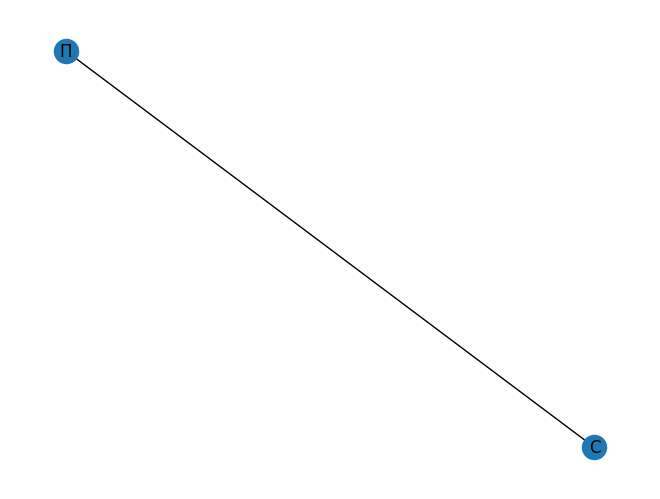

In [46]:
# !pip install networkx

import numpy as np
import networkx as nx

# Current example - credit history - adding relatives

g = nx.Graph()
g.add_node('П')
g.add_node('С')
g.add_edge('П','С')
nx.draw(g, with_labels=True)

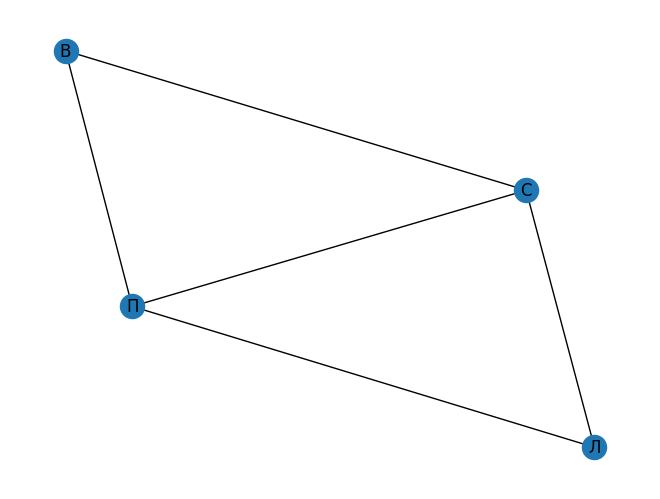

In [47]:
g.add_nodes_from(['В','Л'])
g.add_edges_from([('В','П'),('В','С'),('Л','П'),('Л','С')])
nx.draw(g, with_labels=True)

In [48]:
feat = {'П':{'sum':2000000,'count':10},
        'С':{'sum':1000000,'count':4},
        'В':{'sum':40000,'count':1},
        'Л':{'sum':0,'count':0},}

feat = pd.DataFrame(feat).T
feat

,sum,count
П,2000000,10
С,1000000,4
В,40000,1
Л,0,0


In [50]:
nx.set_node_attributes(g, feat.T)
g.nodes.data()

NodeDataView({'П': {'sum': 2000000, 'count': 10}, 'С': {'sum': 1000000, 'count': 4}, 'В': {'sum': 40000, 'count': 1}, 'Л': {'sum': 0, 'count': 0}})

___
### **Adding more complex features** (centrality, betweenness, closeness) --- using Star Wars characters dataset

In [52]:
import json
import requests
from collections import Counter
from networkx.readwrite import json_graph

# Загружаем датасет
path = 'https://raw.githubusercontent.com/evelinag/StarWars-social-network/master/networks/starwars-full-interactions.json'
interactions = json.loads(requests.get(path).content)

In [53]:
# nodes (characters)
interactions['nodes'][:10]

[{'name': 'QUI-GON', 'value': 61, 'colour': '#4f4fb1'},
 {'name': 'NUTE GUNRAY', 'value': 24, 'colour': '#808080'},
 {'name': 'PK-4', 'value': 3, 'colour': '#808080'},
 {'name': 'TC-14', 'value': 4, 'colour': '#808080'},
 {'name': 'OBI-WAN', 'value': 147, 'colour': '#48D1CC'},
 {'name': 'DOFINE', 'value': 3, 'colour': '#808080'},
 {'name': 'RUNE', 'value': 10, 'colour': '#808080'},
 {'name': 'TEY HOW', 'value': 4, 'colour': '#808080'},
 {'name': 'EMPEROR', 'value': 51, 'colour': '#191970'},
 {'name': 'CAPTAIN PANAKA', 'value': 19, 'colour': '#808080'}]

In [54]:
# connections
interactions['links'][:10]

[{'source': 1, 'target': 0, 'value': 1},
 {'source': 2, 'target': 3, 'value': 1},
 {'source': 4, 'target': 3, 'value': 1},
 {'source': 0, 'target': 3, 'value': 1},
 {'source': 4, 'target': 0, 'value': 26},
 {'source': 1, 'target': 3, 'value': 1},
 {'source': 5, 'target': 1, 'value': 1},
 {'source': 5, 'target': 3, 'value': 1},
 {'source': 1, 'target': 6, 'value': 8},
 {'source': 6, 'target': 7, 'value': 2}]

In [55]:
interactions['directed'] = False
interactions['multigraph'] = False
interactions['graph'] = {}

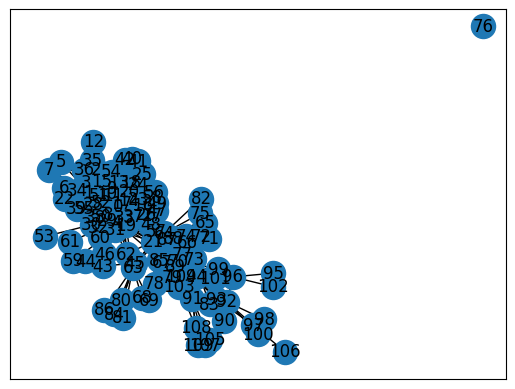

In [56]:

G = json_graph.node_link_graph(interactions)
nx.draw_networkx(G)

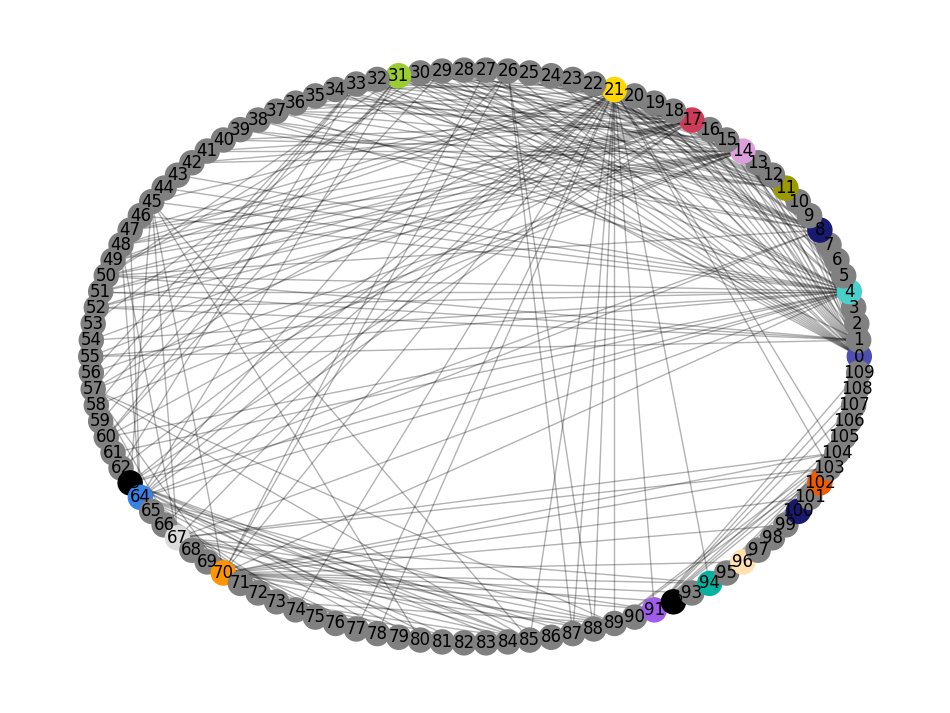

In [57]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams["figure.figsize"] = [12, 9]

clrs = np.array([n[1]['colour'] for n in G.nodes.data()])
labels = {n[0]: n[1]['name'] for n in G.nodes.data()}

pos=nx.circular_layout(G)

nx.draw_networkx_nodes(G,
                       pos=pos,
                       node_color=clrs,
                       )

nx.draw_networkx_edges(G,
                       pos=pos,
                       alpha=0.3,
                       label={n[0]: n[1]['name'] for n in G.nodes.data()})

nx.draw_networkx_labels(G, pos=pos)
plt.axis('off')
plt.show()

In [58]:
degree_centrality = nx.degree_centrality(G)
degree_centrality_counts = Counter(degree_centrality)
for k, v in degree_centrality_counts.most_common(10):
    
    print(G.nodes[k]['name'], v)

ANAKIN 0.3761467889908257
OBI-WAN 0.3211009174311927
PADME 0.30275229357798167
C-3PO 0.30275229357798167
QUI-GON 0.23853211009174313
JAR JAR 0.22018348623853212
LUKE 0.22018348623853212
HAN 0.21100917431192662
EMPEROR 0.2018348623853211
LEIA 0.1926605504587156


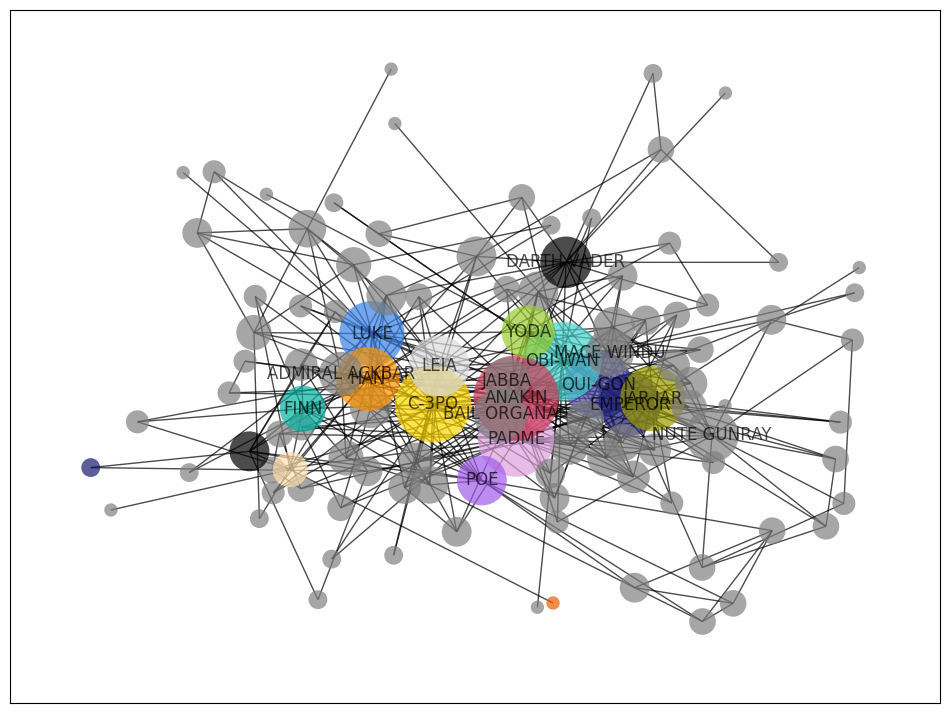

In [59]:
pos=nx.spring_layout(G, k=5*1/np.sqrt(len(G.nodes()))) # Фиксируем случайность
th = degree_centrality_counts.most_common(20)[-1][1]
nx.draw_networkx(
    G, 
    node_color=clrs, 
    with_labels=True, 
    alpha=0.7, 
    labels={n[0]: n[1]['name'] for n in G.nodes.data() if degree_centrality[n[0]] > th}, 
    node_size=np.array(list(degree_centrality.values())) * 10000,
    linewidths=0.01,
    pos=pos,
)

In [60]:
betweenness_centrality = nx.betweenness_centrality(G)
betweenness_centrality_counts = Counter(betweenness_centrality)

for k, v in betweenness_centrality_counts.most_common(10):
    print(G.nodes[k]['name'], v)

OBI-WAN 0.21289741830262351
C-3PO 0.1926808487468285
HAN 0.1812153961936558
ANAKIN 0.1621708391273783
LUKE 0.137821617635291
DARTH VADER 0.0880518038555187
POE 0.08361809147724517
EMPEROR 0.07433337936695311
PADME 0.06946928856235446
KYLO REN 0.05646104121849159


In [61]:
closeness_centrality = nx.closeness_centrality(G)

closeness_centrality_counts = Counter(closeness_centrality)
for k, v in closeness_centrality_counts.most_common(10):
    print(G.nodes[k]['name'], v)

OBI-WAN 0.5515936820202403
C-3PO 0.5487649964714185
ANAKIN 0.5377345442810383
LUKE 0.5144671841919549
HAN 0.5047602561883331
EMPEROR 0.4908677720730579
PADME 0.48202330771138113
DARTH VADER 0.48202330771138113
LEIA 0.47986176821491755
QUI-GON 0.4693384838242395


### Transfer graphs to ML (to be able to work with it)
- 2 approaches: 'graph algorithms' || graph neural networks
- we're gonna use 'graph algorithms'
    - with 'karate-club' library
- **karate-club** ([documentation](https://karateclub.readthedocs.io/en/latest/index.html))
    - trained model has 3 methods
        - get_embedding --- returns 'embeddings of nodes'
        - get_memberships --- return dictionary with the node belonging to a particular community; or None
        - get_cluster_center --- return dictionary with info about node being center of particular community; or None
    - DeepWalk --- simple algorithm
    - Node2Vec
        - transform nodes to embeddings via kinda 'random' walking in graph
        - then during 'walking' develops 'sequence from nodes' on which model 'Skip-Gram' being trained (to predict gaps in nodes)
            - Skip-Gram is similar to 'word2vec' (which tries to predict gaps of words) 

In [65]:
#!pip install karateclub
#!conda install karateclub

from karateclub import DeepWalk

model = DeepWalk()
model.fit(G)
embedding = model.get_embedding()
print(embedding.shape)
embedding

(110, 128)


array([[ 0.19741422, -0.05769976,  0.07182793, ...,  0.20346552,
         0.24766721,  0.13259955],
       [-0.0935649 ,  0.00532335, -0.10027362, ...,  0.3252362 ,
         0.3912213 , -0.8212237 ],
       [-0.11306894, -0.05290724,  0.52146983, ..., -0.53136754,
         0.5267    , -1.1333687 ],
       ...,
       [ 0.11497647,  0.28675327, -0.71611446, ...,  0.17601785,
         0.00642847,  0.45869455],
       [ 0.16844168,  0.04498943, -0.67065954, ...,  0.1675413 ,
        -0.14051424,  0.40965685],
       [ 0.0746696 ,  0.29068592, -0.6013059 , ...,  0.09169884,
        -0.09960819,  0.17905024]], dtype=float32)

In [66]:
from karateclub import Node2Vec

# We create a model. 
# Node2Vec has many parameters, such as --- number & length of random walks, epochs, etc.
# We are most interested in the 'dimensions' parameter, this is the dimension of our embeddings. 
# Let's make it equal to 64 for example.

n2v = Node2Vec(dimensions=64)

In [67]:
n2v.fit(G)
embeddings = n2v.get_embedding()

In [68]:
embeddings.shape

(110, 64)

## 4. TSFresh ([documentation](https://tsfresh.readthedocs.io/en/latest/)) --- time series
- Generation of features
    1. not only generates features --- also allows 'degree of power & significance' of features in 'classification' or 'regression' problems
    2. generates features using simple patterns (max, min, mean, median, number of peaks)
    3. generates features using complex factors (symmetrical distribution, etc.)
    4. generation happens according to 'dictionary' provided to 'default_fc_parameters' parameter
        - providing not dictionary, but object that creates dictionary
        - some 'calculators' (functions) have additional attributes (the output might be +100 new features)
        - list of objects (calculators)
            - ComprehensiveFCParameters --- (default) full calculators set - 75 total (+100 features)
            - EfficientFCParameters --- all calculators except most expensive - 73 total
            - MinimalFCParameters --- minimum calculators - 10 total
    5. possible to 'add/remove' calculators OR create custom calculator ([guide](https://tsfresh.readthedocs.io/en/latest/text/list_of_features.html))
    6. possible to apply calculators to particular features
    7. AUTO generate relevant features using data (not always works properly)
- possible to put TSFresh in Sklearn pipelines

In [32]:
# !pip install tsfresh

from tsfresh.examples.robot_execution_failures import download_robot_execution_failures, load_robot_execution_failures

# robot data

download_robot_execution_failures()
timeseries, y = load_robot_execution_failures()
timeseries

,id,time,F_x,F_y,F_z,T_x,T_y,T_z
0,1,0,-1,-1,63,-3,-1,0
1,1,1,0,0,62,-3,-1,0
2,1,2,-1,-1,61,-3,0,0
3,1,3,-1,-1,63,-2,-1,0
4,1,4,-1,-1,63,-3,-1,0
...,...,...,...,...,...,...,...,...
1315,88,10,-10,2,39,-21,-24,5
1316,88,11,-11,2,38,-24,-22,6
1317,88,12,-12,3,23,-24,-24,5
1318,88,13,-13,4,26,-29,-27,5


In [4]:
timeseries.id.nunique()

88

In [5]:
# Посмотрим на набор признаков в MinimalFCParameters
from tsfresh.feature_extraction import MinimalFCParameters
from pprint import pprint

pprint(MinimalFCParameters())

{'absolute_maximum': None,
 'length': None,
 'maximum': None,
 'mean': None,
 'median': None,
 'minimum': None,
 'root_mean_square': None,
 'standard_deviation': None,
 'sum_values': None,
 'variance': None}


In [ ]:
from tsfresh import extract_features

extracted_features = extract_features(timeseries, column_id="id", column_sort="time", n_jobs=1, default_fc_parameters=MinimalFCParameters())
extracted_features.head()

**Deleting calculators && adding custom calculators**

In [10]:
fc_parameters = MinimalFCParameters()
for x in ['sum_values', 'median',  'mean', 'maximum', 'absolute_maximum', 'minimum']:
    del fc_parameters[x] 
    
fc_parameters.update({
     'linear_trend': [{'attr': 'pvalue'}, {'attr': 'slope'}],
     'variance_larger_than_standard_deviation': None, 
     'large_standard_deviation': [{'r': 0.05}, {'r': 0.1}]
})

pprint(fc_parameters)

{'large_standard_deviation': [{'r': 0.05}, {'r': 0.1}],
 'length': None,
 'linear_trend': [{'attr': 'pvalue'}, {'attr': 'slope'}],
 'root_mean_square': None,
 'standard_deviation': None,
 'variance': None,
 'variance_larger_than_standard_deviation': None}


In [ ]:
extracted_features = extract_features(timeseries, column_id="id", column_sort="time", n_jobs=2, default_fc_parameters=fc_parameters)
extracted_features.head()

**Customize columns for which to use particular calculators**

In [12]:
ts_fc_parameters = {
    "F_x": {"mean": None},
    "F_y": {"maximum": None, "minimum": None}
}

In [ ]:
extracted_features = extract_features(timeseries, column_id="id", column_sort="time", n_jobs=2, kind_to_fc_parameters=ts_fc_parameters)
extracted_features.head()

**In-build generation of relevant features using data** --- extract_relevant_features (not always work properly)

In [ ]:
from tsfresh import extract_relevant_features

extracted_features = extract_relevant_features(timeseries, y, column_id="id", column_sort="time", n_jobs=4)
extracted_features.head()

**Using TSFresh with sklearn pipelines**

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from tsfresh.transformers import RelevantFeatureAugmenter

pipeline = Pipeline([
            ('augmenter', RelevantFeatureAugmenter(column_id='id', column_sort='time')),
            ('classifier', RandomForestClassifier()),
            ])
timeseries, y = load_robot_execution_failures()
X = pd.DataFrame(index=y.index)

pipeline.set_params(augmenter__timeseries_container=timeseries)
pipeline.fit(X, y)

___
# <font color='pink'> 🎯 5.2 **Optuna** - Hyperparameter Optimization</font>
- **do after choosing features** (since new features ---> new best hyperparameters ---> optimization again)
- **not really helps to improve result**
- uses Bayes hyperparameters search

## Simple start --- Objective + Trial
- **How to work:**
    1. load data - define features type
    2. write fit() function --- describe hyperparameters optimization intervals
    3. write objective() function --- use split data, fit, save scores
    4. create_study for optuna --- direction, pruner
    5. start optimization --- n_trials, n_jobs
    6. use visuals to help define proper intervals
- Terminology:
    - trial - 1 usage of objective function
    - study - optimization based on objective function
    - objective - metric for optimization based on trial
- Samplers types for data
    - GridSampler (like GridSearch)
    - RandomSampler (like RandomSearch)
    - Tree-Structed Parzen Estimator (or TPESampler - by default)
    - BruteForceSampler
    - +4 more
    - can create custom sampler
- **Advices on hyperparameters searching**
    - know which parameters are important
    - take large 'num_iterations' (with fixing 'early_stopping_rounds')
    - check/know intervals and step values for parameters
    - no need to optimize --- random_seed, eval_metric, thread_count, etc.
    - use previous tries info
- **How to speed up Optuna**:
    - decrease search space
    - parallel 
    - use pruning
    - use smart sampler (like TPEsample)

In [142]:
# !pip install optuna
import optuna

import numpy as np
import pandas as pd

from catboost import CatBoostClassifier
from sklearn.model_selection import KFold, train_test_split

In [143]:
# загружаем датасет quickstart_train и отберем колонки
path = "tmp_data/quickstart_train.csv"
train = pd.read_csv(path)

cat_features = ["model", "car_type", "fuel_type"]  # Выделяем категориальные признаки
targets = ["target_class", "target_reg"]
features2drop = ["car_id"]  # эти фичи будут удалены

# Отбираем итоговый набор признаков для использования моделью
filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]

In [144]:
def fit_catboost(trial, train, val):
    X_train, y_train = train
    X_val, y_val = val

    param = {
        'iterations' : 400, # Можно не перебирать, есть Easrly-Stopping
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.01),
        "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 2, 50),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.8),
        
        "auto_class_weights": trial.suggest_categorical("auto_class_weights", ["SqrtBalanced", "Balanced", "None"]),
        "depth": trial.suggest_int("depth", 3, 9),
        
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]),
        "used_ram_limit": "14gb",
        "eval_metric": "Accuracy", # Тоже стоит заранее определиться
    }

    
    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 20)
        
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)
        

    clf = CatBoostClassifier(
        **param,
        thread_count=-1,
        random_seed=42,
        cat_features=cat_features,
    )

    clf.fit(
        X_train,
        y_train,
        eval_set=(X_val, y_val),
        verbose=0,
        plot=False,
        early_stopping_rounds=5,
    )

    y_pred = clf.predict(X_val)
    return clf, y_pred

In [145]:
from sklearn.metrics import accuracy_score


def objective(trial, return_models=False):
    n_splits = 3
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    X_train = train[filtered_features].drop(targets, axis=1, errors="ignore")
    y_train = train["target_class"]

    scores, models = [], []
    
    for train_idx, valid_idx in kf.split(X_train):
        train_data = X_train.iloc[train_idx, :], y_train.iloc[train_idx]
        valid_data = X_train.iloc[valid_idx, :], y_train.iloc[valid_idx]

        # Подаем trials для перебора
        model, y_pred = fit_catboost(trial, train_data, valid_data) # Определили выше
        scores.append(accuracy_score(y_pred, valid_data[1]))
        models.append(model)
        break
         

    result = np.mean(scores)
    
    if return_models:
        return result, models
    else:
        return result

In [147]:
study = optuna.create_study(direction="maximize")
study.optimize(objective,
               n_trials=30,
               n_jobs = -1,
               show_progress_bar=True,)

[I 2023-05-09 22:57:38,159] A new study created in memory with name: no-name-483f21fb-9a83-4687-bdbf-2d73d2a54c8d
C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\optuna\progress_bar.py:56: ExperimentalWarning: Progress bar is experimental (supported from v1.2.0). The interface can change in the future.
  self._init_valid()


  0%|          | 0/30 [00:00<?, ?it/s]

[I 2023-05-09 22:57:40,559] Trial 4 finished with value: 0.6803594351732991 and parameters: {'learning_rate': 0.001280954613659937, 'l2_leaf_reg': 21, 'colsample_bylevel': 0.7164770407425063, 'auto_class_weights': 'None', 'depth': 3, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.081605847190918}. Best is trial 4 with value: 0.6803594351732991.
[I 2023-05-09 22:57:40,711] Trial 0 finished with value: 0.5738125802310655 and parameters: {'learning_rate': 0.0035250939954277237, 'l2_leaf_reg': 47, 'colsample_bylevel': 0.16292600044148697, 'auto_class_weights': 'SqrtBalanced', 'depth': 4, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 4 with value: 0.6803594351732991.
[I 2023-05-09 22:57:41,837] Trial 5 finished with value: 0.7445442875481386 and parameters: {'learning_rate': 0.00265115994778224, 'l2_leaf_reg': 17, 'colsample_bylevel': 0.22167802936623177, 'auto_class_weights': 'Balanced', 'depth': 4, 'boosting_type': 'Ordered', 'bootst

In [148]:
print("Best trial: score {}, params {}".format(study.best_trial.value, study.best_trial.params))

Best trial: score 0.7766367137355584, params {'learning_rate': 0.0027603102974409787, 'l2_leaf_reg': 33, 'colsample_bylevel': 0.3396397105931752, 'auto_class_weights': 'Balanced', 'depth': 9, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.924700172631463}


In [149]:
valid_scores, models = objective(
    optuna.trial.FixedTrial(study.best_params),
    return_models=True,
)

In [150]:
valid_scores, len(models)

(0.7766367137355584, 1)

## Visuals for Optuna
- optimization history (trial - objective)
- slice plot (feature - accuracy)
- hyperparameter importance (importance for objective - hyperparameter)

In [151]:
trials_df = study.trials_dataframe().sort_values('value', ascending=False)
trials_df.head(3)

,number,value,datetime_start,datetime_complete,duration,params_auto_class_weights,params_bagging_temperature,params_boosting_type,params_bootstrap_type,params_colsample_bylevel,params_depth,params_l2_leaf_reg,params_learning_rate,params_subsample,state
22,22,0.777,2023-05-09 22:57:55.145532,2023-05-09 22:58:38.705645,0 days 00:00:43.560113,Balanced,NaN,Ordered,Bernoulli,0.340,9,33,0.003,0.925,COMPLETE
13,13,0.764,2023-05-09 22:57:44.391442,2023-05-09 22:57:52.743559,0 days 00:00:08.352117,Balanced,7.206,Ordered,Bayesian,0.613,3,32,0.002,NaN,COMPLETE
29,29,0.761,2023-05-09 22:58:10.989896,2023-05-09 22:58:28.838555,0 days 00:00:17.848659,Balanced,NaN,Ordered,MVS,0.695,6,5,0.005,NaN,COMPLETE


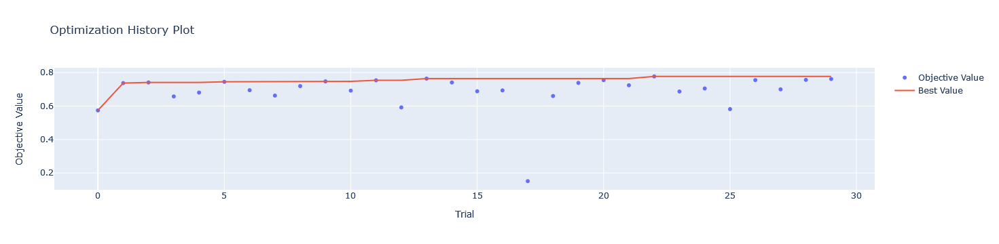

In [152]:
# История изменения от числа испытаний
optuna.visualization.plot_optimization_history(study)

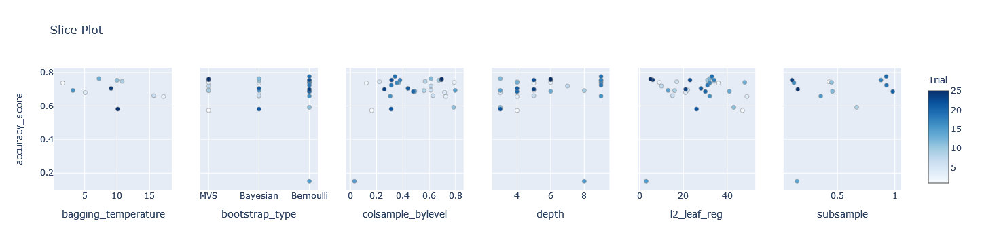

In [153]:
# Зависимость в разрере по параметрам
params = ['l2_leaf_reg', 'colsample_bylevel', 'bagging_temperature', 'depth', 'bootstrap_type', 'subsample']
optuna.visualization.plot_slice(study,
                                params=params,
                                target_name = 'accuracy_score')

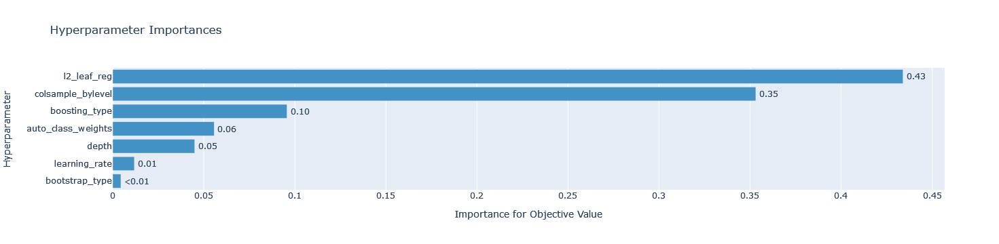

In [154]:
# Важность параметров
optuna.visualization.plot_param_importances(study)

## Pruning ([documentation](https://optuna.readthedocs.io/en/stable/reference/pruners.html)) --- killing dead trials
- same code, just added pruning line
- kills trials when the result is worse than in previous trials
- callbacks for 'pruners'
    - CatBoost --- optuna.integration.CatBoostPruningCallback
    - XGBoost --- optuna.integration.XGBoostPruningCallback
    - LightGBM --- optuna.integration.LightGBMPruningCallback
- type of 'pruners'
    - Median Pruner --- most popular, each iteration drops worst quality trials
    - Successive Halving Algorithm (SHA) --- start trials with minimum resources usage (low samples amount, little iterations), each iteration drops worst quality trials + increase resources
    - Percentile Pruner, Hyperband Pruner, etc..

In [155]:
from optuna.integration import CatBoostPruningCallback


def objective_catboost(trial):
    X = train[filtered_features].drop(targets, axis=1, errors="ignore")
    y = train["target_class"]
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42
    )

    param = {
        'iterations' : 250,
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.01),
        "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 2, 17),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        
        "auto_class_weights": trial.suggest_categorical("auto_class_weights", ["SqrtBalanced", "Balanced", "None"]),
        "depth": trial.suggest_int("depth", 4, 9),
        
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]),
        "used_ram_limit": "12gb",
        
        "eval_metric": "Accuracy",
    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    clf = CatBoostClassifier(
        **param, thread_count=-1, random_seed=42, cat_features=cat_features
    )

    # Создаем объект callback
    pruning_callback = CatBoostPruningCallback(trial, "Accuracy")

    clf.fit(
        X_train,
        y_train,
        eval_set=(X_test, y_test),
        verbose=0,
        plot=False,
        early_stopping_rounds=5,
        callbacks=[pruning_callback],
    )  # Добавляем callback в fit

    # запускаем процесс прунинга
    pruning_callback.check_pruned()

    y_pred = clf.predict(X_test)
    accuracy = accuracy_score(y_pred, y_test)
    return accuracy

In [156]:
study = optuna.create_study(
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=5),
    direction="maximize",
)

study.optimize(objective_catboost,
               n_trials=90,
               n_jobs = -1,
              )

[I 2023-05-09 22:59:07,519] A new study created in memory with name: no-name-076ece22-f22a-45c8-a1a8-3932b6eccda6
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_22336\3844926951.py:37: ExperimentalWarning:

CatBoostPruningCallback is experimental (supported from v3.0.0). The interface can change in the future.

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_22336\3844926951.py:37: ExperimentalWarning:

CatBoostPruningCallback is experimental (supported from v3.0.0). The interface can change in the future.

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_22336\3844926951.py:37: ExperimentalWarning:

CatBoostPruningCallback is experimental (supported from v3.0.0). The interface can change in the future.

C:\Users\Adm.000\AppData\Local\Temp\ipykernel_22336\3844926951.py:37: ExperimentalWarning:

CatBoostPruningCallback is experimental (supported from v3.0.0). The interface can change in the future.

[I 2023-05-09 22:59:07,795] Trial 4 finished with value: 0.12393162393162394 and parameters: {

In [157]:
print("Number of finished trials: {}".format(len(study.trials)))
print("Best trial:")
trial = study.best_trial
print("  Value: {}".format(trial.value))
print("  Params: ")

for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

Number of finished trials: 90
Best trial:
  Value: 0.7756410256410257
  Params: 
    learning_rate: 0.004734603958825137
    l2_leaf_reg: 12
    colsample_bylevel: 0.09931990947816527
    auto_class_weights: Balanced
    depth: 7
    boosting_type: Ordered
    bootstrap_type: Bayesian
    bagging_temperature: 2.2988750613558078


___
# <font color='pink'>🌈 6.1 **Blending**</font>
- idea - **voting/averaging results after predict()**
    - taking **the best out** of each model
    - making final model more **generalized**
    - **more stable** on private leader-board
    - good with models of different kind (example: NN, trees, KNN)
- **variety**: mean || weighted mean || hard-voting || soft-voting || ranking averaging
- **weaker than stacking**
- **Library for Blending** ---> [github](https://github.com/MLWave/Kaggle-Ensemble-Guide)

___
**Advices**
1. do **ONLY after got BEST** out of the model (found best features, best parameters)
2. more **DIFFERENT models --- the better** (effectiveness)
3. with **even accuracy --- blending wins** again solo-model (effectiveness)
4. **the earlier blending is tested** --- the more effective the strategy would be
    - early blending can give a hint on which models you should focus on tuning
    - train models but don't over-do it for too much
5. **weights of blending** can be proportional to --- scores, features, metrics
6. **checkpoints/folds blending** --- blending too
7. **'seed' blending** ~~~ stability blending
8. **blending <= bigger blending**

**Overall**
- blending helps in generalizing model
- blending helps with stability
- blending helps with overfitting

**Blending techniques**
- Regression --- take mean() with weights
    - mean() should be weighted --- meaning 'w_1 + w_2 + w_3 = 1'
        - works if need to take into account the accuracy of models
- Classification
    - Hard Voting --- take most frequent class
        - weighted technique also can be applied --- some models might have 2 votes (instead of 1)
    - Soft Voting --- sum(probabilites) for all classes ---> choose class with MAX probability sum
- Ranking

___
## Code example of Blending (CatBoost + XGBoost + LightGBM)
- Regression - MSE - 132.845 || 141.312 || 135.882 ----> 132.313 -- (0.5, 0.35, 0.15)

### Loading data + replacing categorical features with numerical (for XGBoost & LightGBM)

In [2]:
# Модели для смешивания
import lightgbm as lgbm
import xgboost as xgb
import catboost as cb

# --------------------------------------------------

import numpy as np
import pandas as pd

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings("ignore")

# --------------------------------------------------

data = pd.read_csv("tmp_data/quickstart_train.csv")

### Заменим категориальные признаки на числовые значения (for XGBoost & LightGBM)
cat_cols = ["model", "car_type", "fuel_type"]
for col in cat_cols:
    data[col] = data[col].replace(np.unique(data[col]), np.arange(data[col].nunique()))
    data[col] = data[col].astype("category")

data.head()

,car_id,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,target_reg,target_class,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
0,y13744087j,8,1,1,3.780,2015,76163,2021,108.530,another_bug,4.738,12141310.405,0.100,180.856,0.023,174,170
1,O41613818T,23,1,1,3.900,2015,78218,2021,35.200,electro_bug,4.481,18039092.838,0.000,187.863,12.306,174,174
2,d-2109686j,16,3,1,6.300,2012,23340,2017,38.620,gear_stick,4.768,15883659.428,0.100,102.383,2.513,174,173
3,u29695600e,12,0,1,4.040,2011,1263,2020,30.340,engine_fuel,3.881,16518828.765,0.100,172.793,-5.029,174,170
4,N-8915870N,16,3,1,4.700,2012,26428,2017,30.450,engine_fuel,4.181,13983174.664,0.100,203.462,-14.260,174,171


In [25]:
cols2drop = ["car_id", "target_reg", "target_class"]

X_train, X_val, y_train, y_val = train_test_split(
    data.drop(cols2drop, axis=1),
    data["target_reg"],
    test_size=0.25,
    stratify=data["target_class"],
    random_state=42,
)
print(X_train.shape, X_val.shape)

(1752, 14) (585, 14)


In [26]:
X_train

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq
808,9,3,1,4.220,2011,1933,2019,4.178,7841316.117,0.100,166.346,1.140,174,171
1768,5,1,1,3.380,2015,76597,2022,4.569,8573246.272,0.100,117.379,-4.605,174,172
1161,15,3,1,4.760,2015,77969,2015,4.787,12086515.013,0.100,163.000,18.240,174,171
1269,20,1,1,7.000,2017,142862,2014,4.611,10417019.457,0.100,118.000,2.246,174,168
418,9,3,1,4.620,2013,45652,2014,4.454,14672086.238,0.490,161.265,6.554,174,170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2164,15,3,1,3.640,2011,1868,2016,3.839,4132175.303,0.100,186.855,-7.085,174,172
1127,15,3,1,6.140,2011,2768,2016,4.012,17622561.150,0.100,183.309,1.351,174,172
1736,13,0,1,5.440,2014,60625,2017,4.268,11333848.977,0.000,184.625,1.540,174,172
1756,22,1,1,2.440,2015,83179,2020,4.050,13658489.672,0.100,158.950,6.763,174,169


### CatBoost training
- handles categorical
- MSE (catboost) :  132.845


In [4]:
params_cat = {
    "n_estimators": 1500,
    "learning_rate": 0.03,
    "depth": 3,
    "use_best_model": True,
    "cat_features": cat_cols,
    "text_features": [],
    # 'train_dir' : '/path/to/catboost/model',
    "border_count": 64,
    "l2_leaf_reg": 1,
    "bagging_temperature": 2,
    "rsm": 0.5,
    "loss_function": "RMSE",  # Не определена для регресси
    # 'auto_class_weights' : 'Balanced', # Не опредлен для регресси
    "random_state": 42,
    "custom_metric": ["MAE", "MAPE"],
}

cat_model = cb.CatBoostRegressor(**params_cat)

In [5]:
cat_model.fit(
    X_train,
    y_train,
    verbose=100,
    eval_set=(X_val, y_val),
    early_stopping_rounds=150,
)

0:	learn: 17.3906345	test: 17.7985532	best: 17.7985532 (0)	total: 143ms	remaining: 3m 35s
100:	learn: 12.0403851	test: 12.3152085	best: 12.3152085 (100)	total: 858ms	remaining: 11.9s
200:	learn: 11.4088372	test: 11.7734917	best: 11.7734917 (200)	total: 1.58s	remaining: 10.2s
300:	learn: 11.0615383	test: 11.5972845	best: 11.5972845 (300)	total: 2.29s	remaining: 9.14s
400:	learn: 10.8223003	test: 11.5498790	best: 11.5498790 (400)	total: 3.05s	remaining: 8.36s
500:	learn: 10.6376836	test: 11.5293225	best: 11.5258544 (495)	total: 3.78s	remaining: 7.53s
600:	learn: 10.4762744	test: 11.5542883	best: 11.5258544 (495)	total: 4.57s	remaining: 6.84s
Stopped by overfitting detector  (150 iterations wait)

bestTest = 11.52585441
bestIteration = 495

Shrink model to first 496 iterations.


In [6]:
print('MSE (catboost) : ', mean_squared_error(cat_model.predict(X_val), y_val).round(3))

MSE (catboost) :  132.845


In [7]:
submit = pd.DataFrame({"target": cat_model.predict(X_val).reshape(-1)})
submit.to_csv("tmp_data/catboost_preds.csv", index=False)
submit.head()

,target
0,32.432
1,47.259
2,34.470
3,62.629
4,72.203


### LightGBM training
- handles categorical
- MSE (lgb) :  141.312

In [8]:
params_lgbm = {
    "num_leaves": 200,
    "n_estimators": 1500,
    # "max_depth": 7,
    "min_child_samples": 2073,
    "learning_rate": 0.0051,
    "min_data_in_leaf": 10,
    "feature_fraction": 0.99,
    "categorical_feature": cat_cols,
    'reg_alpha' : 5.0,
    'reg_lambda' : 5.0,
}

lgbm_model = lgbm.LGBMRegressor(**params_lgbm)

In [9]:
lgbm_model.fit(
    X_train,
    y_train,
    eval_set=(X_val, y_val),
    early_stopping_rounds=100,
    verbose=150,
)

[LightGBM] [Warning] feature_fraction is set=0.99, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=2073 will be ignored. Current value: min_data_in_leaf=10
[150]	valid_0's l2: 188.027
[300]	valid_0's l2: 157.996
[450]	valid_0's l2: 146.109
[600]	valid_0's l2: 141.884
[750]	valid_0's l2: 141.484


LGBMRegressor(categorical_feature=['model', 'car_type', 'fuel_type'],
              feature_fraction=0.99, learning_rate=0.0051,
              min_child_samples=2073, min_data_in_leaf=10, n_estimators=1500,
              num_leaves=200, reg_alpha=5.0, reg_lambda=5.0)

In [10]:
print('MSE (lgb) : ', mean_squared_error(lgbm_model.predict(X_val), y_val).round(3))

MSE (lgb) :  141.312


In [11]:
submit = pd.DataFrame({"target": lgbm_model.predict(X_val).reshape(-1)})
submit.to_csv("tmp_data/lgbm_preds.csv", index=False)
submit.head()

,target
0,31.486
1,43.974
2,33.595
3,61.806
4,67.997


### XGBoost training
- needs OneHotEncoding --- not handles categorical (**not even with numerical representation !!!**)
- MSE (xgboost) :  135.882

In [27]:
# xgboost не умеет работать с категориальными признаками, так что нужно сделать ohe
X_train = pd.get_dummies(X_train, columns=["car_type", "fuel_type", "model"])
X_val = pd.get_dummies(X_val, columns=["car_type", "fuel_type", "model"])
X_train.shape

(1752, 43)

In [13]:
params_xgb = {
    "eta": 0.05,
    "max_depth": 5,
    "subsample": 0.7,
    "colsample_bytree": 0.7,
    'gamma': .01,
    'reg_lambda' : 0.1,
    'reg_alpha' : 0.5,
    "objective": "reg:linear",
    "eval_metric": "mae",
    'tree_method' : 'hist', # Supported tree methods for cat fs are `gpu_hist`, `approx`, and `hist`.
    'enable_categorical' : True
    
}

xgb_model = xgb.XGBRegressor(**params_xgb)

In [14]:
xgb_model.fit(
    X_train,
    y_train,
    eval_set=[(X_train, y_train), (X_val, y_val)],
    early_stopping_rounds=100,
    verbose=25,
)
print('best_iteration', xgb_model.best_iteration)

[20:36:00] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\objective\regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-mae:42.23435	validation_1-mae:42.24238
[25]	validation_0-mae:12.80176	validation_1-mae:13.07504
[50]	validation_0-mae:7.88343	validation_1-mae:9.18403
[75]	validation_0-mae:6.91232	validation_1-mae:8.79229
[99]	validation_0-mae:6.49486	validation_1-mae:8.75844
best_iteration 85


In [15]:
print('MSE (xgboost) : ', mean_squared_error(xgb_model.predict(X_val), y_val).round(3))

MSE (xgboost) :  135.882


In [16]:
submit = pd.DataFrame({"target": xgb_model.predict(X_val).reshape(-1)})
submit.to_csv("tmp_data/xgb_preds.csv", index=False)
submit.head()

,target
0,31.271
1,43.439
2,34.268
3,58.997
4,68.420


### Blending results
- use weights PROPORTIONAL to MSE of model
- MSE (ensemble) : 132.313

In [17]:
cb_model  = pd.read_csv("tmp_data/catboost_preds.csv")["target"]  
xgb_model = pd.read_csv("tmp_data/xgb_preds.csv")["target"]     
lgb_model = pd.read_csv("tmp_data/lgbm_preds.csv")["target"]

In [22]:
# score1 > score2 > score3 : w1 > w2 > w3
ensemble = cb_model * 0.50 + xgb_model * 0.35 + lgb_model * 0.15 

print('MSE (ensemble) :', mean_squared_error(ensemble, y_val).round(3))

MSE (ensemble) : 132.313


**more universal way**

In [23]:
weights = {"catboost": 0.5, "lgbm": 0.15, "xgb": 0.35}

import os
preds = pd.DataFrame() # empty column

# getting 'submission' -> target * weight INTO 'preds'
# then 'sum' all columns (with grouping by model)
for model_name in ["catboost", "lgbm", "xgb"]:
    
    path = os.path.join("tmp_data/", f"{model_name}_preds.csv")
    now = pd.read_csv(path).reset_index()

    now["model"] = model_name
    now["target"] *= weights[model_name]
    preds = pd.concat([preds, now])

ensemble = preds.groupby("index")["target"].agg("sum")
print('MSE (ensemble) :', mean_squared_error(ensemble, y_val).round(3))

MSE (ensemble) : 132.313


## Examples of code (Hard-Voting, Soft-Voting, Weighted Mean, Rank Averaging)

#### Weighted Mean

In [ ]:
# model_weight = model_accuracy / sum(accuracy_of_models)
weights = {"catboost": 0.5, "lgbm": 0.15, "xgb": 0.35}

import os
preds = pd.DataFrame() # empty column

# getting 'submission' -> target * weight INTO 'preds'
# then 'sum' all columns (with grouping by model)
for model_name in ["catboost", "lgbm", "xgb"]:
    
    path = os.path.join("tmp_data/", f"{model_name}_preds.csv")
    now = pd.read_csv(path).reset_index()

    now["model"] = model_name
    now["target"] *= weights[model_name]
    preds = pd.concat([preds, now])

ensemble = preds.groupby("index")["target"].agg("sum")
print('MSE (ensemble) :', mean_squared_error(ensemble, y_val).round(3))

#### Hard Voting
- 1 file, columns are predictions

In [96]:
data = pd.read_csv('data/make_soft_blend.csv')

for i in range(len(data)):
    dictin = dict(data.iloc[i].value_counts())
    data['target_class'][i] = max(dictin, key=dictin.get)

sub = data[['car_id', 'target_class']]
sub.to_csv('subs/hard_voting.csv', index=False)

#### Soft Voting
- 3 files, features with probabilities of it

In [300]:
import os
preds = pd.DataFrame()

for model_name in ["catboost", "lgbm", "xgb"]:
    path = os.path.join("data/", f"{model_name}_preds.csv")
    now = pd.read_csv(path).reset_index()
    
    now["model"] = model_name
    preds = pd.concat([preds, now])

new = pd.DataFrame()
new['soft_preds'] = ''

features = list(preds.columns)[1:-1]

for feature in features:
    new[feature] = preds.groupby("index")[feature].agg("sum")
    #new[feature] = preds.groupby("index")[feature].transform('sum')

for i in range(len(new)):
    dictin = dict(new.iloc[i][1:])
    new.loc[i , 'soft_preds'] = max(dictin, key=dictin.get).rstrip('_proba')

sub = new[['soft_preds']].reset_index(drop=True)
sub.to_csv('subs/soft_voting.csv', index=False)

#### Rank Averaging
- ranking items by priorities (lower value ---> more relevant to take this item)
- example:
    - table
        - item_id || model_1_pred || model_2_pred || rank_of_model_1 || rank_of_model_2
        - 1 || 0.3 || 0.95 || 2 || 2
        - 2 || 0.4 || 0.90 || 3 || 1
        - 3 || 0.5 || 0.99 || 4 || 4
        - 4 || 0.2 || 0.98 || 1 || 3
    - just average won't work (1 model predictions are too high)
        - USE NORMALIZATION --- norm_pred = rank_of_model_i / sum(of_model_ranks)
    - results of normalization:
        - 0.50 || 0.50
        - 0.75 || 0.25
        - 1.00 || 1.00
        - 0.25 || 0.75
    - **now when blending we can AVERAGE**
        - NOTE: for TEST data we won't have ranks ---> we **assign rank** according **to the closest element in TRAIN**

In [248]:
import pandas as pd

# create a sample dataframe
df = pd.DataFrame({
    'id_s': [0, 1, 2, 3, 4],
    'proba': [0.374540, 0.950714, 0.731994, 0.598658, 0.156019]
})

# calculate model ranks and sum of ranks
df['reverse_proba'] = 1 - df['proba']
df['model_rank'] = df['reverse_proba'].rank(ascending=True)
sum_ranks = df['model_rank'].sum()

# calculate normalized probabilities
df['normalized_proba'] = df['model_rank'] / sum_ranks
df['normalized_reverse_proba'] = df['reverse_proba'] / np.sum(df['reverse_proba'])

# display the final dataframe
print(df)

   id_s  proba  reverse_proba  model_rank  normalized_proba   
0     0  0.375          0.625       4.000             0.267  \
1     1  0.951          0.049       1.000             0.067   
2     2  0.732          0.268       2.000             0.133   
3     3  0.599          0.401       3.000             0.200   
4     4  0.156          0.844       5.000             0.333   

   normalized_reverse_proba  
0                     0.286  
1                     0.023  
2                     0.122  
3                     0.183  
4                     0.386  


In [ ]:
s

___
# <font color='pink'>♨️ 6.2 **Stacking**</font>
- idea - **providing model output to another model (final/meta model)**
    - meta model choice
        - common choice --- CatBoost, XGBoost, Random Forest, etc.
        - Linear Regression --- good for generalizing, BUT bad at non-linear dependencies
    - usually stacking goes WITHOUT blending (too complicated is waste)
    

### 0. How everything works + EXAMPLE
- use models -> predict -> use this predict as training data for meta-model
    - algorithm - do a split  ---> X_train, y_train, X_holdout, y_holdout
        1. train base models on --- X_train, y_train
        2. do a base models predict on --- X_holdout
        3. provide this predictions to meta model and train it on them --- predictions_of_base_models, y_holdout
    - you can add some features for training DataFrame of meta-model 
        - '-', '+' between predictions, etc.
        - original features of X_train

In [ ]:
class Blender:
    def __init__(self, base_models, meta_model):
        
        self.base_models = base_models
        self.meta_model = meta_model
        
    def fit(self, X_train, y_train, X_hold, y_hold):
        
        final_features = np.zeros((len(X_hold), 0))
        for model in self.base_models:
            model.fit(X_train, y_train)
            preds = model.predict(X_hold).reshape(-1, 1)
            final_features = np.concatenate([final_features, preds], axis=1)
        
        self.meta_model.fit(final_features, y_hold)
    
    def predict(self, X_test):
        final_features = np.zeros((len(X_test), 0))
        for model in self.base_models:
            preds = model.predict(X_test).reshape(-1, 1)
            final_features = np.concatenate([final_features, preds], axis=1)
        
        return self.meta_model.predict(final_features)
    
    

base_models = [LinearRegression(), LassoCV(), SVR()]
X_train, X_holdout, y_train, y_holdout = train_test_split(X, y, random_state=42, shuffle=True)

Stacking_class = Blender(base_models, LinearRegression())
Stacking_class.fit(X_train, y_train, X_holdout, y_holdout)

preds = Stacking_class.predict(X_holdout)

### 1. Defining classification stacking model (with Sklearn)

In [ ]:
from sklearn.ensemble import StackingClassifier

meta_model = StackingClassifier(estimators = [("logreg", LogisticRegression()), ("svc", SVC())],
                                final_estimator = LogisticRegression()
                               )

### 2. Stacking with features
- we can add not only output of models (as meta model features) --- but also any other feature we want
- here listed features that could increase meta-model performance

1. **Adding rangs**
    - remind --- 'Ranking Average' is calculating 'relative position' of predicts in model ---> averaging is happening over the models 
    - advice --- 'ranks' can be a feature for meta-model (practice shows it's better than just ranks or separately predicted probabilities)
2. **Calculate quadratic dependencies**
    - advice --- one could easily combine outputs of models as feature for meta-model --- like pair multiplication or difference 
3. **Adding features of base models**
    - advice --- simply adding basic features from training data to help meta-model with combining outputs of base models
    - the modification --- using weighted features (weight = probability of model)
        - example --- 'n' features, 'm' base models  ---> 'n*m' features for meta-model of type 'feature[i] * preds[j]'

### 3. Practice - prepare data for meta model + add new features (via operations between predictions)
- use 'pivot_table' to build a DataFrame with columns of predictions of models
- create new columns/features (difference and division between models predictions)

#### Authors Code
- really fast, just simple loop

In [ ]:
df = pd.read_csv("data/meta_feautres_data.csv")

ensemble = pd.pivot_table(df, index='index', columns=['model'], values=['target']).reset_index()
ensemble.columns = ['_'.join(el) for el in ensemble.columns]

model_names = ['catboost', 'lgbm', 'xgb']
for i in range(3):
    for j in range(3):
        ensemble[f'{model_names[i]}_div_{model_names[j]}'] = ensemble['target_' + model_names[i]] / ensemble['target_' + model_names[j]]
        ensemble[f'{model_names[i]}_dif_{model_names[j]}'] = ensemble['target_' + model_names[i]] - ensemble['target_' + model_names[j]]

ensemble = ensemble.rename(columns={'index_': 'index'})
ensemble

#### Mine Code (uses .apply, from multi-index to index)
- REALLY LONG AND BAD
- apply function which creates new rows (via .apply)
    - agg_func from 'pivot_table' seems to be harder because it individually looks at each value
    - seems hard to extract values from other cells MOREOVER create new columns with proper names, etc.

In [161]:
import pandas as pd
import numpy as np

df = pd.read_csv("data/meta_feautres_data.csv")

table_1 = df.pivot_table(index = 'index',
                    columns = ['model'],
                    values = ['target'],
                   ).fillna(0)

table_1.columns = [f'{i[0]}_{i[1]}' for i in table_1.columns]
table_1.reset_index(inplace=True)

def dif_and_div(row, prefix='target_'):
    cols = [c.replace(prefix,'') for c in row.index if c.startswith(prefix)]
    #res = pd.DataFrame(columns=[f'{c1}_{op}_{c2}' for c1 in cols for c2 in cols for op in ['dif', 'div']])
    res = pd.Series(index=pd.MultiIndex(levels=[[], []], codes=[[], []], names=['row', 'col']))

    for i, c1 in enumerate(cols):
        for j, c2 in enumerate(cols):
            dif_col = f'{c1}_dif_{c2}'
            div_col = f'{c1}_div_{c2}'

            dif_val = row[prefix + c1] - row[prefix + c2]
            div_val = row[prefix + c1] / row[prefix + c2]

            res.loc[0, dif_col] = dif_val
            res.loc[0, div_col] = div_val
    
    return res

table_2 = table_1.apply(lambda row: dif_and_div(row), axis=1, result_type='expand') # expand i don't know what for
table_2 = pd.concat([table_2[col] for col in table_2.columns], axis=1) # getting rid of multi-index in 'rows'

# Multi-Index ---> Index
cols = pd.MultiIndex.from_tuples(table_2.columns)
table_2.columns = pd.Index(cols.get_level_values(1))

# Function applies '-' and '/' operations for each column with prefix 'traget_' to each column with prefix 'target_'
# The output (after .apply()) would be a DataFrame with new columns (and multi-index due to levels)
# NOTE 1: as input we get a row (pandas.Series) ---> to get a proper dataFrame we need to output the same thing ---> pandas.Series 
# NOTE 2: this only works with 'apply' function (aggfunc uses each value - it seems hard to apply any function with need of using other column values)

# ---------------

final = pd.concat([table_1, table_2], axis=1)
final

# table_1.to_csv("boosting_Stacking.csv", index=False)

,index,target_catboost,target_lgbm,target_xgb
0,0,65.928,49.623,55.741
1,1,44.248,43.244,42.662
2,2,43.808,45.389,42.217
3,3,45.661,44.769,40.970
4,4,43.653,40.463,38.243
...,...,...,...,...
580,580,43.373,44.205,39.796
581,581,44.169,42.960,42.351
582,582,44.393,43.845,44.074
583,583,43.649,46.200,40.630


### 4-5. Practice - writing custom Stacking class + using it

In [ ]:
# Using class

base_models = [LinearRegression(), LassoCV(), SVR()]
X_train, X_holdout, y_train, y_holdout = train_test_split(X, y, random_state=42, shuffle=True)

Stacking_class = Blender(base_models, LinearRegression())
Stacking_class.fit(X_train, y_train, X_holdout, y_holdout)

preds = Stacking_class.predict(X_holdout)

#### Author code
- using 1 loop (fot .fit() and predict())
    - saving predictions of models right after training into 'final_features'
- shape(length,0) - creates np array with no columns but fixed length
    - after that we just need to transform out prediction from numpy array of list into column ---> reshape(-1,1)

In [ ]:
class Blender:
    def __init__(self, base_models, meta_model):
        """
        base_models - список базовых моделей, которые нужно обучать на изначальных данных
        meta_model - мета модель, которая обучается на предсказаниях базовых моделей
        Считайте, что модель, которая передается имеет поля .fit(X_train, y_train) и .predict(X_test)
        .predict(X_test) возвращает предсказания размерности (n_samples,)
        """
        self.base_models = base_models
        self.meta_model = meta_model
        
    def fit(self, X_train, y_train, X_hold, y_hold):
        final_features = np.zeros((len(X_hold), 0))
        for model in self.base_models:
            model.fit(X_train, y_train)
            preds = model.predict(X_hold).reshape(-1, 1)
            final_features = np.concatenate([final_features, preds], axis=1)
        
        self.meta_model.fit(final_features, y_hold)
    
    def predict(self, X_test):
        final_features = np.zeros((len(X_test), 0))
        for model in self.base_models:
            preds = model.predict(X_test).reshape(-1, 1)
            final_features = np.concatenate([final_features, preds], axis=1)
        
        return self.meta_model.predict(final_features)

#### Mine code
- used pandas
- 2 loops (1 for models .fit(), other for building dataframe for prediction)

In [ ]:
import pandas as pd

class Blender:
    def __init__(self, base_models, meta_model):
        """
        base_models - список базовых моделей, которые нужно обучать на изначальных данных
        meta_model - мета модель, которая обучается на предсказаниях базовых моделей
        Считайте, что модель, которая передается имеет поля .fit(X_train, y_train) и .predict(X_test)
        .predict(X_test) возвращает предсказания размерности (n_samples,)
        """
        self.base_models = base_models
        self.meta_model = meta_model

    def fit(self, X_train, y_train, X_hold, y_hold):
        for model in self.base_models:
            model.fit(X_train, y_train)
            
        hold_preds = pd.DataFrame()
        for i, model in enumerate(self.base_models):
            hold_preds[f'pred_m{i+1}'] = model.predict(X_hold)
            
        self.meta_model.fit(hold_preds, y_hold)

    def predict(self, X_test):
        test_preds = pd.DataFrame()
        for i, model in enumerate(self.base_models):
            test_preds[f'pred_m{i+1}'] = model.predict(X_test)
        preds = self.meta_model.predict(test_preds)
        return preds

### 6. Adding Cross-Validation to Stacking
- same idea with X_holdout (but know with cross-validation on this X_holdout)
- that way models train and predict on unforeseen data 

In [ ]:
def GetPreds(model, X, y, X_test, n_fold=5):
    """
    model - имеет методы .fit(X, y) и .predict(X)
    X - pd.DataFrame
    y - np.array
    X_test - pd.DataFrame, для которого нужно сделать предсказания
    """
    folds = KFold(n_splits=n_fold)
    preds = np.empty((0,1), float)

    for train_indices, val_indices in folds.split(X, y):
        X_train, X_val = X.iloc[train_indices], X.iloc[val_indices]
        y_train, y_val = y[train_indices], y[val_indices]
        
        model.fit(X_train, y_train)
        preds = np.concatenate((preds, model.predict(X_val).reshape(-1,1)), axis=0)

    model.fit(X,y)
    test_preds = model.predict(X_test)
    
    return preds.reshape(len(X), 1), test_preds.reshape(len(X_test), 1)

### 7. [Hard] NLP --- Dataset of texts (classification)
- 10 target classes
- dataframe - texts
    - features already made (embeddings - big language models from HuggingFace --- sberbank-ai/ruBert-base || cointegrated/rubert-tiny2 || DeepPavlov/rubert-base-cased-conversational || sentence-transformers/LaBSE)
- **Task**
    - .fit() model with metric 'balanced_accuracy_score' to get >70%
        - classes are balanced (in train & test)
- **Advices from authors**
    - try boosting
    - grid_search + optuna
    - feature selection
    - extract features from 'text' (length, number of symbols, etc.) OR add it in 'catboost' as 'text features'
    - maybe try Stacking with like --- TfIdfVectorizer [to extract words from text] + SVC [vector classification]
        - they don't need to be trained on 'text embeddings'

- Everything about features is already done --- we need to focus on ensemble (Stacking / Blending)
- Ideas for Stacking (from what I learned):
    1. Use CV --- StratifiedKFold for balancing classes
    2. TO TRAIN base_models --- use boosting classifiers & other different popular models
    3. TO TRAIN meta model --- choose boosting (catboost probably)
- Ideas for Blendning:
    1. Blend the results of boosting classifiers & other different popular models
        - use weight blending according to our metric 'balanced_accuracy_score'
    2. Use fold blending
    3. Use seed blending (after I got final ensemble result on 1 seed)

___
#### **1. Vectorizer + Model**
- **Using only 'text' column (using vectorizers - NO EMBEDDINGS)**
- used this guide on Kaggle ---> [guide](https://www.kaggle.com/code/abhishek/approaching-almost-any-nlp-problem-on-kaggle)
- Requires:
    1. stopwords (alphabet) --- since text is on Russian - we need them to count common words in text to then classify it as something
    2. multi-classification metric --- multiclass logloss OR balanced_accuracy_score
    3. label encoding our 'target' classes
    4. every 'vectorizer' is basically a 'transformer' 
        - meaning it should be .fit() to the data
        - then --- new_data = .transform(data) 
- Vectorizers (Transformers):
    1. TF-IDF (Term Frequency - Inverse Document Frequency)
    2. CountVectorizer (word counts as features)
- **balanced_accuracy_score: 0.774**

In [2]:
import numpy as np
import pandas as pd
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
import os
import requests
from pathlib import Path
import nltk
from nltk import sent_tokenize, word_tokenize, regexp_tokenize
from nltk.corpus import stopwords
import pymorphy2
from collections import Counter
from sklearn import preprocessing


# Metric initialization
def multiclass_logloss(actual, predicted, eps=1e-15):
    """Multi class version of Logarithmic Loss metric.
    :param actual: Array containing the actual target classes
    :param predicted: Matrix with class predictions, one probability per class
    """
    # Convert 'actual' to a binary array if it's not already:
    if len(actual.shape) == 1:
        actual2 = np.zeros((actual.shape[0], predicted.shape[1]))
        for i, val in enumerate(actual):
            actual2[i, val] = 1
        actual = actual2

    clip = np.clip(predicted, eps, 1 - eps)
    rows = actual.shape[0]
    vsota = np.sum(actual * np.log(clip))
    return -1.0 / rows * vsota

russian_stopwords = stopwords.words("russian")
english_stopwords = stopwords.words("english")
en_ru_stopwords = russian_stopwords #+ english_stopwords

train = pd.read_csv("data/text_classification_train.csv")
test = pd.read_csv("data/text_classification_test.csv")

train = train[['text', 'category']]
test = test[['text']]

In [101]:
# Label Encoding 'Target' + Data split
lbl_enc = preprocessing.LabelEncoder()
y = lbl_enc.fit_transform(train.category.values)

xtrain, xvalid, ytrain, yvalid = train_test_split(train.text.values, y, 
                                                  stratify=y, 
                                                  random_state=42, 
                                                  test_size=0.1, shuffle=True)

In [192]:
print (xtrain.shape)
print (xvalid.shape)

(6750,)
(750,)


##### TfidfVectorizer + SVM
- balanced_accuracy_score: 0.747  
- **final score: 0.74**
    - used only 'text'

In [102]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Always start with these features. They work (almost) everytime!
tfv = TfidfVectorizer(min_df=3,  max_features=None, 
            strip_accents='unicode', analyzer='word',token_pattern=r'\w{1,}',
            ngram_range=(1, 3), use_idf=1,smooth_idf=1,sublinear_tf=1,
            stop_words = en_ru_stopwords)

# Fitting TF-IDF to both training and test sets (semi-supervised learning)
tfv.fit(list(xtrain) + list(xvalid))
xtrain_tfv =  tfv.transform(xtrain) 
xvalid_tfv = tfv.transform(xvalid)

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\utils\_param_validation.py:558: FutureWarning: Passing an int for a boolean parameter is deprecated in version 1.2 and won't be supported anymore in version 1.4.
  warnings.warn(
C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\feature_extraction\text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['другои', 'еи', 'какои', 'мои', 'неи', 'сеичас', 'такои', 'этои'] not in stop_words.
  warnings.warn(


In [104]:
from sklearn.svm import SVC

# Fitting a simple SVM
clf = SVC(C=1.0, probability=True) # since we need probabilities
clf.fit(xtrain_tfv, ytrain)

#predictions = clf.predict_proba(xvalid_svd_scl)
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

predictions = clf.predict(xvalid_tfv)
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.742 


In [196]:
xtest_tfv = tfv.transform(test['text'])

test['category'] = lbl_enc.inverse_transform(clf.predict(xtest_tfv))
test = test[['category']]

test.to_csv('subs/text_transforming.csv', index=False)

##### TfidfVectorizer + LogisticRegression
- multiclass_logloss: 1.417
- balanced_accuracy_score: 0.774 
- **final score: 0.7628**
    - used only 'text'

In [113]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Always start with these features. They work (almost) everytime!
tfv = TfidfVectorizer(min_df=3,  max_features=None, 
            strip_accents='unicode', analyzer='word',token_pattern=r'\w{1,}',
            ngram_range=(1, 3), use_idf=1,smooth_idf=1,sublinear_tf=1,
            stop_words = en_ru_stopwords)

# Fitting TF-IDF to both training and test sets (semi-supervised learning)
tfv.fit(list(xtrain) + list(xvalid))
xtrain_tfv =  tfv.transform(xtrain) 
xvalid_tfv = tfv.transform(xvalid)

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\feature_extraction\text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['другои', 'еи', 'какои', 'мои', 'неи', 'сеичас', 'такои', 'этои'] not in stop_words.
  warnings.warn(


In [115]:
from sklearn.linear_model import LogisticRegression
# Fitting a simple Logistic Regression on TFIDF
clf = LogisticRegression(C=1.0)
clf.fit(xtrain_tfv, ytrain)

#predictions = clf.predict_proba(xvalid_tfv)
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

predictions = clf.predict(xvalid_tfv)
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.774 


In [127]:
xtrain_tfv = tfv.transform(test['text'])
clf.predict(xtrain_tfv)

test['category'] = lbl_enc.inverse_transform(clf.predict(xtrain_tfv))
test = test[['category']]

In [130]:
test.to_csv('subs/text_transforming.csv', index=False)

##### CountVectorizer + LogisticRegression
- multiclass_logloss: 1.093 
- balanced_accuracy_score: 0.722 

In [87]:
from sklearn.feature_extraction.text import CountVectorizer

ctv = CountVectorizer(analyzer='word',token_pattern=r'\w{1,}',
            ngram_range=(1, 3), stop_words = en_ru_stopwords)

# Fitting Count Vectorizer to both training and test sets (semi-supervised learning)
ctv.fit(list(xtrain) + list(xvalid))
xtrain_ctv =  ctv.transform(xtrain) 
xvalid_ctv = ctv.transform(xvalid)

In [88]:
clf = LogisticRegression(C=1.0)
clf.fit(xtrain_ctv, ytrain)

#predictions = clf.predict_proba(xvalid_ctv)
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

predictions = clf.predict(xvalid_ctv)
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.722 


##### Naive Bayes ON TfidfVectorizer + LogisticRegression
- multiclass_logloss: 1.424 
- balanced_accuracy_score: 0.752 

In [89]:
from sklearn.naive_bayes import MultinomialNB

# Fitting a simple Naive Bayes on TFIDF
clf = MultinomialNB()
clf.fit(xtrain_tfv, ytrain)

#predictions = clf.predict_proba(xvalid_tfv)
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

predictions = clf.predict(xvalid_tfv)
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.752 


##### Naive Bayes ON CountVectorizer + LogisticRegression
- multiclass_logloss: 1.627 
- balanced_accuracy_score: 0.743 

In [90]:
# Fitting a simple Naive Bayes on Counts
clf = MultinomialNB()
clf.fit(xtrain_ctv, ytrain)

#predictions = clf.predict_proba(xvalid_ctv)
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

predictions = clf.predict(xvalid_ctv)
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.743 


##### TruncatedSVD + SVM
- before applying SVMs --- we must standardize the data
- multiclass_logloss: 1.082 
- balanced_accuracy_score: 0.670 

In [91]:
from sklearn import decomposition

# Apply SVD, I chose 120 components. 120-200 components are good enough for SVM model.
svd = decomposition.TruncatedSVD(n_components=120)
svd.fit(xtrain_tfv)
xtrain_svd = svd.transform(xtrain_tfv)
xvalid_svd = svd.transform(xvalid_tfv)

# Scale the data obtained from SVD. Renaming variable to reuse without scaling.
scl = preprocessing.StandardScaler()
scl.fit(xtrain_svd)
xtrain_svd_scl = scl.transform(xtrain_svd)
xvalid_svd_scl = scl.transform(xvalid_svd)

In [92]:
from sklearn.svm import SVC

# Fitting a simple SVM
clf = SVC(C=1.0, probability=True) # since we need probabilities
clf.fit(xtrain_svd_scl, ytrain)

#predictions = clf.predict_proba(xvalid_svd_scl)
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

predictions = clf.predict(xvalid_svd_scl)
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.670 


##### TfidfVectorizer + XGBoost
- multiclass_logloss: 1.097
- balanced_accuracy_score: 0.686 

In [93]:
import xgboost as xgb

# Fitting a simple xgboost on tf-idf
clf = xgb.XGBClassifier(max_depth=7, n_estimators=200, colsample_bytree=0.8, 
                        subsample=0.8, nthread=10, learning_rate=0.1)
clf.fit(xtrain_tfv.tocsc(), ytrain)

# Probabilities
#predictions = clf.predict_proba(xvalid_tfv.tocsc())
#print ("logloss: %0.3f " % multiclass_logloss(yvalid, predictions))

# Classes
predictions = clf.predict(xvalid_tfv.tocsc())
print ("balanced_accuracy_score: %0.3f " % balanced_accuracy_score(yvalid, predictions))

balanced_accuracy_score: 0.686 


___
#### 2. **CatBoost using ['text_features', chosen_embeddings] + Optuna**
- rubert tiny
    - balanced_accuracy_score || valid - 0.733 || test - 0.6896
    - best parameters - {'learning_rate': 0.004100424023570349, 'l2_leaf_reg': 7, 'colsample_bylevel': 0.03471636612624119, 'auto_class_weights': 'None', 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.31556047381247176}
- rubert base
    - balanced_accuracy_score || valid - || test -  
    - best parameters
- rubert base cased
    - balanced_accuracy_score || valid - || test -  
    - best parameters
- labse
    - balanced_accuracy_score || valid - || test -  
    - best parameters

In [56]:
import numpy as np
import pandas as pd
from sklearn import preprocessing
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split

import optuna

from catboost import CatBoostClassifier, Pool
from optuna.integration import CatBoostPruningCallback

stopwords = stopwords.words('russian') + ['другои', 'еи', 'какои', 'мои', 'неи', 'сеичас', 'такои', 'этои']
from nltk.corpus import stopwords
from sklearn.base import TransformerMixin, BaseEstimator
from nltk import word_tokenize
class TextTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.stop_words_list = stopwords
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text)
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.lemmatizer.parse(w)[0].normal_form for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        return np.array(transformed_X).reshape(-1, 1)

    
train = pd.read_csv("data/text_classification_train.csv")
test = pd.read_csv("data/text_classification_test.csv")

cat_features = []  
text_features = ['text']
targets = ["category"]

# text_transformer = TextTransformer()
# train['normalized_text'] = text_transformer.fit_transform(train['text']).reshape(-1,1)
# test['normalized_text'] = text_transformer.transform(test['text']).reshape(-1,1)


# ruBert base - train.columns[2:770] [] - 768 total
# ruBert tiny - train.columns[771:1082] - 311 total
# rubert-base-cased - train.columns[1082:1850] - 768 total
# labse - train.columns[1850:2618] - 768 total
embeddings2save = []#, 'rubert_base', ]#, 'rubert_base_cased', 'labse']
embeddings = {'rubert_base': train.columns[2:770], 'rubert_tiny': train.columns[770:1082], 'rubert_base_cased': train.columns[1082:1850], 'labse': train.columns[1850:2618]}
embeddings2drop = [i for i in embeddings if not i in embeddings2save]
features2drop = []
for i in embeddings2drop:
    features2drop += list(embeddings[i])

    
    
# adding some new features using 2.1
train = df_transformer(train)
test = df_transformer(test)
    
filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features + text_features]

train = train[filtered_features + targets]
test = test[filtered_features]

##### Defining study

In [10]:
iters = 250
early_stopping_iters = 25
cpus = 3
thread_counts = 6

def objective_catboost(trial):
    
    X = train.drop(targets, axis=1, errors="ignore")
    y = train["category"]
    
    lbl_enc = preprocessing.LabelEncoder()
    y = lbl_enc.fit_transform(train.category.values)
    
    xtrain, xvalid, ytrain, yvalid = train_test_split(X, y, 
                                                  stratify=y, 
                                                  random_state=42, 
                                                  test_size=0.1, shuffle=True)
    
    train_pool = Pool(
        xtrain, 
        ytrain, 
        #cat_features=categorical_cols,
        text_features=text_features, #list(xtrain),
        feature_names=list(xtrain)
    )

    valid_pool = Pool(
        xvalid, 
        yvalid, 
        #cat_features=categorical_cols,
        text_features=text_features, #list(xtrain),
        feature_names=list(xtrain)
    )
    

    param = {
        'iterations' : iters,
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.01),
        "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 2, 17),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        
        "auto_class_weights": trial.suggest_categorical("auto_class_weights", ["SqrtBalanced", "Balanced", "None"]),
        "depth": trial.suggest_int("depth", 4, 9),
        
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]),
        "used_ram_limit": "12gb",
        
        "eval_metric": "Accuracy",
    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    clf = CatBoostClassifier(
        **param, thread_count=thread_counts, random_seed=42, text_features=text_features, #cat_features=cat_features
    )

    # Создаем объект callback
    pruning_callback = CatBoostPruningCallback(trial, "Accuracy")

    clf.fit(
        train_pool,
        eval_set=valid_pool,
        verbose=1,
        plot=False,
        early_stopping_rounds=early_stopping_iters,
        callbacks=[pruning_callback],
    )  # Добавляем callback в fit

    # запускаем процесс прунинга
    pruning_callback.check_pruned()

    ypred = clf.predict(xvalid)
    accuracy = balanced_accuracy_score(ypred, yvalid)
    return accuracy

##### Tuning (training) + Visuals

In [ ]:
study = optuna.create_study(
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=5),
    direction="maximize",
)

study.optimize(objective_catboost,
               n_trials=30,
               n_jobs = cpus,
               show_progress_bar=True,)

In [140]:
print("Best trial: score {}, params {}".format(study.best_trial.value, study.best_trial.params))

Trial 4 finished with value: 0.7460890771566647 and parameters: {'learning_rate': 0.009009354780686443, 'l2_leaf_reg': 17, 'colsample_bylevel': 0.05093096847553524, 'auto_class_weights': 'SqrtBalanced', 'depth': 4, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.5129854713440194}. Best is trial 4 with value: 0.7460890771566647.

Best trial: score 0.7329919274624564, params {'learning_rate': 0.004100424023570349, 'l2_leaf_reg': 7, 'colsample_bylevel': 0.03471636612624119, 'auto_class_weights': 'None', 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.31556047381247176}


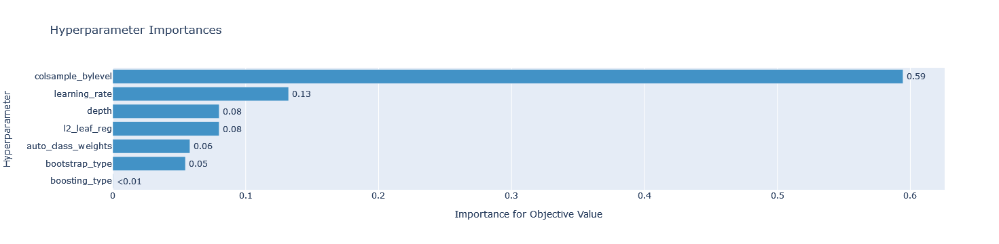

In [141]:
# Visuals
optuna.visualization.plot_param_importances(study)

# Feature Importance
df_f_i = clf.get_feature_importance(prettified=True)
new_features = list(df_f_i[:100]['Feature Id']) # getting top 100 features

##### Submit file (training best model)

In [142]:
params = study.best_trial.params
params['eval_metric'] = 'Accuracy'

X = train.drop(targets, axis=1, errors="ignore")
y = train["category"]

text_features=['text']

xtrain, xvalid, ytrain, yvalid = train_test_split(X, y, 
                                              stratify=y, 
                                              random_state=42, 
                                              test_size=0.1, shuffle=True)

train_pool = Pool(
    xtrain, 
    ytrain, 
    #cat_features=categorical_cols,
    text_features=text_features, #list(xtrain),
    feature_names=list(xtrain)
)           

valid_pool = Pool(
    xvalid, 
    yvalid, 
    #cat_features=categorical_cols,
    text_features=text_features, #list(xtrain),
    feature_names=list(xtrain)
)

clf = CatBoostClassifier(
    **params, thread_count=-1, random_seed=42, text_features=text_features, #cat_features=cat_features
)

clf.fit(
    train_pool,
    eval_set=valid_pool,
    verbose=1,
    plot=False,
    early_stopping_rounds=50,
    #callbacks=[pruning_callback],
) 

0:	learn: 0.1601481	test: 0.1640000	best: 0.1640000 (0)	total: 1.22s	remaining: 20m 21s
1:	learn: 0.1872593	test: 0.1933333	best: 0.1933333 (1)	total: 2.57s	remaining: 21m 23s
2:	learn: 0.2134815	test: 0.2253333	best: 0.2253333 (2)	total: 4.07s	remaining: 22m 31s
3:	learn: 0.3352593	test: 0.3560000	best: 0.3560000 (3)	total: 5.57s	remaining: 23m 7s
4:	learn: 0.3368889	test: 0.3573333	best: 0.3573333 (4)	total: 7.05s	remaining: 23m 22s
5:	learn: 0.3657778	test: 0.3853333	best: 0.3853333 (5)	total: 8.68s	remaining: 23m 57s
6:	learn: 0.3783704	test: 0.3946667	best: 0.3946667 (6)	total: 10.2s	remaining: 24m 5s
7:	learn: 0.3989630	test: 0.4066667	best: 0.4066667 (7)	total: 11.8s	remaining: 24m 25s
8:	learn: 0.4020741	test: 0.4066667	best: 0.4066667 (7)	total: 13.3s	remaining: 24m 27s
9:	learn: 0.4054815	test: 0.4080000	best: 0.4080000 (9)	total: 15s	remaining: 24m 46s
10:	learn: 0.4109630	test: 0.4093333	best: 0.4093333 (10)	total: 16.5s	remaining: 24m 45s
11:	learn: 0.4114074	test: 0.40933

In [145]:
ypred = clf.predict(xvalid)
balanced_accuracy_score(ypred, yvalid)

0.7329919274624564

In [181]:
#test['category'] = clf.predict(test).reshape(1, -1)[0]
#test_preds = test[['category']]

test.to_csv('subs/text_transforming.csv', index=False)

#### **2.1 Sklearn pipelines with TF-IDF + Generated features out of text + maybe embeddings**
- combination of 'generated features' and TF-IDF **DOESNT WORK AS INTENDED** (probably due to what TF-IDF really is)
- sklearn pipeline building
    - added features --- text length, word count, sentence count, capitalization ratio, punctuation count, stopword count, ngrams, pos tagging
    - in ColumnTransforner
        - if passing single column ('text' ~ train['text']) --- don't forget to reshape it after
        - if passing as dataframe (['text'] ~ train[['text']]) --- don't forget to properly apply your functions to it (meaning add 'text' to apply to pd.Series)

In [2]:
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.pipeline import make_union, make_pipeline
from sklearn.preprocessing import FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.base import TransformerMixin, BaseEstimator

from nltk import pos_tag, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

import pymorphy2

def df_transformer(df):
    df_tmp = df.copy()
    df_tmp['text_length'] = df_tmp['text'].apply(len)
    df_tmp['word_count'] = df_tmp['text'].apply(lambda x: len(x.split()))
    df_tmp['capitalization_ratio'] = df_tmp['text'].apply(lambda x: capitalization_ratio_text(x))
    df_tmp['punctuation_count'] = df_tmp['text'].apply(lambda x: stopword_count_text(x))
    df_tmp['stop_word_count'] = df_tmp['text'].apply(lambda x: stopword_count_text(x))
    #df_tmp['ngrams'] = df_tmp['text'].apply(lambda x: extract_ngrams_text(x, 2))
    #df_tmp['pos_tagging_count'] = df_tmp['text'].apply(lambda x: pos_tagging_count_text(x))
    return df_tmp
    
# --------------------------------------------------
def text_length(text_series):
    return text_series.apply(len).values.reshape(-1, 1)

# --------------------------------------------------
# Function to count words
def word_count(text_series):
    return text_series.apply(lambda x: len(x.split())).values.reshape(-1, 1)

# --------------------------------------------------
# Function to count sentences
def sentence_count(text_series):
    return text_series.apply(lambda x: x.count('.')).values.reshape(-1, 1)

# --------------------------------------------------
# Function to calculate capitalization ratio
def capitalization_ratio_text(text):
    words = word_tokenize(text)
    capitalized_words = [word for word in words if word[0].isupper()]
    return len(capitalized_words) / len(words)

def capitalization_ratio(text_series):
    return text_series.apply(lambda x: capitalization_ratio_text(x)).values.reshape(-1, 1)

# --------------------------------------------------
# Function to count punctuation marks
def punctuation_count_text(text):
    punctuation_marks = ['.', ',', '!', '?', ':', ';']
    return sum(text.count(p) for p in punctuation_marks)

def punctuation_count(text_series):
    return text_series.apply(lambda x: punctuation_count_text(x)).values.reshape(-1, 1)
# --------------------------------------------------

# Function to count stopwords
def stopword_count_text(text):
    stop_words = set(stopwords.words('english') + stopwords.words('russian'))
    words = word_tokenize(text)
    stop_words_count = sum(1 for word in words if word.lower() in stop_words)
    return stop_words_count

def stopword_count(text_series):
    return text_series.apply(lambda x: stopword_count_text(x)).values.reshape(-1, 1)

# --------------------------------------------------
# Function to extract n-grams
def extract_ngrams_text(text, n):
    tokens = word_tokenize(text)
    ngrams = []
    for i in range(len(tokens) - n + 1):
        ngrams.append(' '.join(tokens[i:i+n]))
    return ngrams

def extract_ngrams(text_series, n):
    return text_series.apply(lambda x: ' '.join(extract_ngrams_text(x, n))).values.reshape(-1, 1)

# --------------------------------------------------
# Function to perform POS tagging and count POS tags
def pos_tagging_count_text(text):
    pos_tags = pos_tag(word_tokenize(text))
    tag_counts = {}
    for tag in pos_tags:
        if tag[1] not in tag_counts:
            tag_counts[tag[1]] = 1
        else:
            tag_counts[tag[1]] += 1
    return tag_counts

def pos_tagging_count(text_series):
    return text_series.apply(lambda x: pos_tagging_count_text(x)).values.reshape(-1, 1)

import pymorphy2
import numpy as np
from sklearn.base import TransformerMixin, BaseEstimator
from nltk.tokenize import word_tokenize

# --------------------------------------------------

class TextTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.stop_words_list = stopwords.words('english') + stopwords.words('russian')
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text)
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.lemmatizer.parse(w)[0].normal_form for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        return np.array(transformed_X).reshape(-1, 1)

# --------------------------------------------------

# # Function to perform NER and count named entities
# def ner_count(text):
#     # Perform NER here and count named entities
#     named_entities = {'PERSON': 2, 'ORGANIZATION': 1, 'LOCATION': 1}
#     return named_entities

# --------------------------------------------------



In [3]:
import numpy as np
import pandas as pd
from sklearn import preprocessing
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split

import optuna

from catboost import CatBoostClassifier, Pool
from optuna.integration import CatBoostPruningCallback

stopwords = stopwords.words('russian') + ['другои', 'еи', 'какои', 'мои', 'неи', 'сеичас', 'такои', 'этои']
from nltk.corpus import stopwords
from sklearn.base import TransformerMixin, BaseEstimator
from nltk import word_tokenize
class TextTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.stop_words_list = stopwords
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text)
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.lemmatizer.parse(w)[0].normal_form for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        return np.array(transformed_X).reshape(-1, 1)

    
train = pd.read_csv("data/text_classification_train.csv")
test = pd.read_csv("data/text_classification_test.csv")

cat_features = []  
text_features = ['text']
targets = ["category"]

# text_transformer = TextTransformer()
# train['normalized_text'] = text_transformer.fit_transform(train['text']).reshape(-1,1)
# test['normalized_text'] = text_transformer.transform(test['text']).reshape(-1,1)


# ruBert base - train.columns[2:770] [] - 768 total
# ruBert tiny - train.columns[771:1082] - 311 total
# rubert-base-cased - train.columns[1082:1850] - 768 total
# labse - train.columns[1850:2618] - 768 total
embeddings2save = []#, 'rubert_base', ]#, 'rubert_base_cased', 'labse']
embeddings = {'rubert_base': train.columns[2:770], 'rubert_tiny': train.columns[770:1082], 'rubert_base_cased': train.columns[1082:1850], 'labse': train.columns[1850:2618]}
embeddings2drop = [i for i in embeddings if not i in embeddings2save]
features2drop = []
for i in embeddings2drop:
    features2drop += list(embeddings[i])

    
    
# adding some new features using 2.1
train = df_transformer(train)
test = df_transformer(test)
    
filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features + text_features]

train = train[filtered_features + targets]
test = test[filtered_features]

X = train.drop(targets, axis=1, errors="ignore")
y = train["category"]

lbl_enc = preprocessing.LabelEncoder()
y = lbl_enc.fit_transform(train.category.values)

xtrain, xvalid, ytrain, yvalid = train_test_split(X, y, 
                                              stratify=y, 
                                              random_state=42, 
                                              test_size=0.1, shuffle=True)

In [4]:
# NON VALID SKlearn pipeline

embeddings2save = []
embeddings2save_list = []
for i in embeddings2save:
    embeddings2save_list += list(embeddings[i])

# Define feature extraction pipeline
feature_extraction = ColumnTransformer(
    transformers=[
        #('text_infinitive', TextTransformer(), 'text'),
        ('text_length', FunctionTransformer(text_length, validate=False), 'text'),
        ('word_count', FunctionTransformer(word_count, validate=False), 'text'),
        ('sentence_count', FunctionTransformer(sentence_count, validate=False), 'text'),
        ('capitalization_ratio', FunctionTransformer(capitalization_ratio, validate=False), 'text'),
        ('punctuation_count', FunctionTransformer(punctuation_count, validate=False), 'text'),
        ('stopword_count', FunctionTransformer(stopword_count, validate=False), 'text'),
        #('ngrams', FunctionTransformer(extract_ngrams, validate=False, kw_args={'n': 2}), 'text'),
        #('pos_tagging', FunctionTransformer(pos_tagging_count, validate=False), 'text'),
        #('ner_count', FunctionTransformer(ner_count, validate=False), 'text'),
        #('embeddings', 'passthrough', embeddings2save_list),  # Column index of the embeddings feature
    ])

# Define TF-IDF vectorizer
tfidf = TfidfVectorizer(min_df=3, max_features=None,
                        strip_accents='unicode', analyzer='word',
                        token_pattern=r'\w{1,}', ngram_range=(1, 3),
                        use_idf=1, smooth_idf=1, sublinear_tf=1,
                        stop_words=stopwords.words('russian') + stopwords.words('english'))

##### SVM 

In [94]:
from sklearn.pipeline import FeatureUnion

select_text = FunctionTransformer(lambda x: x['text'], validate=False)

combined_features = FeatureUnion([
    ('tfidf', Pipeline([
        ('selector', select_text),
        ('tfidf', tfidf)
    ])),
    ('existing_features', feature_extraction)
])

# ----------------------------------------

from sklearn.svm import SVC

clf = Pipeline([
    ('features', combined_features),
    ('classifier', SVC(C=1.0, probability=True))  # Example classifier, you can use any other classifier
])

# training
clf.fit(xtrain, ytrain)

print('balanced accuracy score:', round(balanced_accuracy_score(clf.predict(xvalid), yvalid), 4))

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\utils\_param_validation.py:558: FutureWarning: Passing an int for a boolean parameter is deprecated in version 1.2 and won't be supported anymore in version 1.4.
  warnings.warn(


balanced accuracy score: 0.7898


In [95]:
test['category'] = lbl_enc.inverse_transform(clf.predict(test))
test = test[['category']]

test.to_csv('subs/text_transforming.csv', index=False)

##### catboost ???

In [ ]:
from catboost import CatBoostClassifier, Pool

# Assuming df is the preprocessed DataFrame
feature_types = {
    'ngrams': 'Categorical',
    'pos_tagging_count': 'Categorical',
    'text_length': 'Numerical',
    'word_count': 'Numerical',
    'capitalization_ratio': 'Numerical',
    'punctuation_count': 'Numerical',
    'stop_word_count': 'Numerical'
}

# Create a Pool object with feature types
pool = Pool(data=df, feature_names=df.columns, feature_types=feature_types)

# Train the CatBoost classifier
model = CatBoostClassifier()
model.fit(pool, y)

#### **3. StackingClassifier**
- 0.7848 balanced (SVM + MLP + Random Forest)

In [5]:
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.pipeline import make_union, make_pipeline
from sklearn.preprocessing import FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.base import TransformerMixin, BaseEstimator

from nltk import pos_tag, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

import pymorphy2

def df_transformer(df):
    df_tmp = df.copy()
    df_tmp['text_length'] = df_tmp['text'].apply(len)
    df_tmp['word_count'] = df_tmp['text'].apply(lambda x: len(x.split()))
    df_tmp['capitalization_ratio'] = df_tmp['text'].apply(lambda x: capitalization_ratio_text(x))
    df_tmp['punctuation_count'] = df_tmp['text'].apply(lambda x: stopword_count_text(x))
    df_tmp['stop_word_count'] = df_tmp['text'].apply(lambda x: stopword_count_text(x))
    #df_tmp['ngrams'] = df_tmp['text'].apply(lambda x: extract_ngrams_text(x, 2))
    #df_tmp['pos_tagging_count'] = df_tmp['text'].apply(lambda x: pos_tagging_count_text(x))
    return df_tmp
    
# --------------------------------------------------
def text_length(text_series):
    return text_series.apply(len).values.reshape(-1, 1)

# --------------------------------------------------
# Function to count words
def word_count(text_series):
    return text_series.apply(lambda x: len(x.split())).values.reshape(-1, 1)

# --------------------------------------------------
# Function to count sentences
def sentence_count(text_series):
    return text_series.apply(lambda x: x.count('.')).values.reshape(-1, 1)

# --------------------------------------------------
# Function to calculate capitalization ratio
def capitalization_ratio_text(text):
    words = word_tokenize(text)
    capitalized_words = [word for word in words if word[0].isupper()]
    return len(capitalized_words) / len(words)

def capitalization_ratio(text_series):
    return text_series.apply(lambda x: capitalization_ratio_text(x)).values.reshape(-1, 1)

# --------------------------------------------------
# Function to count punctuation marks
def punctuation_count_text(text):
    punctuation_marks = ['.', ',', '!', '?', ':', ';']
    return sum(text.count(p) for p in punctuation_marks)

def punctuation_count(text_series):
    return text_series.apply(lambda x: punctuation_count_text(x)).values.reshape(-1, 1)
# --------------------------------------------------

# Function to count stopwords
def stopword_count_text(text):
    stop_words = set(stopwords.words('english') + stopwords.words('russian'))
    words = word_tokenize(text)
    stop_words_count = sum(1 for word in words if word.lower() in stop_words)
    return stop_words_count

def stopword_count(text_series):
    return text_series.apply(lambda x: stopword_count_text(x)).values.reshape(-1, 1)

# --------------------------------------------------
# Function to extract n-grams
def extract_ngrams_text(text, n):
    tokens = word_tokenize(text)
    ngrams = []
    for i in range(len(tokens) - n + 1):
        ngrams.append(' '.join(tokens[i:i+n]))
    return ngrams

def extract_ngrams(text_series, n):
    return text_series.apply(lambda x: ' '.join(extract_ngrams_text(x, n))).values.reshape(-1, 1)

# --------------------------------------------------
# Function to perform POS tagging and count POS tags
def pos_tagging_count_text(text):
    pos_tags = pos_tag(word_tokenize(text))
    tag_counts = {}
    for tag in pos_tags:
        if tag[1] not in tag_counts:
            tag_counts[tag[1]] = 1
        else:
            tag_counts[tag[1]] += 1
    return tag_counts

def pos_tagging_count(text_series):
    return text_series.apply(lambda x: pos_tagging_count_text(x)).values.reshape(-1, 1)

import pymorphy2
import numpy as np
from sklearn.base import TransformerMixin, BaseEstimator
from nltk.tokenize import word_tokenize

# --------------------------------------------------

class TextTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.stop_words_list = stopwords.words('english') + stopwords.words('russian')
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text)
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.lemmatizer.parse(w)[0].normal_form for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        return np.array(transformed_X).reshape(-1, 1)

# --------------------------------------------------

# # Function to perform NER and count named entities
# def ner_count(text):
#     # Perform NER here and count named entities
#     named_entities = {'PERSON': 2, 'ORGANIZATION': 1, 'LOCATION': 1}
#     return named_entities

# --------------------------------------------------


def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))

    for col in df.columns:
        col_type = df[col].dtype.name

        if col_type not in ['object', 'category', 'datetime64[ns, UTC]']:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))

    return df

In [6]:
%%time
import numpy as np
import pandas as pd
from sklearn import preprocessing
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split

import optuna

from catboost import CatBoostClassifier, Pool
from optuna.integration import CatBoostPruningCallback

from nltk.corpus import stopwords
from sklearn.base import TransformerMixin, BaseEstimator
from nltk import word_tokenize

stopwords_list = stopwords.words('russian') + ['другои', 'еи', 'какои', 'мои', 'неи', 'сеичас', 'такои', 'этои']
class TextTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.stop_words_list = stopwords_list
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text)
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.lemmatizer.parse(w)[0].normal_form for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        return np.array(transformed_X).reshape(-1, 1)

    
train = pd.read_csv("data/text_classification_train.csv")
test = pd.read_csv("data/text_classification_test.csv")

cat_features = []  
text_features = ['text']
targets = ["category"]

# text_transformer = TextTransformer()
# train['normalized_text'] = text_transformer.fit_transform(train['text']).reshape(-1,1)
# test['normalized_text'] = text_transformer.transform(test['text']).reshape(-1,1)


# ruBert base - train.columns[2:770] [] - 768 total
# ruBert tiny - train.columns[771:1082] - 311 total
# rubert-base-cased - train.columns[1082:1850] - 768 total
# labse - train.columns[1850:2618] - 768 total
embeddings2save = []#, 'rubert_base', ]#, 'rubert_base_cased', 'labse']
embeddings = {'rubert_base': train.columns[2:770], 'rubert_tiny': train.columns[770:1082], 'rubert_base_cased': train.columns[1082:1850], 'labse': train.columns[1850:2618]}
embeddings2drop = [i for i in embeddings if not i in embeddings2save]
features2drop = []
for i in embeddings2drop:
    features2drop += list(embeddings[i])

    
    
# adding some new features using 2.1
train = df_transformer(train)
test = df_transformer(test)
    
filtered_features = [i for i in train.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features + text_features]

train = train[filtered_features + targets]
test = test[filtered_features]

train = reduce_mem_usage(train)
test = reduce_mem_usage(test)

Memory usage of dataframe is 0.40 MB
Memory usage after optimization is: 0.19 MB
Decreased by 53.6%
Memory usage of dataframe is 0.11 MB
Memory usage after optimization is: 0.04 MB
Decreased by 62.4%
CPU times: total: 18.9 s
Wall time: 19 s


##### 1) **Using sklearn pipelines**
- don't use 'verbose=True' for StackingClassifier (some problems with outputs --- no algorithm outputs then)

In [7]:
# Вспомогательные блоки организации для пайплайна
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_selector

# Вспомогательные элементы для наполнения пайплайна
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder, MinMaxScaler

# Некоторые модели для построение ансамбля
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import LinearSVC

# Добавим визуализации
import sklearn
sklearn.set_config(display='diagram')

from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)


tfidf = TfidfVectorizer(min_df=3, max_features=None,
                        strip_accents='unicode', analyzer='word',
                        token_pattern=r'\w{1,}', ngram_range=(1, 3),
                        use_idf=1, smooth_idf=1, sublinear_tf=1,
                        stop_words=stopwords_list)

# Textual transformer TF-IDF
select_text = FunctionTransformer(lambda x: x['text'], validate=False)

text_transformer = Pipeline(steps=[
        ('selector', select_text),
        ('tfidf', tfidf),
])

# Numerical transformer
numerical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer()),
    ("scaler", StandardScaler())
])


preprocessor = ColumnTransformer(transformers=[
    ("textual", text_transformer, text_features),
    ("numerical", numerical_transformer, num_features),
])

preprocessor

ColumnTransformer(transformers=[('textual',
                                 Pipeline(steps=[('selector',
                                                  FunctionTransformer(func=<function <lambda> at 0x000001A60DC243A0>)),
                                                 ('tfidf',
                                                  TfidfVectorizer(min_df=3,
                                                                  ngram_range=(1,
                                                                               3),
                                                                  smooth_idf=1,
                                                                  stop_words=['и',
                                                                              'в',
                                                                              'во',
                                                                              'не',
                                                                              'что',
                                                                              'он',
                                                                              'на',
                                                                              'я',
                                                                              'с',
                                                                              'со',
                                                                              'как',
                                                                              'а',
                                                                              'то',
                                                                              'все',
                                                                              'она',
                                                                              'так',
                                                                              'его',
                                                                              'но',
                                                                              'да',
                                                                              'ты',
                                                                              'к',
                                                                              'у',
                                                                              'же',
                                                                              'вы',
                                                                              'за',
                                                                              'бы',
                                                                              'по',
                                                                              'только',
                                                                              'ее',
                                                                              'мне', ...],
                                                                  strip_accents='unicode',
                                                                  sublinear_tf=1,
                                                                  token_pattern='\\w{1,}',
                                                                  use_idf=1))]),
                                 ['text']),
                                ('numerical',
                                 Pipeline(steps=[('imputer', SimpleImputer()),
                                                 ('scaler', StandardScaler())]),
                                 ['text_length', 'word_count',
                                  'capitalization_ratio', 'punctuation_count',
                                  'stop_word_count'])])

In [8]:
import lightgbm as lgbm
import xgboost as xgb
import catboost as cb

params_lgbm = {
    "num_leaves": 200,
    "n_estimators": 1500,
    # "max_depth": 7,
    "min_child_samples": None,
    "learning_rate": 0.001,
    "min_data_in_leaf": 5,
    "feature_fraction": 0.98,
    # "categorical_feature": cat_cols,
    'reg_alpha' : 3.0,
    'reg_lambda' : 5.0,
}

lgbm_model = lgbm.LGBMClassifier(**params_lgbm)




params_xgb = {
    "eta": 0.05,
    'n_estimators' : 1500,
    "max_depth": 6,
    "subsample": 0.7,
    # "colsample_bytree": 0.95,
    'min_child_weight' : 0.1,
    'gamma': .01,
    'reg_lambda' : 0.1,
    'reg_alpha' : 0.5,
    "objective": "reg:linear",
    "eval_metric": "mae",
    'tree_method' : 'hist', # Supported tree methods for cat fs are `gpu_hist`, `approx`, and `hist`.
    'enable_categorical' : False
    
}

xgb_model = xgb.XGBClassifier(**params_xgb)




params_cat = {
             'n_estimators' : 700,
              # 'learning_rate': .03,
              'depth' : 3,
              'verbose': False,
              'use_best_model': True,
              #'cat_features' : categorical_features,
              'text_features': text_features,
              # 'train_dir' : '/home/jovyan/work/catboost',
              'border_count' : 64,
              'l2_leaf_reg' : 1,
              'bagging_temperature' : 2,
              'rsm' : 0.51,
              'loss_function': 'MultiClass',
              'auto_class_weights' : 'Balanced', #try not balanced
              'random_state': 42,
              'use_best_model': False,
              # 'custom_metric' : ['AUC', 'MAP'] # Не работает внутри Sklearn.Pipelines
         }

cat_model = cb.CatBoostClassifier(**params_cat)

In [9]:
# список базовых моделей
verbose_condition = True

estimators = [
    
    
    # ("ExtraTrees",  make_pipeline(preprocessor, ExtraTreesClassifier(n_estimators = 10_000, max_depth = 6, min_samples_leaf = 2, 
    #                                                           bootstrap = True, class_weight = 'balanced', # ccp_alpha = 0.001, 
    #                                                           random_state = 75, verbose=verbose_condition, n_jobs=-1,))),
    

    # ("XGBoost", xgb_model),
    # ("LightGBM", lgbm_model),
    ("CatBoost", cat_model),
    

    ("SVM", make_pipeline(preprocessor, LinearSVC(verbose=verbose_condition))),
    # ("MLP", make_pipeline(preprocessor, MLPClassifier(verbose=verbose_condition, hidden_layer_sizes=(100, 30, ), alpha=0.001,random_state=75, max_iter = 1300, early_stopping=100))),
    ("Random_forest",  make_pipeline(preprocessor, RandomForestClassifier(n_estimators = 15_000, max_depth = 7, 
                                                              min_samples_leaf = 2,
                                                              warm_start = True, n_jobs=-1,
                                                              random_state = 75, verbose=verbose_condition))),
    
    
    
]

# в качестве мета-модели будем использовать LogisticRegression
meta_model = StackingClassifier(
    estimators=estimators,
    final_estimator=LogisticRegression(verbose=verbose_condition),
    # final_estimator=RandomForestClassifier(n_estimators = 10_000, 
                                           # max_depth = 5,
                                           # verbose=verbose_condition),
    n_jobs=-1,
    verbose=verbose_condition,
)

stacking_classifier = meta_model
stacking_classifier

StackingClassifier(estimators=[('CatBoost',
                                <catboost.core.CatBoostClassifier object at 0x000001A60BDAC460>),
                               ('SVM',
                                Pipeline(steps=[('columntransformer',
                                                 ColumnTransformer(transformers=[('textual',
                                                                                  Pipeline(steps=[('selector',
                                                                                                   FunctionTransformer(func=<function <lambda> at 0x000001A60DC243A0>)),
                                                                                                  ('tfidf',
                                                                                                   TfidfVectorizer(min_df=3,
                                                                                                                   ngram_range=(1,
                                                                                                                                3),
                                                                                                                   smooth_idf=1...
                                                                                                  ('scaler',
                                                                                                   StandardScaler())]),
                                                                                  ['text_length',
                                                                                   'word_count',
                                                                                   'capitalization_ratio',
                                                                                   'punctuation_count',
                                                                                   'stop_word_count'])])),
                                                ('randomforestclassifier',
                                                 RandomForestClassifier(max_depth=7,
                                                                        min_samples_leaf=2,
                                                                        n_estimators=15000,
                                                                        n_jobs=-1,
                                                                        random_state=75,
                                                                        verbose=True,
                                                                        warm_start=True))]))],
                   final_estimator=LogisticRegression(verbose=True), n_jobs=-1,
                   verbose=True)

In [ ]:
%%time

X = train.drop(targets, axis=1, errors="ignore")

lbl_enc = preprocessing.LabelEncoder()
y = lbl_enc.fit_transform(train.category.values)

xtrain, xvalid, ytrain, yvalid = train_test_split(X, y, 
                                              stratify=y, 
                                              random_state=42, 
                                              test_size=0.1, shuffle=True)

stacking_classifier.fit(xtrain, ytrain)

In [25]:
print('ensemble score:', round(balanced_accuracy_score(stacking_classifier.predict(xvalid), yvalid), 4))

[Parallel(n_jobs=12)]: Using backend ThreadingBackend with 12 concurrent workers.
[Parallel(n_jobs=12)]: Done  26 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 176 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 426 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 776 tasks      | elapsed:    0.0s
[Parallel(n_jobs=12)]: Done 1226 tasks      | elapsed:    0.1s
[Parallel(n_jobs=12)]: Done 1776 tasks      | elapsed:    0.1s
[Parallel(n_jobs=12)]: Done 2426 tasks      | elapsed:    0.2s
[Parallel(n_jobs=12)]: Done 3176 tasks      | elapsed:    0.3s
[Parallel(n_jobs=12)]: Done 4026 tasks      | elapsed:    0.4s
[Parallel(n_jobs=12)]: Done 4976 tasks      | elapsed:    0.5s
[Parallel(n_jobs=12)]: Done 6026 tasks      | elapsed:    0.7s
[Parallel(n_jobs=12)]: Done 7176 tasks      | elapsed:    0.8s
[Parallel(n_jobs=12)]: Done 8426 tasks      | elapsed:    1.0s
[Parallel(n_jobs=12)]: Done 9776 tasks      | elapsed:    1.1s
[Parallel(n_jobs=12)]: Done 11226 tasks 

ensemble score: 0.7973


[Parallel(n_jobs=12)]: Done 14426 tasks      | elapsed:    1.7s
[Parallel(n_jobs=12)]: Done 15000 out of 15000 | elapsed:    1.8s finished


In [101]:
corr_df = pd.DataFrame()

for model, (name, _) in zip(stacking_classifier.estimators_, stacking_classifier.estimators):
    print(name, 'accuracy: ', round(balanced_accuracy_score(model.predict(xvalid), yvalid), 4))
    #preprocessed = stacking_classifier.estimators[0][1].steps[0][1].fit(xtrain, ytrain).transform(xvalid)
    if name == 'CatBoost':
        corr_df[name] = model.predict(xvalid).reshape(1,-1)[0]
    else:
        corr_df[name] = model.predict(xvalid)
    

CatBoost accuracy:  0.7228
SVM accuracy:  0.789


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    0.5s
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 4034 tasks      | elapsed:    0.9s
[Parallel(n_jobs=8)]: Done 4984 tasks      | elapsed:    1.2s
[Parallel(n_jobs=8)]: Done 6034 tasks      | elapsed:    1.5s
[Parallel(n_jobs=8)]: Done 7184 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done 8434 tasks      | elapsed:    2.1s
[Parallel(n_jobs=8)]: Done 9784 tasks      | elapsed:    2.5s
[Parallel(n_jobs=8)]: Done 11234 tasks      | elapsed:  

Random_forest accuracy:  0.7324


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 434 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 784 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 1234 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 1784 tasks      | elapsed:    0.4s
[Parallel(n_jobs=8)]: Done 2434 tasks      | elapsed:    0.6s
[Parallel(n_jobs=8)]: Done 3184 tasks      | elapsed:    0.8s
[Parallel(n_jobs=8)]: Done 4034 tasks      | elapsed:    1.1s
[Parallel(n_jobs=8)]: Done 4984 tasks      | elapsed:    1.3s
[Parallel(n_jobs=8)]: Done 6034 tasks      | elapsed:    1.6s
[Parallel(n_jobs=8)]: Done 7184 tasks      | elapsed:    1.9s
[Parallel(n_jobs=8)]: Done 8434 tasks      | elapsed:    2.2s
[Parallel(n_jobs=8)]: Done 9784 tasks      | elapsed:    2.5s
[Parallel(n_jobs=8)]: Done 11234 tasks      | elapsed:  

In [102]:
corr_df.corr()

,CatBoost,SVM,Random_forest
CatBoost,1.000,0.798,0.571
SVM,0.798,1.000,0.607
Random_forest,0.571,0.607,1.000


In [ ]:
test_to_submit = test.copy()
test_to_submit['category'] = lbl_enc.inverse_transform(stacking_classifier.predict(test))
test_to_submit = test_to_submit[['category']]

test_to_submit.to_csv('subs/text_transforming.csv', index=False)

##### 2) [OPTIONAL] **Custom building for better speed**
- some problems with BLENDER class (working but not for all algorithms)
- didn't add any speed to it YET - but that's how it should be done

In [20]:
class Blender:
    def __init__(self, base_models, meta_model):
        self.base_models = base_models
        self.meta_model = meta_model
        
    def fit(self, X_train, y_train, X_hold, y_hold):
        final_features = np.zeros((X_hold.shape[0], 0))
        for model in self.base_models:
            model.fit(X_train, y_train)
            preds = model.predict(X_hold).reshape(-1, 1)
            final_features = np.concatenate([final_features, preds], axis=1)
        
        self.meta_model.fit(final_features, y_hold)
    
    def predict(self, X_test):
        final_features = np.zeros((X_test.shape[0], 0))
        for model in self.base_models:
            preds = model.predict(X_test).reshape(-1, 1)
            final_features = np.concatenate([final_features, preds], axis=1)
        
        return self.meta_model.predict(final_features)

    
# Вспомогательные блоки организации для пайплайна
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_selector

# Вспомогательные элементы для наполнения пайплайна
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder, MinMaxScaler

# Некоторые модели для построение ансамбля
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import LinearSVC

# Добавим визуализации
import sklearn
sklearn.set_config(display='diagram')

from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)


tfidf = TfidfVectorizer(min_df=3, max_features=None,
                        strip_accents='unicode', analyzer='word',
                        token_pattern=r'\w{1,}', ngram_range=(1, 3),
                        use_idf=1, smooth_idf=1, sublinear_tf=1,
                        stop_words=stopwords_list)

# Textual transformer TF-IDF
select_text = FunctionTransformer(lambda x: x['text'], validate=False)

text_transformer = Pipeline(steps=[
        ('selector', select_text),
        ('tfidf', tfidf),
])

# Numerical transformer
numerical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer()),
    ("scaler", StandardScaler())
])


preprocessor = ColumnTransformer(transformers=[
    ("textual", text_transformer, text_features),
    ("numerical", numerical_transformer, num_features),
])


X = train.drop(targets, axis=1, errors="ignore")
lbl_enc = preprocessing.LabelEncoder()
y = lbl_enc.fit_transform(train.category.values)

xtrain, xvalid, ytrain, yvalid = train_test_split(X, y, 
                                              stratify=y, 
                                              random_state=42, 
                                              test_size=0.1, shuffle=True)

xtrain_tf = preprocessor.fit_transform(xtrain)
xvalid_tf = preprocessor.transform(xtrain)

preprocessor

ColumnTransformer(transformers=[('textual',
                                 Pipeline(steps=[('selector',
                                                  FunctionTransformer(func=<function <lambda> at 0x00000276FC367550>)),
                                                 ('tfidf',
                                                  TfidfVectorizer(min_df=3,
                                                                  ngram_range=(1,
                                                                               3),
                                                                  smooth_idf=1,
                                                                  stop_words=['и',
                                                                              'в',
                                                                              'во',
                                                                              'не',
                                                                              'что',
                                                                              'он',
                                                                              'на',
                                                                              'я',
                                                                              'с',
                                                                              'со',
                                                                              'как',
                                                                              'а',
                                                                              'то',
                                                                              'все',
                                                                              'она',
                                                                              'так',
                                                                              'его',
                                                                              'но',
                                                                              'да',
                                                                              'ты',
                                                                              'к',
                                                                              'у',
                                                                              'же',
                                                                              'вы',
                                                                              'за',
                                                                              'бы',
                                                                              'по',
                                                                              'только',
                                                                              'ее',
                                                                              'мне', ...],
                                                                  strip_accents='unicode',
                                                                  sublinear_tf=1,
                                                                  token_pattern='\\w{1,}',
                                                                  use_idf=1))]),
                                 ['text']),
                                ('numerical',
                                 Pipeline(steps=[('imputer', SimpleImputer()),
                                                 ('scaler', StandardScaler())]),
                                 ['text_length', 'word_count',
                                  'capitalization_ratio', 'punctuation_count',
                                  'stop_word_count'])])

In [29]:
verbose_condition = True

base_models = [
    MLPClassifier(verbose=verbose_condition, hidden_layer_sizes=(100, 30, ), alpha=0.001,random_state=75, max_iter = 1300, early_stopping=100,),
    # RandomForestClassifier(n_estimators = 15_000, max_depth = 7, 
    #                                                       min_samples_leaf = 2,
    #                                                       warm_start = True, n_jobs=-1,
    #                                                       random_state = 75, verbose=verbose_condition),
    #LassoCV(), 
    #SVR()
]

meta_model = LogisticRegression(verbose=verbose_condition)
Stacking_class = Blender(base_models, meta_model)

In [30]:
Stacking_class.fit(xtrain_tf, ytrain, xvalid_tf, yvalid)

Iteration 1, loss = 2.54632049
Validation score: 0.327407
Iteration 2, loss = 2.26483668
Validation score: 0.562963
Iteration 3, loss = 1.71937652
Validation score: 0.720000
Iteration 4, loss = 1.09380480
Validation score: 0.777778
Iteration 5, loss = 0.61784366
Validation score: 0.797037
Iteration 6, loss = 0.34459592
Validation score: 0.792593
Iteration 7, loss = 0.20379392
Validation score: 0.802963
Iteration 8, loss = 0.12902604
Validation score: 0.804444
Iteration 9, loss = 0.09015895
Validation score: 0.801481


C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:693: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


ValueError: Found input variables with inconsistent numbers of samples: [6750, 750]

#### **4. [OLD] Feature Selection among +2000**
1. train shape = (7500, 2618)
    - too much for training ---> need to narrow it down (lets take 1500 - 20%)
2. Training model (on 20% with 80/20 split Train/Test)
3. Now 'Selecting Features' 
    - using 'get_feature_importance' 

In [30]:
y = train['category']
X_train = train.drop(['category', 'text'], axis=1)

# saving 10% for quick feature selection
X_train, X_test, y_train, y_test = train_test_split(X_train, y, test_size=0.8, stratify=y)
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train)

train_pool = Pool(X_train, y_train)
test_pool = Pool(X_test, y_test)

clf = CatBoostClassifier(iterations=100,
                         thread_count=-1,
                         random_seed=42,
                         eval_metric='Accuracy',)

clf.fit(
    train_pool,
    eval_set=test_pool,
    verbose=5,
    use_best_model=True,
    plot=False,
    early_stopping_rounds=100,
)


Learning rate set to 0.261163
0:	learn: 0.2233333	test: 0.1333333	best: 0.1333333 (0)	total: 5.96s	remaining: 9m 50s
5:	learn: 0.5600000	test: 0.2833333	best: 0.2833333 (5)	total: 42.8s	remaining: 11m 10s
10:	learn: 0.7216667	test: 0.2866667	best: 0.2866667 (10)	total: 1m 20s	remaining: 10m 52s
15:	learn: 0.8200000	test: 0.3600000	best: 0.3600000 (15)	total: 2m 1s	remaining: 10m 35s
20:	learn: 0.8841667	test: 0.3866667	best: 0.3866667 (20)	total: 2m 41s	remaining: 10m 7s
25:	learn: 0.9116667	test: 0.4000000	best: 0.4000000 (25)	total: 3m 21s	remaining: 9m 34s
30:	learn: 0.9475000	test: 0.4300000	best: 0.4300000 (30)	total: 4m	remaining: 8m 55s
35:	learn: 0.9583333	test: 0.4666667	best: 0.4666667 (35)	total: 4m 38s	remaining: 8m 15s
40:	learn: 0.9700000	test: 0.4700000	best: 0.4700000 (40)	total: 5m 19s	remaining: 7m 39s
45:	learn: 0.9791667	test: 0.4633333	best: 0.4733333 (41)	total: 6m	remaining: 7m 2s
50:	learn: 0.9816667	test: 0.4900000	best: 0.4900000 (50)	total: 6m 40s	remaining: 

In [35]:
df_f_i = clf.get_feature_importance(prettified=True)

In [47]:
#new_features = list(df_f_i[df_f_i.Importances >= 0.05]['Feature Id'])
new_features = list(df_f_i[:100]['Feature Id'])

In [48]:
train_pool = Pool(X_train[new_features], y_train)
test_pool = Pool(X_test[new_features], y_test)

clf = CatBoostClassifier(iterations=300,
                         thread_count=-1,
                         random_seed=42,
                         eval_metric='Accuracy',)

clf.fit(
    train_pool,
    eval_set=test_pool,
    verbose=5,
    use_best_model=True,
    plot=False,
    early_stopping_rounds=20,
)

Learning rate set to 0.171653
0:	learn: 0.2550000	test: 0.1233333	best: 0.1233333 (0)	total: 241ms	remaining: 1m 12s
5:	learn: 0.5525000	test: 0.2833333	best: 0.2833333 (5)	total: 1.5s	remaining: 1m 13s
10:	learn: 0.7025000	test: 0.3266667	best: 0.3566667 (9)	total: 2.75s	remaining: 1m 12s
15:	learn: 0.7816667	test: 0.3400000	best: 0.3566667 (9)	total: 4.04s	remaining: 1m 11s
20:	learn: 0.8375000	test: 0.3633333	best: 0.3733333 (18)	total: 5.35s	remaining: 1m 11s
25:	learn: 0.8741667	test: 0.3800000	best: 0.3800000 (25)	total: 6.75s	remaining: 1m 11s
30:	learn: 0.9000000	test: 0.4100000	best: 0.4100000 (29)	total: 8.17s	remaining: 1m 10s
35:	learn: 0.9216667	test: 0.4400000	best: 0.4400000 (35)	total: 9.53s	remaining: 1m 9s
40:	learn: 0.9333333	test: 0.4266667	best: 0.4400000 (35)	total: 11s	remaining: 1m 9s
45:	learn: 0.9525000	test: 0.4433333	best: 0.4433333 (45)	total: 12.3s	remaining: 1m 8s
50:	learn: 0.9650000	test: 0.4633333	best: 0.4733333 (48)	total: 13.7s	remaining: 1m 6s
55:	

#### **-) [TRASH] CV implementation of Optuna**

In [ ]:
from optuna.integration import CatBoostPruningCallback

def fit_catboost(trial, train, val):
    X_train, y_train = train
    X_val, y_val = val

    param = {
        'iterations' : 400, # Можно не перебирать, есть Easrly-Stopping
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.01),
        "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 2, 50),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.8),
        
        "auto_class_weights": trial.suggest_categorical("auto_class_weights", ["SqrtBalanced", "Balanced", "None"]),
        "depth": trial.suggest_int("depth", 3, 9),
        
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]),
        "used_ram_limit": "14gb",
        "eval_metric": "Accuracy", # Тоже стоит заранее определиться
    }

    
    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 20)
        
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)
        

    clf = CatBoostClassifier(
        **param,
        thread_count=-1,
        random_seed=42,
        cat_features=cat_features,
    )

    clf.fit(
        X_train,
        y_train,
        eval_set=(X_val, y_val),
        verbose=0,
        plot=False,
        early_stopping_rounds=5,
    )

    y_pred = clf.predict(X_val)
    return clf, y_pred

In [ ]:
def objective(trial, return_models=False):
    
    n_splits = 3
    kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    
    X_train = train[filtered_features].drop(targets, axis=1, errors="ignore")
    y_train = train['category']

    scores, models = [], []
    
    for train_idx, valid_idx in kf.split(X=X_train, y=train['category']):
        train_data = X_train.iloc[train_idx, :], y_train[train_idx]
        valid_data = X_train.iloc[valid_idx, :], y_train[valid_idx]

        # Подаем trials для перебора
        model, y_pred = fit_catboost(trial, train_data, valid_data) # Определили выше
        scores.append(balanced_accuracy_score(y_pred, valid_data[1]))
        models.append(model)
        break
         

    result = np.mean(scores)
    
    if return_models:
        return result, models
    else:
        return result

___
# <font color='pink'> 6.3 🚬🚬 **Sklearn pipelines** -- Auto Blending + Stacking</font>
1. **made for quick deployment + elegance of code for a job**
2. **has lot of problems** when it comes to 'pushing everything out of model' (early stopping, tuning, feature selection, etc.)
    - it's better to try manually first --- then use pipelines for the final version
    
- [article about Stacking & Blending (RU)](https://alexanderdyakonov.wordpress.com/2017/03/10/c%D1%82%D0%B5%D0%BA%D0%B8%D0%BD%D0%B3-stacking-%D0%B8-%D0%B1%D0%BB%D0%B5%D0%BD%D0%B4%D0%B8%D0%BD%D0%B3-blending/)
- [YouTube video from Yandex using LightGBM as meta-model](https://www.youtube.com/watch?v=aMlpeDOjib8&ab_channel=ODSAIRu)

## Code Example of using Sklearn pipelines

### 1. Loading Data + Encoding (category features & target for LightGBM)

In [3]:
import numpy as np
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn import preprocessing

import lightgbm as lgbm
import xgboost as xgb
import catboost as cb

import warnings
warnings.filterwarnings("ignore")



data = pd.read_csv('tmp_data/quickstart_train.csv')

categorical_features = ['model', 'car_type', 'fuel_type']

# encoding for LightGBM 
for cat in categorical_features:
    lbl = preprocessing.LabelEncoder()
    data[cat] = lbl.fit_transform(data[cat].astype(str))
    data[cat] = data[cat].astype('category')
    
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2337 entries, 0 to 2336
Data columns (total 17 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   car_id                    2337 non-null   object  
 1   model                     2337 non-null   category
 2   car_type                  2337 non-null   category
 3   fuel_type                 2337 non-null   category
 4   car_rating                2337 non-null   float64 
 5   year_to_start             2337 non-null   int64   
 6   riders                    2337 non-null   int64   
 7   year_to_work              2337 non-null   int64   
 8   target_reg                2337 non-null   float64 
 9   target_class              2337 non-null   object  
 10  mean_rating               2337 non-null   float64 
 11  distance_sum              2337 non-null   float64 
 12  rating_min                2337 non-null   float64 
 13  speed_max                 2337 non-null   float6

In [4]:
# значения таргета закодируем целыми числами
class_names = np.unique(data['target_class'])
data['target_class'] = data['target_class'].replace(class_names, np.arange(data['target_class'].nunique()))

cols2drop = ['car_id', 'target_reg', 'target_class']
categorical_features = ['model', 'car_type', 'fuel_type']
numerical_features = [c for c in data.columns if c not in categorical_features and c not in cols2drop]

X_train, X_val, y_train, y_val = train_test_split(data.drop(cols2drop, axis=1), 
                                                    data['target_class'],
                                                    test_size=.25,
                                                    stratify=data['target_class'],
                                                    random_state=42)
print(X_train.shape, X_val.shape)

(1752, 14) (585, 14)


### 2. Defining model parameters (CatBoost, XGBoost, LightGBM)
- **CatBoost requires** to pass 'categorical features' in parameter 
- **XGBoost requires** to set parameter 'enable_categorical' to True
- **LightGBM requires** to pass 'indexes' to parameter 'categorical features' (to define them)
    - and Encoding of categorical features as well

In [5]:
params_cat = {
             'n_estimators' : 700,
              # 'learning_rate': .03,
              'depth' : 3,
              'verbose': False,
              'use_best_model': True,
              'cat_features' : categorical_features,
              'text_features': [],
              # 'train_dir' : '/home/jovyan/work/catboost',
              'border_count' : 64,
              'l2_leaf_reg' : 1,
              'bagging_temperature' : 2,
              'rsm' : 0.51,
              'loss_function': 'MultiClass',
              'auto_class_weights' : 'Balanced', #try not balanced
              'random_state': 42,
              'use_best_model': False,
              # 'custom_metric' : ['AUC', 'MAP'] # Не работает внутри Sklearn.Pipelines
         }

cat_model = cb.CatBoostClassifier(**params_cat)

In [7]:
params_xgb = {
    "eta": 0.05,
    'n_estimators' : 1500,
    "max_depth": 6,
    "subsample": 0.7,
    # "colsample_bytree": 0.95,
    'min_child_weight' : 0.1,
    'gamma': .01,
    'reg_lambda' : 0.1,
    'reg_alpha' : 0.5,
    "objective": "reg:linear",
    "eval_metric": "mae",
    'tree_method' : 'hist', # Supported tree methods for cat fs are `gpu_hist`, `approx`, and `hist`.
    'enable_categorical' : True
    
}

xgb_model = xgb.XGBClassifier(**params_xgb)

In [6]:
categorical_features_index = [i for i in range(data.shape[1]) if data.columns[i] in categorical_features]

params_lgbm = {
    "num_leaves": 200,
    "n_estimators": 1500,
    # "max_depth": 7,
    "min_child_samples": None,
    "learning_rate": 0.001,
    "min_data_in_leaf": 5,
    "feature_fraction": 0.98,
    # "categorical_feature": cat_cols,
    'reg_alpha' : 3.0,
    'reg_lambda' : 5.0,
    'categorical_feature': categorical_features_index
}

lgbm_model = lgbm.LGBMClassifier(**params_lgbm)

### 3. Building Sklearn pipelines
- Advices:
    - normalization --- is used for models that aren't robust to 'non-normal' data
    - weak score models --- can hurt your score in 'ensemble' process
    - high correlation --- between models can decrease performance (the decrease value depend on score of models)
- '+'
    - quick to use & deploy
    - do not require preprocessing of X_train and X_test (transformer will do it)
    - requires '.fit()' & '.predict()' methods to put in pipeline
    - can work with models outside 'sklearn'
- '-'
    - works slower than building manually
    - Stacking Classifier DOES NOT use 'holdout samples' for training meta-model
    - hard to define early stopping for certain models (need to build shit-code)
        - the problem lies within 'eval_set'
    - same problem with class 'train' for LightGBM
    - to pass 'features' to 'meta-model' need to use custom code (again build shit-code)
- Pipeline:
    - imputer --- fill missing values --- SimpleImputer || KNNImputer
    - scaler --- normalizing data --- StandardScaler || MinMaxScaler || RobustScaler 
    - encoder --- encoding features (mostly categorical) --- LabelEncoder || OneHotEncoder
    - feature selection --- selecting best features using 'score' function --- SelectKBest(score_func=f_classif, k=N)
- Structure of Pipelining:
    1. **Initialize pipelines** (for 'categorical and 'numerical')
    2. Put these 2 pipelines into single BIG pipeline (transformer column called **'preprocessor'**)
    3. Define models (through variable --- each model is tuple ("name", model_func))
        - some models like Boostings might not require pipelining
    4. If you want Stacking - put estimators in according function (StackingClassifier, StackingRegressor)
    5. Simply pass --- .fit(X_train, y_train)
    6. To get results of final access your pipeline --- simple '.prediction(X_val)' usage
        - stacking_classifier.estimators[0] --- for simple embedding
        - stacking_classifier.estimators[0][1].steps[0][1] --- for stacking
            - if you need result of single models --- REQUIRES TRAINING AGAIN --- then simply use '.transform(X_val)' to get prediction

In [8]:
# Вспомогательные блоки организации для пайплайна
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_selector

# Вспомогательные элементы для наполнения пайплайна
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder, MinMaxScaler

# Некоторые модели для построение ансамбля
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import LinearSVC

# Добавим визуализации
import sklearn
sklearn.set_config(display='diagram')

from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)

In [9]:
# заменяет пропуски самым частым значением и делает ohe
categorical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy='most_frequent')),
    ("onehot", OneHotEncoder(handle_unknown="ignore"))])


# заменяет пропуски средним значением и делает номрализацию
numerical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer()),
    ("scaler", StandardScaler())
])


# соединим два предыдущих трансформера в один
preprocessor = ColumnTransformer(transformers=[
    ("numerical", numerical_transformer, numerical_features),
    ("categorical", categorical_transformer, categorical_features)])

preprocessor

ColumnTransformer(transformers=[('numerical',
                                 Pipeline(steps=[('imputer', SimpleImputer()),
                                                 ('scaler', StandardScaler())]),
                                 ['car_rating', 'year_to_start', 'riders',
                                  'year_to_work', 'mean_rating', 'distance_sum',
                                  'rating_min', 'speed_max',
                                  'user_ride_quality_median',
                                  'deviation_normal_count', 'user_uniq']),
                                ('categorical',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('onehot',
                                                  OneHotEncoder(handle_unknown='ignore'))]),
                                 ['model', 'car_type', 'fuel_type'])])

In [10]:
preprocessor.transformers[0]

('numerical',
 Pipeline(steps=[('imputer', SimpleImputer()), ('scaler', StandardScaler())]),
 ['car_rating',
  'year_to_start',
  'riders',
  'year_to_work',
  'mean_rating',
  'distance_sum',
  'rating_min',
  'speed_max',
  'user_ride_quality_median',
  'deviation_normal_count',
  'user_uniq'])

In [11]:
# список базовых моделей
estimators = [
    
    
    ("ExtraTrees",  make_pipeline(preprocessor, ExtraTreesClassifier(n_estimators = 10_000, max_depth = 6, min_samples_leaf = 2, 
                                                              bootstrap = True, class_weight = 'balanced', # ccp_alpha = 0.001, 
                                                              random_state = 75, verbose=False, n_jobs=-1,))),
    

    ("XGBoost", xgb_model),
    ("LightGBM", lgbm_model),
    ("CatBoost", cat_model),
    
    # То, что не дало прироста в ансамбле
    # ("SVM", make_pipeline(preprocessor, LinearSVC(verbose=False))),
    # ("MLP", make_pipeline(preprocessor, MLPClassifier(verbose=False, hidden_layer_sizes=(100, 30, ), alpha=0.001,random_state=75, max_iter = 1300, ))),
    ("Random_forest",  make_pipeline(preprocessor, RandomForestClassifier(n_estimators = 15_000, max_depth = 7, 
                                                              min_samples_leaf = 2,
                                                              warm_start = True, n_jobs=-1,
                                                              random_state = 75, verbose=False))),
    
    
    
]

# в качестве мета-модели будем использовать LogisticRegression
meta_model = StackingClassifier(
    estimators=estimators,
    final_estimator=LogisticRegression(verbose=False),
    # final_estimator=RandomForestClassifier(n_estimators = 10_000, 
                                           # max_depth = 5,
                                           # verbose=False),
    n_jobs=-1,
    verbose=False,
)

stacking_classifier = meta_model
stacking_classifier

StackingClassifier(estimators=[('ExtraTrees',
                                Pipeline(steps=[('columntransformer',
                                                 ColumnTransformer(transformers=[('numerical',
                                                                                  Pipeline(steps=[('imputer',
                                                                                                   SimpleImputer()),
                                                                                                  ('scaler',
                                                                                                   StandardScaler())]),
                                                                                  ['car_rating',
                                                                                   'year_to_start',
                                                                                   'riders',
                                                                                   'year_to_work',
                                                                                   'mean_rating',
                                                                                   'distance_sum',
                                                                                   'rating_min',
                                                                                   'speed_max',
                                                                                   'user_ride_quality_median',
                                                                                   'deviation_nor...
                                                                                                   SimpleImputer(strategy='most_frequent')),
                                                                                                  ('onehot',
                                                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                                                  ['model',
                                                                                   'car_type',
                                                                                   'fuel_type'])])),
                                                ('randomforestclassifier',
                                                 RandomForestClassifier(max_depth=7,
                                                                        min_samples_leaf=2,
                                                                        n_estimators=15000,
                                                                        n_jobs=-1,
                                                                        random_state=75,
                                                                        verbose=False,
                                                                        warm_start=True))]))],
                   final_estimator=LogisticRegression(verbose=False), n_jobs=-1,
                   verbose=False)

In [12]:
stacking_classifier.fit(X_train, y_train)

StackingClassifier(estimators=[('ExtraTrees',
                                Pipeline(steps=[('columntransformer',
                                                 ColumnTransformer(transformers=[('numerical',
                                                                                  Pipeline(steps=[('imputer',
                                                                                                   SimpleImputer()),
                                                                                                  ('scaler',
                                                                                                   StandardScaler())]),
                                                                                  ['car_rating',
                                                                                   'year_to_start',
                                                                                   'riders',
                                                                                   'year_to_work',
                                                                                   'mean_rating',
                                                                                   'distance_sum',
                                                                                   'rating_min',
                                                                                   'speed_max',
                                                                                   'user_ride_quality_median',
                                                                                   'deviation_nor...
                                                                                                   SimpleImputer(strategy='most_frequent')),
                                                                                                  ('onehot',
                                                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                                                  ['model',
                                                                                   'car_type',
                                                                                   'fuel_type'])])),
                                                ('randomforestclassifier',
                                                 RandomForestClassifier(max_depth=7,
                                                                        min_samples_leaf=2,
                                                                        n_estimators=15000,
                                                                        n_jobs=-1,
                                                                        random_state=75,
                                                                        verbose=False,
                                                                        warm_start=True))]))],
                   final_estimator=LogisticRegression(verbose=False), n_jobs=-1,
                   verbose=False)

In [ ]:
corr_df = pd.DataFrame()

for model, (name, _) in zip(stacking_classifier.estimators_, stacking_classifier.estimators):
    #preprocessed = stacking_classifier.estimators[0][1].steps[0][1].fit(X_train, y_train).transform(X_val)
    print(name, 'accuracy: ', round(accuracy_score(model.predict(X_val), y_val), 4))
    
    corr_df[name] = model.predict(X_val)
    

In [18]:
# Correlation between models is important
# Low correlation between models is good
# Delete models with HIGH CORRELATION and LOW SCORE

corr_df.corr()#.style.background_gradient(cmap="RdYlGn")

,ExtraTrees,XGBoost,LightGBM,CatBoost,Random_forest
ExtraTrees,1.000,0.856,0.852,0.855,0.841
XGBoost,0.856,1.000,0.976,0.954,0.947
LightGBM,0.852,0.976,1.000,0.969,0.953
CatBoost,0.855,0.954,0.969,1.000,0.949
Random_forest,0.841,0.947,0.953,0.949,1.000


In [19]:
print('ensemble score:', round(accuracy_score(stacking_classifier.predict(X_val), y_val), 4))

ensemble score: 0.8051


___
# <font color='pink'>7.1 ⏱ **Memory & computations** - optimization</font>
- **Memory**
    - read/save big dataframes
    - memory optimization (using proper types)
    - numpy speed boost
    - pandas vectorization (where, vectorize, select, mimic groupby)
- **Computations**
    - numba jit
    - multiprocessing
- **Advices** --- if you need to speed-up the code OR working with large data
    - for code
        1. replace everything with 'numpy'
        2. what's left replace with 'numba.jit' 
        3. add 'multiprocessing'
    - for memory
        1. use pickle (load/save)
        2. properly define types
        3. if low on RAM read by slices (chunks, lines)

### 1. Read / save big dataframes --- required for speed & RAM bound solutions (df is too big to store)
1. Pickle to 'read'/'save' --- 10 times faster
    - pd.to_pickle(variable, path)
    - variable = pd.read_pickle(path)
2. Read dataframe using 'chunks'
    - reading by 'rows' (chunks)
3. Using generator to read
    - reading 1 by 1 elements using 'yield' on loop

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
pd.to_pickle(data, '../data/blending/text_classification_train.pickle')

data = pd.read_pickle('../data/blending/text_classification_train.pickle')

In [ ]:
import gc

# reading by 'chunks'
chunksize = 1000
tmp_lst = []
with pd.read_csv('../data/car_train.csv',
                 index_col='car_id',
                 dtype={'model': 'category',
                        'car_type': 'category',
                        'fuel_type': 'category',
                        'target_class': 'category'}, chunksize=chunksize) as reader:
    for chunk in reader:
        tmp_lst.append(chunk)
        
data = pd.concat(tmp_lst)

# free memory 
del tmp_lst
gc.collect()


data.head()

In [ ]:
def read_file(filename):
    with open(filename, 'r') as f:
        for line in f:
            yield line.strip()
            
it = read_file('../data/car_info.csv')
next(it)

### 2. Proper 'type' definition
1. custom function re-init types bounds --- reduce_mem_usage
2. convert columns to categorical features --- .astype("category")

In [ ]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))

    for col in df.columns:
        col_type = df[col].dtype.name

        if col_type not in ['object', 'category', 'datetime64[ns, UTC]']:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))

    return df

df = reduce_mem_usage(df)

In [ ]:
# 1 command --- df[col] = df[col].astype("category")

def convert_columns_to_catg(df, column_list):
    for col in column_list:
        print("converting", col.ljust(30), "size: ", round(df[col].memory_usage(deep=True)*1e-6,2), end="\t")
        df[col] = df[col].astype("category")
        print("->\t", round(df[col].memory_usage(deep=True)*1e-6,2))

### 3. Numpy to speed boost
- try to avoid 'list' --- use 'np.arrange' and 'numpy.darray' instead
- try to use 'numpy' built-in functions --- by element functions, aggregate functions (max/min)
- when to use list
    - adding more elements to array in existing array (if don't know the size)
- use 'set' instead of 'np.isin' --- used only when need to mask elements in any dataframe
    - set() uses 'binary tree search' algorithm --- complexity O(log(n))
    - np.isin() uses simple search by element --- complexity O(m*n)

In [ ]:
# Initialization of array --- BAD ---> a = list(range(1_000_000))
b = np.arange(1_000_000)

# By element functions --- BAD ---> [el * el for el in a]
b * b    # uses numpy built-in functions
b + 10

# Aggregational functions (max/min) --- BAD ---> max(b)
b.max()

# ----------------------------------------------
# When to use list

a = np.zeros(0)
for el in range(1000):
    b = np.zeros(1000)
    a = np.append(a, b)
# BAD --- reinitializes 'a' over and over
    
a = []
for el in range(1000):
    b = [0 for i in range(1000)]
    a += b
# GOOD --- simply concatenates new elements

# ----------------------------------------------
# Using set() instead of np.isin() --- BAD ---> np.isin(a, b)
st = set(b)
[el in st for el in a]  OR  el in st

### 4. Pandas vectorization
- numpy.where() --- 100 times faster
- numpy.vectorize()
- numpy.select()
- Groupby using numpy (not pandas)

In [ ]:
# WHERE

def simple_if(x):
    if x['car_rating'] < 3.78:
        return x['car_type']
    else:
        return x['fuel_type']

df_cars.apply(simple_if, axis=1)

# EQUAL TO
# here '.values' are used to use 'np.darray' instead of 'pd.Series' --- saves memory & time (using numpy instead of pandas) 

np.where(df_cars['car_rating'].values < 3.78, df_cars['car_type'].values, df_cars['fuel_type'].values)



mydict = {'economy': 0,
          'standart': 1,
          'business': 2,
          'premium': 3}
def f(x):
    if x['car_rating'] > 5:
        return mydict[x['car_type']]
    else:
        return np.nan
    
np.where(df_cars['car_rating'] > 5, df_cars['car_type'].map(mydict), np.nan)

In [ ]:
# VECTORIZE

def simple_if2(car_rating, car_type, fuel_type):
    if car_rating < 3.78:
        return car_type
    else:
        return fuel_type

vectfunc = np.vectorize(simple_if2)
vectfunc(df_cars['car_rating'], df_cars['car_type'], df_cars['fuel_type'])

In [ ]:
# SELECT

import re

def hard_if(x):
    if x['car_rating'] < 3:
        if 'Audi' == x['model']:
            return 0
        else:
            return 1
    elif x['car_rating'] in [3, 4, 5]:
        return 2
    else:
        return 3

df_cars.apply(simple_if, axis=1)
    
# EQUAL TO

conditions = [
    (df_cars['car_rating'] < 3) & (df_cars['model'] == 'Audi'),
    (df_cars['car_rating'] < 3),
    df_cars['car_rating'].isin([3, 4, 5])
]

choices = [0, 1, 2]

np.select(conditions, choices, default=3)

In [ ]:
# Groupby using Numpy
# the idea is to use 'array', where 'index' imitates 'value' and value at this index is 'count'
# you can also add 'weights' with which 'value' in array would be stored

df_cars.groupby(['model', 'fuel_type'])['target_reg'].count()
df_cars.groupby(['model', 'fuel_type'])['target_reg'].sum()
df_cars.groupby(['int_model'])['target_reg'].agg(['max'])
df_cars.groupby(['int_model'])['target_reg'].agg(['min'])
df_cars.groupby(['int_model'])['target_reg'].agg(['mean'])

# EQUAL TO

from sklearn import preprocessing
lbl = preprocessing.LabelEncoder()
df_cars['int_model'] = lbl.fit_transform((df_cars['model'] + df_cars['fuel_type']).astype(str))

# COUNT
np.bincount(df_cars['int_model'])
# SUM
np.bincount(df_cars['int_model'], weights=df_cars['target_reg'])   # here each weight is 'element itself' - we get sum (earlier it was only '1')
# MAX & MIN
indices = df_cars['int_model']
max_values = np.maximum.reduceat(df_cars['target_reg'].values[np.argsort(indices)],
                                 np.concatenate(([0], np.cumsum(np.bincount(indices))))[:-1])
min_values = np.minimum.reduceat(df_cars['target_reg'].values[np.argsort(indices)],
                                 np.concatenate(([0], np.cumsum(np.bincount(indices))))[:-1])
# MEAN
mean_values = sum_values / count_values  (np.bincount(df_cars['int_model'], weights=df_cars['target_reg']) / np.bincount(df_cars['int_model']))

# we used function 'np.ufunc.reduceat()' here
# here np.argsort(indices).values --- sort values by ascending using indecies
# np.cumsum(np.bincount(indices)) --- counts amount of these values ---> then summing them monotonically (17 - 1st, 37 2nd (17+20), ...)
# adds '0' element, the idea is that from 0 index to 17 there is 1st group of values, etc..., last element is [-1] is max --- np.concatenate(([0], np.cumsum(np.bincount(indices))))[:-1]

In [ ]:
# 1 example from exercises
#      here {} is better than [], but returned to [] since np.isin works only with []'s
#      probably can use 'set' here, but got tired

import numpy as np

def get_where(df_cars):
    condition1 = (df_cars['year_to_start'].values < 2015) & (df_cars['car_type'].values == 'business')
    
    car_models = {'Hyundai Solaris', 'Smart ForFour', 'Renault Kaptur', 'Renault Sandero'}
    condition2 = (df_cars['car_rating'].values > 3) & np.isin(df_cars['model'].values, list(car_models))

    return np.where(condition1 | condition2, df_cars['car_id'].values, -1)

### 5. Numba Jit
- converts code into C code
- doesn't understand 'external functions' that weren't defined using 'Numba Jit terminology'

In [ ]:
@jit(nopython=True)
def monotonically_increasing(a):
    max_value = 0
    for i in range(len(a)):
        if a[i] > max_value:
            max_value = a[i]
        a[i] = max_value
    return a

### 6. Multiprocessing
- uses parallelization via CPUs

In [ ]:
import sys
sys.path.append('../src/')
import text_prepare
import importlib
importlib.reload(text_prepare)

df = pd.read_csv('data/blending/text_transformer_data.csv')

%%time

tmp = df['text'].apply(text_prepare.text_prepare)

In [ ]:
from multiprocessing import Pool

# close --- closes queue (no more JOBS can be added)
# join --- waits until all JOBS will be done in queue
# map --- applies given function to every element of the set
# apply --- applies function in different process and returns the result
# terminate --- end terminate processes in Pool
def parallelize_dataframe(df, func, n_cores=4):
    df_split = np.array_split(df, n_cores)
    pool = Pool(n_cores)
    df = np.concatenate(pool.map(func, df_split))
    pool.close()
    pool.join()
    return df

tmp = parallelize_dataframe(df, text_prepare.many_row_prepare)

___
# <font color='pink'>7.2 🧹 **Data parsing**</font>
- Selenium --- simulates browser (used for dynamic sites with JavaScript)
    - used when simple 'request.get()' won't help you (since you have to interact in order to get some button)
    - Requires: driver (chrome driver, firefox driver)
- BeautifulSoup --- for static parsing (go to link, find element, etc.)
- lxml (cssselect)
    - uses tree-like structure of a 'html' to get what you want
- HTML termins
    - <html></html> --- has all info
    - <head></head> --- for storing service info (technical stuff)
    - after 'head' - <body></body> --- body of a page (all info from the page)
        - < a href="..." >Hello< /a >
            - tag (unit) --- < a href = "..." >
                - attribute --- href
                - value --- ...
            - closing tag --- < /a >
            - element --- Hello

## Parsing elements from 1 link

In [102]:
from bs4 import BeautifulSoup
import pandas as pd
from tqdm import tqdm
from operator import attrgetter, itemgetter

In [245]:
soup = BeautifulSoup(open('data/parsing data.html', 'rb').read(), 'lxml')
rows = soup.find_all('div', class_="row reg_row")

data = []
for row in rows:
    city = row.find('div', class_="reg_name").text
    district = row.find('div', class_="reg_fo").text
    if district == '':
        district = np.nan
    salary = row.find('span', class_="reg_salary").text
    salary = int(str(salary).replace('\xa0', '').replace('₽' ,''))
    data.append([city, district, salary])
     
data_sorted = sorted(data)
data = pd.DataFrame(data_sorted, columns = ['city', 'district', 'mean_salary'])
data.to_csv('subs/parsing_elements.csv', index=False)

In [246]:
def convert_columns_to_catg(df, column_list):
    for col in column_list:
        print("converting", col.ljust(30), "size: ", round(df[col].memory_usage(deep=True)*1e-6,2), end="\t")
        df[col] = df[col].astype("category")
        print("->\t", round(df[col].memory_usage(deep=True)*1e-6,2))
        
convert_columns_to_catg(data, ['city', 'district'])

converting city                           size:  0.01	->	 0.02
converting district                       size:  0.01	->	 0.01


In [247]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   city         100 non-null    category
 1   district     97 non-null     category
 2   mean_salary  100 non-null    int64   
dtypes: category(2), int64(1)
memory usage: 8.6 KB


## Parsing list of links from a link list
- 'html' is not a solution ---> you need to request 'site' itself
    - because you're intrested in everything that has '...' in it ---> which means every link inside this link

In [54]:
url = "http://www.autonet.ru/auto/ttx"
req = requests.get(url)

# Step 2: Parse the page with BeautifulSoup
soup = BeautifulSoup(req.text, "html.parser")
soup.find_all("a", href=True)

links = []  # get a 'car category link'
model_links = [] # get a 'model link'
for link in soup.find_all("a", href=True):
    if "/auto/ttx/" in link['href']:
        absolute_link = urljoin(url, link['href'])
        if absolute_link not in links:
            links.append(absolute_link)
            unique_links_found = True
            
for model_link in links.copy():
    model_req = requests.get(model_link)
    model_soup = BeautifulSoup(model_req.text, "html.parser")

    # Step 5: Find links with '/auto/ttx/' on the model page
    for link in model_soup.find_all("a", href=True):
        if "/auto/ttx/" in link['href']:
            absolute_link = urljoin(model_link, link['href'])
            if ((absolute_link not in model_links) & (absolute_link not in links)):
                model_links.append(absolute_link)
                unique_links_found = True

In [55]:
len(model_links)

1820

In [60]:
import pandas as pd
import numpy as np

sorted_links = sorted(model_links)
submit = pd.DataFrame(np.array(sorted_links), columns=['url'])

submit.to_csv('subs/parsing_links.csv',index=False)

___
# <font color='pink'>9.1 🧠 **Neural Networks**</font>
- '+'
    - 1 neural network can solve different problems (2 heads - Classification & Regression)
    - infinite customization possibilities
    - any metrics & loss functions (from PyTorch or custom-made)
    - easy to extract embeddings (to train boostings)
- **NOTE: num_workers (multiprocessing) on Jupyter notebooks DOESNT WORK (set value to 0) --- maybe only for PyTorch but who knows**

## Code Example --- (Sklearn NN || 2 head custom MLP NN || TabNet) - for regression & classification
1. Initialize data
    - use OHEncoding for 'categorical'
    - fill NAs
    - Label Encode 'target class' (categorical)
2. Normalize data with Scaler --- **important for NN's !!!**
    - when 'predict' for regression --- don't forget of inverse transform
3. Trying Sklearn MLP right out of the box
    - bad -- customization, default parameters, embedding extraction
4. Writing custom 2-head MLP NN
    - good -- ability to customize, possible score, ability to extract embeddings
5. Trying 'TabNet' out-of-the-box MLP NN's
    - StateOfTheArt (SOTA) for tabular data
6. Results --- (Sklearn, Custom, TabNet)
    - Classification
        - F1 --- 0.54 || **0.67** || 0.54
        - Accuracy --- 0.57 || **0.67** || 0.58
    - Regression
        - RMSE --- 45.9 || **36.3** || 40.5 
    

__

- How to increase score with custom NN
    - different data normalization OR fill NA's
    - NN architecture
        - add linear layers, change 'hidden_size'
        - add/change 'Dropout', 'BatchNorm' layers
        - change activation function (LeakyRELU, etc.)
    - different optimizers (AdamW, RAdam, SGD, etc.)
    - different lr schedulers (LambdaLR, StepLR, CyclicLR, etc.)

### 1. Initialize data + Normalize Data

In [2]:
import numpy as np
import pandas as pd

#rides_info = pd.read_csv('tmp_data/quickstart_train.csv')
url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/quickstart_train.csv'
rides_info = pd.read_csv(url)

drop_cols = ['car_id', 'target_reg', 'target_class']
cat_cols = ['car_type', 'fuel_type', 'model']

# закодируем категориальные фичи в one hot encoding вектора
rides_info = pd.get_dummies(rides_info, columns=cat_cols)

# заполним пропущенные значения медианным значением по столбцу
rides_info.fillna(rides_info.median(numeric_only=True), inplace=True)

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.metrics import f1_score, mean_squared_error, accuracy_score
from sklearn.preprocessing import LabelEncoder

# переведем строковые значения категориального таргета в целочисленные
le = LabelEncoder()
rides_info['target_class'] = le.fit_transform(rides_info['target_class'])

# числовые переменные, которые подвергнем трансформации
num_cols = [col for col in list(rides_info.columns)
            if col not in drop_cols]

In [4]:
# для нормализации данных используем robust scaler
from sklearn.preprocessing import RobustScaler

scaler = RobustScaler()

df = scaler.fit_transform(rides_info[num_cols])
df = pd.DataFrame(df, columns=num_cols)

target_scaler = RobustScaler()
target = target_scaler.fit_transform(rides_info['target_reg'].values.reshape(-1, 1))

df['target_reg'] = target
df['target_class'] = rides_info['target_class']

### 2. Simple MLP NN right from Sklearn --- Classification & Regression
- **IMPORTANT** --- don't forget inverse transformation for 'predict regression'
    - it was normalized with all numerical features
- '-'
    - low customization choices
    - bad with default parameters
    - hard to extract 'embeddings'

In [112]:
X = df.drop(['target_class','target_reg'], axis=1)
y = df['target_class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = MLPClassifier(random_state=42, max_iter=20, verbose=5).fit(X_train, y_train)

print('----')
preds = clf.predict(X_test)
print("f1_score : ", f1_score(y_test, preds, average='macro'))
print("accuracy_score : ", accuracy_score(y_test, preds))

Iteration 1, loss = 2.16891360
Iteration 2, loss = 2.06997601
Iteration 3, loss = 1.98756890
Iteration 4, loss = 1.91333799
Iteration 5, loss = 1.84459997
Iteration 6, loss = 1.77749716
Iteration 7, loss = 1.71341305
Iteration 8, loss = 1.64966392
Iteration 9, loss = 1.58735378
Iteration 10, loss = 1.52739432
Iteration 11, loss = 1.46963852
Iteration 12, loss = 1.41371104
Iteration 13, loss = 1.36085464
Iteration 14, loss = 1.31114046
Iteration 15, loss = 1.26409271
Iteration 16, loss = 1.22127515
Iteration 17, loss = 1.18107583
Iteration 18, loss = 1.14461299
Iteration 19, loss = 1.11049582
Iteration 20, loss = 1.07955570
----
f1_score :  0.5425973554929262
accuracy_score :  0.5726495726495726


In [113]:
# X = df.drop(['target_class','target_reg'], axis=1)
y = df['target_reg']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

regr = MLPRegressor(random_state=42, max_iter=50).fit(X_train, y_train)

print('----')
preds = regr.predict(X_test)
preds = target_scaler.inverse_transform(np.array(preds).reshape(-1, 1))
print("MSE : ", mean_squared_error(y_test, preds) ** 0.5)

----
MSE :  45.95585925777924


### 3. NN with 2 heads using PyTorch --- each head for each problem (Classification & Regression)
- settings main parameters
- initializing 'tensoring class' for our dataset
    - creating dataloaders for 'train' and 'val'
- making NN (class)
    - making architecture + forward function
- creating simple 'train NN' function
    - not forgetting set 'optimizer', 'metrics' for heads, maybe 'scheduler'
- forming some loop for 'predict'
- **NOTES:**
    - CrossEntropy required .long() for 'labels'
        - it expects probability values returned by model for each of the 'K' classes and corresponding value for ground-truth label as input. Now, probability values are float tensors, while ground-truth label should be a long tensor representing a class
    - 0 number of workers
        - multiprocessing not working in Jupyter Notebook

In [5]:
train, test = train_test_split(df, test_size=0.2, random_state=42)

from torch.utils.data import Dataset, DataLoader
import torch
from torch import nn
import copy

# для наших данных и размера нейросети подойдет запуск на cpu
device = torch.device('cpu')

# -----------------------------------------------------------------------

# ВАЖНО! - фиксируем воспроизводимость
def seed_everything(seed=42):
    
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    
seed_everything(seed=42)

# -----------------------------------------------------------------------

# можно попробовать поэкспериментировать с параметрами
class CFG:
    hidden_size=128
    dropout=0.1
    lr=1e-3
    batch_size=64
    num_workers=0 #4
    epochs=20
    num_features=train.shape[1]-2 # кол-во фичей подаваемое на вход
    num_tar_class=train.target_class.nunique() # количество выходов равно кол-ву предсказываемых классов

In [6]:
# датасет выдает фичи и значения целевых переменных
class Rides(Dataset):
    
    def __init__(self, df):
        self.df = df
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx):
        row = self.df.iloc[idx,:]
        
        data = row.drop(labels=['target_reg', 'target_class'])
        
        data = torch.FloatTensor(data.values.astype('float'))
        tar_reg = torch.tensor(row['target_reg']).float()
        tar_class = row['target_class'].astype('int')
        
        return data, tar_reg, tar_class
    
# проверим корректность работы методов нашего класса
next(iter(Rides(train)))

(tensor([-0.7302, -1.5000, -1.4019,  1.0000,  0.2215, -0.1615, -0.1000,  0.4241,
         -0.2246,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000,  1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000,  0.0000,  0.0000]),
 tensor(-0.6091),
 2)

In [7]:
train_datasets = {'train': Rides(train),
                  'val': Rides(test)}

dataloaders_dict = {x: torch.utils.data.DataLoader(train_datasets[x], 
                                                   batch_size=CFG.batch_size, 
                                                   shuffle=True, 
                                                   num_workers=CFG.num_workers)
                    for x in ['train', 'val']}

In [8]:
# Построим архитектуру mlp с двумя головами для регрессии и классифкации

class TabularNN(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.mlp = nn.Sequential(
                          nn.Linear(cfg.num_features, cfg.hidden_size),
                          #nn.BatchNorm1d(cfg.hidden_size),
                          nn.Dropout(cfg.dropout),
                          nn.ReLU(),
                          nn.Linear(cfg.hidden_size, cfg.hidden_size),
                          #nn.BatchNorm1d(cfg.hidden_size),
                          nn.Dropout(cfg.dropout),
                          nn.ReLU(),
                          nn.Linear(cfg.hidden_size, cfg.hidden_size//2),
                          )
        
        self.regressor = nn.Sequential(
            nn.Linear(cfg.hidden_size // 2, 1)
        )
        self.classifier = nn.Sequential(
            nn.Linear(cfg.hidden_size // 2, cfg.num_tar_class)
        )

    def forward(self, data):
        x = self.mlp(data)
        tar_reg = self.regressor(x)
        tar_class = self.classifier(x)
        return tar_reg.view(-1), tar_class

In [9]:
model = TabularNN(CFG).to(device)

# оптимайзер и лоссы для регрессии и классификации
optimizer = torch.optim.Adam(model.parameters(), lr = CFG.lr)
regression_criterion = nn.MSELoss().to(device)
classification_criterion = nn.CrossEntropyLoss().to(device)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer=optimizer, T_max = epochs * len(dataloaders_dict['train']))



# функция для тренировки, на выходе - обученная модель
def train_model(model, dataloaders, regression_criterion,
                classification_criterion, optimizer, num_epochs=25,
                early_stopping_rounds=5, verbose=1):

    val_acc_history = []

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = np.inf
    early_steps = 0
    stop = False

    for epoch in range(num_epochs):
        if stop:
            break
        if epoch % verbose == 0:
            print('Epoch {}/{}'.format(epoch, num_epochs - 1))
            print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0

            # Iterate over data.
            for inputs, labels_1, labels_2 in dataloaders[phase]:
                inputs = inputs.to(device)
                labels_1 = labels_1.to(device)
                labels_2 = labels_2.to(device)
                
                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss

                    outputs_1, outputs_2 = model(inputs)

                    loss_1 = regression_criterion(outputs_1, labels_1)
                    loss_2 = classification_criterion(outputs_2, labels_2.long())

                    loss = loss_1 + loss_2

                    _, preds_2 = torch.max(outputs_2, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                        #scheduler.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                val_acc_history.append(running_loss)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            if epoch % verbose == 0:
                print('{} Loss: {:.4f}'.format(phase, epoch_loss))

            # deep copy the model
            if phase == 'val' and epoch_loss < best_loss:
                best_model_wts = copy.deepcopy(model.state_dict())
                best_loss = epoch_loss
                early_steps = 0
            if phase == 'val' and epoch_loss > best_loss:
                early_steps += 1
                if early_steps > early_stopping_rounds:
                    stop = True
                    print(f'Stopped by early_stopping. Epoch: {epoch}')
                    break
               


    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [10]:
model_ft = train_model(model, dataloaders_dict, regression_criterion,
                classification_criterion, optimizer, num_epochs=22)

Epoch 0/21
----------
train Loss: 2.6731
val Loss: 2.5371
Epoch 1/21
----------
train Loss: 2.1576
val Loss: 1.8385
Epoch 2/21
----------
train Loss: 1.5787
val Loss: 1.4751
Epoch 3/21
----------
train Loss: 1.3351
val Loss: 1.3313
Epoch 4/21
----------
train Loss: 1.2197
val Loss: 1.2803
Epoch 5/21
----------
train Loss: 1.1599
val Loss: 1.2356
Epoch 6/21
----------
train Loss: 1.1228
val Loss: 1.2009
Epoch 7/21
----------
train Loss: 1.0810
val Loss: 1.1902
Epoch 8/21
----------
train Loss: 1.0488
val Loss: 1.1798
Epoch 9/21
----------
train Loss: 1.0214
val Loss: 1.1635
Epoch 10/21
----------
train Loss: 1.0181
val Loss: 1.1736
Epoch 11/21
----------
train Loss: 1.0082
val Loss: 1.1504
Epoch 12/21
----------
train Loss: 0.9803
val Loss: 1.1756
Epoch 13/21
----------
train Loss: 0.9654
val Loss: 1.1734
Epoch 14/21
----------
train Loss: 0.9612
val Loss: 1.1526
Epoch 15/21
----------
train Loss: 0.9422
val Loss: 1.1322
Epoch 16/21
----------
train Loss: 0.9521
val Loss: 1.1305
Epoch 1

In [11]:
# p1, p2 - предсказания; l1, l2  - истинные значения

p1, p2, l1, l2 = [], [], [], []

with torch.set_grad_enabled(False):
    # Get model outputs and calculate loss
    for inputs, labels_1, labels_2 in dataloaders_dict['val']:
        inputs = inputs.to(device)
        labels_1 = labels_1.to(device)
        labels_2 = labels_2.to(device)
        l1.extend(labels_1.detach().cpu().numpy())
        l2.extend(labels_2.detach().cpu().numpy())
        
        outputs_1, outputs_2 = model_ft(inputs)
        _, outputs_2 = torch.max(outputs_2, 1)

        p1.extend(outputs_1.detach().cpu().numpy())
        p2.extend(outputs_2.detach().cpu().numpy())
        
# классификация
from sklearn.metrics import f1_score
print("Classification --- F1_score : ", f1_score(l2, p2, average='macro'), " --- Accuracy : ", accuracy_score(l2, p2))

# регрессия
p1 = target_scaler.inverse_transform(np.array(p1).reshape(-1, 1))
l1 = target_scaler.inverse_transform(np.array(l1).reshape(-1, 1))
print("Regression --- MSE : ", mean_squared_error(l1, p1) ** 0.5)

Classification --- F1_score :  0.6899013826471584  --- Accuracy :  0.6944444444444444
Regression --- MSE :  13.397574225104615


In [12]:
# Сохраняем веса модели
torch.save(model_ft.state_dict(), 'models/tab_model.pth')

### 4. TabNet --- StateOfTheArt (SOTA) for tabular data

In [6]:
# !pip install pytorch-tabnet

from pytorch_tabnet.tab_model import TabNetClassifier, TabNetRegressor

In [7]:
# Classification

y = df['target_class']
X = df.drop(['target_class','target_reg'], axis=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = TabNetClassifier(device_name='cpu')
clf.fit(X_train.values,
        y_train,
        patience=100,
        eval_set=[(X_test.values, y_test)])

preds = clf.predict(X_test.values)
print("F1_score : ", f1_score(y_test, preds, average='macro'), " , Accuracy : ", accuracy_score(y_test, preds))

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\pytorch_tabnet\abstract_model.py:75: UserWarning: Device used : cpu
  warnings.warn(f"Device used : {self.device}")


epoch 0  | loss: 2.83062 | val_0_accuracy: 0.10256 |  0:00:00s
epoch 1  | loss: 2.60745 | val_0_accuracy: 0.12179 |  0:00:00s
epoch 2  | loss: 2.57078 | val_0_accuracy: 0.12393 |  0:00:00s
epoch 3  | loss: 2.45812 | val_0_accuracy: 0.13248 |  0:00:00s
epoch 4  | loss: 2.39278 | val_0_accuracy: 0.13462 |  0:00:00s
epoch 5  | loss: 2.31238 | val_0_accuracy: 0.13034 |  0:00:01s
epoch 6  | loss: 2.29735 | val_0_accuracy: 0.12393 |  0:00:01s
epoch 7  | loss: 2.27336 | val_0_accuracy: 0.1453  |  0:00:01s
epoch 8  | loss: 2.26935 | val_0_accuracy: 0.16667 |  0:00:01s
epoch 9  | loss: 2.20687 | val_0_accuracy: 0.1688  |  0:00:01s
epoch 10 | loss: 2.22094 | val_0_accuracy: 0.18803 |  0:00:02s
epoch 11 | loss: 2.20392 | val_0_accuracy: 0.19017 |  0:00:02s
epoch 12 | loss: 2.17651 | val_0_accuracy: 0.19017 |  0:00:02s
epoch 13 | loss: 2.19241 | val_0_accuracy: 0.19444 |  0:00:02s
epoch 14 | loss: 2.13701 | val_0_accuracy: 0.2094  |  0:00:02s
epoch 15 | loss: 2.1518  | val_0_accuracy: 0.2094  |  0

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\pytorch_tabnet\callbacks.py:172: UserWarning: Best weights from best epoch are automatically used!
  warnings.warn(wrn_msg)


In [8]:
# Regression

# X = df.drop(['target_class','target_reg'], axis=1)
y = df['target_reg']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

reg = TabNetRegressor(device_name='cpu')
reg.fit(
  X_train.values, y_train.values.reshape(-1,1),
  eval_set=[(X_test.values, y_test.values.reshape(-1,1))]
)

preds = reg.predict(X_test.values)
preds = target_scaler.inverse_transform(np.array(preds).reshape(-1, 1))
print("MSE : ", mean_squared_error(y_test, preds) ** 0.5)

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\pytorch_tabnet\abstract_model.py:75: UserWarning: Device used : cpu
  warnings.warn(f"Device used : {self.device}")


epoch 0  | loss: 1.76497 | val_0_mse: 0.70663 |  0:00:00s
epoch 1  | loss: 1.31899 | val_0_mse: 0.68145 |  0:00:00s
epoch 2  | loss: 0.97907 | val_0_mse: 0.67206 |  0:00:00s
epoch 3  | loss: 0.90941 | val_0_mse: 0.67051 |  0:00:00s
epoch 4  | loss: 0.76732 | val_0_mse: 0.66804 |  0:00:00s
epoch 5  | loss: 0.67406 | val_0_mse: 0.66592 |  0:00:01s
epoch 6  | loss: 0.70817 | val_0_mse: 0.6655  |  0:00:01s
epoch 7  | loss: 0.70626 | val_0_mse: 0.6649  |  0:00:01s
epoch 8  | loss: 0.63242 | val_0_mse: 0.66676 |  0:00:01s
epoch 9  | loss: 0.58957 | val_0_mse: 0.66459 |  0:00:01s
epoch 10 | loss: 0.59074 | val_0_mse: 0.65686 |  0:00:02s
epoch 11 | loss: 0.5711  | val_0_mse: 0.66492 |  0:00:02s
epoch 12 | loss: 0.57615 | val_0_mse: 0.67544 |  0:00:02s
epoch 13 | loss: 0.60697 | val_0_mse: 0.6904  |  0:00:02s
epoch 14 | loss: 0.61903 | val_0_mse: 0.657   |  0:00:02s
epoch 15 | loss: 0.57692 | val_0_mse: 0.64306 |  0:00:03s
epoch 16 | loss: 0.5637  | val_0_mse: 0.66032 |  0:00:03s
epoch 17 | los

C:\Users\Adm.000\Anaconda3\envs\ML_DS_py38\lib\site-packages\pytorch_tabnet\callbacks.py:172: UserWarning: Best weights from best epoch are automatically used!
  warnings.warn(wrn_msg)


In [ ]:
# Interpretation (visualization)
import matplotlib.pyplot as plt

# FEATURE IMPORTANCE -------------------------------------------------------------
for i, j in sorted(zip(clf.feature_importances_.astype('float16'), X_train.columns), reverse=True):
    print(i, j)

# EXPLAIN MATRIX + MASK -------------------------------------------------------------
explain_matrix, masks = clf.explain(X_test.values)
fig, axs = plt.subplots(1, 3, figsize=(20,20))
for i in range(3):
    axs[i].imshow(masks[i][:50])
    axs[i].set_title(f"mask {i}")
    
# NORMALIZED EXPLAIN MATRIX -------------------------------------------------------------
normalized_explain_mat = np.divide(explain_matrix, explain_matrix.sum(axis=1).reshape(-1, 1)+1e-8)
preds = clf.predict(X_test.values)   # Add prediction to better understand correlation between features and predictions
explain_and_preds = np.hstack([normalized_explain_mat, preds.reshape(-1, 1)])

# CORRELATION IMPORTANCE -------------------------------------------------------------
correlation_importance = np.corrcoef(explain_and_preds.T)
px.imshow(correlation_importance,
          labels=dict(x="Features", y="Features", color="Correlation"),
          x=list(X_test.columns)+["prediction"], y=list(X_test.columns)+["prediction"],
          title="Correlation between attention mechanism for each feature and predictions",
          width=1000,
          height=1000,
          color_continuous_scale='Jet')

___
# <font color='pink'>9.2 ⏱ **Adding Embeddings as Features** --- Advanced Feature Engineering</font>
- **Idea** --- get tensors from 'pre-last' layer ---> transform them and add to dataframe ---> re-train model
- **improved result from 9.1 NN usage up to 10% for Classification** --- 0.78 (F1, accuracy)
- worst result in Regression model (compared to 9.1 NN's)
- Advices
    - embedding of NN can HELP/DAMAGE final score (depends on data)
    - if exists 'trained model' for your task or similar ---> get embeddings and try for your problem
        - you can find some even on Kaggle public kernels

## 1. Crafting embeddings out of NN model
- **to use go through 9.1 --- step 1 and step 3**
- NOTE: we had 2 layers ---> transformed to Identity() ---> outputs will be 2 same tensors (result of previous layer ---> choose whatever you want)

In [76]:
# Загружаем сохранённые ранее веса модели
model = TabularNN(CFG)
PATH = 'models/tab_model.pth'
model.load_state_dict(torch.load(PATH))

# Обычно для получения эмбеддингов финальные слои заменяют на nn.Identity()
# В нашем случае это делать не обязательно
model.classifier = torch.nn.Identity()
model.regressor = torch.nn.Identity()
model.to(device)
model.eval()

TabularNN(
  (mlp): Sequential(
    (0): Linear(in_features=43, out_features=128, bias=True)
    (1): Dropout(p=0.1, inplace=False)
    (2): ReLU()
    (3): Linear(in_features=128, out_features=128, bias=True)
    (4): Dropout(p=0.1, inplace=False)
    (5): ReLU()
    (6): Linear(in_features=128, out_features=64, bias=True)
  )
  (regressor): Identity()
  (classifier): Identity()
)

In [87]:
# Собираем эмбеддинги в список
embeddings = []
dataloader = dataloaders_dict['train']

with torch.no_grad():
    for mode in dataloaders_dict:
        for inputs, labels_1, labels_2 in dataloaders_dict[mode]:
            inputs = inputs.to(device)

            outputs, outputs_2 = model(inputs)
            embeddings.extend(outputs_2.detach().cpu().numpy())
            
# Преобразуем list в датафрейм с эмбеддингами
embed_df = pd.DataFrame(data=embeddings, 
                        columns=[f'embed_{i}' for i in range(embeddings[0].shape[0])])
embed_df.head()

## 2. Using embeddings + CatBoost

In [90]:
from catboost import CatBoostClassifier, CatBoostRegressor, Pool

df = pd.concat((df, embed_df) ,axis=1)
df.head()

,car_rating,year_to_start,riders,year_to_work,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq,car_type_business,car_type_economy,car_type_premium,car_type_standart,fuel_type_electro,fuel_type_petrol,model_Audi A3,model_Audi A4,model_Audi Q3,model_BMW 320i,model_Fiat 500,model_Hyundai Solaris,model_Kia Rio,model_Kia Rio X,model_Kia Rio X-line,model_Kia Sportage,model_MINI CooperSE,model_Mercedes-Benz E200,model_Mercedes-Benz GLC,model_Mini Cooper,model_Nissan Qashqai,model_Renault Kaptur,model_Renault Sandero,model_Skoda Rapid,model_Smart Coupe,model_Smart ForFour,model_Smart ForTwo,model_Tesla Model 3,model_VW Polo,model_VW Polo VI,model_VW Tiguan,model_Volkswagen ID.4,target_reg,target_class,embed_0,embed_1,embed_2,embed_3,embed_4,embed_5,embed_6,embed_7,embed_8,embed_9,embed_10,embed_11,embed_12,embed_13,embed_14,embed_15,embed_16,embed_17,embed_18,embed_19,embed_20,embed_21,embed_22,embed_23,embed_24,embed_25,embed_26,embed_27,embed_28,embed_29,embed_30,embed_31,embed_32,embed_33,embed_34,embed_35,embed_36,embed_37,embed_38,embed_39,embed_40,embed_41,embed_42,embed_43,embed_44,embed_45,embed_46,embed_47,embed_48,embed_49,embed_50,embed_51,embed_52,embed_53,embed_54,embed_55,embed_56,embed_57,embed_58,embed_59,embed_60,embed_61,embed_62,embed_63
0,-0.460,0.500,0.258,0.750,0.567,-0.188,0.000,0.130,0.019,0.000,-1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,3.023,0,0.726,-0.537,-2.206,2.256,0.713,2.375,0.267,0.772,0.011,1.286,-0.845,-0.494,-0.633,-0.939,1.213,-1.242,0.065,1.350,1.992,2.367,2.064,1.263,1.268,0.381,-2.373,-0.417,-0.731,-1.632,0.914,-1.941,0.108,-2.562,-0.237,-0.614,0.610,-2.511,-1.495,-1.793,0.857,0.942,2.012,0.953,-0.624,-0.925,0.426,-2.367,-1.307,0.904,1.139,-2.495,-0.515,-3.265,0.483,1.660,1.354,1.105,3.142,3.011,0.503,0.513,-0.848,3.345,0.829,-1.722
1,-0.365,0.500,0.304,0.750,0.072,0.841,-0.100,0.237,1.086,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,-0.239,2,0.413,0.880,-0.529,0.578,0.097,0.812,0.129,-0.720,0.367,1.028,-0.661,0.269,-0.964,-0.412,2.691,0.017,-0.879,0.851,1.464,0.698,0.634,0.886,0.400,1.209,-1.890,0.664,-0.075,0.707,1.260,-0.964,-0.311,-0.569,-0.134,-0.059,0.757,-1.471,-0.054,-1.036,0.053,1.137,0.732,-1.599,0.193,0.069,-0.343,-1.433,-0.420,0.208,-0.027,-1.385,0.040,-1.327,0.751,0.874,0.065,-1.361,1.251,0.216,-1.077,1.207,-0.263,1.429,1.243,-0.579
2,1.540,-1.000,-0.904,-0.250,0.626,0.465,0.000,-1.078,0.235,0.000,0.500,0.000,-1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,-0.219,7,1.237,5.904,0.947,-1.496,-1.830,-2.711,2.413,-3.133,0.165,-1.086,-0.680,4.130,2.762,-0.855,4.608,-0.633,-2.833,-0.906,-1.415,-0.741,-3.996,-0.000,-1.559,2.599,0.791,0.883,0.195,2.972,1.306,2.691,-2.107,1.267,-2.366,0.520,-0.361,1.102,1.228,-1.014,0.779,0.964,0.063,-3.873,1.071,2.552,-1.695,2.866,-1.220,-0.035,-4.124,0.904,0.941,3.104,-1.775,-0.226,-2.109,-5.601,-4.354,-2.773,-4.523,1.031,0.194,-1.463,3.053,-0.254
3,-0.254,-1.500,-1.389,0.500,-1.082,0.576,0.000,0.006,-0.420,0.000,-1.000,1.000,-1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,-0.337,4,0.829,0.302,-2.313,2.449,0.323,1.650,0.705,0.451,-0.048,0.776,-0.942,0.541,0.242,-1.349,1.874,-2.081,-0.654,1.109,1.534,2.518,0.897,1.337,1.115,1.078,-1.794,0.035,-1.122,-1.196,0.877,-1.494,0.071,-2.353,-1.034,-0.434,0.476,-2.547,-2.066,-2.352,1.191,1.318,1.969,-0.134,-0.343,-0.305,0.166,-1.177,-1.915,0.632,0.516,-1.586,-0.455,-2.602,-0.119,2.

### 2.1 Embeddings for Classification + visuals

In [91]:
X = df.drop(['target_reg','target_class'], axis=1)
y = df['target_class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = CatBoostClassifier(random_seed=9,
                        thread_count=-1,
                        use_best_model=True)

clf.fit( X_train, y_train, 
        eval_set=(X_test, y_test),
        verbose=50, plot=False, early_stopping_rounds=200)

print(clf.get_best_score())

Learning rate set to 0.109335
0:	learn: 1.8498434	test: 1.8550505	best: 1.8550505 (0)	total: 299ms	remaining: 4m 58s
50:	learn: 0.4976704	test: 0.6218491	best: 0.6218491 (50)	total: 5.73s	remaining: 1m 46s
100:	learn: 0.3733937	test: 0.5747726	best: 0.5743166 (93)	total: 11.4s	remaining: 1m 41s
150:	learn: 0.3002210	test: 0.5640480	best: 0.5630395 (147)	total: 17.2s	remaining: 1m 36s
200:	learn: 0.2579485	test: 0.5699026	best: 0.5630395 (147)	total: 22.9s	remaining: 1m 31s
250:	learn: 0.2237101	test: 0.5745172	best: 0.5630395 (147)	total: 28.4s	remaining: 1m 24s
300:	learn: 0.1958873	test: 0.5773618	best: 0.5630395 (147)	total: 34.1s	remaining: 1m 19s
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.5630394637
bestIteration = 147

Shrink model to first 148 iterations.
{'learn': {'MultiClass': 0.17335350144127787}, 'validation': {'MultiClass': 0.5630394637115275}}


In [96]:
preds = clf.predict(X_test)
print("F1_score: ", f1_score(y_test, preds, average='macro'), " , Accuracy: ", accuracy_score(y_test, preds))

F1_score:  0.7837716158317866  , Accuracy:  0.782051282051282


In [92]:
# Посмотрим важность признаков
fi = clf.get_feature_importance(prettified=True)
fi[:30]

,Feature Id,Importances
0,speed_max,34.371
1,mean_rating,33.388
2,rating_min,13.350
3,user_uniq,2.791
4,car_rating,1.222
5,riders,1.148
6,distance_sum,1.078
7,user_ride_quality_median,1.074
8,embed_39,0.873
9,car_type_economy,0.715


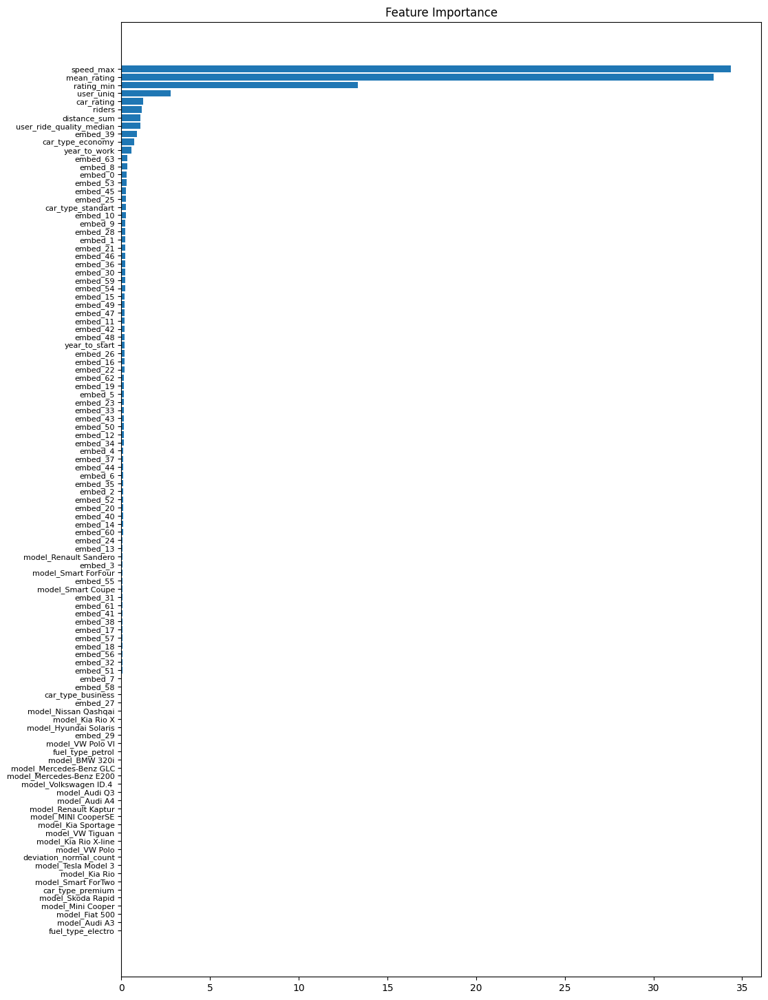

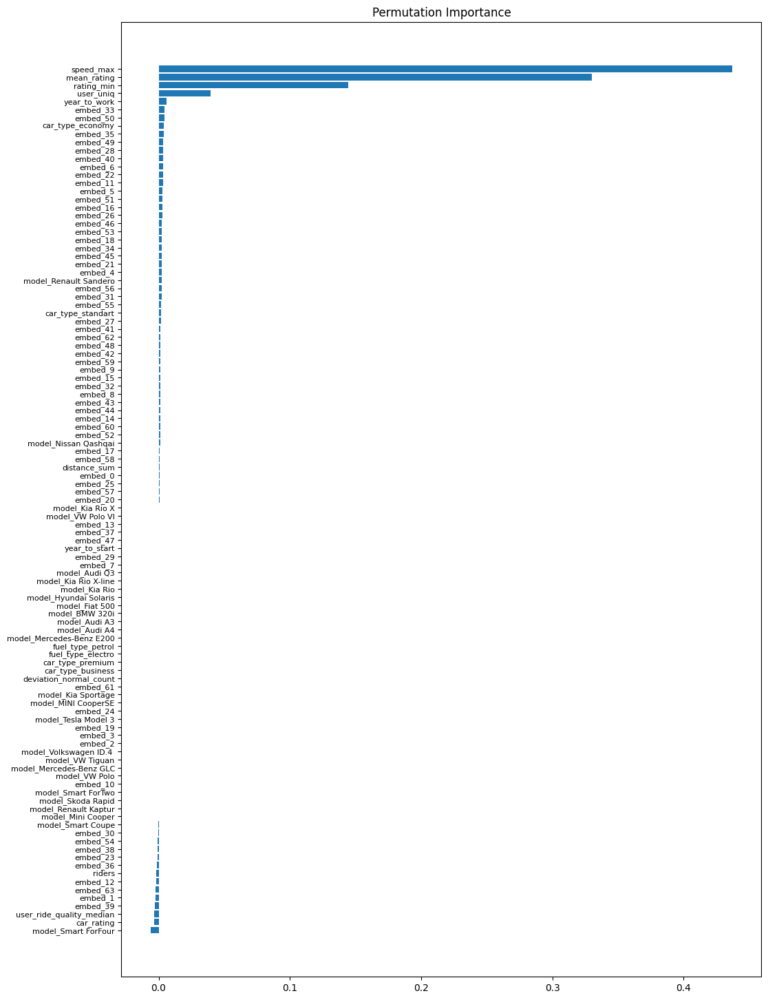

In [94]:
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance

feature_importance = clf.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(12, 18))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_test.columns)[sorted_idx], fontsize=8)
plt.title('Feature Importance');

perm_importance = permutation_importance(clf, X_test, y_test, n_repeats=10, random_state=1066)
sorted_idx = perm_importance.importances_mean.argsort()
fig = plt.figure(figsize=(12, 18))
plt.barh(range(len(sorted_idx)), perm_importance.importances_mean[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_test.columns)[sorted_idx], fontsize=8)
plt.title('Permutation Importance');

### 2.2 Embeddings for Regression + visuals

In [97]:
X = df.drop(['target_reg','target_class'], axis=1)
y = df['target_reg']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

reg = CatBoostRegressor(random_seed=9,
                        thread_count=-1,
                        use_best_model=True)

reg.fit( X_train, y_train, 
        eval_set=(X_test, y_test),
        verbose=50, plot=False, early_stopping_rounds=200)

print(reg.get_best_score())

Learning rate set to 0.056174
0:	learn: 0.7411401	test: 0.7731823	best: 0.7731823 (0)	total: 12.6ms	remaining: 12.6s
50:	learn: 0.4917757	test: 0.5454752	best: 0.5454752 (50)	total: 526ms	remaining: 9.79s
100:	learn: 0.4548156	test: 0.5300382	best: 0.5300382 (100)	total: 1.1s	remaining: 9.76s
150:	learn: 0.4247107	test: 0.5225908	best: 0.5225908 (150)	total: 1.67s	remaining: 9.36s
200:	learn: 0.3936325	test: 0.5210276	best: 0.5209849 (199)	total: 2.25s	remaining: 8.94s
250:	learn: 0.3659883	test: 0.5196721	best: 0.5192631 (243)	total: 2.85s	remaining: 8.5s
300:	learn: 0.3442688	test: 0.5194646	best: 0.5186858 (272)	total: 3.43s	remaining: 7.96s
350:	learn: 0.3246688	test: 0.5198727	best: 0.5186858 (272)	total: 4.03s	remaining: 7.46s
400:	learn: 0.3057420	test: 0.5191319	best: 0.5186858 (272)	total: 4.67s	remaining: 6.98s
450:	learn: 0.2889993	test: 0.5189529	best: 0.5184396 (432)	total: 5.24s	remaining: 6.37s
500:	learn: 0.2735150	test: 0.5195056	best: 0.5184396 (432)	total: 5.82s	rema

In [99]:
preds = reg.predict(X_test)
preds = target_scaler.inverse_transform(np.array(preds).reshape(-1, 1))
print("MSE: ", mean_squared_error(y_test, preds) ** 0.5)

MSE:  45.944378271140764


In [98]:
fi = reg.get_feature_importance(prettified=True)
fi[:30]

,Feature Id,Importances
0,speed_max,31.905
1,mean_rating,23.117
2,rating_min,8.516
3,user_ride_quality_median,2.336
4,distance_sum,2.293
5,user_uniq,1.893
6,riders,1.847
7,car_rating,1.622
8,year_to_work,1.146
9,fuel_type_electro,1.013


___
# <font color='pink'>9.3 🏋️‍♂️🏌️‍♂️  **Weights & Biases** --- (MUSTHAVE) for logs & saving results of experiments</font>
- [documentation](https://docs.wandb.ai/)
- [examples of usage](https://github.com/wandb/examples)
- what for (Note --- **all computations on YOUR device**)
    - helps tracking model parameters REAL-TIME
    - visualization (graphics, images, video, audio, 3d-objects, etc.)
    - allows to train model from DIFFERENT computers & save results in 1 place (for teamwork)
    - using 'W&B artifacts' allows tracking & creating 'versions of runs' for different data, models, dependencies and results of ML
    - ready-to-go integrations with all popular DS frameworks --- low entry-level
- Kaggle examples with Weights & Biases
    1. [EfficientNet+Mixup+K-Fold using TF and wandb](https://www.kaggle.com/ayuraj/efficientnet-mixup-k-fold-using-tf-and-wandb)
    2. [HPA: Segmentation Mask Visualization with W&B](https://www.kaggle.com/ayuraj/hpa-segmentation-mask-visualization-with-w-b)
    3. [HPA: Multi-Label Classification with TF and W&B](https://www.kaggle.com/ayuraj/hpa-multi-label-classification-with-tf-and-w-b)
    4. [BirdCLEF: Quick EDA with W&B](https://www.kaggle.com/ayuraj/birdclef-quick-eda-with-w-b)

## 1. Authorization
1. create free account --- https://wandb.ai/site 
2. get API key for logging --- https://wandb.ai/authorize

- How to use on Kaggle?
    - use --- wandb.login()
        - it will ask for API key (use Kaggle secrets to prevent API key leakage)

In [2]:
# # Kaggle example
# from kaggle_secrets import UserSecretsClient

# user_secrets = UserSecretsClient()
# wandb_api = user_secrets.get_secret("wandb_api") 
# wandb.login(key=wandb_api)

# Simple example 
import wandb
wandb.login(key='place_key_here') # https://wandb.ai/settings

wandb: Currently logged in as: accpavel. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: C:\Users\Adm.000/.netrc


True

## 2. Loading data, preprocessing, creating custon NN architecture + defining config
- categorical ---> OneHotEncoding
- numerical ---> fill NAs
- target class ---> Label Encoding
- target regression ---> Robust Scaler 1
- numerical (categorical + numerical) ---> Robust Scaler 2

In [3]:
import torch
import os
import copy
import sys
import numpy as np
import pandas as pd
from torch.utils.data import Dataset, DataLoader
from torch import nn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, RobustScaler

url = 'https://raw.githubusercontent.com/a-milenkin/Competitive_Data_Science/main/data/quickstart_train.csv'
rides_info = pd.read_csv(url)

drop_cols = ['car_id', 'target_reg', 'target_class']
cat_cols = ['car_type', 'fuel_type', 'model']

# OHE cat features, drop NAN
rides_info = pd.get_dummies(rides_info, columns=cat_cols)
rides_info.fillna(rides_info.median(numeric_only=True), inplace=True)

# encode target (classification)
le = LabelEncoder()
rides_info['target_class'] = le.fit_transform(rides_info['target_class'])

num_cols = [col for col in list(rides_info.columns) if col not in drop_cols]

# Normalize (scale) features [for target 'regression' use different scaler]
scaler = RobustScaler()
df = scaler.fit_transform(rides_info[num_cols])
df = pd.DataFrame(df, columns=num_cols)
target_scaler = RobustScaler()
target = target_scaler.fit_transform(rides_info['target_reg'].values.reshape(-1, 1))

df['target_reg'] = target
df['target_class'] = rides_info['target_class']

def seed_everything(seed=42):
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
seed_everything(seed=42)
device = torch.device('cpu')

train, test = train_test_split(df, test_size=0.2, random_state=42)

In [4]:
CONFIG = dict (
    hidden_size=128,
    dropout=0.1,
    lr=1e-3,
    batch_size=128,
    num_workers=0,#os.cpu_count(),
    epochs=20,
    num_features=train.shape[1]-2, # кол-во фичей подаваемое на вход
    num_tar_2=train.target_class.nunique(), # количество выходов равно кол-ву предсказываемых классов
    architecture = "MLP",
    infra = "Kaggle"
)

# датасет выдает фичи и значения целевых переменных
class Rides(Dataset):
    def __init__(self, df):
        self.df = df 
    def __len__(self):
        return len(self.df)
    def __getitem__(self, idx):
        row = self.df.iloc[idx,:]
        
        data = row.drop(labels=['target_reg', 'target_class'])

        data = torch.FloatTensor(data.values.astype('float'))
        tar_1 = torch.tensor(row['target_reg']).float()
        tar_2 = row['target_class'].astype('int')
        
        return data, tar_1, tar_2
    
    
train_datasets = {'train': Rides(train),
                  'val': Rides(test)}
dataloaders = {x: torch.utils.data.DataLoader(train_datasets[x], 
                                                   batch_size=CONFIG['batch_size'], 
                                                   shuffle=True, 
                                                   num_workers=CONFIG['num_workers'])
                    for x in ['train', 'val']}

class TabularNN(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.mlp = nn.Sequential(
                          nn.Linear(cfg['num_features'], cfg['hidden_size']),
                          nn.Dropout(cfg['dropout']),
                          nn.ReLU(),
                          nn.Linear(cfg['hidden_size'], cfg['hidden_size']),
                          nn.Dropout(cfg['dropout']),
                          nn.ReLU(),
                          nn.Linear(cfg['hidden_size'], cfg['hidden_size'] // 2),
                          )
        
        self.regressor = nn.Sequential(
            nn.Linear(cfg['hidden_size'] // 2, 1)
        )
        self.classifier = nn.Sequential(
            nn.Linear(cfg['hidden_size'] // 2, cfg['num_tar_2'])
        )

    def forward(self, data):
        x = self.mlp(data)
        tar1 = self.regressor(x)
        tar2 = self.classifier(x)
        return tar1.view(-1), tar2

## 3. Using **Weights & Biases**
- wandb.init() --- initialize 'new run'
- wandb.finish() --- end and close 'run'
- wandb.config --- object that stores 'hyperparameters' and 'settings' of 'run'

In [10]:
# Инициализируем модель
model = TabularNN(CONFIG).to(device)

# оптимайзер и лоссы для регрессии и классификации
optimizer = torch.optim.Adam(model.parameters(), lr = CONFIG['lr'])
regression_criterion = nn.MSELoss().to(device)
classification_criterion = nn.CrossEntropyLoss().to(device)



# Добавим в CONFIG имя модели
CONFIG['model_name'] = 'Tabular_NN'
print('Training configuration: ', CONFIG)

wandb: Currently logged in as: accpavel. Use `wandb login --relogin` to force relogin


Training configuration:  {'hidden_size': 128, 'dropout': 0.1, 'lr': 0.001, 'batch_size': 128, 'num_workers': 8, 'epochs': 20, 'num_features': 43, 'num_tar_2': 9, 'architecture': 'MLP', 'infra': 'Kaggle', 'model_name': 'Tabular_NN'}


In [11]:
# Initialize W&B run
run = wandb.init(project='Course contest',
                 config=CONFIG,
                 group='MLP', 
                 job_type='train')

# Добавляем "type" and "kaggle_competition" to `wandb.config` directly
wandb.config.type = 'baseline'
wandb.config.kaggle_competition = 'Competitive Data Science Course Contest'

# Close W&B run
run.finish()

**Running 5 experiments tuning 'dropout rate' parameter**
- added 'wandb.init' before training
- added 'wandb.finish' to close run

In [7]:
import random

num_epochs = CONFIG['epochs']
verbose = 5
for _ in range(5):
    
    # Изменим CONFIG - определим dropout как рандомную величину в заданном диапазоне значений
    CONFIG['dropout'] = random.uniform(0.01, 0.80)
    model = TabularNN(CONFIG).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr = CONFIG['lr'])
    regression_criterion = nn.MSELoss().to(device)
    classification_criterion = nn.CrossEntropyLoss().to(device)
    
    # 🐝 initialize a wandb run
    wandb.init(project='Course contest',
               config=CONFIG,
               group='MLP', 
               job_type='train'
            )
    
    val_acc_history = []

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = np.inf

    for epoch in range(num_epochs):
        if epoch % verbose == 0:
            print('Epoch {}/{}'.format(epoch, num_epochs - 1))
            print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0

            # Iterate over data.
            for inputs, labels_1, labels_2 in dataloaders[phase]:
                inputs = inputs.to(device)
                labels_1 = labels_1.to(device)
                labels_2 = labels_2.to(device)
                
                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss

                    outputs_1, outputs_2 = model(inputs)
                    loss_1 = regression_criterion(outputs_1, labels_1)
                    loss_2 = classification_criterion(outputs_2, labels_2.long())

                    loss = loss_1 + loss_2

                    _, preds_2 = torch.max(outputs_2, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                val_acc_history.append(running_loss)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            if epoch % verbose == 0:
                print('{} Loss: {:.4f}'.format(phase, epoch_loss))
            
            # 🐝 Log train and validation metrics to wandb
            wandb.log({'{} loss'.format(phase): epoch_loss, 'dropout':CONFIG['dropout']})

            # deep copy the model
            if phase == 'val' and epoch_loss < best_loss:
                best_model_wts = copy.deepcopy(model.state_dict())
                best_loss = epoch_loss


    # load best model weights
    model.load_state_dict(best_model_wts)
    
    # 🐝 Close your wandb run 
    wandb.finish()

Epoch 0/19
----------
train Loss: 2.7206
val Loss: 2.6824
Epoch 5/19
----------
train Loss: 1.4026
val Loss: 1.4188
Epoch 10/19
----------
train Loss: 1.0654
val Loss: 1.1882
Epoch 15/19
----------
train Loss: 0.9622
val Loss: 1.1449


dropout,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train loss,█▇▆▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁
val loss,█▇▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
dropout,0.05488
train loss,0.91996
val loss,1.13163


Epoch 0/19
----------
train Loss: 2.7542
val Loss: 2.7460
Epoch 5/19
----------
train Loss: 1.6158
val Loss: 1.5124
Epoch 10/19
----------
train Loss: 1.2765
val Loss: 1.2504
Epoch 15/19
----------
train Loss: 1.1744
val Loss: 1.2324


dropout,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train loss,██▇▅▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁
val loss,█▇▆▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
dropout,0.38808
train loss,1.12571
val loss,1.17759


Epoch 0/19
----------
train Loss: 2.7136
val Loss: 2.6993
Epoch 5/19
----------
train Loss: 1.4264
val Loss: 1.4125
Epoch 10/19
----------
train Loss: 1.1139
val Loss: 1.2078
Epoch 15/19
----------
train Loss: 1.0096
val Loss: 1.1606


dropout,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train loss,█▇▆▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val loss,█▇▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
dropout,0.10748
train loss,0.9529
val loss,1.15196


Epoch 0/19
----------
train Loss: 2.7706
val Loss: 2.7789
Epoch 5/19
----------
train Loss: 2.2296
val Loss: 2.0145
Epoch 10/19
----------
train Loss: 1.6881
val Loss: 1.4885
Epoch 15/19
----------
train Loss: 1.5036
val Loss: 1.3487


dropout,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train loss,██▇▇▆▅▄▃▃▃▂▂▂▁▂▁▁▁▁▁
val loss,██▇▆▅▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁
dropout,0.67723
train loss,1.42059
val loss,1.29481


Epoch 0/19
----------
train Loss: 2.7258
val Loss: 2.6918
Epoch 5/19
----------
train Loss: 1.4465
val Loss: 1.4675
Epoch 10/19
----------
train Loss: 1.1011
val Loss: 1.1907
Epoch 15/19
----------
train Loss: 1.0319
val Loss: 1.1426


dropout,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train loss,█▇▆▅▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁
val loss,█▇▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
dropout,0.13014
train loss,0.95979
val loss,1.14081


## 4. W&B Artifacts
- to register 'input-output' flow --- stores your data & models
- wandb.log_artifact ()
    1. create empty artifact --- wandb.Artifact ()
    2. add file to artifact --- wandb.add_file ()
    3. save artifact --- wandb.log_artifact ()
- where to find ---> in your project (left side 'Artifacts' icon)

In [9]:
# Save model
torch.save(model.state_dict(), 'models/tab_model.pth')

# Initialize a new W&B run
run = wandb.init(project='Course contest',
                 config=CONFIG,
                 group='MLP', 
                 job_type='save') # Note the job_type

# Update `wandb.config`
wandb.config.type = 'baseline'
wandb.config.kaggle_competition = 'Competitive Data Science Course'

# Save model as Model Artifact
artifact = wandb.Artifact(name='best_tab_NN', type='model') # Задаем произвольное имя
artifact.add_file('models/tab_model.pth')
run.log_artifact(artifact)

# Finish W&B run
run.finish()

## 5. Example --- logging Boosting

In [ ]:
# -------
# 2 step here
# -------

from sklearn.metrics import f1_score, accuracy_score
from sklearn.model_selection import train_test_split

run = wandb.init(project='Course contest',
                 job_type='train-model',
                 group='LGBM',
                 config={'wandb_nb':'wandb_course_contest'})  # config is optional here

bst_params = {
        'learning_rate': 0.1,
        'min_child_weight': 100,
        'n_estimators': 125,
        'random_state': 42,
        'reg_alpha': 0,
        'reg_lambda': 0,
    }

run.config.update(bst_params)
run.config.update({'early_stopping_rounds': 40})

X = df.drop(['target_reg','target_class'], axis=1)
y = df['target_class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


from wandb.lightgbm import wandb_callback, log_summary
import lightgbm as lgb
lgbmodel = lgb.LGBMClassifier(**bst_params)
# Train the model, using the wandb_callback for logging
lgbmodel.fit(X_train, y_train, eval_set=[(X_test, y_test)], 
             early_stopping_rounds=run.config['early_stopping_rounds'],
             verbose=10, callbacks=[wandb_callback()])


# Save the booster to disk
model_name = f'{run.name}_model.mod'
bstr = lgbmodel.booster_
bstr.save_model(model_name)

# Get the booster's config
config = lgbmodel.get_params()

# Log the trained model to W&B Artifacts, including the booster's config
model_art = wandb.Artifact(name=model_name, type='model', metadata=config)
model_art.add_file(model_name)
run.log_artifact(model_art);

# Log booster metrics
run.summary["best_score"] = bstr.best_score
run.summary["best_iteration"] = bstr.best_iteration

# Log validation metrics
preds = lgbmodel.predict(X_test)
run.summary["f1_score"] = f1_score(y_test, preds, average='macro')
run.summary["accuracy"] = accuracy_score(y_test, preds)

run.finish()

# Tasks
- PSEUDO LABELING (using 'test' for training model)
    - [Pseudo Labeling using LAMA Auto ML](https://www.kaggle.com/code/cdeotte/pseudo-labeling-qda-0-969)
    - [Deeper information why it works](https://towardsdatascience.com/pseudo-labeling-to-deal-with-small-datasets-what-why-how-fd6f903213af)
- METRICS nuance
    - tweaking results to fit better to test
- Custom metric P4 for CatBoost
- Custom Text Transformer for Sklearn pipelines

1. [10p - BIG Boosting's exercise --- train 3 boostings on 3 folds with hyperparameter tuning NO optuna, NO new features](https://stepik.org/lesson/779920/step/4?unit=782494)
2. [2p - custom scheduler - LightGBM](https://stepik.org/lesson/779918/step/7?unit=782492)

## METRICS
- [Calibration of model output](https://queirozf.com/entries/introduction-to-auc-and-calibrated-models-with-examples-using-scikit-learn)
- [Covariance shift & Adversarial validation](https://deepschool-pro.notion.site/Covariance-shift-Adversarial-validation-32fab6caa55e48eeb5dd2fbe4164378c)
- For Kaggle
    - hide real AUC from opponents ---> do '-1' from your probabilities (inverse them) ---> you get inverse AUC (but you now the real accuracy by doing '+1' ---> helps to hide your ideas)
    - DONT round your probabilities if it's AUC ---> it's always worse when you do 'classes' (AUC handles probabilities)
- From tasks
    - CALIBRATE your 'thresholds' in BINARY CLASSIFICATIONS --- tuning it might help with GETTING TO YOUR PERFECT VALIDATION POINT
    - get insights in data in MULTI CLASSIFICATIONS --- maybe after training 1 class is MET for every single sample
    - don't forget for regression to do Scaling (and inverse for predictions) ---> check range of data to be proper (for train/test)

### Task - target distribution REGRESSION --- using Scaler (forward, not inverse one)
- train range values [0.0 - 0.990]
- test range values [-0.9 - 1.785]
- Solution - create and apply MinMaxScaler to the 'bad_predict'

In [54]:
import pandas as pd
import numpy as np

train = pd.read_csv("data/hm1_train.csv")
test = pd.read_csv("data/hm1_test.csv")

target_scaler = MinMaxScaler()
test['best_predict'] = target_scaler.fit_transform(test['bad_predict'].values.reshape(-1, 1))

,row_id,train_target
0,id_457318,0.840
1,id_784818,0.710
2,id_999059,0.510
3,id_838320,0.800
4,id_758667,0.530


### Task - target distribution MULTI CLASSIFICATION --- in 'train set' (class 8 has 100% frequency) - in test NOT ---> predict['8']=1

In [89]:
import pandas as pd
import numpy as np

target = pd.read_csv("data/hm2_target.csv")
predict = pd.read_csv("data/hm2_predict.csv")

predict['8']=1

In [86]:
target.describe()

,0,1,2,3,4,5,6,7,8,9,10
count,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000
mean,0.554,0.563,0.560,0.556,0.543,0.546,0.540,0.555,1.000,0.541,0.563
std,0.497,0.496,0.496,0.497,0.498,0.498,0.498,0.497,0.000,0.498,0.496
min,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
25%,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
50%,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
75%,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
max,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000


In [87]:
predict.describe()

,0,1,2,3,4,5,6,7,8,9,10
count,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000,5000.000
mean,0.298,0.304,0.295,0.305,0.307,0.291,0.316,0.303,0.301,0.300,0.308
std,0.458,0.460,0.456,0.460,0.461,0.454,0.465,0.460,0.459,0.458,0.462
min,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
50%,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
75%,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
max,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000


In [85]:
predict

,0,1,2,3,4,5,6,7,8,9,10
0,0,0,1,1,0,0,0,0,0,1,0
1,0,0,0,0,1,1,0,0,1,1,0
2,0,0,0,0,0,0,1,0,1,1,0
3,1,0,0,0,1,0,0,1,1,1,0
4,0,0,0,1,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
4995,0,0,0,1,0,0,0,0,0,0,0
4996,1,0,0,0,0,0,0,0,0,0,1
4997,0,0,0,1,0,1,0,0,1,1,0
4998,0,1,1,1,0,0,1,0,0,0,1


### Task - optimal threshold for f1_score --- enumerate thresholds to find perfect for BINARY CLASSIFICATION

In [93]:
import pandas as pd
import numpy as np
from sklearn.metrics import classification_report

train = pd.read_csv("data/hm3_val_data.csv")
test = pd.read_csv("data/hm3_predict_prob.csv")

# train['val_prob_class'] = train.apply(lambda x: 0 if x.val_prob < 0.75 else 1, axis=1)
# y_pred = train['val_prob_class']
# y_test = train['val_target']
# print(classification_report(y_true = y_test,
#                             y_pred = y_pred,
#                             target_names=['0', '1']))

In [130]:
from sklearn.metrics import f1_score

best_f1_score = 0.0
best_threshold = 0.1
y_test = train['val_target']
for threshold in np.arange(0.1, 1, 0.01, dtype=float):
    y_pred = train.apply(lambda x: 0 if x.val_prob < threshold else 1, axis=1)
    score = f1_score(y_test, y_pred)
    print('---')
    print('score = ', score, ' , threshold = ', threshold)
    if best_f1_score < score:
        best_f1_score = f1_score(y_test, y_pred)
        best_threshold = threshold
        
print('best score = ', best_f1_score, ' , best threshold = ', best_threshold)

---
score =  0.05981744027966595  , threshold =  0.1
---
score =  0.05986394557823129  , threshold =  0.11
---
score =  0.05988722535485126  , threshold =  0.12
---
score =  0.059922178988326844  , threshold =  0.13
---
score =  0.05994550408719346  , threshold =  0.13999999999999999
---
score =  0.0600038963569063  , threshold =  0.14999999999999997
---
score =  0.060085836909871244  , threshold =  0.15999999999999998
---
score =  0.060179757717858544  , threshold =  0.16999999999999998
---
score =  0.06029757243539545  , threshold =  0.17999999999999997
---
score =  0.0604277025701393  , threshold =  0.18999999999999995
---
score =  0.060463290145268946  , threshold =  0.19999999999999996
---
score =  0.06060606060606061  , threshold =  0.20999999999999996
---
score =  0.060761491418425725  , threshold =  0.21999999999999995
---
score =  0.06099009900990098  , threshold =  0.22999999999999995
---
score =  0.06124478027440843  , threshold =  0.23999999999999994
---
score =  0.06161232

In [131]:
best_threshold

0.7499999999999997

In [128]:
best_threshold

0.9899999999999995

In [122]:
from sklearn.metrics import f1_score

f1_score(y_test, y_pred)

1.0

In [121]:
classification_report(y_true = y_test,
                            y_pred = y_pred,
                            target_names=['0', '1'])

'              precision    recall  f1-score   support\n\n           0       1.00      1.00      1.00      4846\n           1       1.00      1.00      1.00       154\n\n    accuracy                           1.00      5000\n   macro avg       1.00      1.00      1.00      5000\nweighted avg       1.00      1.00      1.00      5000\n'

In [95]:
test

,predict_prob
0,0.300
1,0.318
2,0.987
3,0.292
4,0.724
...,...
4995,0.389
4996,0.151
4997,0.938
4998,0.645


## Hack Leaderboard task tweak your 'threshold' using results that are given (on site)
- Using accuracy score might be biased or heavily influenced by certain characteristics of the test dataset [too obvious especially for 'binary classification']
- This could lead to misleading conclusions about the model's effectiveness

In [203]:
import pandas as pd
import numpy as np

from sklearn.metrics import accuracy_score

subm = pd.read_csv("subs/hw4_submission.csv")

quantile = 0.251
threshold = np.quantile(subm['test_prob'], quantile)
threshold = 0.4015
print(threshold)
subm['best_predict'] =  subm.apply(lambda x: 0 if x.test_prob < threshold else 1, axis=1)
subm.to_csv('subs/hw4_submission_BETTER.csv', index=False)
#subm.describe()

0.4015


In [184]:
subm['best_predict'].sum()

3737

In [ ]:
# 0.25 --- 4.98
# 0.249 --- 4.97
# 0.251 --- 0.9994
# 0.253 --- 0.9968
# 0.255 --- 0.9946

## Pseudo-labeling
1. train model on labeled data
2. predict labels for 'test' ---> add them to test
3. train NEW MODEL ---> using labeled TEST and TRAIN
    - ratio 3 / 1 (75% train, 25% data) --- gives boost in performance
4. validation ONLY ON DATA FROM TRAIN ---> since in test labels can be errors
    - Idea is just to give model more data to generalize it better (or not...)
        - for example it helps to better define 'classification boundaries'
        
- ASSUMPTIONS:
    1. you SQUEEZED perfection out of everything (data, model, metrics)
        - bad model - bad labeling on test - bad overall
    2. don't calculate metric using 'test labels' (they contain errors of our trained model --- they're not perfect labels --- use validation)
    3. even with PERFECT trained ML model --- ratio between TRAIN/TEST matters here
        - otherwise model will over-train on it's data (big ratio) or errors (small ratio)
    4. if score got bigger ---> try to repeat

## Custom Metric P4 for CatBoost

In [230]:
path = "data/CB_bin_target_data.csv"
df = pd.read_csv(path)

In [232]:
df

,model,car_type,fuel_type,car_rating,year_to_start,riders,year_to_work,mean_rating,distance_sum,rating_min,speed_max,user_ride_quality_median,deviation_normal_count,user_uniq,target_bin
0,Kia Rio X-line,economy,petrol,3.780,2015,76163,2021,4.738,12141310.405,0.100,180.856,0.023,174,170,0
1,VW Polo VI,economy,petrol,3.900,2015,78218,2021,4.481,18039092.838,0.000,187.863,12.306,174,174,0
2,Renault Sandero,standart,petrol,6.300,2012,23340,2017,4.768,15883659.428,0.100,102.383,2.513,174,173,0
3,Mercedes-Benz GLC,business,petrol,4.040,2011,1263,2020,3.881,16518828.765,0.100,172.793,-5.029,174,170,0
4,Renault Sandero,standart,petrol,4.700,2012,26428,2017,4.181,13983174.664,0.100,203.462,-14.260,174,171,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2332,Smart ForFour,economy,petrol,4.380,2017,121239,2018,4.609,17392216.353,0.100,141.502,-6.625,174,171,0
2333,Audi A4,premium,petrol,4.300,2016,107793,2020,4.684,11740523.669,0.100,155.000,-8.582,174,169,0
2334,Kia Rio,economy,petrol,3.880,2015,80234,2019,4.655,12020217.651,0.100,104.181,-0.779,174,172,0
2335,Renault Sandero,standart,petrol,4.500,2014,60048,2020,4.638,17883073.865,0.100,200.000,2.465,174,171,0


In [250]:
import numpy as np 
from sklearn.metrics import confusion_matrix

class P4Metric(object):
    def get_final_error(self, error, weight):
        return error / (weight + 1e-38)

    def is_max_optimal(self):
        return True

    def evaluate(self, approxes, target, weight):
        #assert len(approxes[0]) == 1
        #assert len(target) == len(approxes[0])
        
        approxes = approxes[0]
        target = np.array(target).astype(int) 
        
        y_pred = np.array((np.exp(approxes)/(1+np.exp(approxes))) > 0.5).astype(int)
        
        tn, fp, fn, tp = confusion_matrix(target, y_pred).ravel()
        score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
        
        return score, 

In [251]:
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier

cat_features = ["model", "car_type", "fuel_type"]  # Выделяем категориальные признаки
targets = ["target_bin", "target_reg"]
features2drop = []  # эти фичи будут удалены

filtered_features = [i for i in df.columns if (i not in targets and i not in features2drop)]
num_features = [i for i in filtered_features if i not in cat_features]
for c in cat_features:  # Избавлеямся от NaN'ов
    df[c] = df[c].astype(str)


X = df[filtered_features].drop(targets, axis=1, errors="ignore")
y = df["target_bin"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

p4_metric = P4Metric()

clf = CatBoostClassifier(thread_count=-1,
                         random_seed=42,
                         cat_features=cat_features,
                         eval_metric=p4_metric
                        )

In [252]:
clf.fit(
    X_train,
    y_train,
    eval_set=(X_test, y_test),
    verbose=10,
    use_best_model=True,
    plot=False,
    early_stopping_rounds=100,
)

Learning rate set to 0.036983
0:	learn: nan	test: nan	best: -inf (-1)	total: 140ms	remaining: 2m 19s


C:\Users\Adm.000\AppData\Roaming\Python\Python38\site-packages\catboost\core.py:1759: UserWarning: Failed to optimize method "evaluate" in the passed object:
Failed in nopython mode pipeline (step: nopython frontend)
Untyped global name 'confusion_matrix': Cannot determine Numba type of <class 'function'>

File "..\..\..\AppData\Local\Temp\ipykernel_10332\1288927962.py", line 20:
<source missing, REPL/exec in use?>

  self._object._train(train_pool, test_pool, params, allow_clear_pool, init_model._object if init_model else None)
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning:

10:	learn: 1.0000000	test: nan	best: -inf (-1)	total: 408ms	remaining: 36.6s


C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_1033

20:	learn: 1.0000000	test: nan	best: -inf (-1)	total: 650ms	remaining: 30.3s


C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))
C:\Users\Adm.000\AppData\Local\Temp\ipykernel_10332\1288927962.py:21: RuntimeWarning: invalid value encountered in longlong_scalars
  score = 4 * tp * tn / ((4 * tp * tn) + (tp+tn)*(fp*fn))


30:	learn: 0.0617062	test: 0.1071911	best: 1.0000000 (27)	total: 940ms	remaining: 29.4s
40:	learn: 0.0494545	test: 0.0817844	best: 1.0000000 (27)	total: 1.23s	remaining: 28.9s
50:	learn: 0.0811497	test: 0.0856165	best: 1.0000000 (27)	total: 1.5s	remaining: 28s
60:	learn: 0.0831609	test: 0.0919198	best: 1.0000000 (27)	total: 1.78s	remaining: 27.5s
70:	learn: 0.0933323	test: 0.0910629	best: 1.0000000 (27)	total: 2.08s	remaining: 27.2s
80:	learn: 0.1028812	test: 0.0907619	best: 1.0000000 (27)	total: 2.34s	remaining: 26.6s
90:	learn: 0.1252113	test: 0.0980744	best: 1.0000000 (27)	total: 2.61s	remaining: 26.1s
100:	learn: 0.1388891	test: 0.1017890	best: 1.0000000 (27)	total: 2.88s	remaining: 25.6s
110:	learn: 0.1431848	test: 0.1136653	best: 1.0000000 (27)	total: 3.16s	remaining: 25.3s
120:	learn: 0.1766500	test: 0.1020140	best: 1.0000000 (27)	total: 3.42s	remaining: 24.9s
130:	learn: 0.1967449	test: 0.1186441	best: 1.0000000 (27)	total: 3.67s	remaining: 24.4s
140:	learn: 0.2285068	test: 0.1

## Text Transformer - NLP task
1. First we need to tokenize words (split them into seperate words)
2. Then Use MorphAnalyzer from pymorphy2 ---> to transform 'word' into 'normal form' (infinitive)
3. Then use 'join()' to concatenate words into 'text' once again
4. Might require 'Pool' of multiprocessing (takes very long time)

In [267]:
# TRANSFORMER SHOWN IN 9.2 - OPTIMIZATION (Pool parallelization)

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import pymorphy2

russian_stopwords = stopwords.words("russian")
english_stopwords = stopwords.words("english")
en_ru_stopwords = set(russian_stopwords + english_stopwords)

def text_prepare(text):
    lemmatizer = pymorphy2.MorphAnalyzer()
    word_tokens = word_tokenize(text)
    word_tokens = [w for w in word_tokens if not w in en_ru_stopwords]
    word_tokens = [lemmatizer.parse(w)[0].normal_form for w in word_tokens]
    filtered_text = ' '.join(word_tokens)
    return filtered_text

def many_row_prepare(df, text_col='text'):
    res = []
    for text in df[text_col]:
        res.append(text_prepare(text))
    return res

In [317]:
# WORKING TRANSFORMER FOR Sklearn - no 'get_normal_string' function

import pymorphy2
import numpy as np
from sklearn.base import TransformerMixin, BaseEstimator
from nltk.tokenize import word_tokenize

class TextTransformer(BaseEstimator, TransformerMixin):
    
    def __init__(self, stop_words_list):
        self.stop_words_list = stop_words_list
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text[0])
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.lemmatizer.parse(w)[0].normal_form for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        return np.array(transformed_X)

In [323]:
import pymorphy2
import numpy as np
from sklearn.base import TransformerMixin, BaseEstimator
from nltk.tokenize import word_tokenize

class TextTransformer(BaseEstimator, TransformerMixin):
    
    def __init__(self, stop_words_list):
        self.stop_words_list = stop_words_list
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text[0])
            word_tokens = [w for w in word_tokens if not w in self.stop_words_list]
            word_tokens = [self.get_normal_string(w) for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        
        print(transformed_X)
        print('---')
        
        return np.array(transformed_X)
    
    def get_normal_string(self, word):
        return self.lemmatizer.parse(word)[0].normal_form

In [363]:
import pymorphy2
import numpy as np
from sklearn.base import TransformerMixin, BaseEstimator
from nltk.tokenize import word_tokenize

class TextTransformer(BaseEstimator, TransformerMixin):
    
    def __init__(self, stop_words_list):
        self.stop_words_list = stop_words_list
        self.lemmatizer = pymorphy2.MorphAnalyzer()
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        transformed_X = []
              
        for text in X:
            word_tokens = word_tokenize(text[0])
            word_tokens = [w for w in text if not w in self.stop_words_list]
            word_tokens = [self.get_normal_string(w) for w in word_tokens]
            filtered_text = ' '.join(word_tokens)
            transformed_X.append(filtered_text)
        
        return np.array(transformed_X)
    
    def get_normal_string(self, word):
        return self.lemmatizer.parse(word)[0].normal_form

In [364]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

stop_words_list = set(stopwords.words("russian"))

train = pd.read_csv("data/text_classification_train.csv")
train = train[0:50]

text_transformers = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy='constant', fill_value='')),
    ("scaler", TextTransformer(stop_words_list))
])

text_transformers.fit_transform(train[['text']])

array(['ледник пасторури это цирковой ледник расположенный в южной части кордильеры бланка части горного хребта анд на севере перу в регионе анкаш.',
       'главные участники предстоящего betokenoid 274 лицом к лицу андрей корешков vs ченси ренкаунтри нейман грейси vs логан сторли георгий караханян vs адам пикколотти via mmajtokenoid андрейкорешков корешок',
       'ttokenoid btokenoid – карта с которой можно не только тратить но и зарабатывать до 30 кэшбэк рублями обслуживание от 0 руб. до 7 на остаток',
       'в сильверстоуне произошли крупные обновления автомобилей мерседеса альпин астон мартин и уильямс но марк хьюз сосредоточился на тех которые привезли лидеры чемпионата. джорджио пиола приводит технические иллюстрации.',
       'на протяжении более чем 30 лет вестсайд является ведущим новатором в области развития всех видов сил человека 33',
       'моя цель – отобраться на итоговый турнир в турине. у меня хорошие перспективы. я сыграю в тель авиве и на соревнованиях atp 500 в 